# Deep Convolutional Generative Adversarial Network

In [1]:
!pip install imageio

In [2]:
!pip install tensorflow-hub

In [3]:
import tensorflow as tf

2023-12-17 03:48:07.731419: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-12-17 03:48:07.903412: E tensorflow/stream_executor/cuda/cuda_blas.cc:2981] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2023-12-17 03:48:08.644909: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /home/piai/anaconda3/envs/ml/lib:/home/piai/anaconda3/envs/opencv_keras/lib
2023-12-17 03:48:08.645013: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libn

In [4]:
import glob
import imageio
import matplotlib.pyplot as plt
import numpy as np
import os
import PIL
from tensorflow.keras import layers
import time

from IPython import display

In [5]:
BATCH_SIZE = 8
NOISE_DIM = 50

IMG_SIZE = 256

Creating the models

2023-12-17 03:48:10.358691: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-12-17 03:48:11.545120: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1616] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 6252 MB memory:  -> device: 0, name: NVIDIA GeForce RTX 2080, pci bus id: 0000:17:00.0, compute capability: 7.5
2023-12-17 03:48:11.545829: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1616] Created device /job:localhost/replica:0/task:0/device:GPU:1 with 5655 MB memory:  -> device: 1, name: NVIDIA GeForce RTX 2080, pci bus id: 0000:b3:00.0, compute capability: 7.5


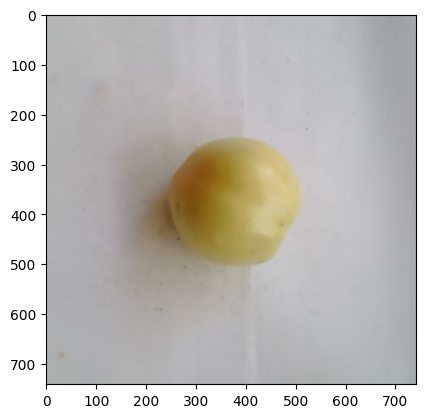

In [6]:
import glob

file_paths = glob.glob('/home/piai/3class_Maturity/images/unripe/*.jpg')  # 혹은 원하는 확장자로 변경

list_ds = tf.data.Dataset.from_tensor_slices(file_paths)

def decode_image(file_path):
    img = tf.io.read_file(file_path)
    img = tf.image.decode_jpeg(img, channels=3)  # JPEG 이미지인 경우 channels=3으로 설정
    return img

cat_ds = list_ds.map(decode_image)

for i in cat_ds:
    plt.imshow(i.numpy())  # 이미지 표시를 위해 .numpy() 메서드를 사용하여 NumPy 배열로 변환
    plt.show()
    break

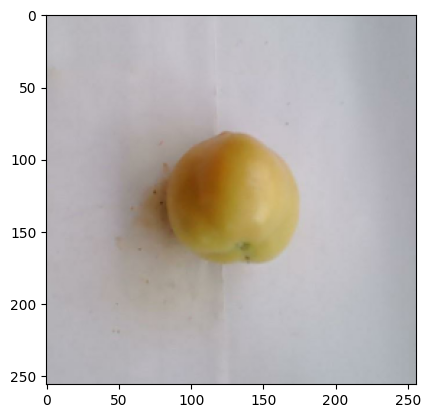

In [7]:
def configure_for_performance(ds):
    ds = ds.map(lambda x: tf.image.resize(x, (IMG_SIZE, IMG_SIZE))/255)
    ds = ds.cache()
    ds = ds.shuffle(buffer_size=1000)
    ds = ds.batch(BATCH_SIZE)
    ds = ds.prefetch(tf.data.AUTOTUNE)
    return ds

train_ds = cat_ds
train_ds = configure_for_performance(train_ds)

for i in train_ds:
    plt.imshow(i[0])
    break

### Creating the models

In [8]:
FILTER_COUNT = 8
IN_LAYER_COUNT = 4


def make_generator_model():
    model = tf.keras.Sequential()
    model.add(layers.Dense(
        (IMG_SIZE//(2**IN_LAYER_COUNT))*(IMG_SIZE//(2**IN_LAYER_COUNT))*NOISE_DIM, use_bias=False, input_shape=(NOISE_DIM,)))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    model.add(layers.Reshape((IMG_SIZE//(2**IN_LAYER_COUNT),
              IMG_SIZE//(2**IN_LAYER_COUNT), NOISE_DIM)))

    for i in range(IN_LAYER_COUNT):
        model.add(layers.Conv2DTranspose(FILTER_COUNT*2**(IN_LAYER_COUNT-i-1),
                  (6, 6), strides=(2, 2), padding='same', use_bias=False))
        model.add(layers.BatchNormalization())
        model.add(layers.LeakyReLU())

    model.add(layers.Conv2DTranspose(3, (6, 6), strides=(1, 1),
                                     padding='same', use_bias=False, activation='sigmoid'))
    assert model.output_shape == (None, IMG_SIZE, IMG_SIZE, 3)

    return model

2023-12-17 03:48:16.196821: I tensorflow/stream_executor/cuda/cuda_dnn.cc:384] Loaded cuDNN version 8100
2023-12-17 03:48:18.201794: I tensorflow/core/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2023-12-17 03:48:18.203048: I tensorflow/core/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2023-12-17 03:48:18.203146: W tensorflow/stream_executor/gpu/asm_compiler.cc:80] Couldn't get ptxas version string: INTERNAL: Couldn't invoke ptxas --version
2023-12-17 03:48:18.204456: I tensorflow/core/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2023-12-17 03:48:18.204707: W tensorflow/stream_executor/gpu/redzone_allocator.cc:314] INTERNAL: Failed to launch ptxas
Relying on driver to perform ptx compilation. 
Modify $PATH to customize ptxas location.
This message will be only logged once.


Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 12800)             640000    
                                                                 
 batch_normalization (BatchN  (None, 12800)            51200     
 ormalization)                                                   
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 12800)             0         
                                                                 
 reshape (Reshape)           (None, 16, 16, 50)        0         
                                                                 
 conv2d_transpose (Conv2DTra  (None, 32, 32, 64)       115200    
 nspose)                                                         
                                                                 
 batch_normalization_1 (Batc  (None, 32, 32, 64)       2

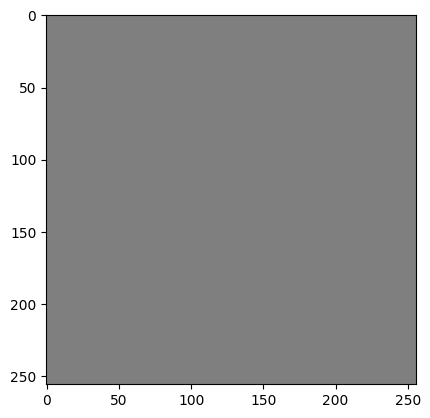

In [9]:
generator = make_generator_model()

noise = tf.random.normal([1, NOISE_DIM])
generated_image = generator(noise, training=False)
generator.summary()

plt.imshow(generated_image[0, :, :, :])
# generated_image[0, :, :, :]

In [10]:
DISC_FILTER_COUNT = FILTER_COUNT
def make_discriminator_model():
    model = tf.keras.Sequential()
    model.add(layers.Conv2D(DISC_FILTER_COUNT, (6, 6), strides=(2, 2), padding='same',
                                     input_shape=[IMG_SIZE, IMG_SIZE, 3]))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))

    for i in range(1, IN_LAYER_COUNT):
        model.add(layers.Conv2D(DISC_FILTER_COUNT*(2**i), (6, 6), strides=(2, 2), padding='same'))
        model.add(layers.LeakyReLU())
        model.add(layers.Dropout(0.3))

    model.add(layers.Flatten())
    model.add(layers.Dense(1,activation='sigmoid'))

    return model

In [11]:
discriminator = make_discriminator_model()
decision = discriminator(generated_image)
discriminator.summary()

print (decision)

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 128, 128, 8)       872       
                                                                 
 leaky_re_lu_5 (LeakyReLU)   (None, 128, 128, 8)       0         
                                                                 
 dropout (Dropout)           (None, 128, 128, 8)       0         
                                                                 
 conv2d_1 (Conv2D)           (None, 64, 64, 16)        4624      
                                                                 
 leaky_re_lu_6 (LeakyReLU)   (None, 64, 64, 16)        0         
                                                                 
 dropout_1 (Dropout)         (None, 64, 64, 16)        0         
                                                                 
 conv2d_2 (Conv2D)           (None, 32, 32, 32)       

In [12]:
# This method returns a helper function to compute cross entropy loss
cross_entropy = tf.keras.losses.BinaryCrossentropy()

### Discriminator loss
This method quantifies how well the discriminator is able to distinguish real images from fakes. It compares the discriminator's predictions on real images to an array of 1s, and the discriminator's predictions on fake (generated) images to an array of 0s.

In [13]:
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

### Generator loss
The generator's loss quantifies how well it was able to trick the discriminator. Intuitively, if the generator is performing well, the discriminator will classify the fake images as real (or 1). Here, compare the discriminators decisions on the generated images to an array of 1s.

In [14]:
def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

The discriminator and the generator optimizers are different since you will train two networks separately.

In [15]:
generator_optimizer = tf.keras.optimizers.Adam(1e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)

### Saving checkpoints

In [16]:
checkpoint_dir = './models'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

In [17]:
num_examples_to_generate = 16

seed = tf.random.normal([num_examples_to_generate, NOISE_DIM])

The training loop begins with generator receiving a random seed as input. That seed is used to produce an image. The discriminator is then used to classify real images (drawn from the training set) and fakes images (produced by the generator). The loss is calculated for each of these models, and the gradients are used to update the generator and discriminator.

In [18]:
@tf.function
def train_step(images):
    noise = tf.random.normal([BATCH_SIZE, NOISE_DIM])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_images = generator(noise, training=True)

        real_output = discriminator(images, training=True)
        fake_output = discriminator(generated_images, training=True)

        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

    gradients_of_generator = gen_tape.gradient(
        gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(
        disc_loss, discriminator.trainable_variables)

    generator_optimizer.apply_gradients(
        zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(
        zip(gradients_of_discriminator, discriminator.trainable_variables))

    return (gen_loss, disc_loss)


def train(dataset, epochs):
    gen_losses = []
    disc_losses = []

    for epoch in range(epochs):
        start = time.time()
        gen_loss = disc_loss = batch_count = 0

        for image_batch in dataset:
            (step_gen_loss, step_disc_loss) = train_step(image_batch)
            gen_loss += step_gen_loss
            disc_loss += step_disc_loss
            batch_count += 1

        gen_losses.append(gen_loss/batch_count)
        disc_losses.append(disc_loss/batch_count)

        # Save the loss plot image and generated images every 100 epochs
        if (epoch + 1) % 100 == 0:
            plot_losses(gen_losses, disc_losses, epoch+1)  # 그래프를 파일로 저장하고 화면에 표시
            generate_and_save_images(generator, epoch+1, seed, save=True)  # 생성된 이미지 저장

        print('Time for epoch {} is {} sec'.format(epoch + 1, time.time()-start))


In [19]:
def plot_losses(gen_losses, disc_losses, epoch):
    plt.figure(figsize=(10,5))  # 새로운 그래프 창을 생성
    plt.plot(gen_losses, label='Generator')
    plt.plot(disc_losses, label='Discriminator')
    plt.title(f"Loss after epoch {epoch}")  # 그래프 제목 추가
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    save_path = f'/home/piai/3class_Maturity/GAN/GAN_unripe/231217-GAN-ver1-class3/loss_plot_epoch_{epoch}.png'  # 저장 경로 설정
    plt.savefig(save_path)  # 파일로 저장
    plt.show()  # 화면에 표시
    plt.close()  # 그래프 창 닫기

def generate_and_save_images(model, epoch, test_input, save=False):
    predictions = model(test_input, training=False)

    for i in range(predictions.shape[0]):
        plt.figure(figsize=(4, 4))
        plt.imshow(predictions[i, :, :, :])
        plt.axis('off')
        if save:
            save_dir = '/home/piai/3class_Maturity/GAN/GAN_unripe/231217-GAN-ver1-class3'
            if not os.path.exists(save_dir):
                os.makedirs(save_dir)
            plt.savefig(f'{save_dir}/image_at_epoch_{epoch:04d}_{i}.png')
            plt.close()


### Training

Time for epoch 1 is 3.9695253372192383 sec
Time for epoch 2 is 0.8183481693267822 sec
Time for epoch 3 is 0.8200521469116211 sec
Time for epoch 4 is 0.814255952835083 sec
Time for epoch 5 is 0.8113586902618408 sec
Time for epoch 6 is 0.8484494686126709 sec
Time for epoch 7 is 0.8164956569671631 sec
Time for epoch 8 is 0.83333420753479 sec
Time for epoch 9 is 0.8256359100341797 sec
Time for epoch 10 is 0.8283100128173828 sec
Time for epoch 11 is 0.8276543617248535 sec
Time for epoch 12 is 0.8267271518707275 sec
Time for epoch 13 is 0.8204128742218018 sec
Time for epoch 14 is 0.8232450485229492 sec
Time for epoch 15 is 0.8196525573730469 sec
Time for epoch 16 is 0.8204607963562012 sec
Time for epoch 17 is 0.8269386291503906 sec
Time for epoch 18 is 0.8377120494842529 sec
Time for epoch 19 is 0.8348169326782227 sec
Time for epoch 20 is 0.8255627155303955 sec
Time for epoch 21 is 0.8306849002838135 sec
Time for epoch 22 is 0.8384819030761719 sec
Time for epoch 23 is 0.8498246669769287 sec


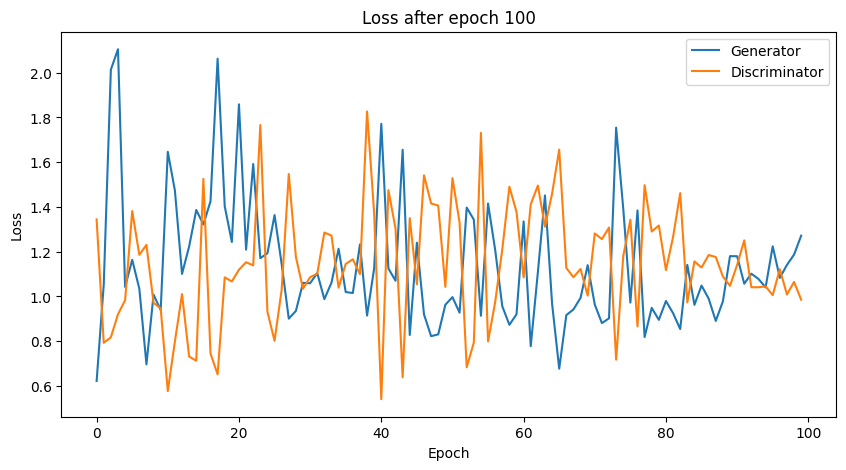

Time for epoch 100 is 2.987994909286499 sec
Time for epoch 101 is 0.8480842113494873 sec
Time for epoch 102 is 0.8694934844970703 sec
Time for epoch 103 is 0.8795716762542725 sec
Time for epoch 104 is 0.8838720321655273 sec
Time for epoch 105 is 0.8828957080841064 sec
Time for epoch 106 is 0.879657506942749 sec
Time for epoch 107 is 0.8874461650848389 sec
Time for epoch 108 is 0.8865299224853516 sec
Time for epoch 109 is 0.8884937763214111 sec
Time for epoch 110 is 0.8832612037658691 sec
Time for epoch 111 is 0.8892700672149658 sec
Time for epoch 112 is 0.8844363689422607 sec
Time for epoch 113 is 0.8857452869415283 sec
Time for epoch 114 is 0.8896420001983643 sec
Time for epoch 115 is 0.8904666900634766 sec
Time for epoch 116 is 0.8924112319946289 sec
Time for epoch 117 is 0.8909475803375244 sec
Time for epoch 118 is 0.8870134353637695 sec
Time for epoch 119 is 0.8909711837768555 sec
Time for epoch 120 is 0.8877120018005371 sec
Time for epoch 121 is 0.8921210765838623 sec
Time for epo

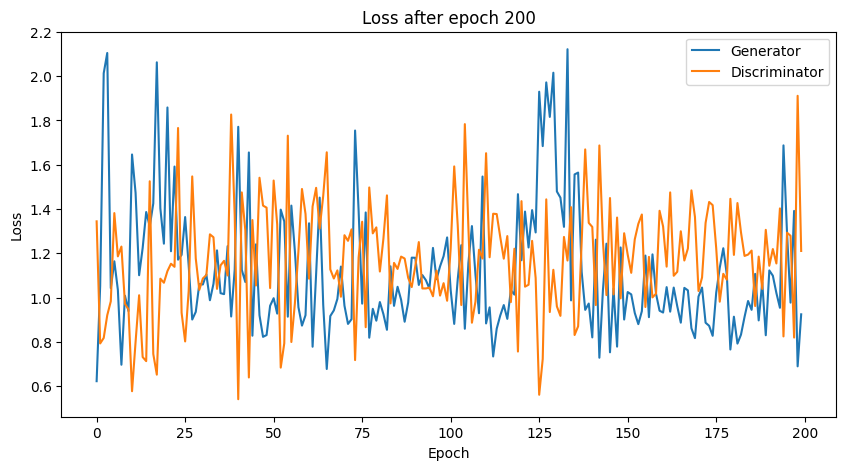

Time for epoch 200 is 2.9443061351776123 sec
Time for epoch 201 is 0.8631496429443359 sec
Time for epoch 202 is 0.8838491439819336 sec
Time for epoch 203 is 0.8819575309753418 sec
Time for epoch 204 is 0.8835115432739258 sec
Time for epoch 205 is 0.8856966495513916 sec
Time for epoch 206 is 0.8889915943145752 sec
Time for epoch 207 is 0.8910291194915771 sec
Time for epoch 208 is 0.8851234912872314 sec
Time for epoch 209 is 0.8894546031951904 sec
Time for epoch 210 is 0.8898169994354248 sec
Time for epoch 211 is 0.8937103748321533 sec
Time for epoch 212 is 0.8938961029052734 sec
Time for epoch 213 is 0.8917732238769531 sec
Time for epoch 214 is 0.8869209289550781 sec
Time for epoch 215 is 0.8903281688690186 sec
Time for epoch 216 is 0.8956186771392822 sec
Time for epoch 217 is 0.8917357921600342 sec
Time for epoch 218 is 0.8892464637756348 sec
Time for epoch 219 is 0.8950543403625488 sec
Time for epoch 220 is 0.8941278457641602 sec
Time for epoch 221 is 0.894460916519165 sec
Time for ep

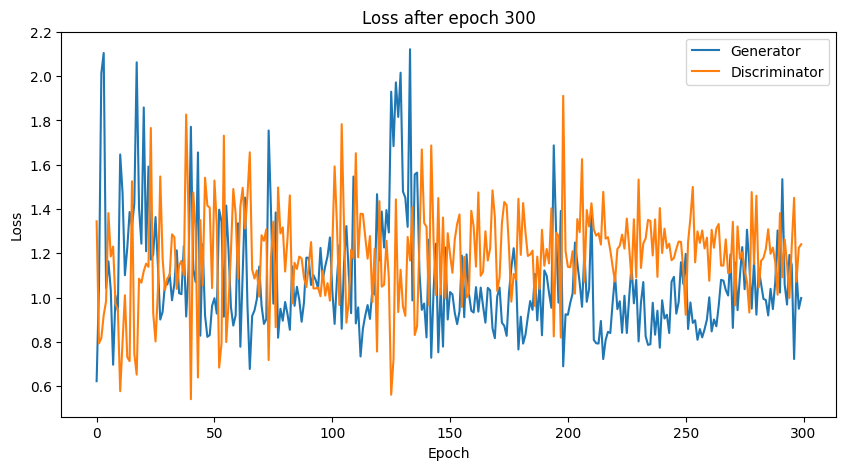

Time for epoch 300 is 3.3151121139526367 sec
Time for epoch 301 is 0.854271411895752 sec
Time for epoch 302 is 0.8773903846740723 sec
Time for epoch 303 is 0.8807580471038818 sec
Time for epoch 304 is 0.8836801052093506 sec
Time for epoch 305 is 0.884174108505249 sec
Time for epoch 306 is 0.8828909397125244 sec
Time for epoch 307 is 0.8859355449676514 sec
Time for epoch 308 is 0.8940756320953369 sec
Time for epoch 309 is 0.8883507251739502 sec
Time for epoch 310 is 0.8854038715362549 sec
Time for epoch 311 is 0.8870265483856201 sec
Time for epoch 312 is 0.8979909420013428 sec
Time for epoch 313 is 0.8876214027404785 sec
Time for epoch 314 is 0.8921983242034912 sec
Time for epoch 315 is 0.8898375034332275 sec
Time for epoch 316 is 0.8915956020355225 sec
Time for epoch 317 is 0.8926050662994385 sec
Time for epoch 318 is 0.888221025466919 sec
Time for epoch 319 is 0.8891699314117432 sec
Time for epoch 320 is 0.8916871547698975 sec
Time for epoch 321 is 0.8950352668762207 sec
Time for epoc

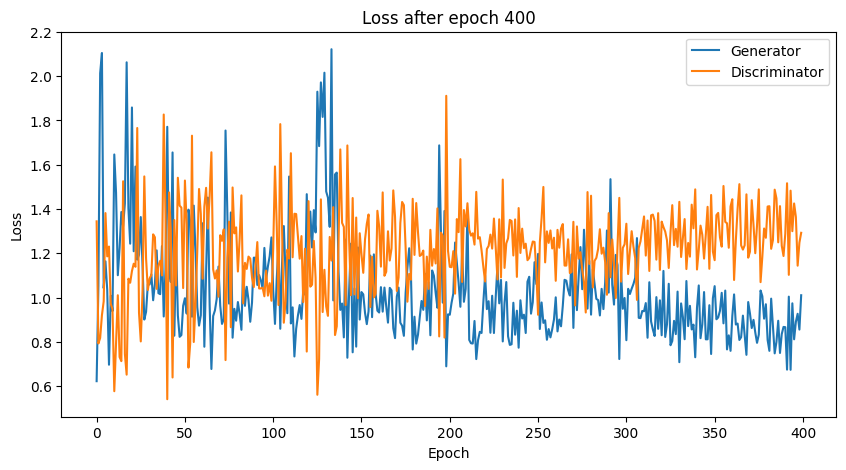

Time for epoch 400 is 3.209043025970459 sec
Time for epoch 401 is 0.8758141994476318 sec
Time for epoch 402 is 0.8719453811645508 sec
Time for epoch 403 is 0.8779926300048828 sec
Time for epoch 404 is 0.8775608539581299 sec
Time for epoch 405 is 0.8847923278808594 sec
Time for epoch 406 is 0.8815481662750244 sec
Time for epoch 407 is 0.8839671611785889 sec
Time for epoch 408 is 0.8883450031280518 sec
Time for epoch 409 is 0.8864691257476807 sec
Time for epoch 410 is 0.8877291679382324 sec
Time for epoch 411 is 0.890261173248291 sec
Time for epoch 412 is 0.8842904567718506 sec
Time for epoch 413 is 0.8885254859924316 sec
Time for epoch 414 is 0.8915755748748779 sec
Time for epoch 415 is 0.893080472946167 sec
Time for epoch 416 is 0.8890910148620605 sec
Time for epoch 417 is 0.8861441612243652 sec
Time for epoch 418 is 0.8933601379394531 sec
Time for epoch 419 is 0.8891985416412354 sec
Time for epoch 420 is 0.8939383029937744 sec
Time for epoch 421 is 0.8912932872772217 sec
Time for epoc

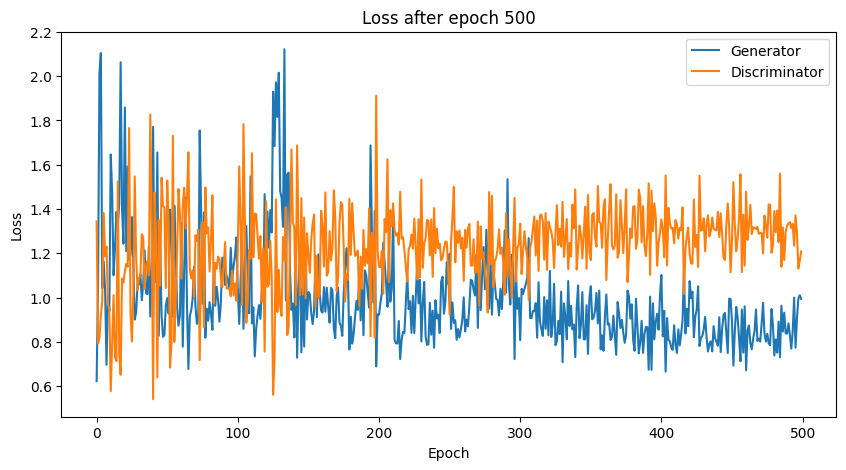

Time for epoch 500 is 3.244739055633545 sec
Time for epoch 501 is 0.8693339824676514 sec
Time for epoch 502 is 0.8703293800354004 sec
Time for epoch 503 is 0.8786072731018066 sec
Time for epoch 504 is 0.8874516487121582 sec
Time for epoch 505 is 1.2639479637145996 sec
Time for epoch 506 is 0.8635318279266357 sec
Time for epoch 507 is 0.8889830112457275 sec
Time for epoch 508 is 0.8825469017028809 sec
Time for epoch 509 is 0.8849661350250244 sec
Time for epoch 510 is 0.8854777812957764 sec
Time for epoch 511 is 0.8851757049560547 sec
Time for epoch 512 is 0.8885200023651123 sec
Time for epoch 513 is 0.8905208110809326 sec
Time for epoch 514 is 0.8876078128814697 sec
Time for epoch 515 is 0.8945877552032471 sec
Time for epoch 516 is 0.8888905048370361 sec
Time for epoch 517 is 0.8896753787994385 sec
Time for epoch 518 is 0.8893880844116211 sec
Time for epoch 519 is 0.890148401260376 sec
Time for epoch 520 is 0.8954882621765137 sec
Time for epoch 521 is 0.8939251899719238 sec
Time for epo

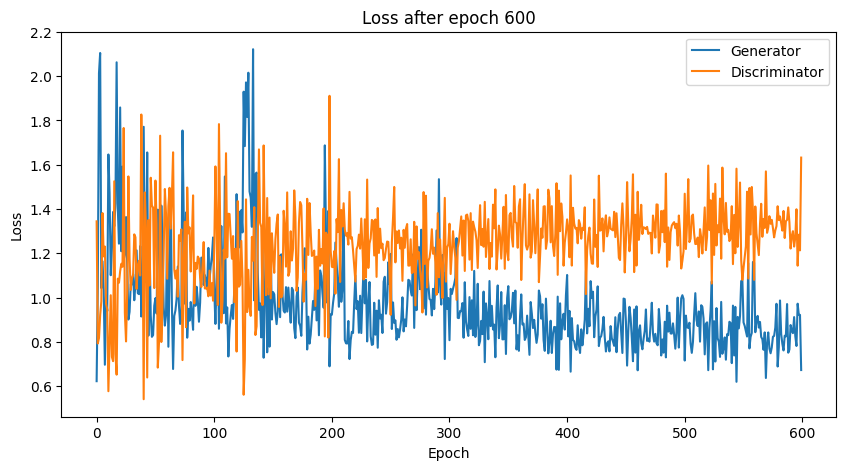

Time for epoch 600 is 3.413882255554199 sec
Time for epoch 601 is 0.8667798042297363 sec
Time for epoch 602 is 0.8845596313476562 sec
Time for epoch 603 is 0.8717467784881592 sec
Time for epoch 604 is 0.8824949264526367 sec
Time for epoch 605 is 0.8811590671539307 sec
Time for epoch 606 is 0.8817884922027588 sec
Time for epoch 607 is 0.8861029148101807 sec
Time for epoch 608 is 0.8832335472106934 sec
Time for epoch 609 is 0.8851170539855957 sec
Time for epoch 610 is 0.88858962059021 sec
Time for epoch 611 is 0.8800997734069824 sec
Time for epoch 612 is 0.8946082592010498 sec
Time for epoch 613 is 0.8836462497711182 sec
Time for epoch 614 is 0.8908109664916992 sec
Time for epoch 615 is 0.8890676498413086 sec
Time for epoch 616 is 0.8866615295410156 sec
Time for epoch 617 is 0.8941688537597656 sec
Time for epoch 618 is 0.8876204490661621 sec
Time for epoch 619 is 0.8920538425445557 sec
Time for epoch 620 is 0.8876519203186035 sec
Time for epoch 621 is 0.8903579711914062 sec
Time for epoc

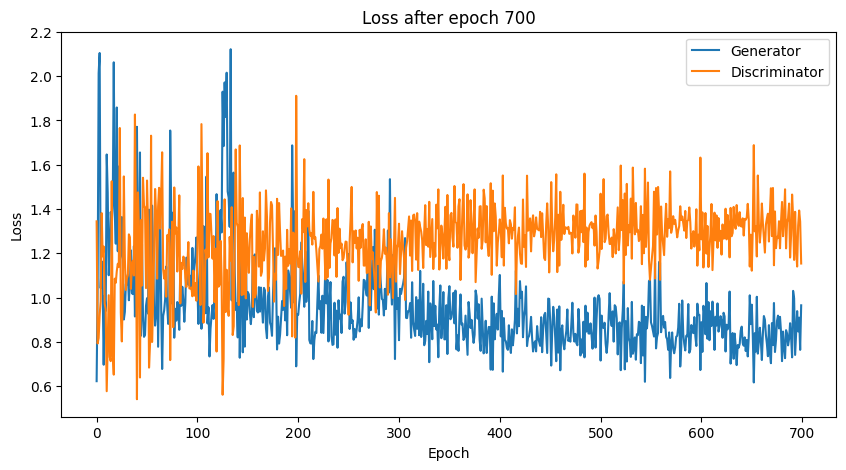

Time for epoch 700 is 3.270765781402588 sec
Time for epoch 701 is 0.8633632659912109 sec
Time for epoch 702 is 0.8713054656982422 sec
Time for epoch 703 is 0.8801519870758057 sec
Time for epoch 704 is 0.8790662288665771 sec
Time for epoch 705 is 0.879629373550415 sec
Time for epoch 706 is 0.8837606906890869 sec
Time for epoch 707 is 0.8903753757476807 sec
Time for epoch 708 is 0.8824028968811035 sec
Time for epoch 709 is 0.8885657787322998 sec
Time for epoch 710 is 0.8851244449615479 sec
Time for epoch 711 is 0.8877358436584473 sec
Time for epoch 712 is 0.8873672485351562 sec
Time for epoch 713 is 0.8875846862792969 sec
Time for epoch 714 is 0.8847293853759766 sec
Time for epoch 715 is 0.8944311141967773 sec
Time for epoch 716 is 0.8865578174591064 sec
Time for epoch 717 is 0.8930473327636719 sec
Time for epoch 718 is 0.8883233070373535 sec
Time for epoch 719 is 0.8937888145446777 sec
Time for epoch 720 is 0.8915989398956299 sec
Time for epoch 721 is 0.8892471790313721 sec
Time for epo

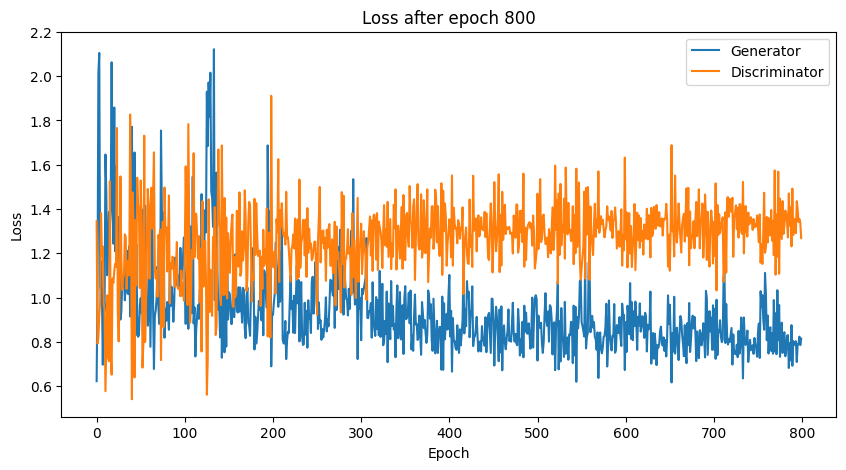

Time for epoch 800 is 3.497922420501709 sec
Time for epoch 801 is 0.858773946762085 sec
Time for epoch 802 is 0.8682856559753418 sec
Time for epoch 803 is 0.8726897239685059 sec
Time for epoch 804 is 0.873563289642334 sec
Time for epoch 805 is 0.8769264221191406 sec
Time for epoch 806 is 0.8803732395172119 sec
Time for epoch 807 is 0.8824512958526611 sec
Time for epoch 808 is 0.875791072845459 sec
Time for epoch 809 is 0.8822789192199707 sec
Time for epoch 810 is 0.8850092887878418 sec
Time for epoch 811 is 0.8886704444885254 sec
Time for epoch 812 is 0.8869624137878418 sec
Time for epoch 813 is 0.8859148025512695 sec
Time for epoch 814 is 0.8845820426940918 sec
Time for epoch 815 is 0.8893616199493408 sec
Time for epoch 816 is 0.8940064907073975 sec
Time for epoch 817 is 0.8875315189361572 sec
Time for epoch 818 is 0.8867716789245605 sec
Time for epoch 819 is 0.8934187889099121 sec
Time for epoch 820 is 0.8912386894226074 sec
Time for epoch 821 is 0.8884856700897217 sec
Time for epoch

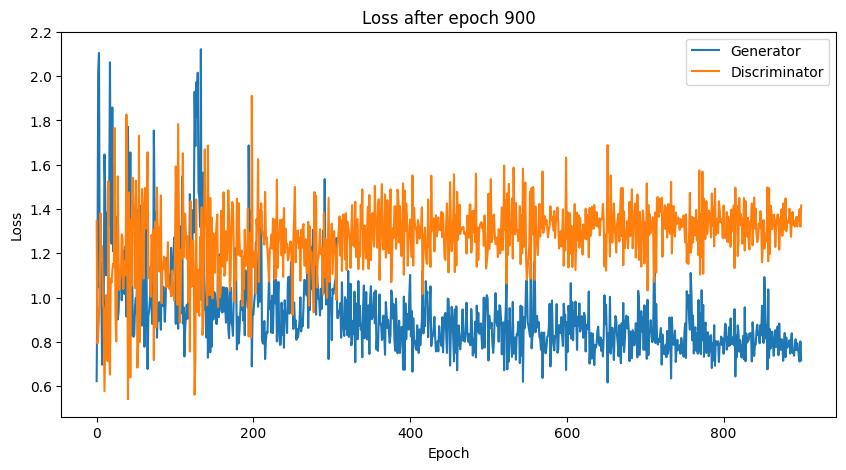

Time for epoch 900 is 3.346712350845337 sec
Time for epoch 901 is 0.8659443855285645 sec
Time for epoch 902 is 0.8724300861358643 sec
Time for epoch 903 is 0.8738892078399658 sec
Time for epoch 904 is 0.8783884048461914 sec
Time for epoch 905 is 0.872718334197998 sec
Time for epoch 906 is 0.8833763599395752 sec
Time for epoch 907 is 0.8753767013549805 sec
Time for epoch 908 is 0.883676290512085 sec
Time for epoch 909 is 0.8820509910583496 sec
Time for epoch 910 is 0.8810937404632568 sec
Time for epoch 911 is 0.8859939575195312 sec
Time for epoch 912 is 0.8831439018249512 sec
Time for epoch 913 is 0.8905985355377197 sec
Time for epoch 914 is 0.8905611038208008 sec
Time for epoch 915 is 0.885573148727417 sec
Time for epoch 916 is 0.8844573497772217 sec
Time for epoch 917 is 0.8865792751312256 sec
Time for epoch 918 is 0.8889667987823486 sec
Time for epoch 919 is 0.8860399723052979 sec
Time for epoch 920 is 0.8878757953643799 sec
Time for epoch 921 is 0.8874046802520752 sec
Time for epoch

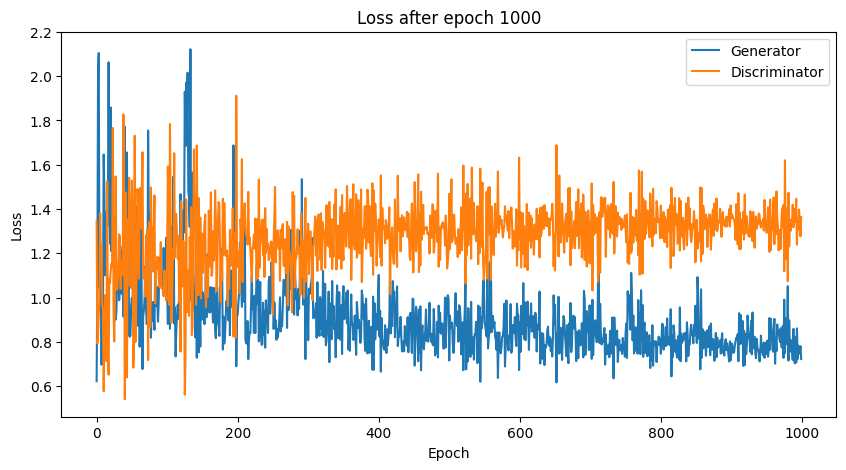

Time for epoch 1000 is 3.2960963249206543 sec
Time for epoch 1001 is 0.8585972785949707 sec
Time for epoch 1002 is 0.8674070835113525 sec
Time for epoch 1003 is 0.8763508796691895 sec
Time for epoch 1004 is 0.8816332817077637 sec
Time for epoch 1005 is 0.8830702304840088 sec
Time for epoch 1006 is 0.8865430355072021 sec
Time for epoch 1007 is 0.8813858032226562 sec
Time for epoch 1008 is 0.8822891712188721 sec
Time for epoch 1009 is 0.8831295967102051 sec
Time for epoch 1010 is 0.8864860534667969 sec
Time for epoch 1011 is 0.887808084487915 sec
Time for epoch 1012 is 0.8887715339660645 sec
Time for epoch 1013 is 0.8874063491821289 sec
Time for epoch 1014 is 0.8868474960327148 sec
Time for epoch 1015 is 0.8866088390350342 sec
Time for epoch 1016 is 0.8870425224304199 sec
Time for epoch 1017 is 0.8912348747253418 sec
Time for epoch 1018 is 0.8876686096191406 sec
Time for epoch 1019 is 0.8866827487945557 sec
Time for epoch 1020 is 0.8894338607788086 sec
Time for epoch 1021 is 0.8849725723

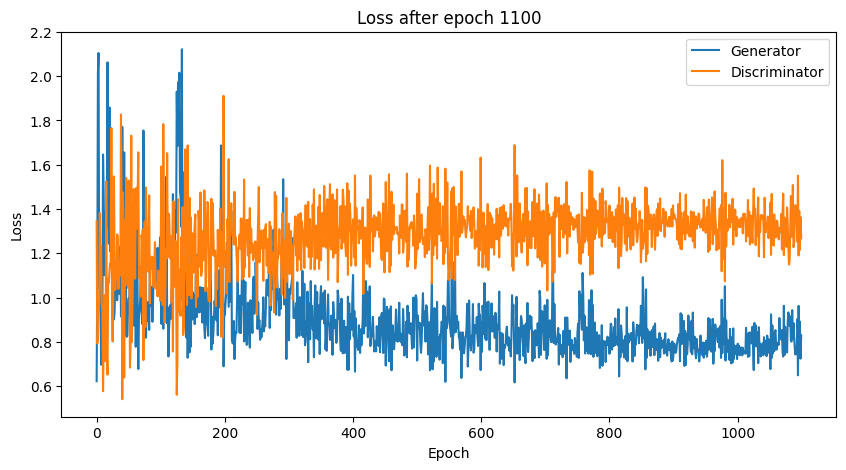

Time for epoch 1100 is 3.5081257820129395 sec
Time for epoch 1101 is 0.867544412612915 sec
Time for epoch 1102 is 0.8745255470275879 sec
Time for epoch 1103 is 0.8725156784057617 sec
Time for epoch 1104 is 0.8745191097259521 sec
Time for epoch 1105 is 0.880615234375 sec
Time for epoch 1106 is 0.8773772716522217 sec
Time for epoch 1107 is 0.8850789070129395 sec
Time for epoch 1108 is 0.8880133628845215 sec
Time for epoch 1109 is 0.88631272315979 sec
Time for epoch 1110 is 0.8839020729064941 sec
Time for epoch 1111 is 0.8907406330108643 sec
Time for epoch 1112 is 0.8881447315216064 sec
Time for epoch 1113 is 0.8865921497344971 sec
Time for epoch 1114 is 0.8867161273956299 sec
Time for epoch 1115 is 0.893183708190918 sec
Time for epoch 1116 is 0.8877534866333008 sec
Time for epoch 1117 is 0.8867752552032471 sec
Time for epoch 1118 is 0.8889942169189453 sec
Time for epoch 1119 is 0.8855738639831543 sec
Time for epoch 1120 is 0.8894720077514648 sec
Time for epoch 1121 is 0.8860242366790771 

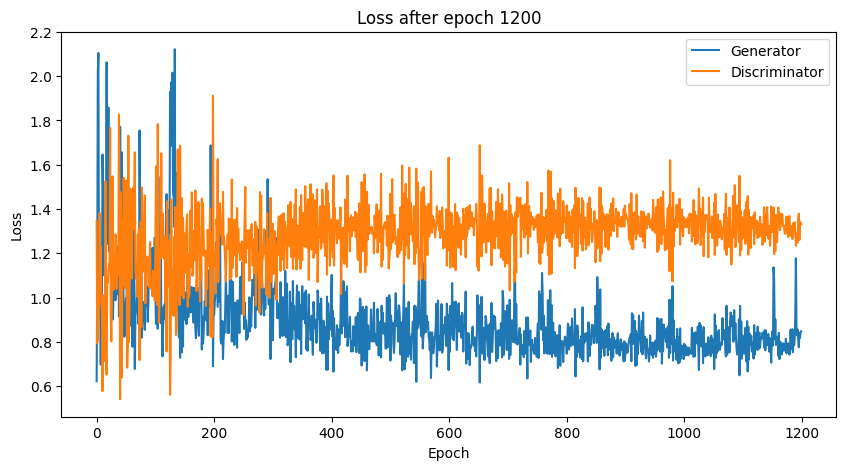

Time for epoch 1200 is 3.3090178966522217 sec
Time for epoch 1201 is 0.8577852249145508 sec
Time for epoch 1202 is 0.8715524673461914 sec
Time for epoch 1203 is 0.8735761642456055 sec
Time for epoch 1204 is 0.876204252243042 sec
Time for epoch 1205 is 0.8778176307678223 sec
Time for epoch 1206 is 0.8828825950622559 sec
Time for epoch 1207 is 0.8824982643127441 sec
Time for epoch 1208 is 0.8758518695831299 sec
Time for epoch 1209 is 0.8866324424743652 sec
Time for epoch 1210 is 0.8830325603485107 sec
Time for epoch 1211 is 0.8829653263092041 sec
Time for epoch 1212 is 0.8850274085998535 sec
Time for epoch 1213 is 0.8883481025695801 sec
Time for epoch 1214 is 0.8890671730041504 sec
Time for epoch 1215 is 0.8828761577606201 sec
Time for epoch 1216 is 0.8893370628356934 sec
Time for epoch 1217 is 0.8932173252105713 sec
Time for epoch 1218 is 0.8892083168029785 sec
Time for epoch 1219 is 0.8903403282165527 sec
Time for epoch 1220 is 0.8854489326477051 sec
Time for epoch 1221 is 0.8893234729

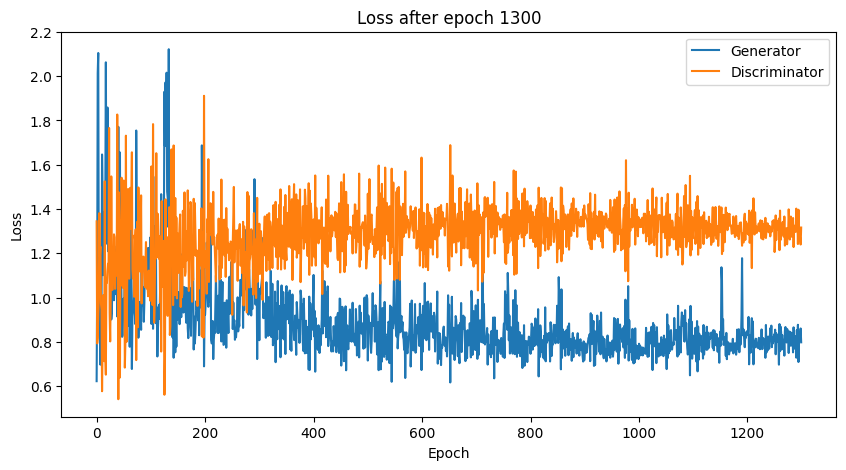

Time for epoch 1300 is 3.5224452018737793 sec
Time for epoch 1301 is 0.8627626895904541 sec
Time for epoch 1302 is 0.8712360858917236 sec
Time for epoch 1303 is 0.8724217414855957 sec
Time for epoch 1304 is 0.8772814273834229 sec
Time for epoch 1305 is 0.8762533664703369 sec
Time for epoch 1306 is 0.876378059387207 sec
Time for epoch 1307 is 0.8823399543762207 sec
Time for epoch 1308 is 0.8838169574737549 sec
Time for epoch 1309 is 0.8827018737792969 sec
Time for epoch 1310 is 0.8805623054504395 sec
Time for epoch 1311 is 0.8843250274658203 sec
Time for epoch 1312 is 0.8841874599456787 sec
Time for epoch 1313 is 0.8850953578948975 sec
Time for epoch 1314 is 0.886451244354248 sec
Time for epoch 1315 is 0.8903958797454834 sec
Time for epoch 1316 is 0.8837132453918457 sec
Time for epoch 1317 is 0.8888981342315674 sec
Time for epoch 1318 is 0.8923912048339844 sec
Time for epoch 1319 is 0.8933498859405518 sec
Time for epoch 1320 is 0.8888862133026123 sec
Time for epoch 1321 is 0.88609600067

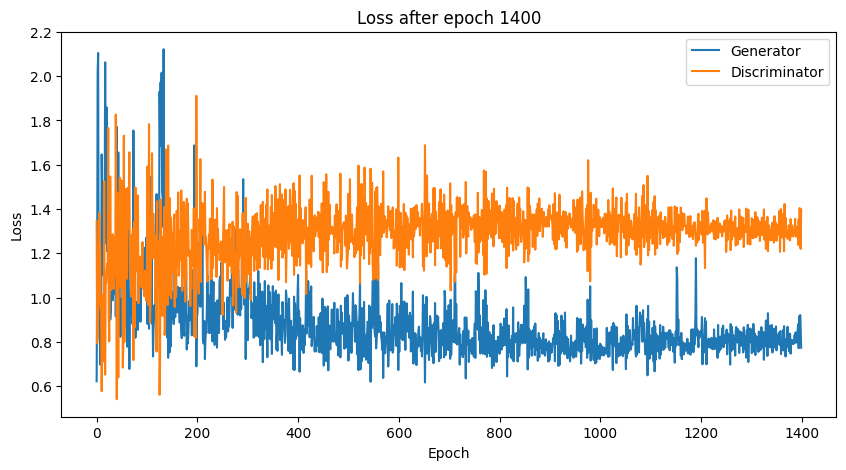

Time for epoch 1400 is 3.3389906883239746 sec
Time for epoch 1401 is 0.8566100597381592 sec
Time for epoch 1402 is 0.8710191249847412 sec
Time for epoch 1403 is 0.8770849704742432 sec
Time for epoch 1404 is 0.8793175220489502 sec
Time for epoch 1405 is 0.8806233406066895 sec
Time for epoch 1406 is 0.8797643184661865 sec
Time for epoch 1407 is 0.8804543018341064 sec
Time for epoch 1408 is 0.8868494033813477 sec
Time for epoch 1409 is 0.8827779293060303 sec
Time for epoch 1410 is 0.8858213424682617 sec
Time for epoch 1411 is 0.8801946640014648 sec
Time for epoch 1412 is 0.8851625919342041 sec
Time for epoch 1413 is 0.8838486671447754 sec
Time for epoch 1414 is 0.8912763595581055 sec
Time for epoch 1415 is 0.8909156322479248 sec
Time for epoch 1416 is 0.888437032699585 sec
Time for epoch 1417 is 0.8916404247283936 sec
Time for epoch 1418 is 0.8863720893859863 sec
Time for epoch 1419 is 0.8898253440856934 sec
Time for epoch 1420 is 0.8905448913574219 sec
Time for epoch 1421 is 0.8917839527

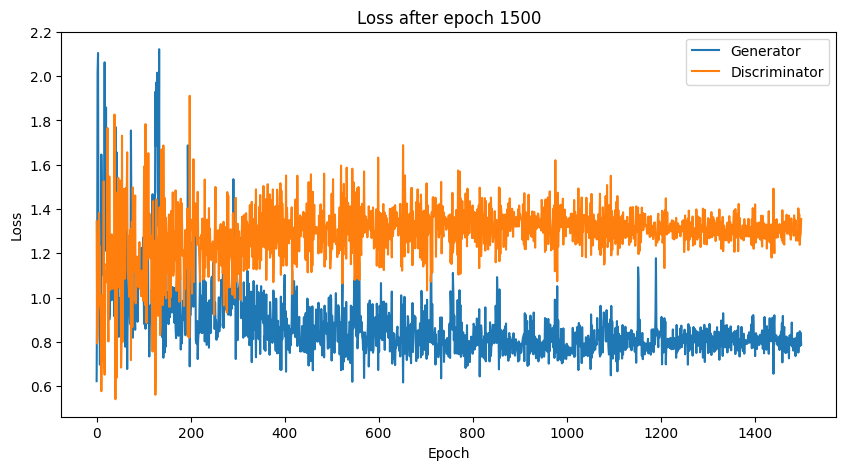

Time for epoch 1500 is 3.3713438510894775 sec
Time for epoch 1501 is 0.871269702911377 sec
Time for epoch 1502 is 0.8698849678039551 sec
Time for epoch 1503 is 0.8724372386932373 sec
Time for epoch 1504 is 0.8742735385894775 sec
Time for epoch 1505 is 0.8806471824645996 sec
Time for epoch 1506 is 0.8792948722839355 sec
Time for epoch 1507 is 0.8793966770172119 sec
Time for epoch 1508 is 0.8850724697113037 sec
Time for epoch 1509 is 0.8808693885803223 sec
Time for epoch 1510 is 0.8796062469482422 sec
Time for epoch 1511 is 0.8838582038879395 sec
Time for epoch 1512 is 0.8839914798736572 sec
Time for epoch 1513 is 0.8837258815765381 sec
Time for epoch 1514 is 0.886228084564209 sec
Time for epoch 1515 is 0.8847553730010986 sec
Time for epoch 1516 is 0.889265775680542 sec
Time for epoch 1517 is 0.8887968063354492 sec
Time for epoch 1518 is 0.8882095813751221 sec
Time for epoch 1519 is 0.8867495059967041 sec
Time for epoch 1520 is 0.8877863883972168 sec
Time for epoch 1521 is 0.886959791183

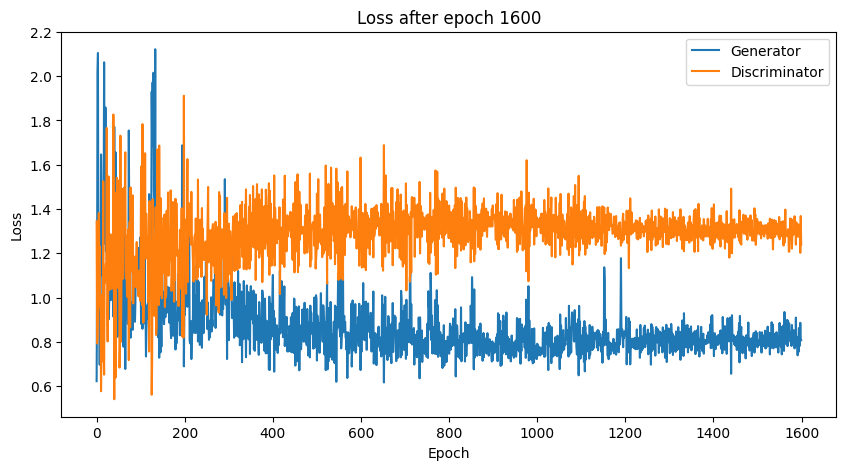

Time for epoch 1600 is 3.5570168495178223 sec
Time for epoch 1601 is 0.8629040718078613 sec
Time for epoch 1602 is 0.8667006492614746 sec
Time for epoch 1603 is 0.8727316856384277 sec
Time for epoch 1604 is 0.8792972564697266 sec
Time for epoch 1605 is 0.881690502166748 sec
Time for epoch 1606 is 0.8795368671417236 sec
Time for epoch 1607 is 0.8840804100036621 sec
Time for epoch 1608 is 0.8818538188934326 sec
Time for epoch 1609 is 0.8878283500671387 sec
Time for epoch 1610 is 0.8845036029815674 sec
Time for epoch 1611 is 0.8837611675262451 sec
Time for epoch 1612 is 0.8860933780670166 sec
Time for epoch 1613 is 0.8796257972717285 sec
Time for epoch 1614 is 0.8832182884216309 sec
Time for epoch 1615 is 0.889944314956665 sec
Time for epoch 1616 is 0.88883376121521 sec
Time for epoch 1617 is 0.8872411251068115 sec
Time for epoch 1618 is 0.8818840980529785 sec
Time for epoch 1619 is 0.893721342086792 sec
Time for epoch 1620 is 0.8863296508789062 sec
Time for epoch 1621 is 0.88757872581481

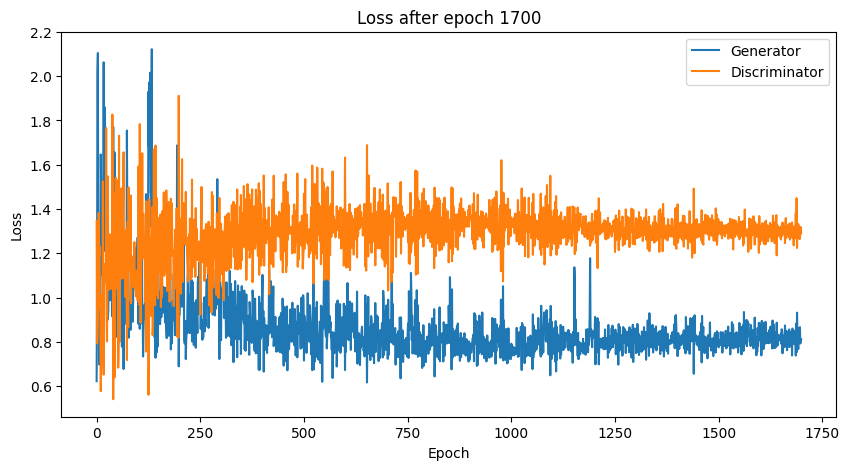

Time for epoch 1700 is 3.398160934448242 sec
Time for epoch 1701 is 0.8563251495361328 sec
Time for epoch 1702 is 0.8708443641662598 sec
Time for epoch 1703 is 0.8785355091094971 sec
Time for epoch 1704 is 0.8697192668914795 sec
Time for epoch 1705 is 0.8824868202209473 sec
Time for epoch 1706 is 0.8787117004394531 sec
Time for epoch 1707 is 0.8832418918609619 sec
Time for epoch 1708 is 0.8830206394195557 sec
Time for epoch 1709 is 0.8855786323547363 sec
Time for epoch 1710 is 0.8873624801635742 sec
Time for epoch 1711 is 0.8875958919525146 sec
Time for epoch 1712 is 0.8817458152770996 sec
Time for epoch 1713 is 0.8857982158660889 sec
Time for epoch 1714 is 0.8873658180236816 sec
Time for epoch 1715 is 0.8889830112457275 sec
Time for epoch 1716 is 0.8837809562683105 sec
Time for epoch 1717 is 0.8862276077270508 sec
Time for epoch 1718 is 0.8925900459289551 sec
Time for epoch 1719 is 0.8817987442016602 sec
Time for epoch 1720 is 0.883988618850708 sec
Time for epoch 1721 is 0.89057898521

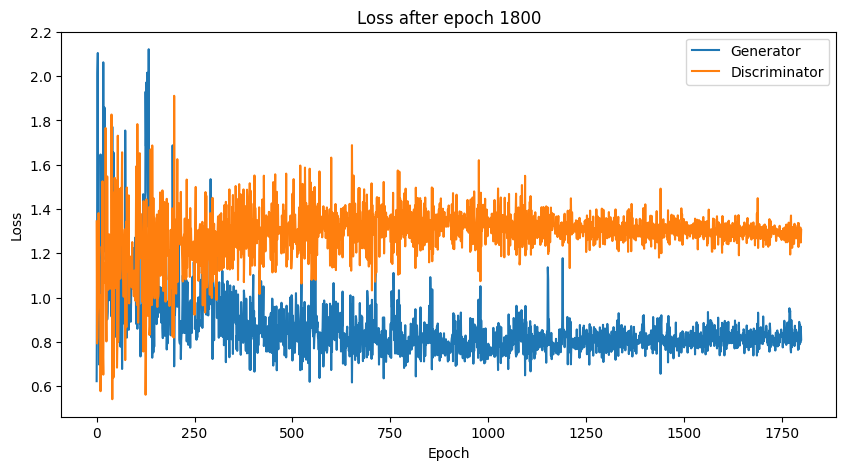

Time for epoch 1800 is 3.574077844619751 sec
Time for epoch 1801 is 0.8580856323242188 sec
Time for epoch 1802 is 0.8649718761444092 sec
Time for epoch 1803 is 0.8748478889465332 sec
Time for epoch 1804 is 0.870856523513794 sec
Time for epoch 1805 is 0.8745510578155518 sec
Time for epoch 1806 is 0.8760716915130615 sec
Time for epoch 1807 is 0.8783786296844482 sec
Time for epoch 1808 is 0.8768510818481445 sec
Time for epoch 1809 is 0.8828682899475098 sec
Time for epoch 1810 is 0.8825235366821289 sec
Time for epoch 1811 is 0.8837344646453857 sec
Time for epoch 1812 is 0.8886973857879639 sec
Time for epoch 1813 is 0.8884313106536865 sec
Time for epoch 1814 is 0.887458086013794 sec
Time for epoch 1815 is 0.890906572341919 sec
Time for epoch 1816 is 0.8875176906585693 sec
Time for epoch 1817 is 0.8896582126617432 sec
Time for epoch 1818 is 0.8860297203063965 sec
Time for epoch 1819 is 0.8854615688323975 sec
Time for epoch 1820 is 0.8899273872375488 sec
Time for epoch 1821 is 0.8871808052062

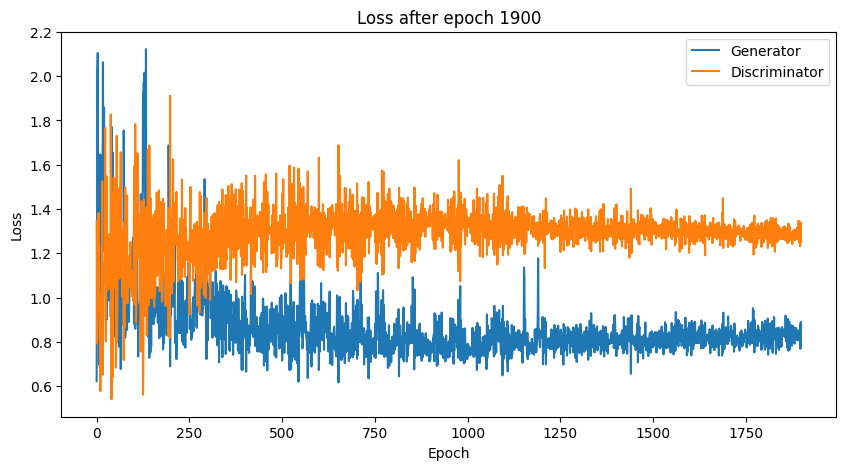

Time for epoch 1900 is 3.3480489253997803 sec
Time for epoch 1901 is 0.8640162944793701 sec
Time for epoch 1902 is 0.8692710399627686 sec
Time for epoch 1903 is 0.8737189769744873 sec
Time for epoch 1904 is 0.8771228790283203 sec
Time for epoch 1905 is 0.8789217472076416 sec
Time for epoch 1906 is 0.8775298595428467 sec
Time for epoch 1907 is 0.8794028759002686 sec
Time for epoch 1908 is 0.8837053775787354 sec
Time for epoch 1909 is 0.887352705001831 sec
Time for epoch 1910 is 0.8863968849182129 sec
Time for epoch 1911 is 0.8855769634246826 sec
Time for epoch 1912 is 0.8814592361450195 sec
Time for epoch 1913 is 0.8857548236846924 sec
Time for epoch 1914 is 0.8836088180541992 sec
Time for epoch 1915 is 0.8894813060760498 sec
Time for epoch 1916 is 0.8794000148773193 sec
Time for epoch 1917 is 0.8877890110015869 sec
Time for epoch 1918 is 0.8920252323150635 sec
Time for epoch 1919 is 0.8873963356018066 sec
Time for epoch 1920 is 0.8906145095825195 sec
Time for epoch 1921 is 0.8899993896

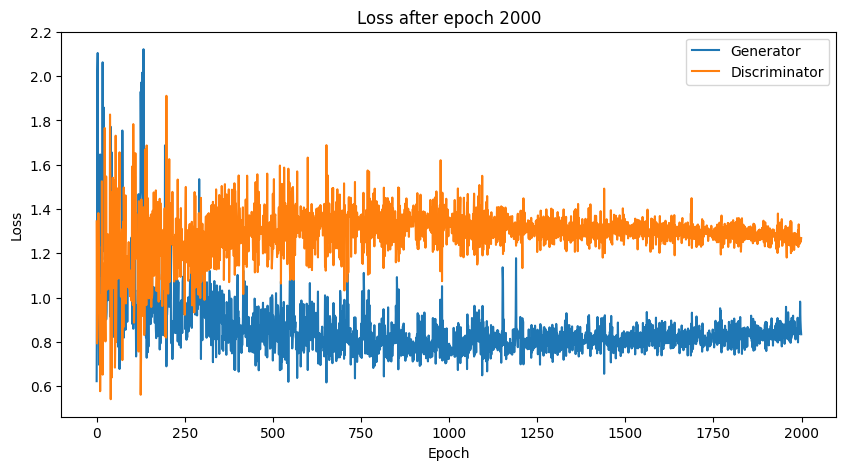

Time for epoch 2000 is 3.516948938369751 sec
Time for epoch 2001 is 0.8506996631622314 sec
Time for epoch 2002 is 0.8763391971588135 sec
Time for epoch 2003 is 0.8757030963897705 sec
Time for epoch 2004 is 0.8780262470245361 sec
Time for epoch 2005 is 0.8764183521270752 sec
Time for epoch 2006 is 0.8846583366394043 sec
Time for epoch 2007 is 0.8860182762145996 sec
Time for epoch 2008 is 0.8802673816680908 sec
Time for epoch 2009 is 0.8885185718536377 sec
Time for epoch 2010 is 0.8807730674743652 sec
Time for epoch 2011 is 0.8816847801208496 sec
Time for epoch 2012 is 0.8834421634674072 sec
Time for epoch 2013 is 0.8840456008911133 sec
Time for epoch 2014 is 0.8860976696014404 sec
Time for epoch 2015 is 0.8843624591827393 sec
Time for epoch 2016 is 0.884692907333374 sec
Time for epoch 2017 is 0.8844528198242188 sec
Time for epoch 2018 is 0.8871676921844482 sec
Time for epoch 2019 is 0.8899967670440674 sec
Time for epoch 2020 is 0.887941837310791 sec
Time for epoch 2021 is 0.884710550308

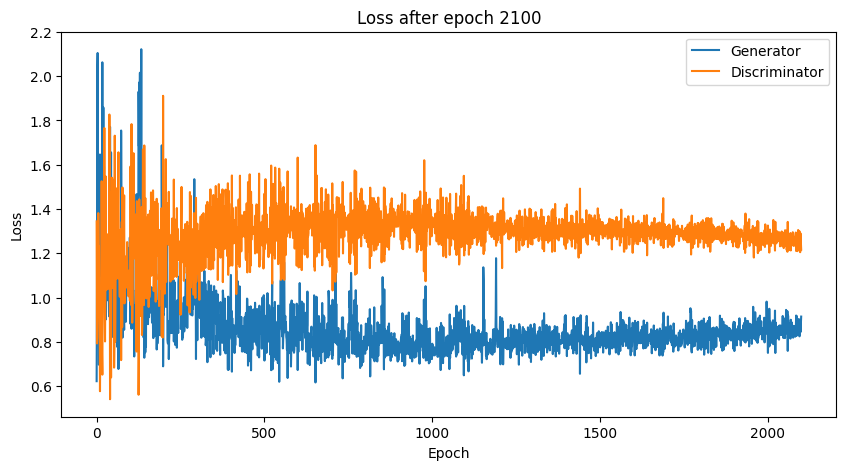

Time for epoch 2100 is 3.332368850708008 sec
Time for epoch 2101 is 0.8587627410888672 sec
Time for epoch 2102 is 0.8667144775390625 sec
Time for epoch 2103 is 0.8696193695068359 sec
Time for epoch 2104 is 0.8826322555541992 sec
Time for epoch 2105 is 0.878507137298584 sec
Time for epoch 2106 is 0.8851478099822998 sec
Time for epoch 2107 is 0.8788943290710449 sec
Time for epoch 2108 is 0.8772084712982178 sec
Time for epoch 2109 is 0.8869941234588623 sec
Time for epoch 2110 is 0.8867478370666504 sec
Time for epoch 2111 is 0.8776538372039795 sec
Time for epoch 2112 is 0.8870992660522461 sec
Time for epoch 2113 is 0.8860030174255371 sec
Time for epoch 2114 is 0.884850263595581 sec
Time for epoch 2115 is 0.8911688327789307 sec
Time for epoch 2116 is 0.890021562576294 sec
Time for epoch 2117 is 0.8820924758911133 sec
Time for epoch 2118 is 0.8900697231292725 sec
Time for epoch 2119 is 0.8881144523620605 sec
Time for epoch 2120 is 0.888237476348877 sec
Time for epoch 2121 is 0.88805198669433

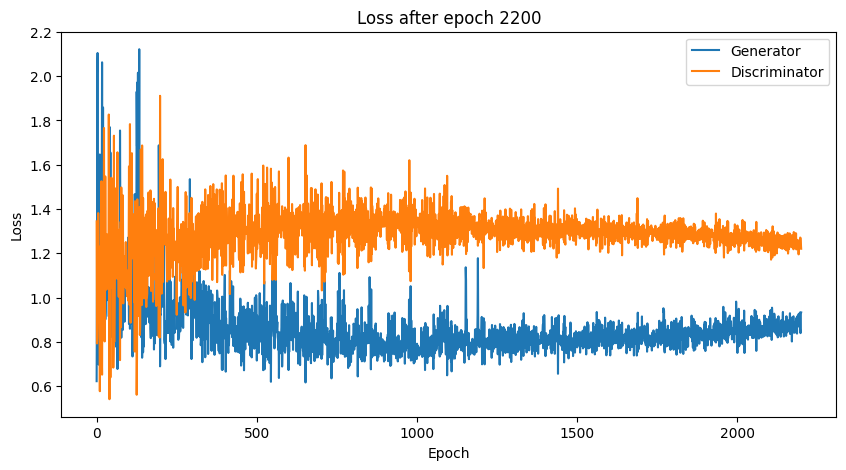

Time for epoch 2200 is 3.4133517742156982 sec
Time for epoch 2201 is 0.8650181293487549 sec
Time for epoch 2202 is 0.8720552921295166 sec
Time for epoch 2203 is 0.87644362449646 sec
Time for epoch 2204 is 0.8769071102142334 sec
Time for epoch 2205 is 0.881232500076294 sec
Time for epoch 2206 is 0.8826735019683838 sec
Time for epoch 2207 is 0.8818104267120361 sec
Time for epoch 2208 is 0.8836572170257568 sec
Time for epoch 2209 is 0.8800821304321289 sec
Time for epoch 2210 is 0.8886072635650635 sec
Time for epoch 2211 is 0.8927006721496582 sec
Time for epoch 2212 is 0.8855111598968506 sec
Time for epoch 2213 is 0.8862836360931396 sec
Time for epoch 2214 is 0.889549732208252 sec
Time for epoch 2215 is 0.8866879940032959 sec
Time for epoch 2216 is 0.8865563869476318 sec
Time for epoch 2217 is 0.8925201892852783 sec
Time for epoch 2218 is 0.8888270854949951 sec
Time for epoch 2219 is 0.88283371925354 sec
Time for epoch 2220 is 0.8886728286743164 sec
Time for epoch 2221 is 0.883035659790039

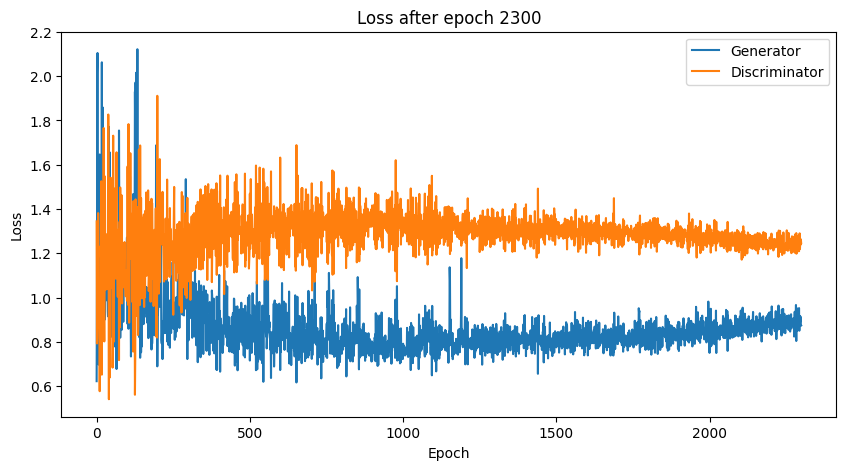

Time for epoch 2300 is 3.6061575412750244 sec
Time for epoch 2301 is 0.8705482482910156 sec
Time for epoch 2302 is 0.8673593997955322 sec
Time for epoch 2303 is 0.8700447082519531 sec
Time for epoch 2304 is 0.8773996829986572 sec
Time for epoch 2305 is 0.8844857215881348 sec
Time for epoch 2306 is 0.8805041313171387 sec
Time for epoch 2307 is 0.8774309158325195 sec
Time for epoch 2308 is 0.8777527809143066 sec
Time for epoch 2309 is 0.8834002017974854 sec
Time for epoch 2310 is 0.8810691833496094 sec
Time for epoch 2311 is 0.8856480121612549 sec
Time for epoch 2312 is 0.880573034286499 sec
Time for epoch 2313 is 0.8862121105194092 sec
Time for epoch 2314 is 0.893707275390625 sec
Time for epoch 2315 is 0.8874328136444092 sec
Time for epoch 2316 is 0.886754035949707 sec
Time for epoch 2317 is 0.8867347240447998 sec
Time for epoch 2318 is 0.8903920650482178 sec
Time for epoch 2319 is 0.8879563808441162 sec
Time for epoch 2320 is 0.8916435241699219 sec
Time for epoch 2321 is 0.886269330978

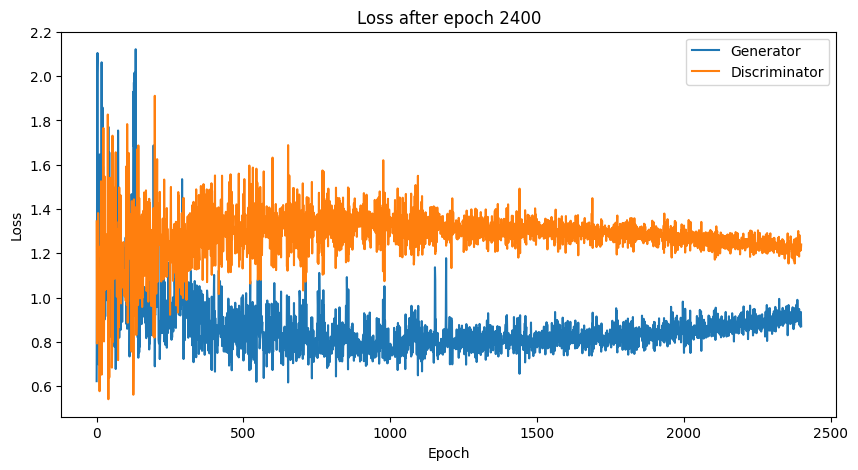

Time for epoch 2400 is 3.3649842739105225 sec
Time for epoch 2401 is 0.866755485534668 sec
Time for epoch 2402 is 0.8646066188812256 sec
Time for epoch 2403 is 0.87290358543396 sec
Time for epoch 2404 is 0.8769857883453369 sec
Time for epoch 2405 is 0.8777282238006592 sec
Time for epoch 2406 is 0.8830928802490234 sec
Time for epoch 2407 is 0.8846750259399414 sec
Time for epoch 2408 is 0.8817727565765381 sec
Time for epoch 2409 is 0.886742353439331 sec
Time for epoch 2410 is 0.879840612411499 sec
Time for epoch 2411 is 0.8919892311096191 sec
Time for epoch 2412 is 0.881981372833252 sec
Time for epoch 2413 is 0.8858892917633057 sec
Time for epoch 2414 is 0.888655424118042 sec
Time for epoch 2415 is 0.8829898834228516 sec
Time for epoch 2416 is 0.8871192932128906 sec
Time for epoch 2417 is 0.8874208927154541 sec
Time for epoch 2418 is 0.886012077331543 sec
Time for epoch 2419 is 0.8826053142547607 sec
Time for epoch 2420 is 0.8918819427490234 sec
Time for epoch 2421 is 0.8856422901153564 

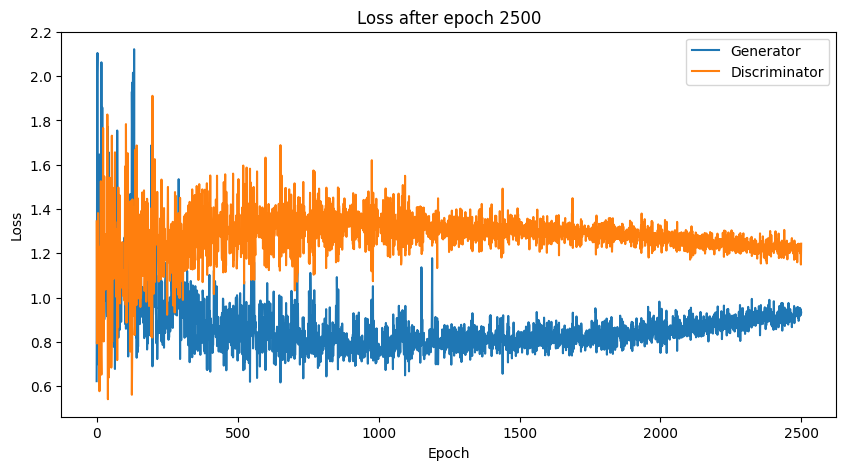

Time for epoch 2500 is 3.508430242538452 sec
Time for epoch 2501 is 0.863593339920044 sec
Time for epoch 2502 is 0.8694610595703125 sec
Time for epoch 2503 is 0.8775882720947266 sec
Time for epoch 2504 is 0.873633623123169 sec
Time for epoch 2505 is 0.877161979675293 sec
Time for epoch 2506 is 0.8872723579406738 sec
Time for epoch 2507 is 0.8771529197692871 sec
Time for epoch 2508 is 0.8818235397338867 sec
Time for epoch 2509 is 0.8874671459197998 sec
Time for epoch 2510 is 0.8825170993804932 sec
Time for epoch 2511 is 0.8803017139434814 sec
Time for epoch 2512 is 0.8832471370697021 sec
Time for epoch 2513 is 0.8822016716003418 sec
Time for epoch 2514 is 0.890080451965332 sec
Time for epoch 2515 is 0.8859014511108398 sec
Time for epoch 2516 is 0.8905336856842041 sec
Time for epoch 2517 is 0.8758358955383301 sec
Time for epoch 2518 is 0.8844397068023682 sec
Time for epoch 2519 is 0.8889379501342773 sec
Time for epoch 2520 is 0.8845725059509277 sec
Time for epoch 2521 is 0.88762116432189

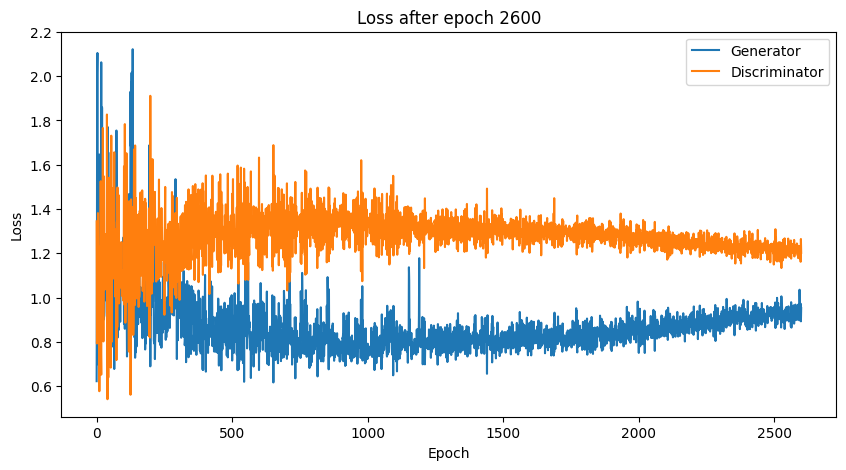

Time for epoch 2600 is 3.383436918258667 sec
Time for epoch 2601 is 0.8615007400512695 sec
Time for epoch 2602 is 0.8724765777587891 sec
Time for epoch 2603 is 0.8792192935943604 sec
Time for epoch 2604 is 0.8726637363433838 sec
Time for epoch 2605 is 0.874530553817749 sec
Time for epoch 2606 is 0.8829865455627441 sec
Time for epoch 2607 is 0.8822579383850098 sec
Time for epoch 2608 is 0.8775627613067627 sec
Time for epoch 2609 is 0.8803725242614746 sec
Time for epoch 2610 is 0.8855509757995605 sec
Time for epoch 2611 is 0.8878319263458252 sec
Time for epoch 2612 is 0.8822550773620605 sec
Time for epoch 2613 is 0.8873913288116455 sec
Time for epoch 2614 is 0.8924760818481445 sec
Time for epoch 2615 is 0.8845877647399902 sec
Time for epoch 2616 is 0.8884286880493164 sec
Time for epoch 2617 is 0.8864879608154297 sec
Time for epoch 2618 is 0.8880102634429932 sec
Time for epoch 2619 is 0.8913257122039795 sec
Time for epoch 2620 is 0.891754150390625 sec
Time for epoch 2621 is 0.891850948333

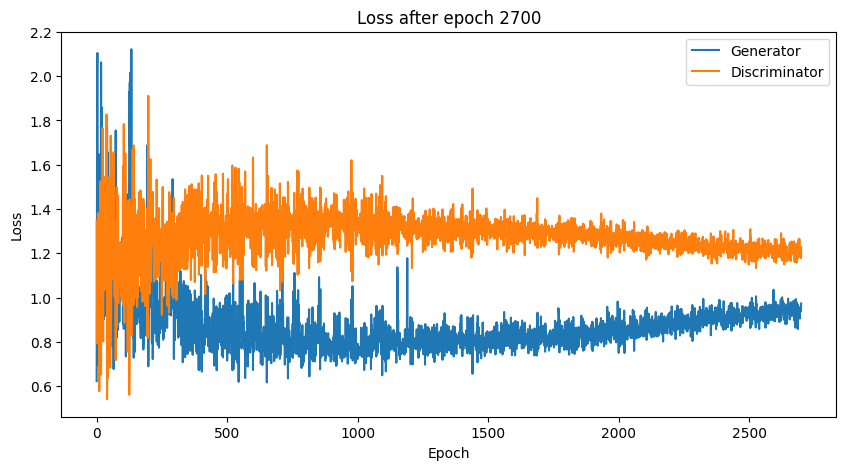

Time for epoch 2700 is 3.3491709232330322 sec
Time for epoch 2701 is 0.858506441116333 sec
Time for epoch 2702 is 0.8687784671783447 sec
Time for epoch 2703 is 0.8724632263183594 sec
Time for epoch 2704 is 0.8763203620910645 sec
Time for epoch 2705 is 0.8829805850982666 sec
Time for epoch 2706 is 0.8799288272857666 sec
Time for epoch 2707 is 0.8844594955444336 sec
Time for epoch 2708 is 0.8817276954650879 sec
Time for epoch 2709 is 0.881871223449707 sec
Time for epoch 2710 is 0.8856079578399658 sec
Time for epoch 2711 is 0.8844890594482422 sec
Time for epoch 2712 is 0.8839831352233887 sec
Time for epoch 2713 is 0.8919415473937988 sec
Time for epoch 2714 is 0.8856761455535889 sec
Time for epoch 2715 is 0.8823432922363281 sec
Time for epoch 2716 is 0.8894448280334473 sec
Time for epoch 2717 is 0.8846817016601562 sec
Time for epoch 2718 is 0.8912620544433594 sec
Time for epoch 2719 is 0.8891806602478027 sec
Time for epoch 2720 is 0.888725757598877 sec
Time for epoch 2721 is 0.890725851058

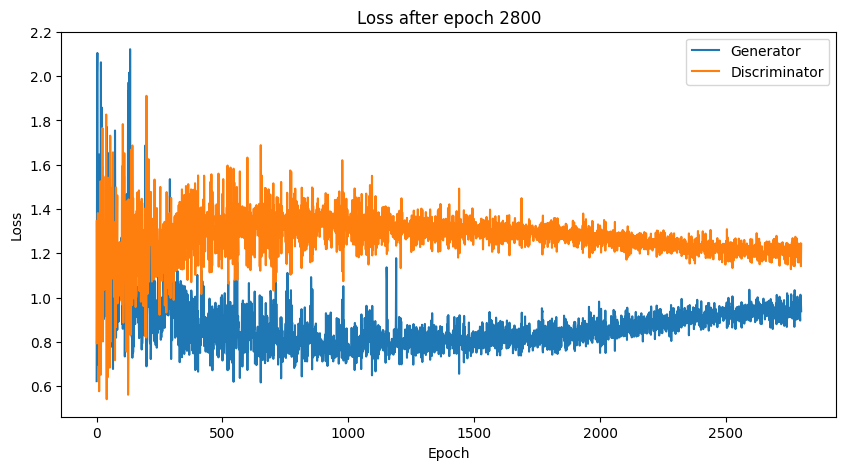

Time for epoch 2800 is 3.576045036315918 sec
Time for epoch 2801 is 0.8658788204193115 sec
Time for epoch 2802 is 0.8651878833770752 sec
Time for epoch 2803 is 0.8713674545288086 sec
Time for epoch 2804 is 0.874565601348877 sec
Time for epoch 2805 is 0.8852527141571045 sec
Time for epoch 2806 is 0.8769829273223877 sec
Time for epoch 2807 is 0.8762004375457764 sec
Time for epoch 2808 is 0.8834836483001709 sec
Time for epoch 2809 is 0.8768441677093506 sec
Time for epoch 2810 is 0.881619930267334 sec
Time for epoch 2811 is 0.8863749504089355 sec
Time for epoch 2812 is 0.8815686702728271 sec
Time for epoch 2813 is 0.8910424709320068 sec
Time for epoch 2814 is 0.8795607089996338 sec
Time for epoch 2815 is 0.8875088691711426 sec
Time for epoch 2816 is 0.8886468410491943 sec
Time for epoch 2817 is 0.884829044342041 sec
Time for epoch 2818 is 0.8889153003692627 sec
Time for epoch 2819 is 0.8871443271636963 sec
Time for epoch 2820 is 0.8780009746551514 sec
Time for epoch 2821 is 0.8884706497192

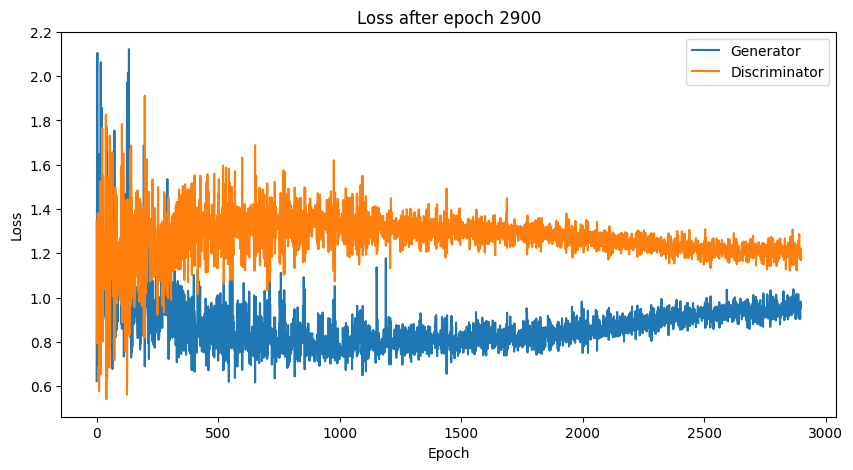

Time for epoch 2900 is 3.336589813232422 sec
Time for epoch 2901 is 0.863013744354248 sec
Time for epoch 2902 is 0.8721590042114258 sec
Time for epoch 2903 is 0.872880220413208 sec
Time for epoch 2904 is 0.8747117519378662 sec
Time for epoch 2905 is 0.8788657188415527 sec
Time for epoch 2906 is 0.8751146793365479 sec
Time for epoch 2907 is 0.8832578659057617 sec
Time for epoch 2908 is 0.8800654411315918 sec
Time for epoch 2909 is 0.8791093826293945 sec
Time for epoch 2910 is 0.882260799407959 sec
Time for epoch 2911 is 0.8840281963348389 sec
Time for epoch 2912 is 0.8851513862609863 sec
Time for epoch 2913 is 0.880516767501831 sec
Time for epoch 2914 is 0.8921945095062256 sec
Time for epoch 2915 is 0.8960185050964355 sec
Time for epoch 2916 is 0.886493444442749 sec
Time for epoch 2917 is 0.883415937423706 sec
Time for epoch 2918 is 0.8854568004608154 sec
Time for epoch 2919 is 0.8871276378631592 sec
Time for epoch 2920 is 0.8897151947021484 sec
Time for epoch 2921 is 0.8886356353759766

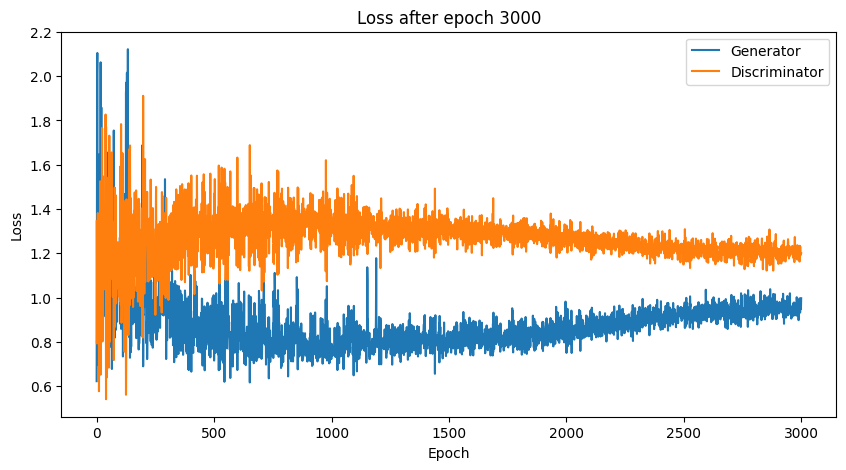

Time for epoch 3000 is 3.5364651679992676 sec
Time for epoch 3001 is 0.8558940887451172 sec
Time for epoch 3002 is 0.8672006130218506 sec
Time for epoch 3003 is 0.870046854019165 sec
Time for epoch 3004 is 0.8729920387268066 sec
Time for epoch 3005 is 0.8750765323638916 sec
Time for epoch 3006 is 0.8794410228729248 sec
Time for epoch 3007 is 0.8761866092681885 sec
Time for epoch 3008 is 0.8790054321289062 sec
Time for epoch 3009 is 0.8889198303222656 sec
Time for epoch 3010 is 0.8845517635345459 sec
Time for epoch 3011 is 0.8825998306274414 sec
Time for epoch 3012 is 0.8897655010223389 sec
Time for epoch 3013 is 0.8862943649291992 sec
Time for epoch 3014 is 0.8892638683319092 sec
Time for epoch 3015 is 0.883234977722168 sec
Time for epoch 3016 is 0.889096736907959 sec
Time for epoch 3017 is 0.8889164924621582 sec
Time for epoch 3018 is 0.8833651542663574 sec
Time for epoch 3019 is 0.8866384029388428 sec
Time for epoch 3020 is 0.8841900825500488 sec
Time for epoch 3021 is 0.887095928192

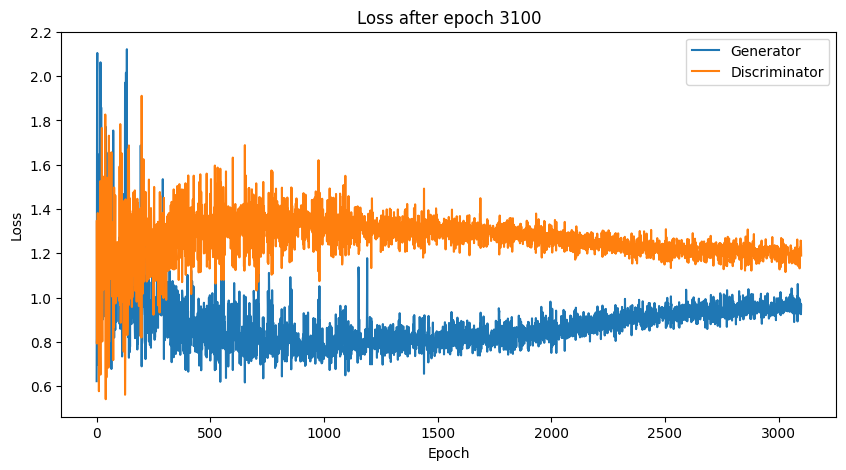

Time for epoch 3100 is 3.3760342597961426 sec
Time for epoch 3101 is 0.8619496822357178 sec
Time for epoch 3102 is 0.8767242431640625 sec
Time for epoch 3103 is 0.8686952590942383 sec
Time for epoch 3104 is 0.8738148212432861 sec
Time for epoch 3105 is 0.87618088722229 sec
Time for epoch 3106 is 0.8825526237487793 sec
Time for epoch 3107 is 0.8757576942443848 sec
Time for epoch 3108 is 0.8876800537109375 sec
Time for epoch 3109 is 0.881523847579956 sec
Time for epoch 3110 is 0.8861885070800781 sec
Time for epoch 3111 is 0.8811774253845215 sec
Time for epoch 3112 is 0.8838553428649902 sec
Time for epoch 3113 is 0.8880746364593506 sec
Time for epoch 3114 is 0.8832521438598633 sec
Time for epoch 3115 is 0.8824238777160645 sec
Time for epoch 3116 is 0.8869724273681641 sec
Time for epoch 3117 is 0.8850562572479248 sec
Time for epoch 3118 is 0.884638786315918 sec
Time for epoch 3119 is 0.8941366672515869 sec
Time for epoch 3120 is 0.8839995861053467 sec
Time for epoch 3121 is 0.8927652835845

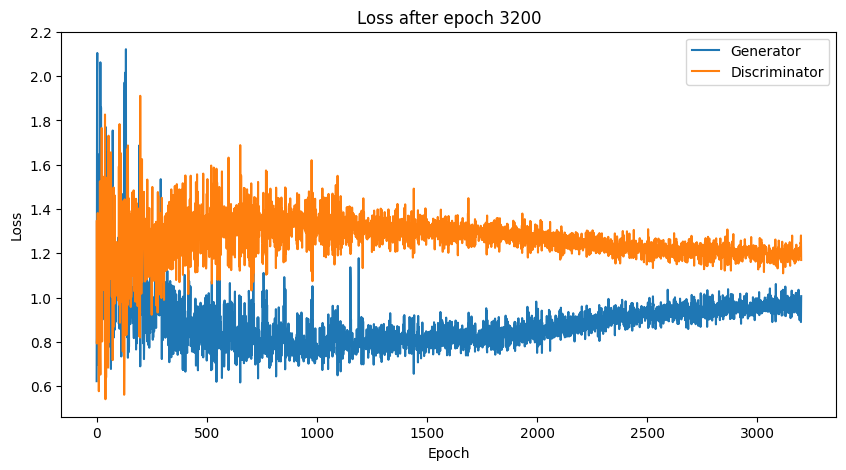

Time for epoch 3200 is 3.362074613571167 sec
Time for epoch 3201 is 0.8597114086151123 sec
Time for epoch 3202 is 0.8672125339508057 sec
Time for epoch 3203 is 0.8711411952972412 sec
Time for epoch 3204 is 0.8814451694488525 sec
Time for epoch 3205 is 0.8767731189727783 sec
Time for epoch 3206 is 0.8776059150695801 sec
Time for epoch 3207 is 0.8817088603973389 sec
Time for epoch 3208 is 0.8814947605133057 sec
Time for epoch 3209 is 0.889066219329834 sec
Time for epoch 3210 is 0.8915061950683594 sec
Time for epoch 3211 is 0.8839981555938721 sec
Time for epoch 3212 is 0.8848052024841309 sec
Time for epoch 3213 is 0.8802595138549805 sec
Time for epoch 3214 is 0.8860785961151123 sec
Time for epoch 3215 is 0.8848598003387451 sec
Time for epoch 3216 is 0.8854341506958008 sec
Time for epoch 3217 is 0.8862578868865967 sec
Time for epoch 3218 is 0.8849525451660156 sec
Time for epoch 3219 is 0.8913092613220215 sec
Time for epoch 3220 is 0.8835601806640625 sec
Time for epoch 3221 is 0.88682103157

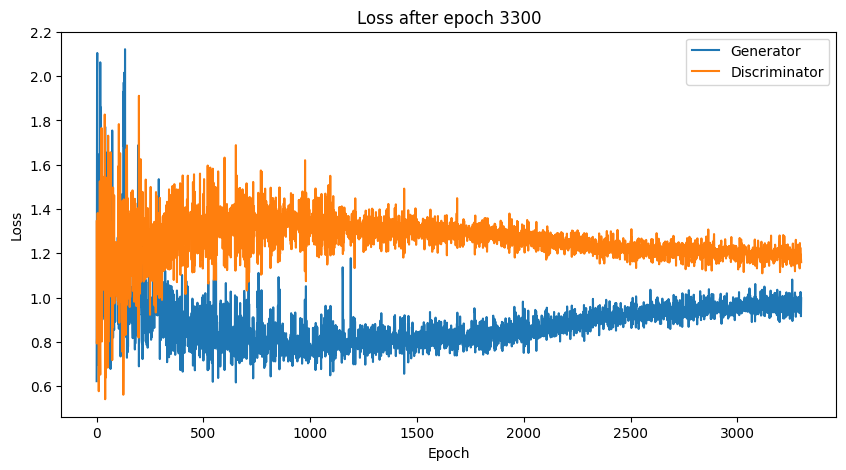

Time for epoch 3300 is 3.510629892349243 sec
Time for epoch 3301 is 0.8735499382019043 sec
Time for epoch 3302 is 0.8767044544219971 sec
Time for epoch 3303 is 0.8702547550201416 sec
Time for epoch 3304 is 0.8731436729431152 sec
Time for epoch 3305 is 0.8767328262329102 sec
Time for epoch 3306 is 0.8755512237548828 sec
Time for epoch 3307 is 0.8746745586395264 sec
Time for epoch 3308 is 0.877082109451294 sec
Time for epoch 3309 is 0.8851263523101807 sec
Time for epoch 3310 is 0.8848237991333008 sec
Time for epoch 3311 is 0.8852972984313965 sec
Time for epoch 3312 is 0.8880822658538818 sec
Time for epoch 3313 is 0.879237174987793 sec
Time for epoch 3314 is 0.8840816020965576 sec
Time for epoch 3315 is 0.8843634128570557 sec
Time for epoch 3316 is 0.8854899406433105 sec
Time for epoch 3317 is 0.8845114707946777 sec
Time for epoch 3318 is 0.8838212490081787 sec
Time for epoch 3319 is 0.8869497776031494 sec
Time for epoch 3320 is 0.8869431018829346 sec
Time for epoch 3321 is 0.891217231750

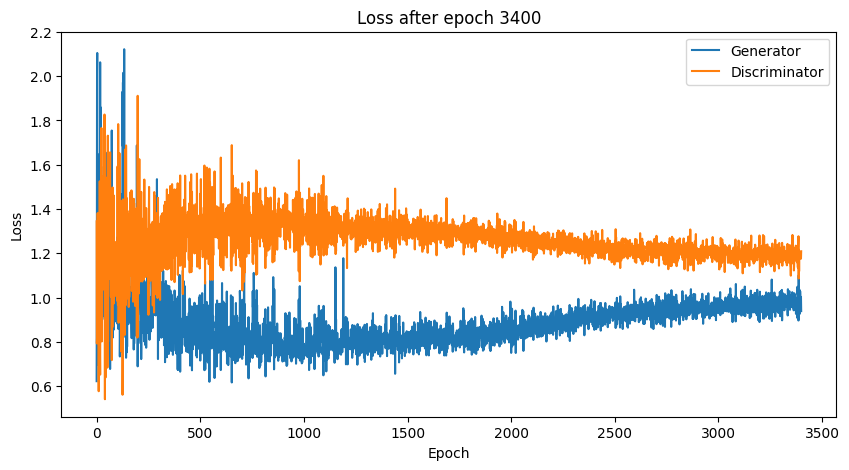

Time for epoch 3400 is 3.3655033111572266 sec
Time for epoch 3401 is 0.8728952407836914 sec
Time for epoch 3402 is 0.8742852210998535 sec
Time for epoch 3403 is 0.8661479949951172 sec
Time for epoch 3404 is 0.8770151138305664 sec
Time for epoch 3405 is 0.8794496059417725 sec
Time for epoch 3406 is 0.8759751319885254 sec
Time for epoch 3407 is 0.8738198280334473 sec
Time for epoch 3408 is 0.8846817016601562 sec
Time for epoch 3409 is 0.8821463584899902 sec
Time for epoch 3410 is 0.887218713760376 sec
Time for epoch 3411 is 0.8897614479064941 sec
Time for epoch 3412 is 0.8864762783050537 sec
Time for epoch 3413 is 0.8817124366760254 sec
Time for epoch 3414 is 0.8837640285491943 sec
Time for epoch 3415 is 0.8825888633728027 sec
Time for epoch 3416 is 0.8840148448944092 sec
Time for epoch 3417 is 0.8876807689666748 sec
Time for epoch 3418 is 0.8861517906188965 sec
Time for epoch 3419 is 0.8917882442474365 sec
Time for epoch 3420 is 0.8892018795013428 sec
Time for epoch 3421 is 0.8835256099

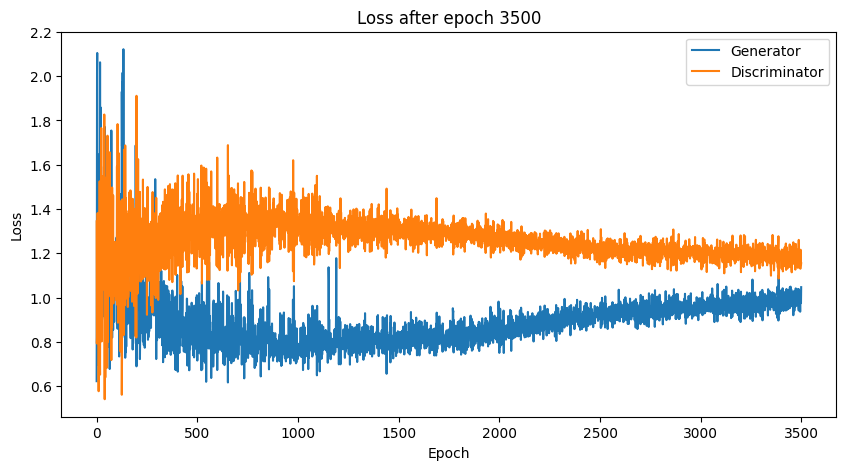

Time for epoch 3500 is 3.6347408294677734 sec
Time for epoch 3501 is 0.8637123107910156 sec
Time for epoch 3502 is 0.8704543113708496 sec
Time for epoch 3503 is 0.8723835945129395 sec
Time for epoch 3504 is 0.8774659633636475 sec
Time for epoch 3505 is 0.8746728897094727 sec
Time for epoch 3506 is 0.8745973110198975 sec
Time for epoch 3507 is 0.8785820007324219 sec
Time for epoch 3508 is 0.879704475402832 sec
Time for epoch 3509 is 0.8792686462402344 sec
Time for epoch 3510 is 0.8803529739379883 sec
Time for epoch 3511 is 0.8832380771636963 sec
Time for epoch 3512 is 0.8878037929534912 sec
Time for epoch 3513 is 0.8826572895050049 sec
Time for epoch 3514 is 0.8838071823120117 sec
Time for epoch 3515 is 0.8833048343658447 sec
Time for epoch 3516 is 0.8913371562957764 sec
Time for epoch 3517 is 0.8825132846832275 sec
Time for epoch 3518 is 0.8869562149047852 sec
Time for epoch 3519 is 0.8911633491516113 sec
Time for epoch 3520 is 0.8842215538024902 sec
Time for epoch 3521 is 0.8854966163

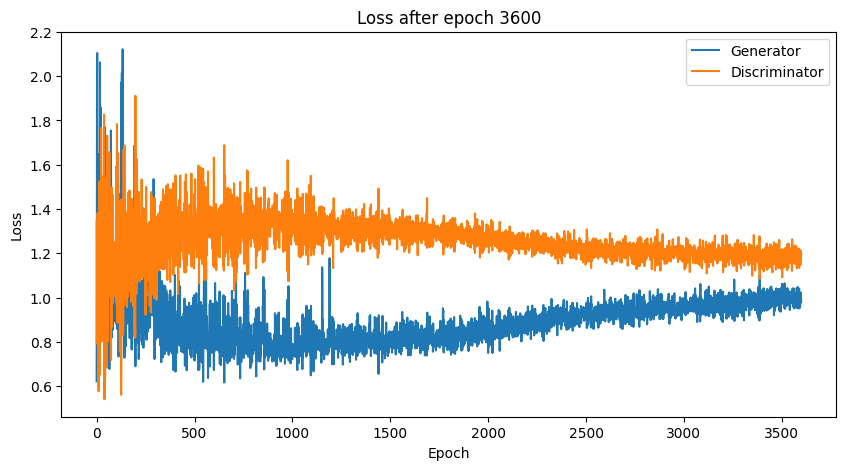

Time for epoch 3600 is 3.388490915298462 sec
Time for epoch 3601 is 0.873939037322998 sec
Time for epoch 3602 is 0.8654742240905762 sec
Time for epoch 3603 is 0.8710148334503174 sec
Time for epoch 3604 is 0.8740625381469727 sec
Time for epoch 3605 is 0.8795051574707031 sec
Time for epoch 3606 is 0.8801352977752686 sec
Time for epoch 3607 is 0.8798913955688477 sec
Time for epoch 3608 is 0.8815820217132568 sec
Time for epoch 3609 is 0.8806979656219482 sec
Time for epoch 3610 is 0.8808562755584717 sec
Time for epoch 3611 is 0.8895182609558105 sec
Time for epoch 3612 is 0.8872315883636475 sec
Time for epoch 3613 is 0.8853962421417236 sec
Time for epoch 3614 is 0.8782873153686523 sec
Time for epoch 3615 is 0.8837974071502686 sec
Time for epoch 3616 is 0.8855080604553223 sec
Time for epoch 3617 is 0.8854670524597168 sec
Time for epoch 3618 is 0.8834240436553955 sec
Time for epoch 3619 is 0.882918119430542 sec
Time for epoch 3620 is 0.8907356262207031 sec
Time for epoch 3621 is 0.886192560195

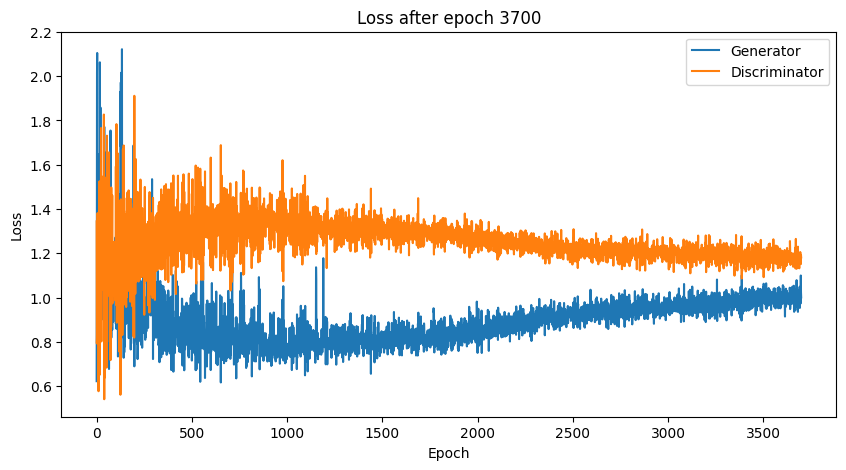

Time for epoch 3700 is 3.671846628189087 sec
Time for epoch 3701 is 0.869767427444458 sec
Time for epoch 3702 is 0.8659787178039551 sec
Time for epoch 3703 is 0.875269889831543 sec
Time for epoch 3704 is 0.8746242523193359 sec
Time for epoch 3705 is 0.8805363178253174 sec
Time for epoch 3706 is 0.8773760795593262 sec
Time for epoch 3707 is 0.8780865669250488 sec
Time for epoch 3708 is 0.8867702484130859 sec
Time for epoch 3709 is 0.8862514495849609 sec
Time for epoch 3710 is 0.8824858665466309 sec
Time for epoch 3711 is 0.8801858425140381 sec
Time for epoch 3712 is 0.8881096839904785 sec
Time for epoch 3713 is 0.8818786144256592 sec
Time for epoch 3714 is 0.8782362937927246 sec
Time for epoch 3715 is 0.8867385387420654 sec
Time for epoch 3716 is 0.8835384845733643 sec
Time for epoch 3717 is 0.8904125690460205 sec
Time for epoch 3718 is 0.8845980167388916 sec
Time for epoch 3719 is 0.8842372894287109 sec
Time for epoch 3720 is 0.8849329948425293 sec
Time for epoch 3721 is 0.883797407150

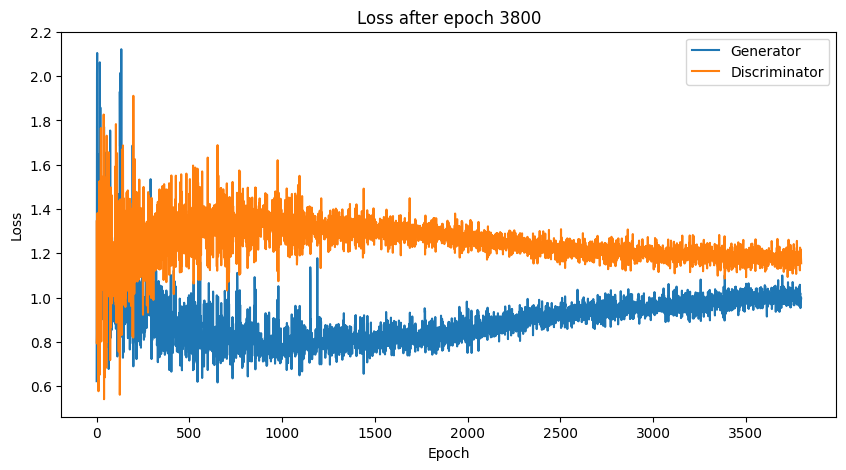

Time for epoch 3800 is 3.372199058532715 sec
Time for epoch 3801 is 0.8574864864349365 sec
Time for epoch 3802 is 0.8648514747619629 sec
Time for epoch 3803 is 0.8729457855224609 sec
Time for epoch 3804 is 0.8845217227935791 sec
Time for epoch 3805 is 0.8779003620147705 sec
Time for epoch 3806 is 0.8799004554748535 sec
Time for epoch 3807 is 0.8791866302490234 sec
Time for epoch 3808 is 0.885087251663208 sec
Time for epoch 3809 is 0.8804113864898682 sec
Time for epoch 3810 is 0.8856794834136963 sec
Time for epoch 3811 is 0.8846464157104492 sec
Time for epoch 3812 is 0.8824343681335449 sec
Time for epoch 3813 is 0.8866877555847168 sec
Time for epoch 3814 is 0.8930263519287109 sec
Time for epoch 3815 is 0.8868885040283203 sec
Time for epoch 3816 is 0.8864867687225342 sec
Time for epoch 3817 is 0.8834748268127441 sec
Time for epoch 3818 is 0.8874454498291016 sec
Time for epoch 3819 is 0.8832674026489258 sec
Time for epoch 3820 is 0.8882057666778564 sec
Time for epoch 3821 is 0.88681602478

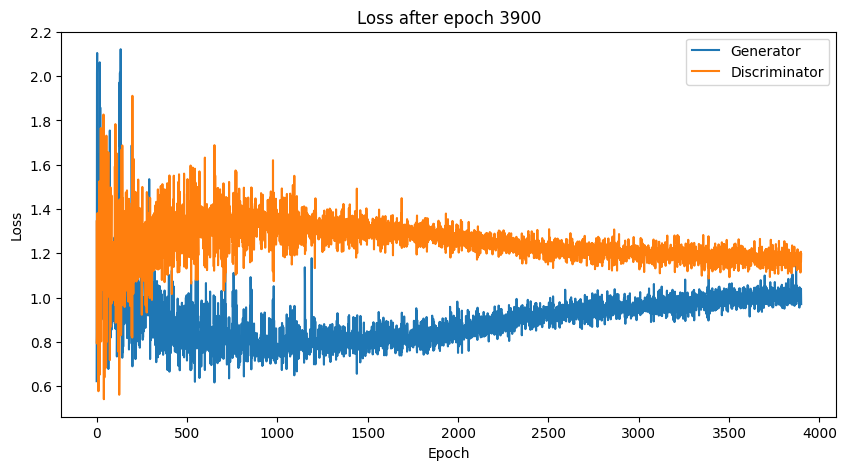

Time for epoch 3900 is 3.4500675201416016 sec
Time for epoch 3901 is 0.8667559623718262 sec
Time for epoch 3902 is 0.875791072845459 sec
Time for epoch 3903 is 0.8792557716369629 sec
Time for epoch 3904 is 0.8759217262268066 sec
Time for epoch 3905 is 0.873676061630249 sec
Time for epoch 3906 is 0.8848667144775391 sec
Time for epoch 3907 is 0.8718032836914062 sec
Time for epoch 3908 is 0.880382776260376 sec
Time for epoch 3909 is 0.8801560401916504 sec
Time for epoch 3910 is 0.8950185775756836 sec
Time for epoch 3911 is 0.8786442279815674 sec
Time for epoch 3912 is 0.8839743137359619 sec
Time for epoch 3913 is 0.884516716003418 sec
Time for epoch 3914 is 0.8935379981994629 sec
Time for epoch 3915 is 0.8839831352233887 sec
Time for epoch 3916 is 0.8843488693237305 sec
Time for epoch 3917 is 0.8938407897949219 sec
Time for epoch 3918 is 0.883056640625 sec
Time for epoch 3919 is 0.8912475109100342 sec
Time for epoch 3920 is 0.8858530521392822 sec
Time for epoch 3921 is 0.8992416858673096 

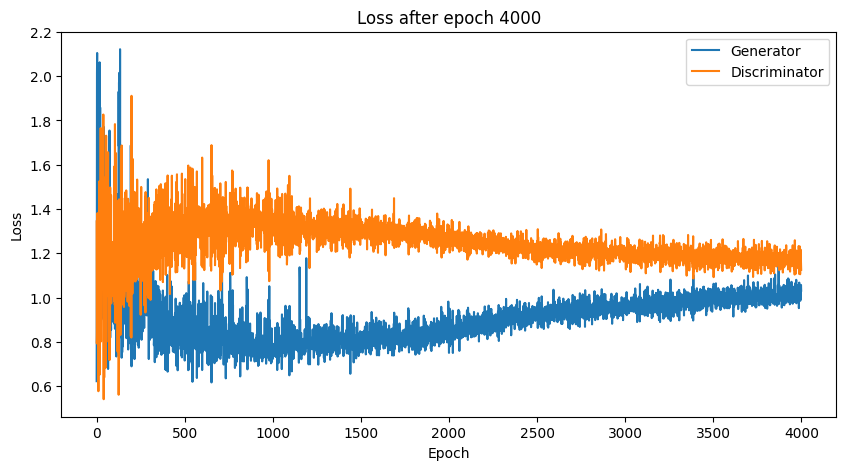

Time for epoch 4000 is 3.6047110557556152 sec
Time for epoch 4001 is 0.8640189170837402 sec
Time for epoch 4002 is 0.8707342147827148 sec
Time for epoch 4003 is 0.8720338344573975 sec
Time for epoch 4004 is 0.8795492649078369 sec
Time for epoch 4005 is 0.8748421669006348 sec
Time for epoch 4006 is 0.8776135444641113 sec
Time for epoch 4007 is 0.8810625076293945 sec
Time for epoch 4008 is 0.8788282871246338 sec
Time for epoch 4009 is 0.88108229637146 sec
Time for epoch 4010 is 0.8812680244445801 sec
Time for epoch 4011 is 0.8826618194580078 sec
Time for epoch 4012 is 0.8840634822845459 sec
Time for epoch 4013 is 0.8912594318389893 sec
Time for epoch 4014 is 0.8822486400604248 sec
Time for epoch 4015 is 0.88993239402771 sec
Time for epoch 4016 is 0.8841915130615234 sec
Time for epoch 4017 is 0.8894228935241699 sec
Time for epoch 4018 is 0.888066291809082 sec
Time for epoch 4019 is 0.8854730129241943 sec
Time for epoch 4020 is 0.8858489990234375 sec
Time for epoch 4021 is 0.88373684883117

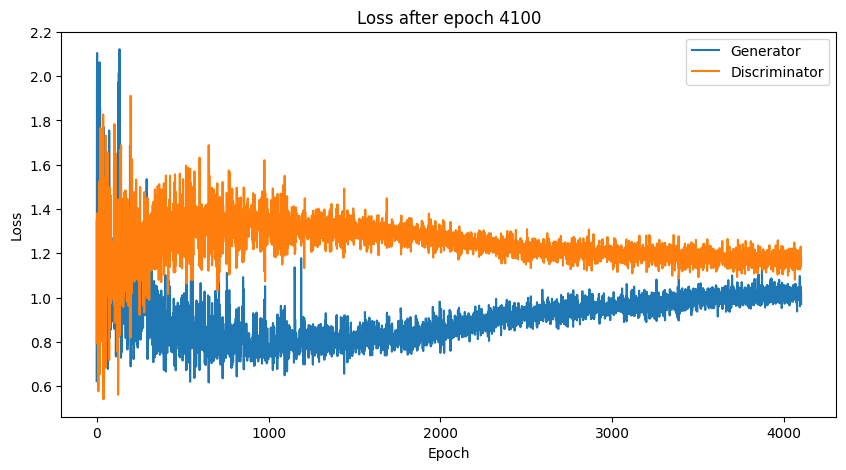

Time for epoch 4100 is 3.3898520469665527 sec
Time for epoch 4101 is 0.8575401306152344 sec
Time for epoch 4102 is 0.8697061538696289 sec
Time for epoch 4103 is 0.8721053600311279 sec
Time for epoch 4104 is 0.8757925033569336 sec
Time for epoch 4105 is 0.8858563899993896 sec
Time for epoch 4106 is 0.8712146282196045 sec
Time for epoch 4107 is 0.8837580680847168 sec
Time for epoch 4108 is 0.8815441131591797 sec
Time for epoch 4109 is 0.8888092041015625 sec
Time for epoch 4110 is 0.8935995101928711 sec
Time for epoch 4111 is 0.8814883232116699 sec
Time for epoch 4112 is 0.8816523551940918 sec
Time for epoch 4113 is 0.8835172653198242 sec
Time for epoch 4114 is 0.8872730731964111 sec
Time for epoch 4115 is 0.8889060020446777 sec
Time for epoch 4116 is 0.8844108581542969 sec
Time for epoch 4117 is 0.9038331508636475 sec
Time for epoch 4118 is 0.880723237991333 sec
Time for epoch 4119 is 0.8845524787902832 sec
Time for epoch 4120 is 0.8889648914337158 sec
Time for epoch 4121 is 0.8899853229

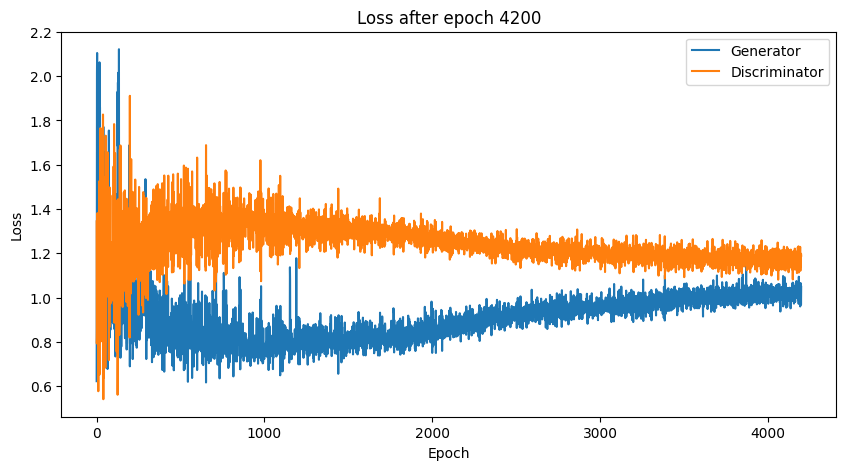

Time for epoch 4200 is 3.6357288360595703 sec
Time for epoch 4201 is 0.8552255630493164 sec
Time for epoch 4202 is 0.8749475479125977 sec
Time for epoch 4203 is 0.8707032203674316 sec
Time for epoch 4204 is 0.8709394931793213 sec
Time for epoch 4205 is 0.8828980922698975 sec
Time for epoch 4206 is 0.8833603858947754 sec
Time for epoch 4207 is 0.8798444271087646 sec
Time for epoch 4208 is 0.8809075355529785 sec
Time for epoch 4209 is 0.8821573257446289 sec
Time for epoch 4210 is 0.8854832649230957 sec
Time for epoch 4211 is 0.8858964443206787 sec
Time for epoch 4212 is 0.8829574584960938 sec
Time for epoch 4213 is 0.8820617198944092 sec
Time for epoch 4214 is 0.8822190761566162 sec
Time for epoch 4215 is 0.8794434070587158 sec
Time for epoch 4216 is 0.8924033641815186 sec
Time for epoch 4217 is 0.8821468353271484 sec
Time for epoch 4218 is 0.8858566284179688 sec
Time for epoch 4219 is 0.8835904598236084 sec
Time for epoch 4220 is 0.8882768154144287 sec
Time for epoch 4221 is 0.889096736

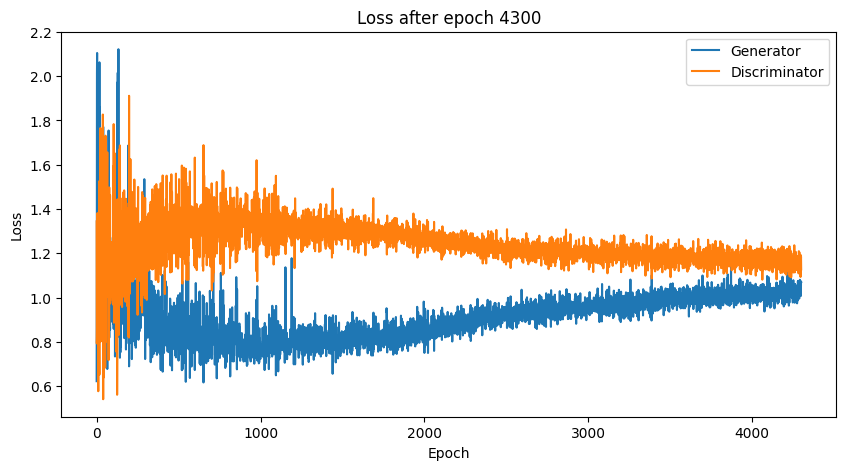

Time for epoch 4300 is 3.439246892929077 sec
Time for epoch 4301 is 0.8550615310668945 sec
Time for epoch 4302 is 0.871196985244751 sec
Time for epoch 4303 is 0.8734369277954102 sec
Time for epoch 4304 is 0.8760099411010742 sec
Time for epoch 4305 is 0.8785543441772461 sec
Time for epoch 4306 is 0.878633975982666 sec
Time for epoch 4307 is 0.8787806034088135 sec
Time for epoch 4308 is 0.8823773860931396 sec
Time for epoch 4309 is 0.8818626403808594 sec
Time for epoch 4310 is 0.885638952255249 sec
Time for epoch 4311 is 0.8814842700958252 sec
Time for epoch 4312 is 0.8895275592803955 sec
Time for epoch 4313 is 0.8856756687164307 sec
Time for epoch 4314 is 0.886340856552124 sec
Time for epoch 4315 is 0.8974297046661377 sec
Time for epoch 4316 is 0.8817117214202881 sec
Time for epoch 4317 is 0.8866126537322998 sec
Time for epoch 4318 is 0.8839685916900635 sec
Time for epoch 4319 is 0.8880741596221924 sec
Time for epoch 4320 is 0.8831994533538818 sec
Time for epoch 4321 is 0.88938021659851

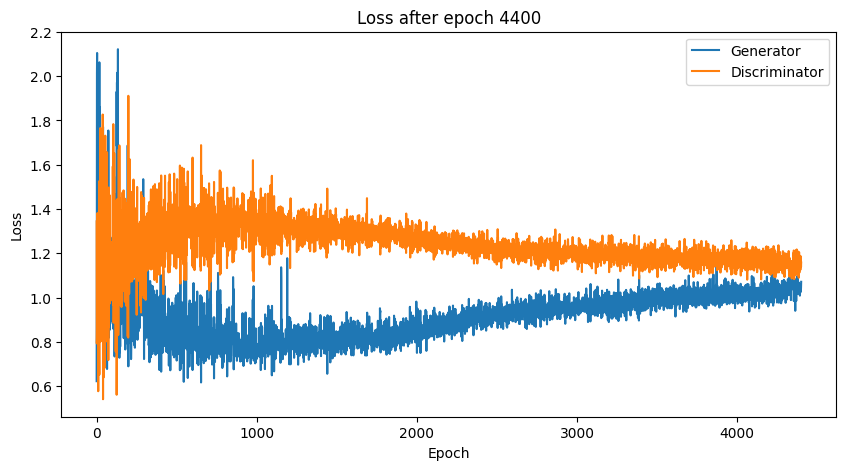

Time for epoch 4400 is 3.596229076385498 sec
Time for epoch 4401 is 0.8516683578491211 sec
Time for epoch 4402 is 0.8774352073669434 sec
Time for epoch 4403 is 0.8729772567749023 sec
Time for epoch 4404 is 0.8789258003234863 sec
Time for epoch 4405 is 0.876251220703125 sec
Time for epoch 4406 is 0.8824303150177002 sec
Time for epoch 4407 is 0.871668815612793 sec
Time for epoch 4408 is 0.8851406574249268 sec
Time for epoch 4409 is 0.8775303363800049 sec
Time for epoch 4410 is 0.8816928863525391 sec
Time for epoch 4411 is 0.8820202350616455 sec
Time for epoch 4412 is 0.8844802379608154 sec
Time for epoch 4413 is 0.8924829959869385 sec
Time for epoch 4414 is 0.8777124881744385 sec
Time for epoch 4415 is 0.8856947422027588 sec
Time for epoch 4416 is 0.8847095966339111 sec
Time for epoch 4417 is 0.8811764717102051 sec
Time for epoch 4418 is 0.8856790065765381 sec
Time for epoch 4419 is 0.8856580257415771 sec
Time for epoch 4420 is 0.8856852054595947 sec
Time for epoch 4421 is 0.890996456146

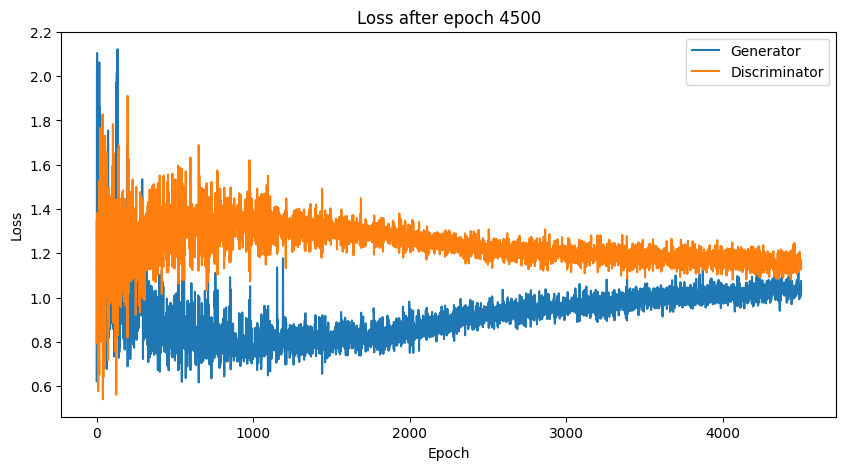

Time for epoch 4500 is 3.4244585037231445 sec
Time for epoch 4501 is 0.8604412078857422 sec
Time for epoch 4502 is 0.8666481971740723 sec
Time for epoch 4503 is 0.8789868354797363 sec
Time for epoch 4504 is 0.8839404582977295 sec
Time for epoch 4505 is 0.8712451457977295 sec
Time for epoch 4506 is 0.875939130783081 sec
Time for epoch 4507 is 0.8787572383880615 sec
Time for epoch 4508 is 0.8791530132293701 sec
Time for epoch 4509 is 0.8749537467956543 sec
Time for epoch 4510 is 0.8850219249725342 sec
Time for epoch 4511 is 0.8885841369628906 sec
Time for epoch 4512 is 0.8802404403686523 sec
Time for epoch 4513 is 0.8852779865264893 sec
Time for epoch 4514 is 0.8870532512664795 sec
Time for epoch 4515 is 0.8853862285614014 sec
Time for epoch 4516 is 0.886512041091919 sec
Time for epoch 4517 is 0.8885717391967773 sec
Time for epoch 4518 is 0.8841347694396973 sec
Time for epoch 4519 is 0.8859701156616211 sec
Time for epoch 4520 is 0.8880810737609863 sec
Time for epoch 4521 is 0.88566398620

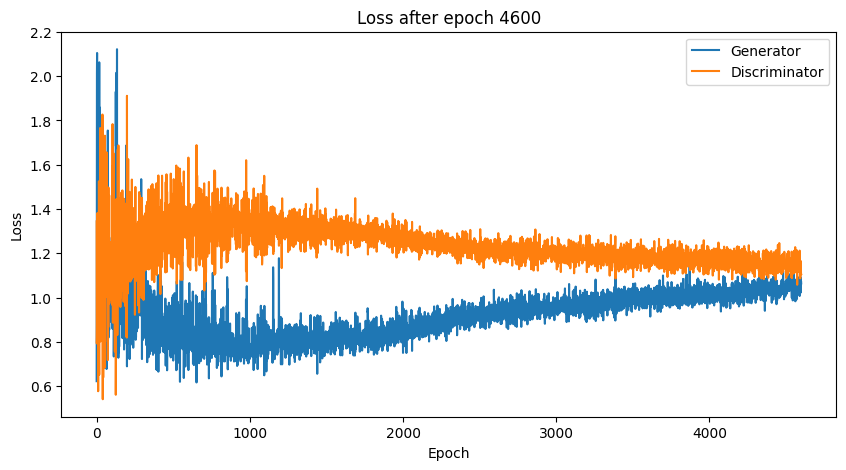

Time for epoch 4600 is 3.5333588123321533 sec
Time for epoch 4601 is 0.8614442348480225 sec
Time for epoch 4602 is 0.8743455410003662 sec
Time for epoch 4603 is 0.8734619617462158 sec
Time for epoch 4604 is 0.8708174228668213 sec
Time for epoch 4605 is 0.8776710033416748 sec
Time for epoch 4606 is 0.8753974437713623 sec
Time for epoch 4607 is 0.8861551284790039 sec
Time for epoch 4608 is 0.8811161518096924 sec
Time for epoch 4609 is 0.8878364562988281 sec
Time for epoch 4610 is 0.882357120513916 sec
Time for epoch 4611 is 0.8798637390136719 sec
Time for epoch 4612 is 0.8938496112823486 sec
Time for epoch 4613 is 0.8870148658752441 sec
Time for epoch 4614 is 0.8826732635498047 sec
Time for epoch 4615 is 0.8799824714660645 sec
Time for epoch 4616 is 0.8861203193664551 sec
Time for epoch 4617 is 0.886859655380249 sec
Time for epoch 4618 is 0.8853135108947754 sec
Time for epoch 4619 is 0.8856604099273682 sec
Time for epoch 4620 is 0.8881659507751465 sec
Time for epoch 4621 is 0.88143229484

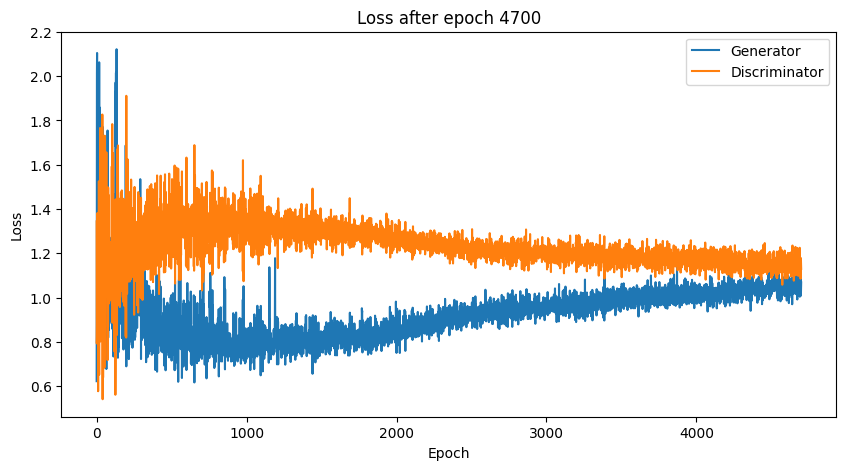

Time for epoch 4700 is 3.4069550037384033 sec
Time for epoch 4701 is 0.8584024906158447 sec
Time for epoch 4702 is 0.8710932731628418 sec
Time for epoch 4703 is 0.872626543045044 sec
Time for epoch 4704 is 0.8717002868652344 sec
Time for epoch 4705 is 0.8823163509368896 sec
Time for epoch 4706 is 0.8748528957366943 sec
Time for epoch 4707 is 0.8831284046173096 sec
Time for epoch 4708 is 0.8806207180023193 sec
Time for epoch 4709 is 0.8872120380401611 sec
Time for epoch 4710 is 0.8819186687469482 sec
Time for epoch 4711 is 0.8849756717681885 sec
Time for epoch 4712 is 0.8838818073272705 sec
Time for epoch 4713 is 0.8848130702972412 sec
Time for epoch 4714 is 0.893103837966919 sec
Time for epoch 4715 is 0.8836681842803955 sec
Time for epoch 4716 is 0.8907718658447266 sec
Time for epoch 4717 is 0.8914499282836914 sec
Time for epoch 4718 is 0.8903038501739502 sec
Time for epoch 4719 is 0.885897159576416 sec
Time for epoch 4720 is 0.8866519927978516 sec
Time for epoch 4721 is 0.888245105743

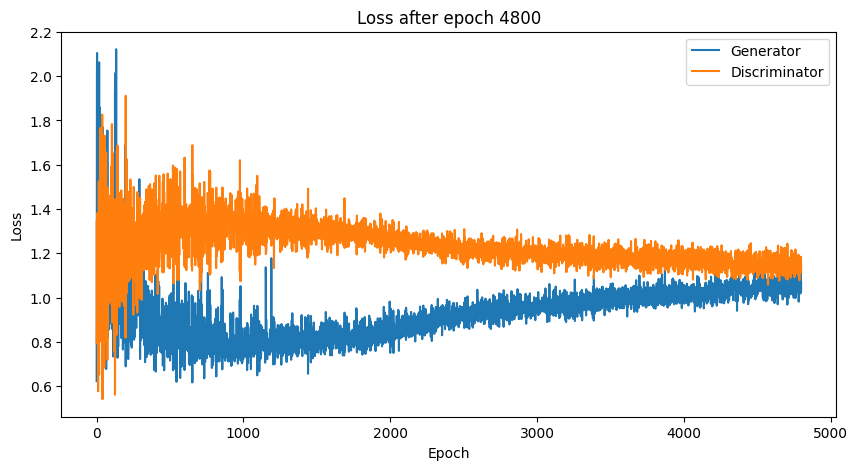

Time for epoch 4800 is 3.5717756748199463 sec
Time for epoch 4801 is 0.8517575263977051 sec
Time for epoch 4802 is 0.8700258731842041 sec
Time for epoch 4803 is 0.8721325397491455 sec
Time for epoch 4804 is 0.8747386932373047 sec
Time for epoch 4805 is 0.8754167556762695 sec
Time for epoch 4806 is 0.8844132423400879 sec
Time for epoch 4807 is 0.8833198547363281 sec
Time for epoch 4808 is 0.881533145904541 sec
Time for epoch 4809 is 0.8740978240966797 sec
Time for epoch 4810 is 0.8814363479614258 sec
Time for epoch 4811 is 0.891629695892334 sec
Time for epoch 4812 is 0.881906270980835 sec
Time for epoch 4813 is 0.8960883617401123 sec
Time for epoch 4814 is 0.8810029029846191 sec
Time for epoch 4815 is 0.88553786277771 sec
Time for epoch 4816 is 0.8892679214477539 sec
Time for epoch 4817 is 0.8837020397186279 sec
Time for epoch 4818 is 0.8875682353973389 sec
Time for epoch 4819 is 0.8874549865722656 sec
Time for epoch 4820 is 0.8875584602355957 sec
Time for epoch 4821 is 0.88345813751220

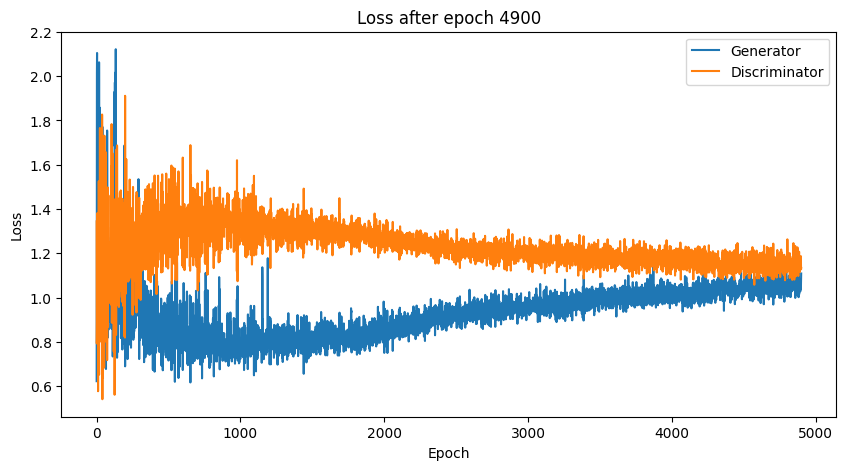

Time for epoch 4900 is 3.4134373664855957 sec
Time for epoch 4901 is 0.8669741153717041 sec
Time for epoch 4902 is 0.8679172992706299 sec
Time for epoch 4903 is 0.8682751655578613 sec
Time for epoch 4904 is 0.8829572200775146 sec
Time for epoch 4905 is 0.8736209869384766 sec
Time for epoch 4906 is 0.8818297386169434 sec
Time for epoch 4907 is 0.8737375736236572 sec
Time for epoch 4908 is 0.878734827041626 sec
Time for epoch 4909 is 0.8822038173675537 sec
Time for epoch 4910 is 0.8839273452758789 sec
Time for epoch 4911 is 0.8792345523834229 sec
Time for epoch 4912 is 0.8839643001556396 sec
Time for epoch 4913 is 0.880385160446167 sec
Time for epoch 4914 is 0.8833229541778564 sec
Time for epoch 4915 is 0.8846232891082764 sec
Time for epoch 4916 is 0.8878817558288574 sec
Time for epoch 4917 is 0.8840515613555908 sec
Time for epoch 4918 is 0.8860561847686768 sec
Time for epoch 4919 is 0.8836419582366943 sec
Time for epoch 4920 is 0.8884563446044922 sec
Time for epoch 4921 is 0.88507604598

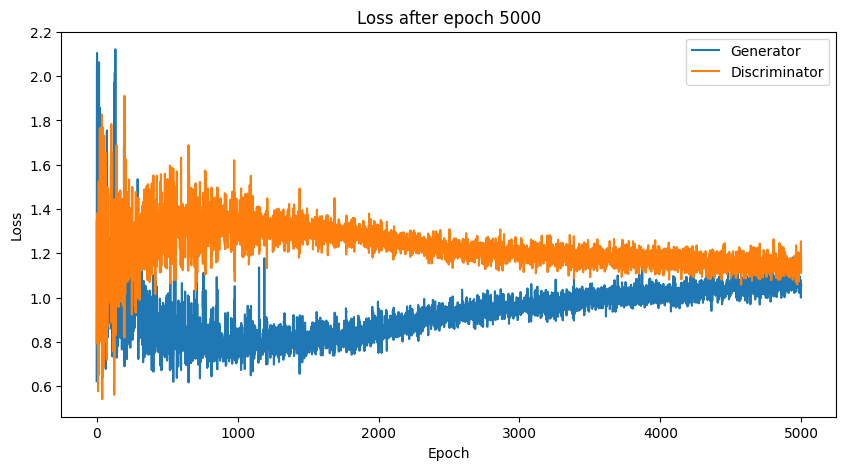

Time for epoch 5000 is 3.5989952087402344 sec
Time for epoch 5001 is 0.8599176406860352 sec
Time for epoch 5002 is 0.8681504726409912 sec
Time for epoch 5003 is 0.8699362277984619 sec
Time for epoch 5004 is 0.8771224021911621 sec
Time for epoch 5005 is 0.8776688575744629 sec
Time for epoch 5006 is 0.8811120986938477 sec
Time for epoch 5007 is 0.874103307723999 sec
Time for epoch 5008 is 0.878265380859375 sec
Time for epoch 5009 is 0.8804726600646973 sec
Time for epoch 5010 is 0.8941934108734131 sec
Time for epoch 5011 is 0.8789057731628418 sec
Time for epoch 5012 is 0.8856415748596191 sec
Time for epoch 5013 is 0.8859319686889648 sec
Time for epoch 5014 is 0.8795948028564453 sec
Time for epoch 5015 is 0.8848021030426025 sec
Time for epoch 5016 is 0.8811678886413574 sec
Time for epoch 5017 is 0.8827798366546631 sec
Time for epoch 5018 is 0.8902199268341064 sec
Time for epoch 5019 is 0.8900666236877441 sec
Time for epoch 5020 is 0.8832194805145264 sec
Time for epoch 5021 is 0.88984608650

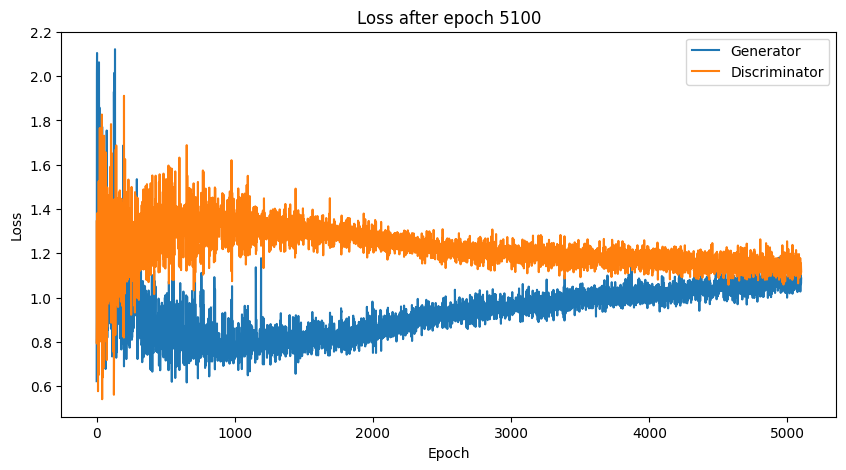

Time for epoch 5100 is 3.4195072650909424 sec
Time for epoch 5101 is 0.8639805316925049 sec
Time for epoch 5102 is 0.8724710941314697 sec
Time for epoch 5103 is 0.8779621124267578 sec
Time for epoch 5104 is 0.877399206161499 sec
Time for epoch 5105 is 0.8738620281219482 sec
Time for epoch 5106 is 0.8809993267059326 sec
Time for epoch 5107 is 0.8789429664611816 sec
Time for epoch 5108 is 0.8787188529968262 sec
Time for epoch 5109 is 0.890272855758667 sec
Time for epoch 5110 is 0.8807699680328369 sec
Time for epoch 5111 is 0.8812375068664551 sec
Time for epoch 5112 is 0.8830173015594482 sec
Time for epoch 5113 is 0.8841960430145264 sec
Time for epoch 5114 is 0.8828175067901611 sec
Time for epoch 5115 is 0.8867087364196777 sec
Time for epoch 5116 is 0.888333797454834 sec
Time for epoch 5117 is 0.8843655586242676 sec
Time for epoch 5118 is 0.884437084197998 sec
Time for epoch 5119 is 0.8823931217193604 sec
Time for epoch 5120 is 0.8870408535003662 sec
Time for epoch 5121 is 0.8902573585510

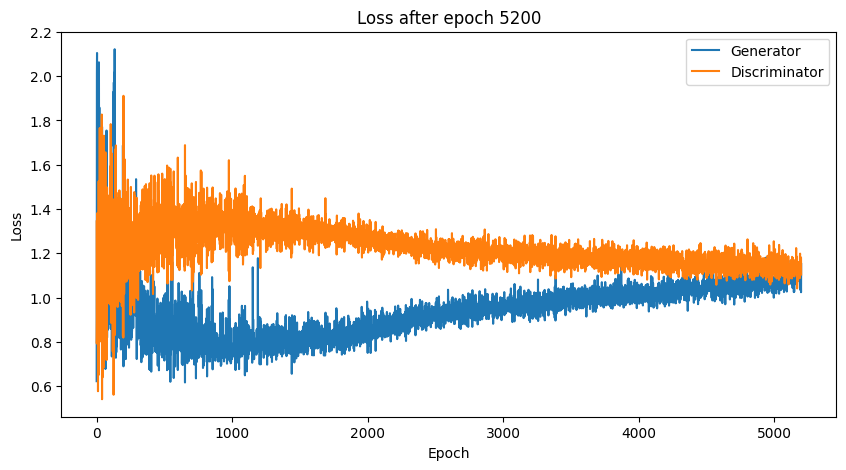

Time for epoch 5200 is 3.412026882171631 sec
Time for epoch 5201 is 0.8704285621643066 sec
Time for epoch 5202 is 0.8730885982513428 sec
Time for epoch 5203 is 0.8764543533325195 sec
Time for epoch 5204 is 0.871668815612793 sec
Time for epoch 5205 is 0.878192663192749 sec
Time for epoch 5206 is 0.8787558078765869 sec
Time for epoch 5207 is 1.0430147647857666 sec
Time for epoch 5208 is 0.8843502998352051 sec
Time for epoch 5209 is 0.8798065185546875 sec
Time for epoch 5210 is 0.8821096420288086 sec
Time for epoch 5211 is 0.8846836090087891 sec
Time for epoch 5212 is 0.8799936771392822 sec
Time for epoch 5213 is 0.8812689781188965 sec
Time for epoch 5214 is 0.8883223533630371 sec
Time for epoch 5215 is 0.8862109184265137 sec
Time for epoch 5216 is 0.8864188194274902 sec
Time for epoch 5217 is 0.884007453918457 sec
Time for epoch 5218 is 0.8874650001525879 sec
Time for epoch 5219 is 0.8814957141876221 sec
Time for epoch 5220 is 0.8847882747650146 sec
Time for epoch 5221 is 0.8896601200103

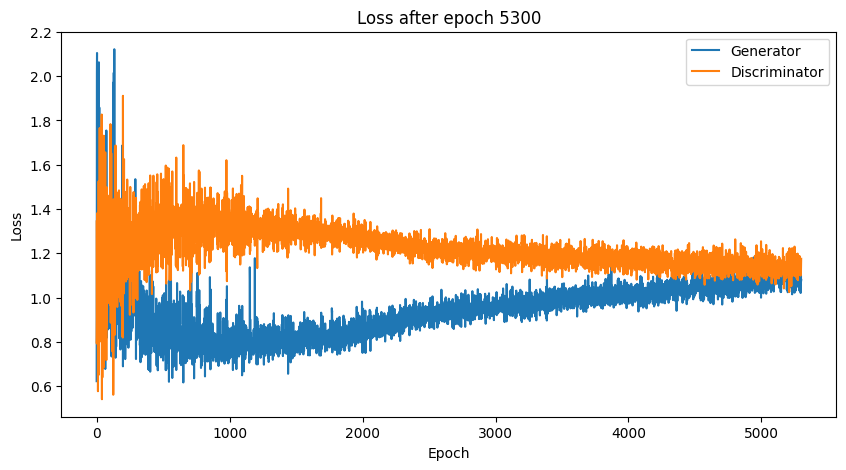

Time for epoch 5300 is 3.4135499000549316 sec
Time for epoch 5301 is 0.8637661933898926 sec
Time for epoch 5302 is 0.8633708953857422 sec
Time for epoch 5303 is 0.875394344329834 sec
Time for epoch 5304 is 0.8740439414978027 sec
Time for epoch 5305 is 0.8768267631530762 sec
Time for epoch 5306 is 0.8752977848052979 sec
Time for epoch 5307 is 0.8774089813232422 sec
Time for epoch 5308 is 0.8861219882965088 sec
Time for epoch 5309 is 0.8791296482086182 sec
Time for epoch 5310 is 0.8797907829284668 sec
Time for epoch 5311 is 0.8831677436828613 sec
Time for epoch 5312 is 0.8812134265899658 sec
Time for epoch 5313 is 0.88226318359375 sec
Time for epoch 5314 is 0.884345293045044 sec
Time for epoch 5315 is 0.8845415115356445 sec
Time for epoch 5316 is 0.8864407539367676 sec
Time for epoch 5317 is 0.8917369842529297 sec
Time for epoch 5318 is 0.880723237991333 sec
Time for epoch 5319 is 0.8842489719390869 sec
Time for epoch 5320 is 0.8856260776519775 sec
Time for epoch 5321 is 0.89192485809326

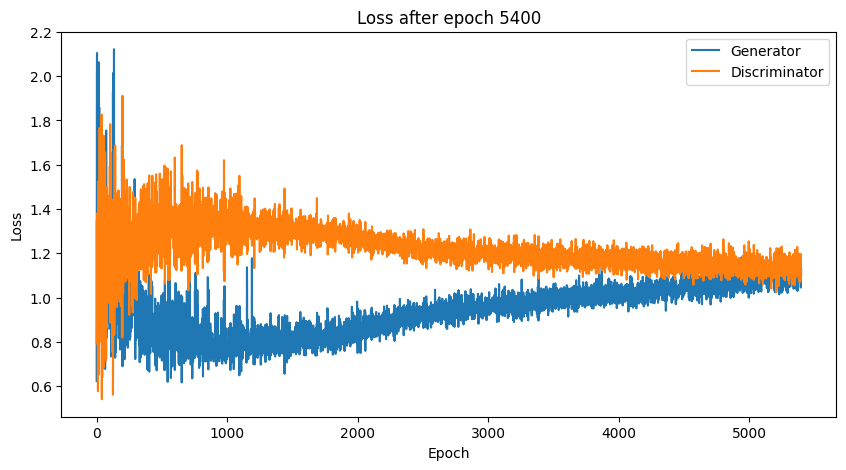

Time for epoch 5400 is 3.6138691902160645 sec
Time for epoch 5401 is 0.8708534240722656 sec
Time for epoch 5402 is 0.8712847232818604 sec
Time for epoch 5403 is 0.8672909736633301 sec
Time for epoch 5404 is 0.8823757171630859 sec
Time for epoch 5405 is 0.8724632263183594 sec
Time for epoch 5406 is 0.878349781036377 sec
Time for epoch 5407 is 0.8812150955200195 sec
Time for epoch 5408 is 0.8763236999511719 sec
Time for epoch 5409 is 0.881497859954834 sec
Time for epoch 5410 is 0.8836863040924072 sec
Time for epoch 5411 is 0.8792812824249268 sec
Time for epoch 5412 is 0.8822100162506104 sec
Time for epoch 5413 is 0.8803143501281738 sec
Time for epoch 5414 is 0.8825187683105469 sec
Time for epoch 5415 is 0.8847615718841553 sec
Time for epoch 5416 is 0.8909487724304199 sec
Time for epoch 5417 is 0.8839728832244873 sec
Time for epoch 5418 is 0.8854851722717285 sec
Time for epoch 5419 is 0.8878991603851318 sec
Time for epoch 5420 is 0.8833587169647217 sec
Time for epoch 5421 is 0.88585305213

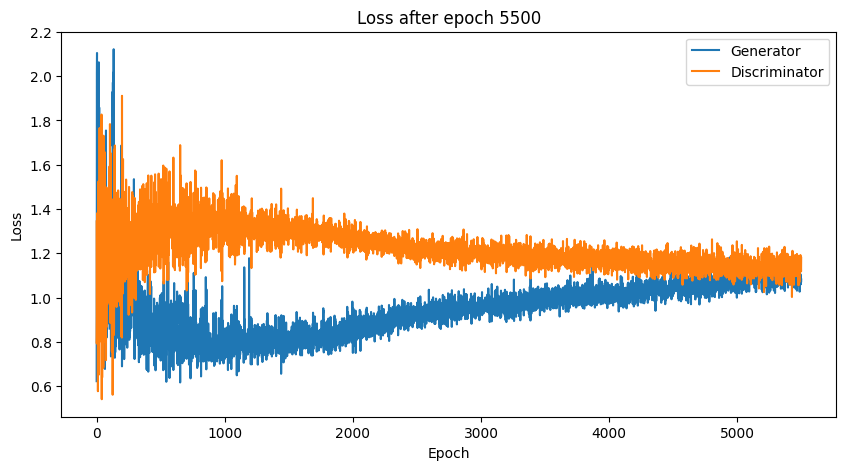

Time for epoch 5500 is 3.492844581604004 sec
Time for epoch 5501 is 0.8678128719329834 sec
Time for epoch 5502 is 0.865713357925415 sec
Time for epoch 5503 is 0.8798799514770508 sec
Time for epoch 5504 is 0.8703403472900391 sec
Time for epoch 5505 is 0.8796145915985107 sec
Time for epoch 5506 is 0.886695146560669 sec
Time for epoch 5507 is 0.8777632713317871 sec
Time for epoch 5508 is 0.8805313110351562 sec
Time for epoch 5509 is 0.8809356689453125 sec
Time for epoch 5510 is 0.8850891590118408 sec
Time for epoch 5511 is 0.8819007873535156 sec
Time for epoch 5512 is 0.88832688331604 sec
Time for epoch 5513 is 0.8823058605194092 sec
Time for epoch 5514 is 0.8859567642211914 sec
Time for epoch 5515 is 0.8815934658050537 sec
Time for epoch 5516 is 0.8860361576080322 sec
Time for epoch 5517 is 0.8810768127441406 sec
Time for epoch 5518 is 0.8920981884002686 sec
Time for epoch 5519 is 0.8848137855529785 sec
Time for epoch 5520 is 0.8910071849822998 sec
Time for epoch 5521 is 0.88830208778381

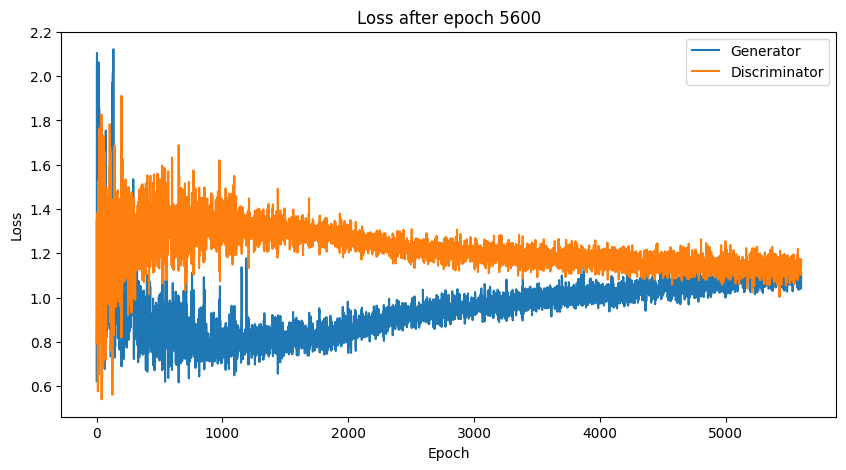

Time for epoch 5600 is 3.602693796157837 sec
Time for epoch 5601 is 0.8583571910858154 sec
Time for epoch 5602 is 0.8641951084136963 sec
Time for epoch 5603 is 0.8694877624511719 sec
Time for epoch 5604 is 0.8718652725219727 sec
Time for epoch 5605 is 0.8747389316558838 sec
Time for epoch 5606 is 0.8794949054718018 sec
Time for epoch 5607 is 0.8721258640289307 sec
Time for epoch 5608 is 0.8766398429870605 sec
Time for epoch 5609 is 0.8850421905517578 sec
Time for epoch 5610 is 0.884312629699707 sec
Time for epoch 5611 is 0.8831877708435059 sec
Time for epoch 5612 is 0.8790256977081299 sec
Time for epoch 5613 is 0.880913496017456 sec
Time for epoch 5614 is 0.8822152614593506 sec
Time for epoch 5615 is 0.8829121589660645 sec
Time for epoch 5616 is 0.8863623142242432 sec
Time for epoch 5617 is 0.8815186023712158 sec
Time for epoch 5618 is 0.8863399028778076 sec
Time for epoch 5619 is 0.8865787982940674 sec
Time for epoch 5620 is 0.8857846260070801 sec
Time for epoch 5621 is 0.884343624114

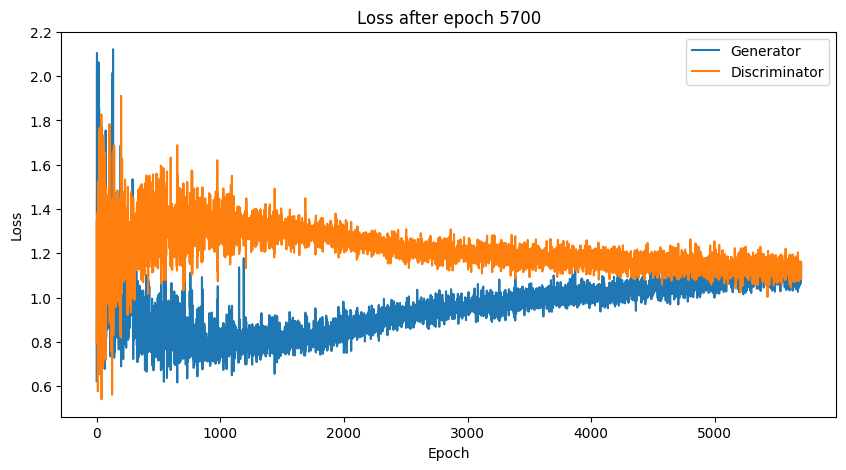

Time for epoch 5700 is 3.427889823913574 sec
Time for epoch 5701 is 0.8697609901428223 sec
Time for epoch 5702 is 0.8688766956329346 sec
Time for epoch 5703 is 0.86517333984375 sec
Time for epoch 5704 is 0.8788549900054932 sec
Time for epoch 5705 is 0.8770129680633545 sec
Time for epoch 5706 is 0.8729474544525146 sec
Time for epoch 5707 is 0.8839278221130371 sec
Time for epoch 5708 is 0.8776059150695801 sec
Time for epoch 5709 is 0.8807024955749512 sec
Time for epoch 5710 is 0.883124828338623 sec
Time for epoch 5711 is 0.8830380439758301 sec
Time for epoch 5712 is 0.8810169696807861 sec
Time for epoch 5713 is 0.8814778327941895 sec
Time for epoch 5714 is 0.8868083953857422 sec
Time for epoch 5715 is 0.8806288242340088 sec
Time for epoch 5716 is 0.8853504657745361 sec
Time for epoch 5717 is 0.8863997459411621 sec
Time for epoch 5718 is 0.8873593807220459 sec
Time for epoch 5719 is 0.893887996673584 sec
Time for epoch 5720 is 0.8840603828430176 sec
Time for epoch 5721 is 0.88783526420593

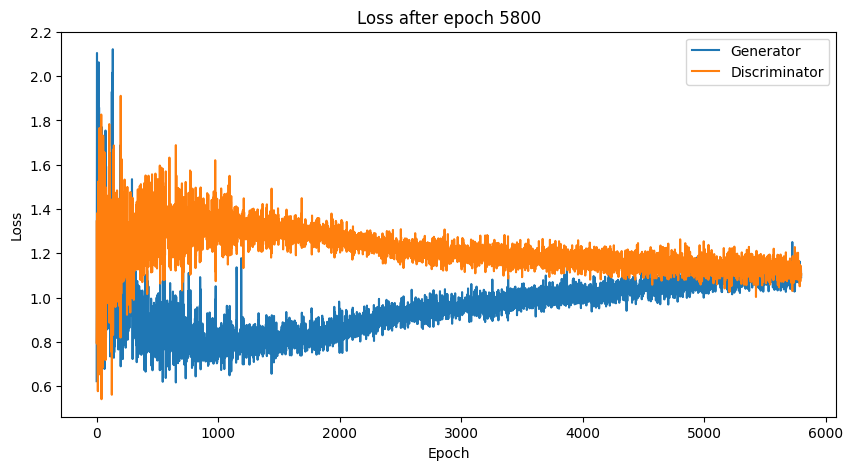

Time for epoch 5800 is 3.4451253414154053 sec
Time for epoch 5801 is 0.8711822032928467 sec
Time for epoch 5802 is 0.864222526550293 sec
Time for epoch 5803 is 0.872516393661499 sec
Time for epoch 5804 is 0.8758745193481445 sec
Time for epoch 5805 is 0.879934549331665 sec
Time for epoch 5806 is 0.8862035274505615 sec
Time for epoch 5807 is 0.8822672367095947 sec
Time for epoch 5808 is 0.8777728080749512 sec
Time for epoch 5809 is 0.8814125061035156 sec
Time for epoch 5810 is 0.8860411643981934 sec
Time for epoch 5811 is 0.8799164295196533 sec
Time for epoch 5812 is 0.8852684497833252 sec
Time for epoch 5813 is 0.882652997970581 sec
Time for epoch 5814 is 0.8856909275054932 sec
Time for epoch 5815 is 0.8856472969055176 sec
Time for epoch 5816 is 0.8932788372039795 sec
Time for epoch 5817 is 0.8857324123382568 sec
Time for epoch 5818 is 0.8867948055267334 sec
Time for epoch 5819 is 0.8872628211975098 sec
Time for epoch 5820 is 0.8864459991455078 sec
Time for epoch 5821 is 0.8906495571136

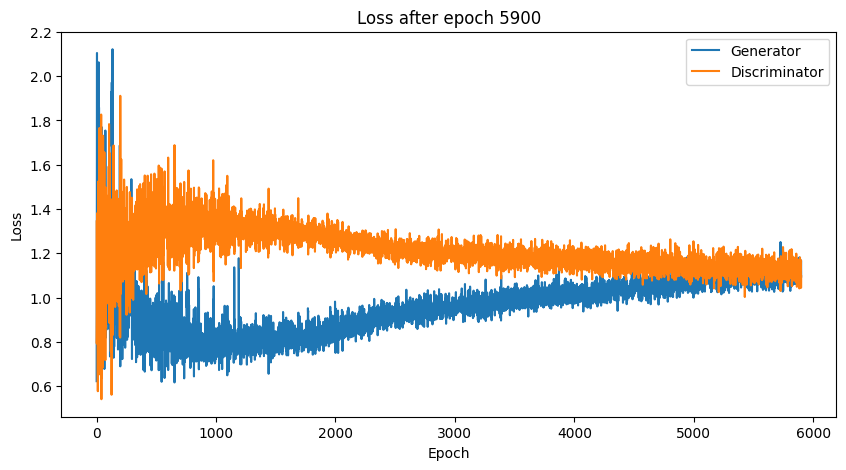

Time for epoch 5900 is 3.5954058170318604 sec
Time for epoch 5901 is 0.8646032810211182 sec
Time for epoch 5902 is 0.8661999702453613 sec
Time for epoch 5903 is 0.8735175132751465 sec
Time for epoch 5904 is 0.8765792846679688 sec
Time for epoch 5905 is 0.87359619140625 sec
Time for epoch 5906 is 0.8782904148101807 sec
Time for epoch 5907 is 0.8777303695678711 sec
Time for epoch 5908 is 0.885936975479126 sec
Time for epoch 5909 is 0.8766133785247803 sec
Time for epoch 5910 is 0.8802425861358643 sec
Time for epoch 5911 is 0.8847291469573975 sec
Time for epoch 5912 is 0.878838062286377 sec
Time for epoch 5913 is 0.8901565074920654 sec
Time for epoch 5914 is 0.8811004161834717 sec
Time for epoch 5915 is 0.8829140663146973 sec
Time for epoch 5916 is 0.8834309577941895 sec
Time for epoch 5917 is 0.8905391693115234 sec
Time for epoch 5918 is 0.8893249034881592 sec
Time for epoch 5919 is 0.8814830780029297 sec
Time for epoch 5920 is 0.8896005153656006 sec
Time for epoch 5921 is 0.8881220817565

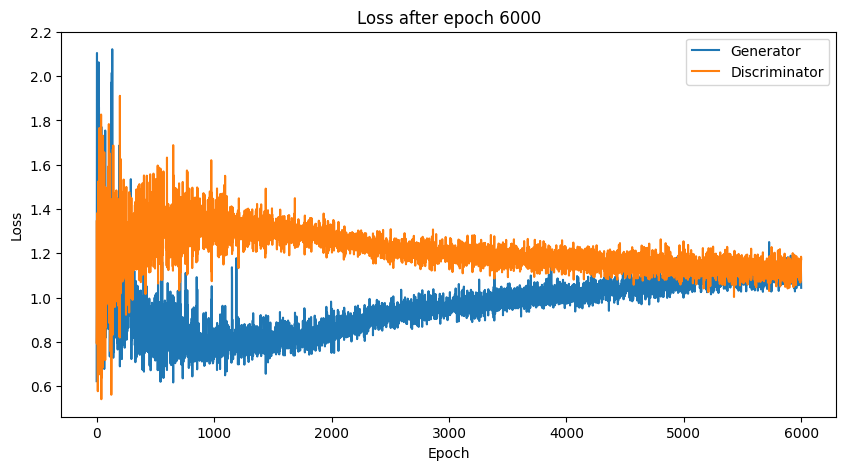

Time for epoch 6000 is 3.5999743938446045 sec
Time for epoch 6001 is 0.8610093593597412 sec
Time for epoch 6002 is 0.8675942420959473 sec
Time for epoch 6003 is 0.8696064949035645 sec
Time for epoch 6004 is 0.8737599849700928 sec
Time for epoch 6005 is 0.874626636505127 sec
Time for epoch 6006 is 0.875471830368042 sec
Time for epoch 6007 is 0.8779375553131104 sec
Time for epoch 6008 is 0.8868062496185303 sec
Time for epoch 6009 is 0.8862371444702148 sec
Time for epoch 6010 is 0.8785750865936279 sec
Time for epoch 6011 is 0.884730339050293 sec
Time for epoch 6012 is 0.8842873573303223 sec
Time for epoch 6013 is 0.8815224170684814 sec
Time for epoch 6014 is 0.8834331035614014 sec
Time for epoch 6015 is 0.8851122856140137 sec
Time for epoch 6016 is 0.8833930492401123 sec
Time for epoch 6017 is 0.8884570598602295 sec
Time for epoch 6018 is 0.882103443145752 sec
Time for epoch 6019 is 0.8840878009796143 sec
Time for epoch 6020 is 0.8827579021453857 sec
Time for epoch 6021 is 0.8901433944702

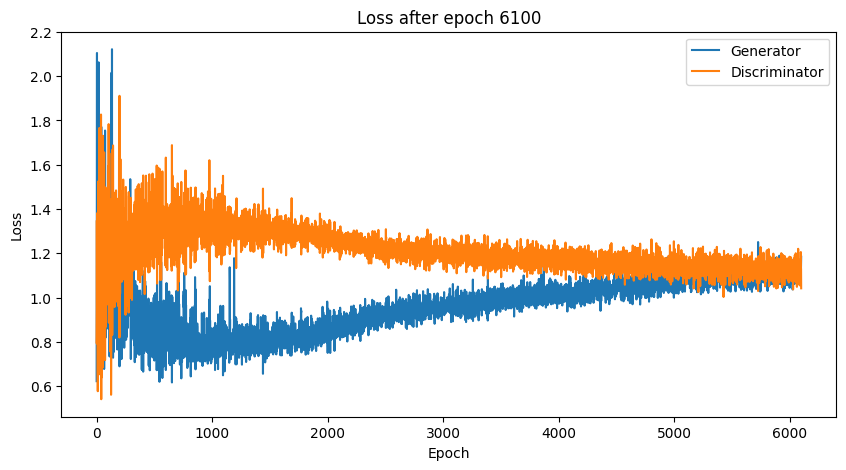

Time for epoch 6100 is 3.4505512714385986 sec
Time for epoch 6101 is 0.8749279975891113 sec
Time for epoch 6102 is 0.8680274486541748 sec
Time for epoch 6103 is 0.8764910697937012 sec
Time for epoch 6104 is 0.8708429336547852 sec
Time for epoch 6105 is 0.876612663269043 sec
Time for epoch 6106 is 0.880129337310791 sec
Time for epoch 6107 is 0.8818724155426025 sec
Time for epoch 6108 is 0.87969970703125 sec
Time for epoch 6109 is 0.8835651874542236 sec
Time for epoch 6110 is 0.886798620223999 sec
Time for epoch 6111 is 0.8829281330108643 sec
Time for epoch 6112 is 0.8818497657775879 sec
Time for epoch 6113 is 0.8803958892822266 sec
Time for epoch 6114 is 0.8848111629486084 sec
Time for epoch 6115 is 0.8889954090118408 sec
Time for epoch 6116 is 0.881533145904541 sec
Time for epoch 6117 is 0.8879129886627197 sec
Time for epoch 6118 is 0.8891949653625488 sec
Time for epoch 6119 is 0.8843045234680176 sec
Time for epoch 6120 is 0.8881876468658447 sec
Time for epoch 6121 is 0.886395931243896

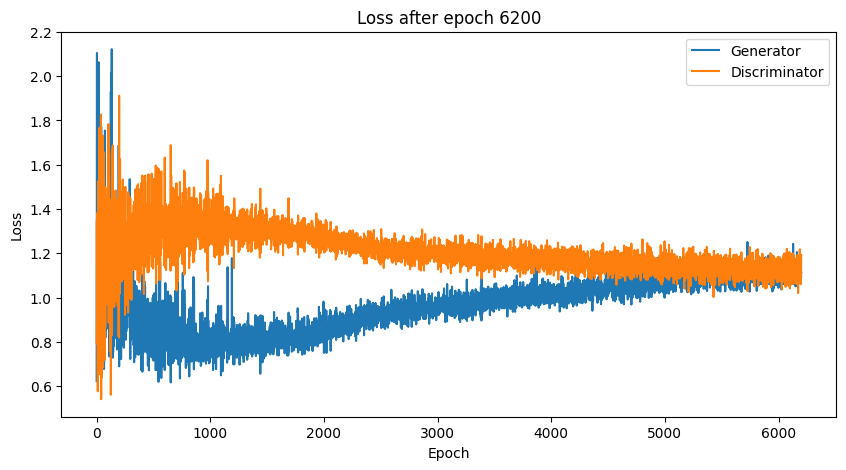

Time for epoch 6200 is 3.671686887741089 sec
Time for epoch 6201 is 0.867042064666748 sec
Time for epoch 6202 is 0.8642408847808838 sec
Time for epoch 6203 is 0.8745932579040527 sec
Time for epoch 6204 is 0.8661737442016602 sec
Time for epoch 6205 is 0.8804118633270264 sec
Time for epoch 6206 is 0.8767104148864746 sec
Time for epoch 6207 is 0.8777787685394287 sec
Time for epoch 6208 is 0.8792262077331543 sec
Time for epoch 6209 is 0.8857853412628174 sec
Time for epoch 6210 is 0.8863928318023682 sec
Time for epoch 6211 is 0.8754053115844727 sec
Time for epoch 6212 is 0.8841946125030518 sec
Time for epoch 6213 is 0.8820414543151855 sec
Time for epoch 6214 is 0.8871934413909912 sec
Time for epoch 6215 is 0.8839571475982666 sec
Time for epoch 6216 is 0.8895001411437988 sec
Time for epoch 6217 is 0.8845808506011963 sec
Time for epoch 6218 is 0.8867218494415283 sec
Time for epoch 6219 is 0.8852672576904297 sec
Time for epoch 6220 is 0.8885951042175293 sec
Time for epoch 6221 is 0.88450789451

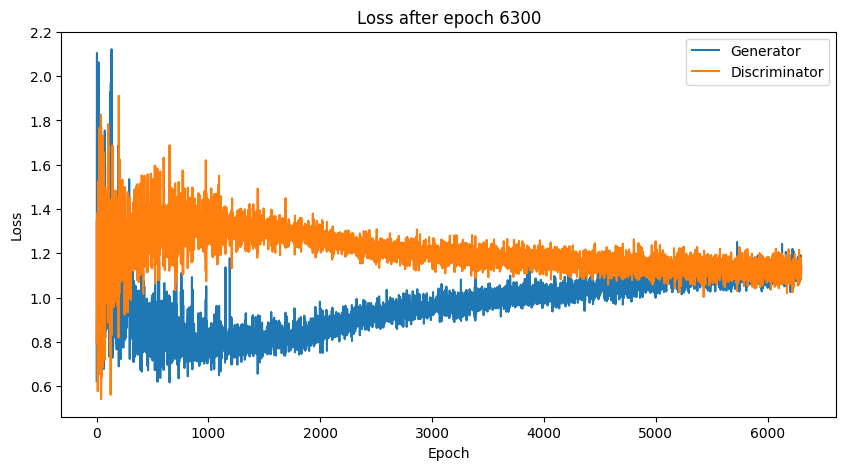

Time for epoch 6300 is 3.443652629852295 sec
Time for epoch 6301 is 0.8595478534698486 sec
Time for epoch 6302 is 0.8656668663024902 sec
Time for epoch 6303 is 0.8718020915985107 sec
Time for epoch 6304 is 0.8731563091278076 sec
Time for epoch 6305 is 0.878211259841919 sec
Time for epoch 6306 is 0.8820819854736328 sec
Time for epoch 6307 is 0.8790500164031982 sec
Time for epoch 6308 is 0.878373384475708 sec
Time for epoch 6309 is 0.8810529708862305 sec
Time for epoch 6310 is 0.8844590187072754 sec
Time for epoch 6311 is 0.8808965682983398 sec
Time for epoch 6312 is 0.8827097415924072 sec
Time for epoch 6313 is 0.8831162452697754 sec
Time for epoch 6314 is 0.8834164142608643 sec
Time for epoch 6315 is 0.8827078342437744 sec
Time for epoch 6316 is 0.8849866390228271 sec
Time for epoch 6317 is 0.884549617767334 sec
Time for epoch 6318 is 0.8856503963470459 sec
Time for epoch 6319 is 0.886833667755127 sec
Time for epoch 6320 is 0.8892359733581543 sec
Time for epoch 6321 is 0.88533425331115

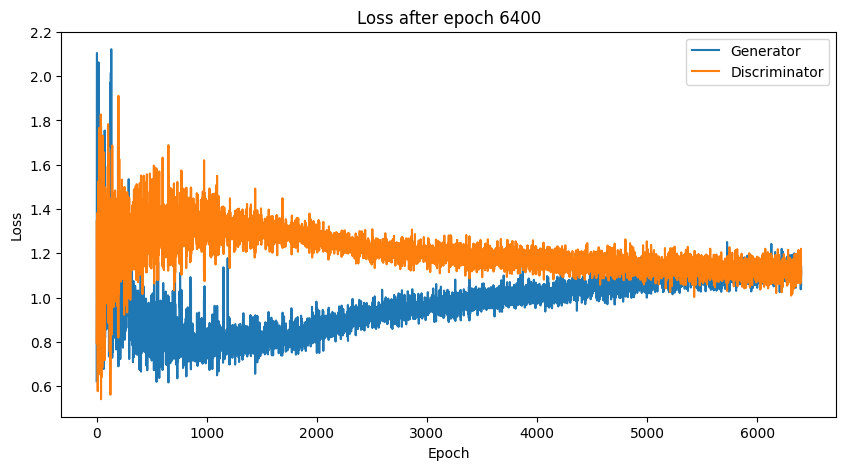

Time for epoch 6400 is 3.613741874694824 sec
Time for epoch 6401 is 0.8706531524658203 sec
Time for epoch 6402 is 0.8614246845245361 sec
Time for epoch 6403 is 0.8740603923797607 sec
Time for epoch 6404 is 0.8754405975341797 sec
Time for epoch 6405 is 0.8746929168701172 sec
Time for epoch 6406 is 0.8766524791717529 sec
Time for epoch 6407 is 0.882274866104126 sec
Time for epoch 6408 is 0.8826541900634766 sec
Time for epoch 6409 is 0.8784768581390381 sec
Time for epoch 6410 is 0.8809254169464111 sec
Time for epoch 6411 is 0.8824515342712402 sec
Time for epoch 6412 is 0.8780474662780762 sec
Time for epoch 6413 is 0.8871448040008545 sec
Time for epoch 6414 is 0.8897337913513184 sec
Time for epoch 6415 is 0.8828167915344238 sec
Time for epoch 6416 is 0.8813879489898682 sec
Time for epoch 6417 is 0.8847284317016602 sec
Time for epoch 6418 is 0.8848943710327148 sec
Time for epoch 6419 is 0.8879144191741943 sec
Time for epoch 6420 is 0.8878357410430908 sec
Time for epoch 6421 is 0.88894987106

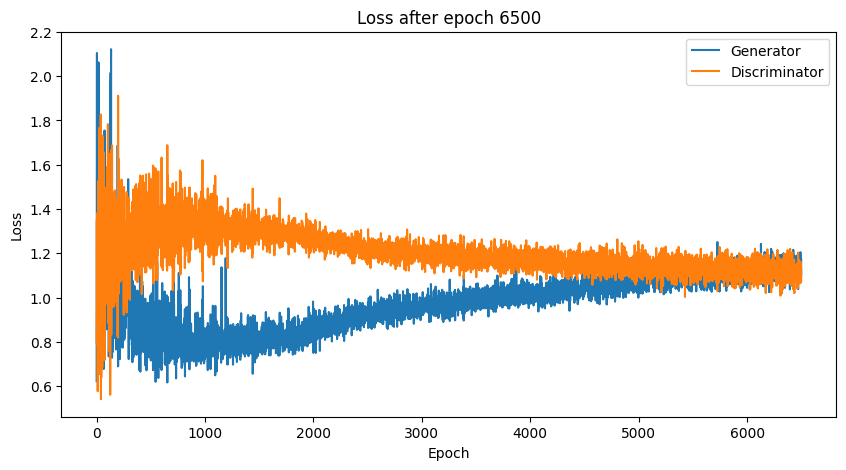

Time for epoch 6500 is 3.4545624256134033 sec
Time for epoch 6501 is 0.8567924499511719 sec
Time for epoch 6502 is 0.8651731014251709 sec
Time for epoch 6503 is 0.8742666244506836 sec
Time for epoch 6504 is 0.8746170997619629 sec
Time for epoch 6505 is 0.8771038055419922 sec
Time for epoch 6506 is 0.880403995513916 sec
Time for epoch 6507 is 0.8784818649291992 sec
Time for epoch 6508 is 0.8840289115905762 sec
Time for epoch 6509 is 0.8770051002502441 sec
Time for epoch 6510 is 0.8884317874908447 sec
Time for epoch 6511 is 0.8820757865905762 sec
Time for epoch 6512 is 0.8835780620574951 sec
Time for epoch 6513 is 0.8848402500152588 sec
Time for epoch 6514 is 0.8820011615753174 sec
Time for epoch 6515 is 0.8810713291168213 sec
Time for epoch 6516 is 0.8853051662445068 sec
Time for epoch 6517 is 0.8866260051727295 sec
Time for epoch 6518 is 0.8873705863952637 sec
Time for epoch 6519 is 0.8866088390350342 sec
Time for epoch 6520 is 0.8837075233459473 sec
Time for epoch 6521 is 0.8845643997

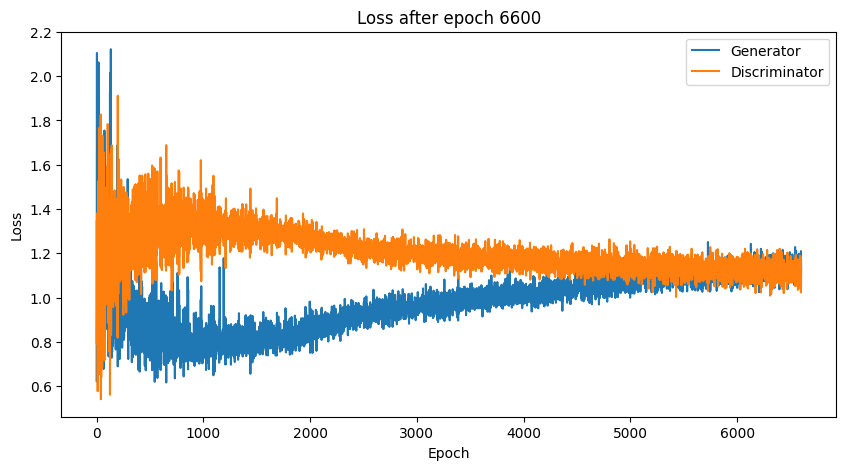

Time for epoch 6600 is 3.6322293281555176 sec
Time for epoch 6601 is 0.8669393062591553 sec
Time for epoch 6602 is 0.8698253631591797 sec
Time for epoch 6603 is 0.8708443641662598 sec
Time for epoch 6604 is 0.8706915378570557 sec
Time for epoch 6605 is 0.8788638114929199 sec
Time for epoch 6606 is 0.8906967639923096 sec
Time for epoch 6607 is 0.8772585391998291 sec
Time for epoch 6608 is 0.879845142364502 sec
Time for epoch 6609 is 0.8772056102752686 sec
Time for epoch 6610 is 0.8793785572052002 sec
Time for epoch 6611 is 0.8843910694122314 sec
Time for epoch 6612 is 0.8830318450927734 sec
Time for epoch 6613 is 0.885465145111084 sec
Time for epoch 6614 is 0.8810563087463379 sec
Time for epoch 6615 is 0.8900086879730225 sec
Time for epoch 6616 is 0.8818552494049072 sec
Time for epoch 6617 is 0.8838925361633301 sec
Time for epoch 6618 is 0.883969783782959 sec
Time for epoch 6619 is 0.8902671337127686 sec
Time for epoch 6620 is 0.8834671974182129 sec
Time for epoch 6621 is 0.887766122817

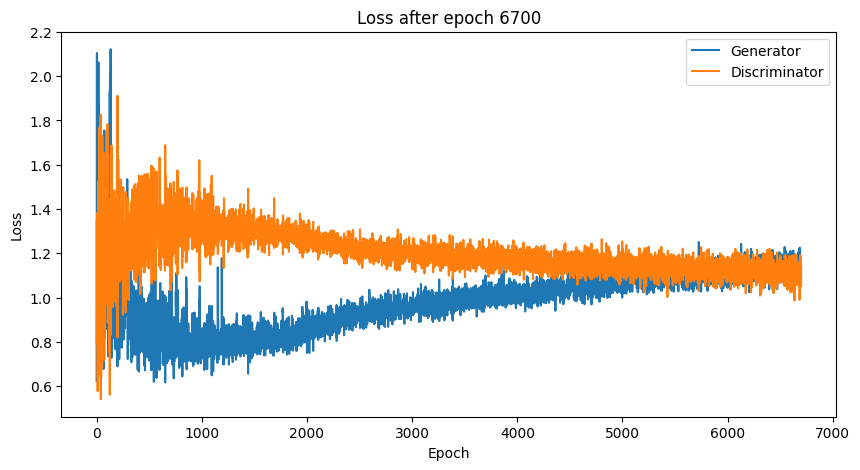

Time for epoch 6700 is 3.482560873031616 sec
Time for epoch 6701 is 0.8452358245849609 sec
Time for epoch 6702 is 0.872612714767456 sec
Time for epoch 6703 is 0.8740420341491699 sec
Time for epoch 6704 is 0.8762028217315674 sec
Time for epoch 6705 is 0.875601053237915 sec
Time for epoch 6706 is 0.8791689872741699 sec
Time for epoch 6707 is 0.8817362785339355 sec
Time for epoch 6708 is 0.8833408355712891 sec
Time for epoch 6709 is 0.8829243183135986 sec
Time for epoch 6710 is 0.882361650466919 sec
Time for epoch 6711 is 0.8810954093933105 sec
Time for epoch 6712 is 0.8829419612884521 sec
Time for epoch 6713 is 0.8823370933532715 sec
Time for epoch 6714 is 0.8840017318725586 sec
Time for epoch 6715 is 0.8839640617370605 sec
Time for epoch 6716 is 0.8883826732635498 sec
Time for epoch 6717 is 0.8883309364318848 sec
Time for epoch 6718 is 0.8868515491485596 sec
Time for epoch 6719 is 0.8884925842285156 sec
Time for epoch 6720 is 0.8866283893585205 sec
Time for epoch 6721 is 0.8820223808288

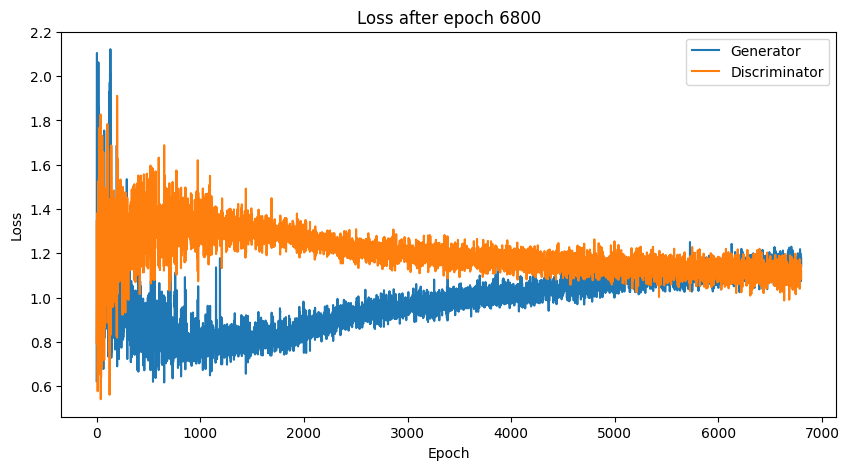

Time for epoch 6800 is 3.6160831451416016 sec
Time for epoch 6801 is 0.8683006763458252 sec
Time for epoch 6802 is 0.8648586273193359 sec
Time for epoch 6803 is 0.8710215091705322 sec
Time for epoch 6804 is 0.8793349266052246 sec
Time for epoch 6805 is 0.8730354309082031 sec
Time for epoch 6806 is 0.872617244720459 sec
Time for epoch 6807 is 0.8772628307342529 sec
Time for epoch 6808 is 0.8822717666625977 sec
Time for epoch 6809 is 0.8781282901763916 sec
Time for epoch 6810 is 0.8797540664672852 sec
Time for epoch 6811 is 0.8810904026031494 sec
Time for epoch 6812 is 0.8832433223724365 sec
Time for epoch 6813 is 0.8807759284973145 sec
Time for epoch 6814 is 0.8822653293609619 sec
Time for epoch 6815 is 0.8795678615570068 sec
Time for epoch 6816 is 0.8877453804016113 sec
Time for epoch 6817 is 0.8830764293670654 sec
Time for epoch 6818 is 0.8806304931640625 sec
Time for epoch 6819 is 0.8861706256866455 sec
Time for epoch 6820 is 0.8871142864227295 sec
Time for epoch 6821 is 0.8873903751

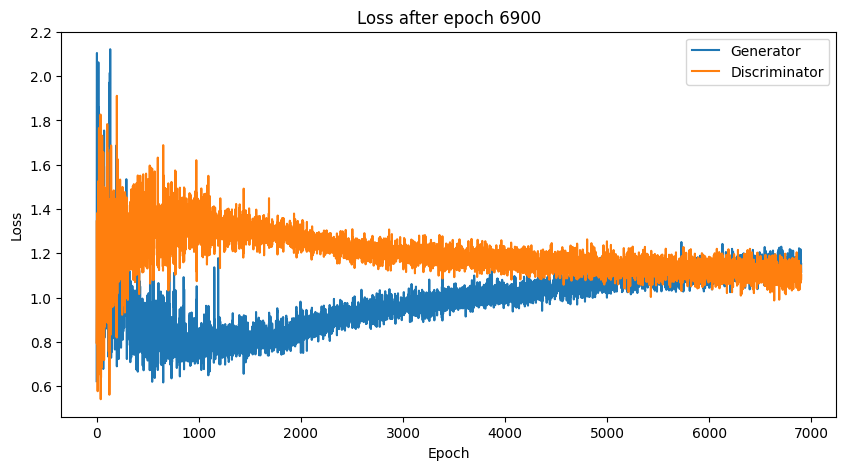

Time for epoch 6900 is 3.4591104984283447 sec
Time for epoch 6901 is 0.8588316440582275 sec
Time for epoch 6902 is 0.8636720180511475 sec
Time for epoch 6903 is 0.8739550113677979 sec
Time for epoch 6904 is 0.8798096179962158 sec
Time for epoch 6905 is 0.8759498596191406 sec
Time for epoch 6906 is 0.8806166648864746 sec
Time for epoch 6907 is 0.8799762725830078 sec
Time for epoch 6908 is 0.8816978931427002 sec
Time for epoch 6909 is 0.8785736560821533 sec
Time for epoch 6910 is 0.883251428604126 sec
Time for epoch 6911 is 0.8821640014648438 sec
Time for epoch 6912 is 0.8857078552246094 sec
Time for epoch 6913 is 0.8880882263183594 sec
Time for epoch 6914 is 0.8832082748413086 sec
Time for epoch 6915 is 0.8832097053527832 sec
Time for epoch 6916 is 0.8820633888244629 sec
Time for epoch 6917 is 0.8908402919769287 sec
Time for epoch 6918 is 0.882554292678833 sec
Time for epoch 6919 is 0.8856947422027588 sec
Time for epoch 6920 is 0.889397144317627 sec
Time for epoch 6921 is 0.886903524398

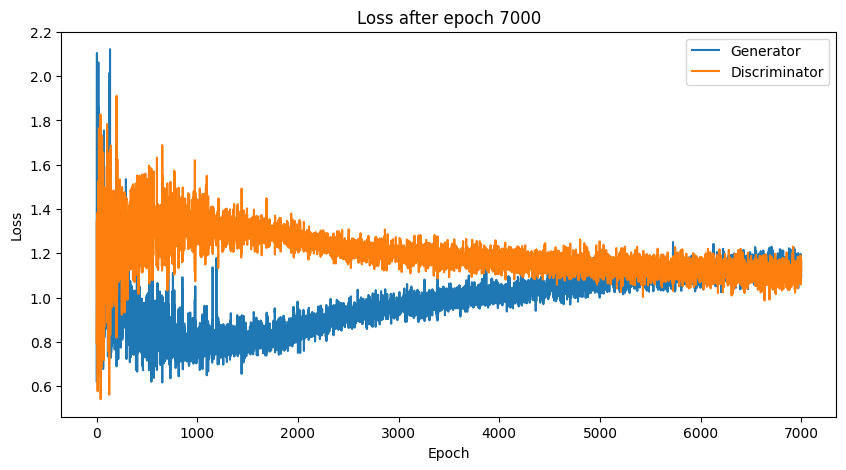

Time for epoch 7000 is 3.730111598968506 sec
Time for epoch 7001 is 0.8498396873474121 sec
Time for epoch 7002 is 0.8709437847137451 sec
Time for epoch 7003 is 0.8674919605255127 sec
Time for epoch 7004 is 0.8758797645568848 sec
Time for epoch 7005 is 0.8758196830749512 sec
Time for epoch 7006 is 0.8755178451538086 sec
Time for epoch 7007 is 0.8812801837921143 sec
Time for epoch 7008 is 0.8763246536254883 sec
Time for epoch 7009 is 0.8787457942962646 sec
Time for epoch 7010 is 0.8814013004302979 sec
Time for epoch 7011 is 0.8801281452178955 sec
Time for epoch 7012 is 0.883328914642334 sec
Time for epoch 7013 is 0.8811397552490234 sec
Time for epoch 7014 is 0.8863911628723145 sec
Time for epoch 7015 is 0.8869645595550537 sec
Time for epoch 7016 is 0.8820786476135254 sec
Time for epoch 7017 is 0.8861005306243896 sec
Time for epoch 7018 is 0.8831691741943359 sec
Time for epoch 7019 is 0.8882882595062256 sec
Time for epoch 7020 is 0.8850283622741699 sec
Time for epoch 7021 is 0.88724994659

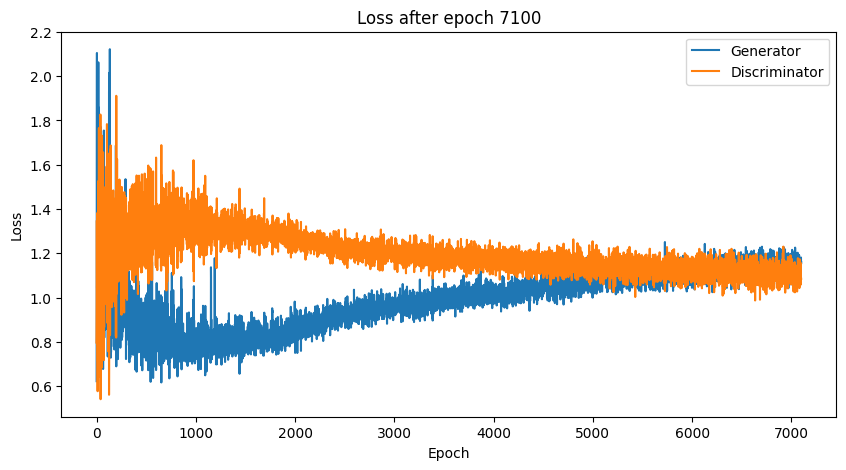

Time for epoch 7100 is 3.4980640411376953 sec
Time for epoch 7101 is 0.8673787117004395 sec
Time for epoch 7102 is 0.8639118671417236 sec
Time for epoch 7103 is 0.8675031661987305 sec
Time for epoch 7104 is 0.8723604679107666 sec
Time for epoch 7105 is 0.873831033706665 sec
Time for epoch 7106 is 0.8734660148620605 sec
Time for epoch 7107 is 0.8725533485412598 sec
Time for epoch 7108 is 0.883965253829956 sec
Time for epoch 7109 is 0.8854453563690186 sec
Time for epoch 7110 is 0.88033127784729 sec
Time for epoch 7111 is 0.8788113594055176 sec
Time for epoch 7112 is 0.8806314468383789 sec
Time for epoch 7113 is 0.8806631565093994 sec
Time for epoch 7114 is 0.8854608535766602 sec
Time for epoch 7115 is 0.8796398639678955 sec
Time for epoch 7116 is 0.8814890384674072 sec
Time for epoch 7117 is 0.8822050094604492 sec
Time for epoch 7118 is 0.8883728981018066 sec
Time for epoch 7119 is 0.8870680332183838 sec
Time for epoch 7120 is 0.8856534957885742 sec
Time for epoch 7121 is 0.8848080635070

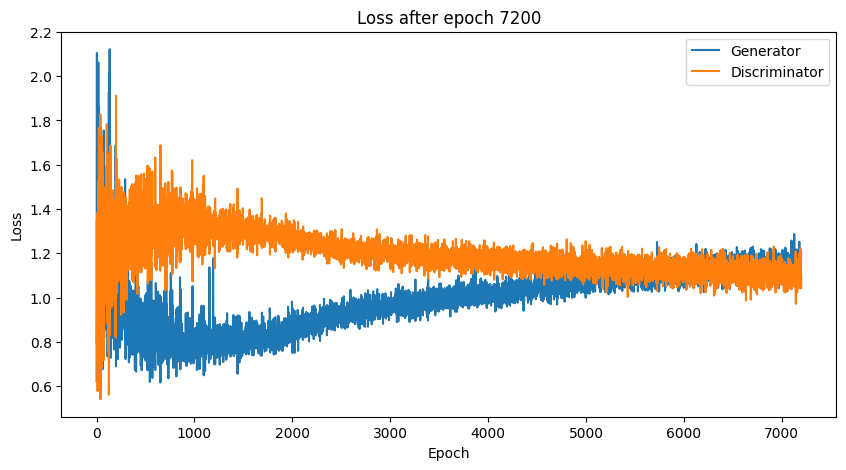

Time for epoch 7200 is 3.688708543777466 sec
Time for epoch 7201 is 0.8493399620056152 sec
Time for epoch 7202 is 0.8736274242401123 sec
Time for epoch 7203 is 0.8718099594116211 sec
Time for epoch 7204 is 0.8731374740600586 sec
Time for epoch 7205 is 0.8755526542663574 sec
Time for epoch 7206 is 0.8764338493347168 sec
Time for epoch 7207 is 0.8791651725769043 sec
Time for epoch 7208 is 0.8782985210418701 sec
Time for epoch 7209 is 0.8794331550598145 sec
Time for epoch 7210 is 0.8838484287261963 sec
Time for epoch 7211 is 0.8810479640960693 sec
Time for epoch 7212 is 0.8865783214569092 sec
Time for epoch 7213 is 0.8829212188720703 sec
Time for epoch 7214 is 0.8834397792816162 sec
Time for epoch 7215 is 0.8841695785522461 sec
Time for epoch 7216 is 0.8810279369354248 sec
Time for epoch 7217 is 0.8843269348144531 sec
Time for epoch 7218 is 0.879540205001831 sec
Time for epoch 7219 is 0.8847141265869141 sec
Time for epoch 7220 is 0.8910858631134033 sec
Time for epoch 7221 is 0.88154935836

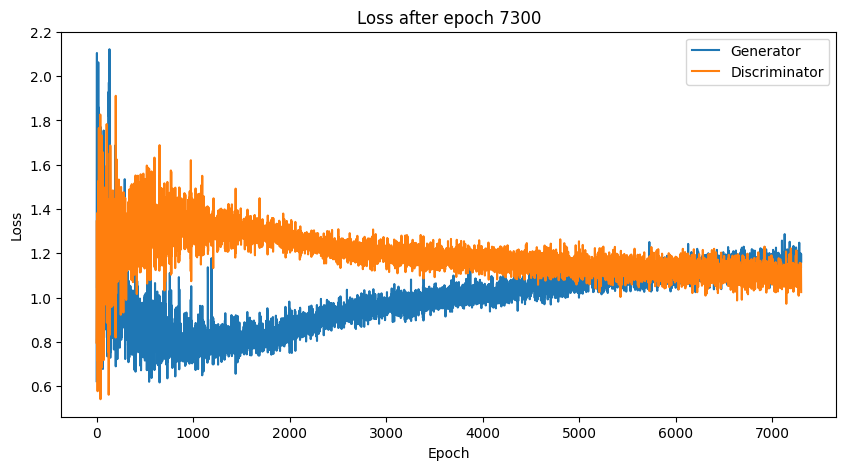

Time for epoch 7300 is 3.487814426422119 sec
Time for epoch 7301 is 0.8664345741271973 sec
Time for epoch 7302 is 0.8668210506439209 sec
Time for epoch 7303 is 0.8716204166412354 sec
Time for epoch 7304 is 0.8753635883331299 sec
Time for epoch 7305 is 0.8753705024719238 sec
Time for epoch 7306 is 0.8836398124694824 sec
Time for epoch 7307 is 0.8769395351409912 sec
Time for epoch 7308 is 0.8799762725830078 sec
Time for epoch 7309 is 0.8799910545349121 sec
Time for epoch 7310 is 0.8795571327209473 sec
Time for epoch 7311 is 0.8781478404998779 sec
Time for epoch 7312 is 0.8849661350250244 sec
Time for epoch 7313 is 0.882380485534668 sec
Time for epoch 7314 is 0.8872506618499756 sec
Time for epoch 7315 is 0.883519172668457 sec
Time for epoch 7316 is 0.8848409652709961 sec
Time for epoch 7317 is 0.8805441856384277 sec
Time for epoch 7318 is 0.8892908096313477 sec
Time for epoch 7319 is 0.8856716156005859 sec
Time for epoch 7320 is 0.8790056705474854 sec
Time for epoch 7321 is 0.888883829116

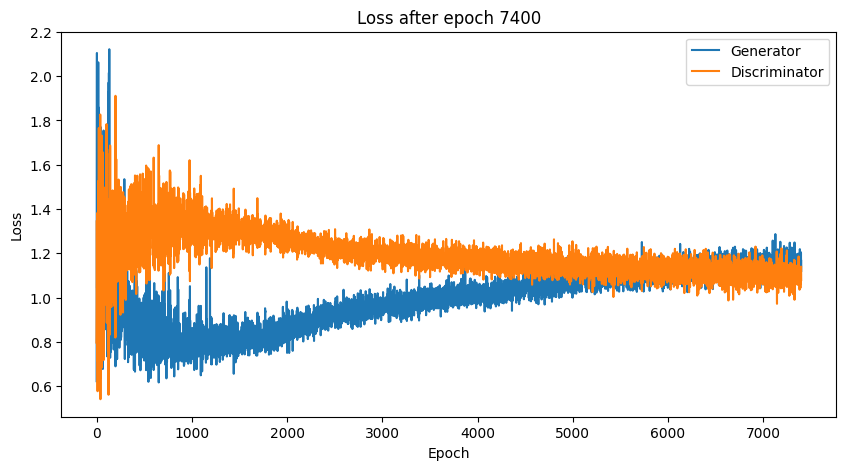

Time for epoch 7400 is 3.6421141624450684 sec
Time for epoch 7401 is 0.8655290603637695 sec
Time for epoch 7402 is 0.867084264755249 sec
Time for epoch 7403 is 0.8696062564849854 sec
Time for epoch 7404 is 0.876450777053833 sec
Time for epoch 7405 is 0.8853449821472168 sec
Time for epoch 7406 is 0.8765757083892822 sec
Time for epoch 7407 is 0.8782777786254883 sec
Time for epoch 7408 is 0.878957986831665 sec
Time for epoch 7409 is 0.8784112930297852 sec
Time for epoch 7410 is 0.8800477981567383 sec
Time for epoch 7411 is 0.886681318283081 sec
Time for epoch 7412 is 0.8841195106506348 sec
Time for epoch 7413 is 0.8871791362762451 sec
Time for epoch 7414 is 0.8773541450500488 sec
Time for epoch 7415 is 0.8870368003845215 sec
Time for epoch 7416 is 0.8837401866912842 sec
Time for epoch 7417 is 0.8857145309448242 sec
Time for epoch 7418 is 0.8865654468536377 sec
Time for epoch 7419 is 0.8906826972961426 sec
Time for epoch 7420 is 0.8949887752532959 sec
Time for epoch 7421 is 0.8807063102722

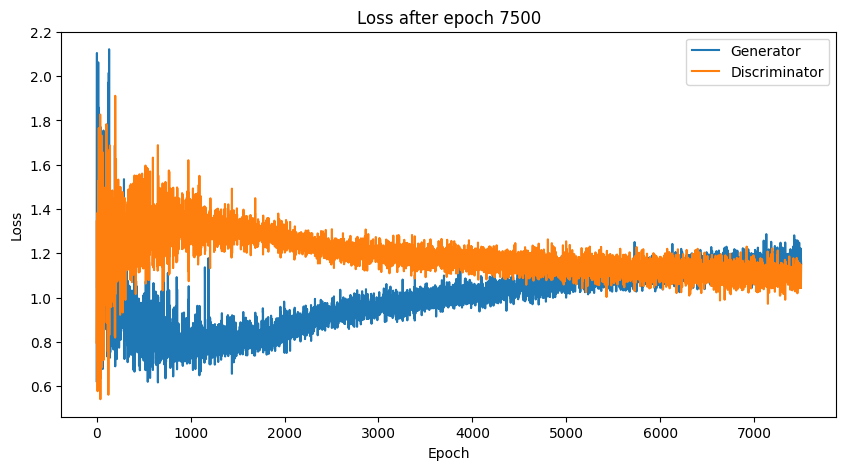

Time for epoch 7500 is 3.6892950534820557 sec
Time for epoch 7501 is 0.8561623096466064 sec
Time for epoch 7502 is 0.8710505962371826 sec
Time for epoch 7503 is 0.8677692413330078 sec
Time for epoch 7504 is 0.8768441677093506 sec
Time for epoch 7505 is 0.8731284141540527 sec
Time for epoch 7506 is 0.8765120506286621 sec
Time for epoch 7507 is 0.8761451244354248 sec
Time for epoch 7508 is 0.8745293617248535 sec
Time for epoch 7509 is 0.8805546760559082 sec
Time for epoch 7510 is 0.8779199123382568 sec
Time for epoch 7511 is 0.8810627460479736 sec
Time for epoch 7512 is 0.8806397914886475 sec
Time for epoch 7513 is 0.8809375762939453 sec
Time for epoch 7514 is 0.878864049911499 sec
Time for epoch 7515 is 0.8858010768890381 sec
Time for epoch 7516 is 0.8829734325408936 sec
Time for epoch 7517 is 0.8867762088775635 sec
Time for epoch 7518 is 0.8827438354492188 sec
Time for epoch 7519 is 0.8831567764282227 sec
Time for epoch 7520 is 0.8839311599731445 sec
Time for epoch 7521 is 0.8837349414

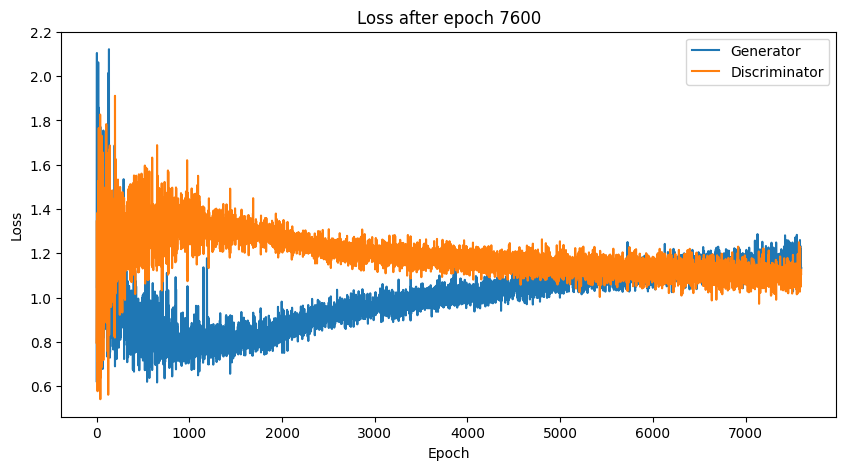

Time for epoch 7600 is 3.4907960891723633 sec
Time for epoch 7601 is 0.8536443710327148 sec
Time for epoch 7602 is 0.8681349754333496 sec
Time for epoch 7603 is 0.8667044639587402 sec
Time for epoch 7604 is 0.871373176574707 sec
Time for epoch 7605 is 0.876915454864502 sec
Time for epoch 7606 is 0.8739135265350342 sec
Time for epoch 7607 is 0.8821163177490234 sec
Time for epoch 7608 is 0.8775532245635986 sec
Time for epoch 7609 is 0.8800313472747803 sec
Time for epoch 7610 is 0.8838069438934326 sec
Time for epoch 7611 is 0.8812718391418457 sec
Time for epoch 7612 is 0.8827362060546875 sec
Time for epoch 7613 is 0.8795063495635986 sec
Time for epoch 7614 is 0.8851137161254883 sec
Time for epoch 7615 is 0.8809173107147217 sec
Time for epoch 7616 is 0.8860344886779785 sec
Time for epoch 7617 is 0.8840711116790771 sec
Time for epoch 7618 is 0.8876268863677979 sec
Time for epoch 7619 is 0.8784964084625244 sec
Time for epoch 7620 is 0.8862049579620361 sec
Time for epoch 7621 is 0.88658213615

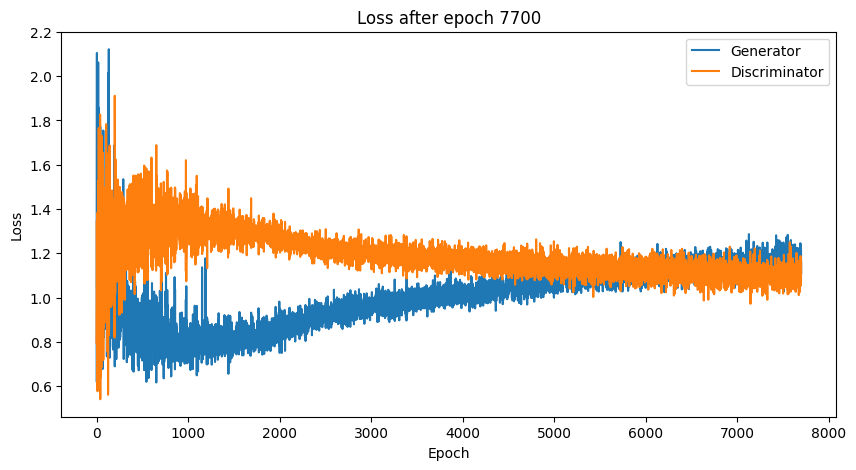

Time for epoch 7700 is 3.627964973449707 sec
Time for epoch 7701 is 0.8491566181182861 sec
Time for epoch 7702 is 0.8680801391601562 sec
Time for epoch 7703 is 0.8727869987487793 sec
Time for epoch 7704 is 0.8752717971801758 sec
Time for epoch 7705 is 0.8728218078613281 sec
Time for epoch 7706 is 0.8789017200469971 sec
Time for epoch 7707 is 0.8783020973205566 sec
Time for epoch 7708 is 0.8805856704711914 sec
Time for epoch 7709 is 0.8784809112548828 sec
Time for epoch 7710 is 0.881070613861084 sec
Time for epoch 7711 is 0.8796679973602295 sec
Time for epoch 7712 is 0.8810079097747803 sec
Time for epoch 7713 is 0.8875777721405029 sec
Time for epoch 7714 is 0.8822441101074219 sec
Time for epoch 7715 is 0.8820502758026123 sec
Time for epoch 7716 is 0.8848426342010498 sec
Time for epoch 7717 is 0.8888883590698242 sec
Time for epoch 7718 is 0.8849303722381592 sec
Time for epoch 7719 is 0.8856475353240967 sec
Time for epoch 7720 is 0.8883492946624756 sec
Time for epoch 7721 is 0.88655471801

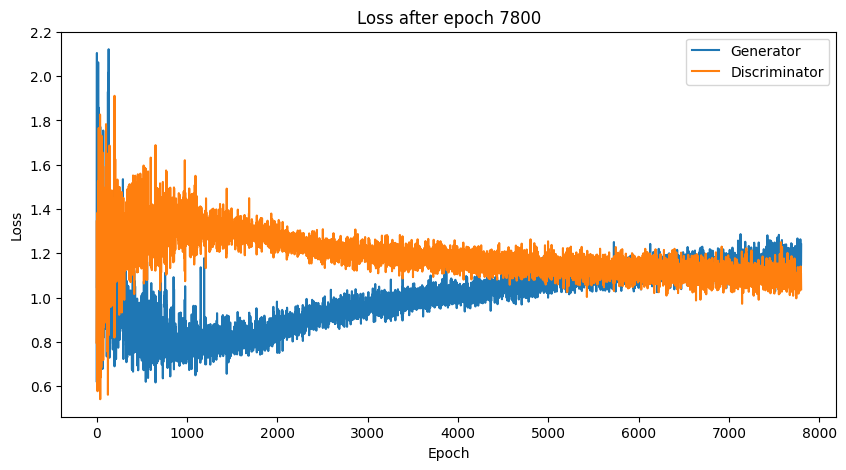

Time for epoch 7800 is 3.468432903289795 sec
Time for epoch 7801 is 0.8742761611938477 sec
Time for epoch 7802 is 0.862553596496582 sec
Time for epoch 7803 is 0.869558572769165 sec
Time for epoch 7804 is 0.8731968402862549 sec
Time for epoch 7805 is 0.8777868747711182 sec
Time for epoch 7806 is 0.8747124671936035 sec
Time for epoch 7807 is 0.8766133785247803 sec
Time for epoch 7808 is 0.8805088996887207 sec
Time for epoch 7809 is 0.8818445205688477 sec
Time for epoch 7810 is 0.8762304782867432 sec
Time for epoch 7811 is 0.883432149887085 sec
Time for epoch 7812 is 0.8837447166442871 sec
Time for epoch 7813 is 0.8805515766143799 sec
Time for epoch 7814 is 0.8857440948486328 sec
Time for epoch 7815 is 0.882601261138916 sec
Time for epoch 7816 is 0.8867647647857666 sec
Time for epoch 7817 is 0.8892426490783691 sec
Time for epoch 7818 is 0.8850462436676025 sec
Time for epoch 7819 is 0.8884036540985107 sec
Time for epoch 7820 is 0.8869657516479492 sec
Time for epoch 7821 is 0.88567471504211

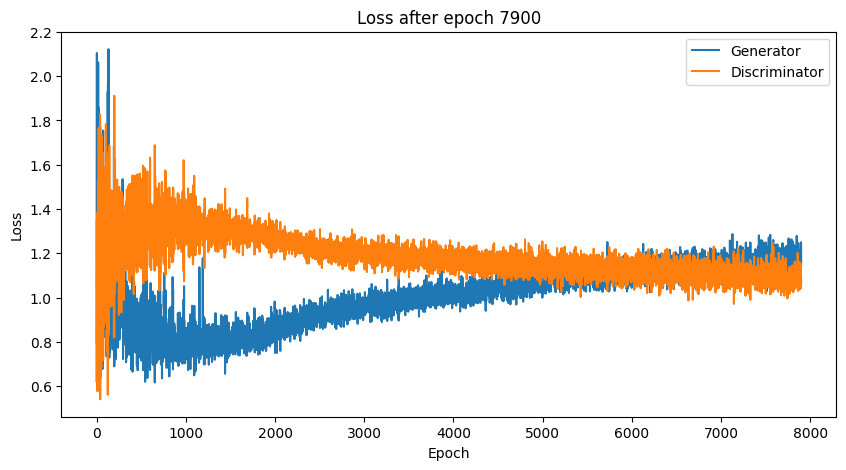

Time for epoch 7900 is 3.6722402572631836 sec
Time for epoch 7901 is 0.8626551628112793 sec
Time for epoch 7902 is 0.8672370910644531 sec
Time for epoch 7903 is 0.8704526424407959 sec
Time for epoch 7904 is 0.8686494827270508 sec
Time for epoch 7905 is 0.8791532516479492 sec
Time for epoch 7906 is 0.8761115074157715 sec
Time for epoch 7907 is 0.8740053176879883 sec
Time for epoch 7908 is 0.8769147396087646 sec
Time for epoch 7909 is 0.8812580108642578 sec
Time for epoch 7910 is 0.8815200328826904 sec
Time for epoch 7911 is 0.8805010318756104 sec
Time for epoch 7912 is 0.8800864219665527 sec
Time for epoch 7913 is 0.8804428577423096 sec
Time for epoch 7914 is 0.8844478130340576 sec
Time for epoch 7915 is 0.8835878372192383 sec
Time for epoch 7916 is 0.8858630657196045 sec
Time for epoch 7917 is 0.8822569847106934 sec
Time for epoch 7918 is 0.8845241069793701 sec
Time for epoch 7919 is 0.8821580410003662 sec
Time for epoch 7920 is 0.8849480152130127 sec
Time for epoch 7921 is 0.885786294

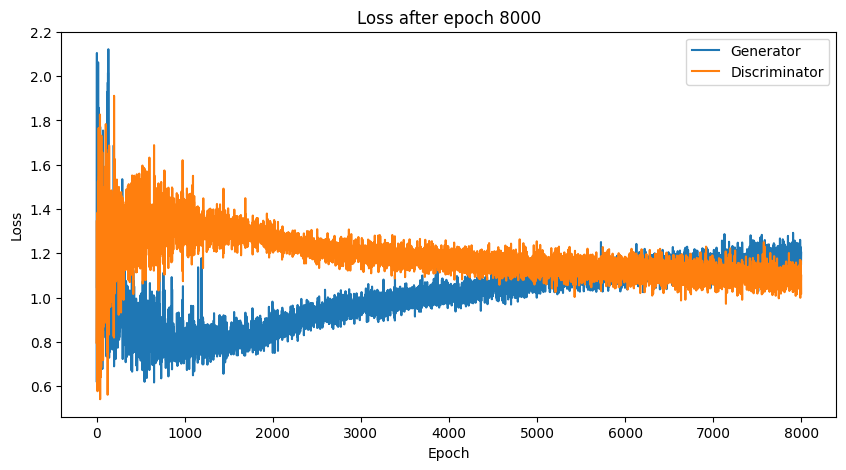

Time for epoch 8000 is 3.4783740043640137 sec
Time for epoch 8001 is 0.8507792949676514 sec
Time for epoch 8002 is 0.8707561492919922 sec
Time for epoch 8003 is 0.8686926364898682 sec
Time for epoch 8004 is 0.8744430541992188 sec
Time for epoch 8005 is 0.8798725605010986 sec
Time for epoch 8006 is 0.8801140785217285 sec
Time for epoch 8007 is 0.88423752784729 sec
Time for epoch 8008 is 0.8808724880218506 sec
Time for epoch 8009 is 0.8811450004577637 sec
Time for epoch 8010 is 0.8828206062316895 sec
Time for epoch 8011 is 0.8810701370239258 sec
Time for epoch 8012 is 0.8787667751312256 sec
Time for epoch 8013 is 0.8837530612945557 sec
Time for epoch 8014 is 0.8858575820922852 sec
Time for epoch 8015 is 0.8851380348205566 sec
Time for epoch 8016 is 0.8826675415039062 sec
Time for epoch 8017 is 0.883946418762207 sec
Time for epoch 8018 is 0.8795773983001709 sec
Time for epoch 8019 is 0.8858604431152344 sec
Time for epoch 8020 is 0.8853027820587158 sec
Time for epoch 8021 is 0.883677721023

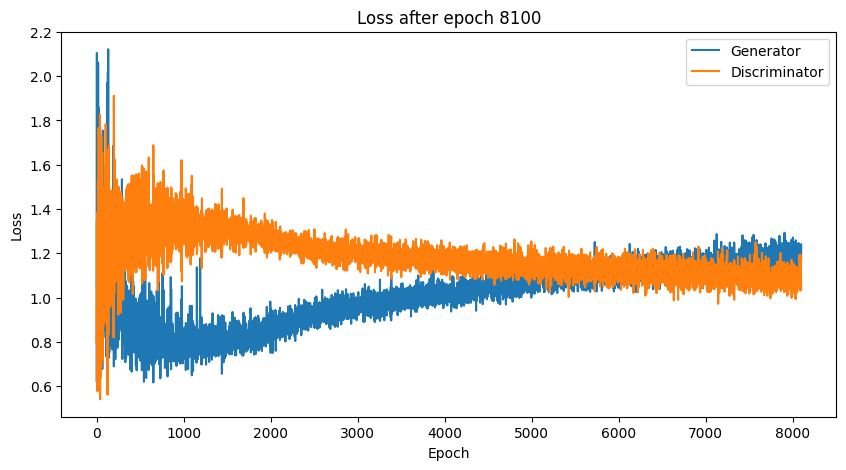

Time for epoch 8100 is 3.6768734455108643 sec
Time for epoch 8101 is 0.8607275485992432 sec
Time for epoch 8102 is 0.8670225143432617 sec
Time for epoch 8103 is 0.8664696216583252 sec
Time for epoch 8104 is 0.8725299835205078 sec
Time for epoch 8105 is 0.8730220794677734 sec
Time for epoch 8106 is 0.8812966346740723 sec
Time for epoch 8107 is 0.8782086372375488 sec
Time for epoch 8108 is 0.8761320114135742 sec
Time for epoch 8109 is 0.879483699798584 sec
Time for epoch 8110 is 0.8768479824066162 sec
Time for epoch 8111 is 0.8860776424407959 sec
Time for epoch 8112 is 0.883791446685791 sec
Time for epoch 8113 is 0.8799445629119873 sec
Time for epoch 8114 is 0.8815784454345703 sec
Time for epoch 8115 is 0.8884763717651367 sec
Time for epoch 8116 is 0.8851332664489746 sec
Time for epoch 8117 is 0.8844122886657715 sec
Time for epoch 8118 is 0.8876168727874756 sec
Time for epoch 8119 is 0.8871288299560547 sec
Time for epoch 8120 is 0.8863286972045898 sec
Time for epoch 8121 is 0.88489389419

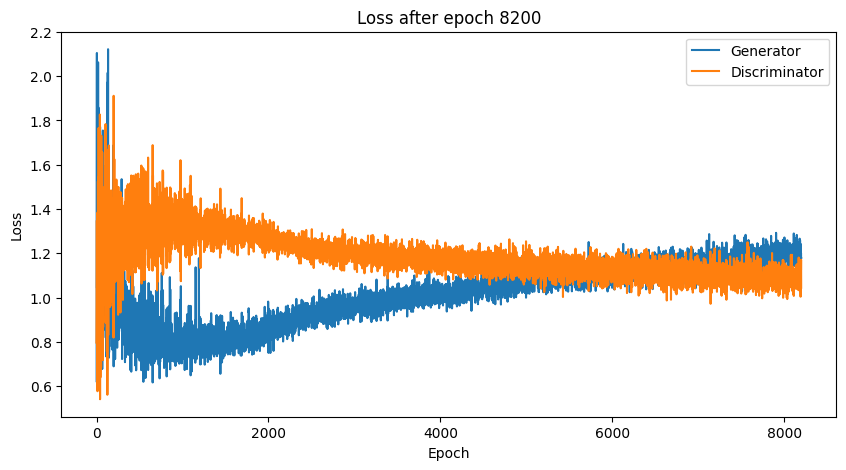

Time for epoch 8200 is 3.4755287170410156 sec
Time for epoch 8201 is 0.8557374477386475 sec
Time for epoch 8202 is 0.871469259262085 sec
Time for epoch 8203 is 0.8675003051757812 sec
Time for epoch 8204 is 0.8720455169677734 sec
Time for epoch 8205 is 0.8808929920196533 sec
Time for epoch 8206 is 0.8809499740600586 sec
Time for epoch 8207 is 0.8810205459594727 sec
Time for epoch 8208 is 0.8804976940155029 sec
Time for epoch 8209 is 0.8790998458862305 sec
Time for epoch 8210 is 0.8761329650878906 sec
Time for epoch 8211 is 0.8793447017669678 sec
Time for epoch 8212 is 0.8825774192810059 sec
Time for epoch 8213 is 0.8799540996551514 sec
Time for epoch 8214 is 0.8834149837493896 sec
Time for epoch 8215 is 0.8814635276794434 sec
Time for epoch 8216 is 0.8840065002441406 sec
Time for epoch 8217 is 0.88301682472229 sec
Time for epoch 8218 is 0.8840727806091309 sec
Time for epoch 8219 is 0.8881778717041016 sec
Time for epoch 8220 is 0.8831703662872314 sec
Time for epoch 8221 is 0.888181924819

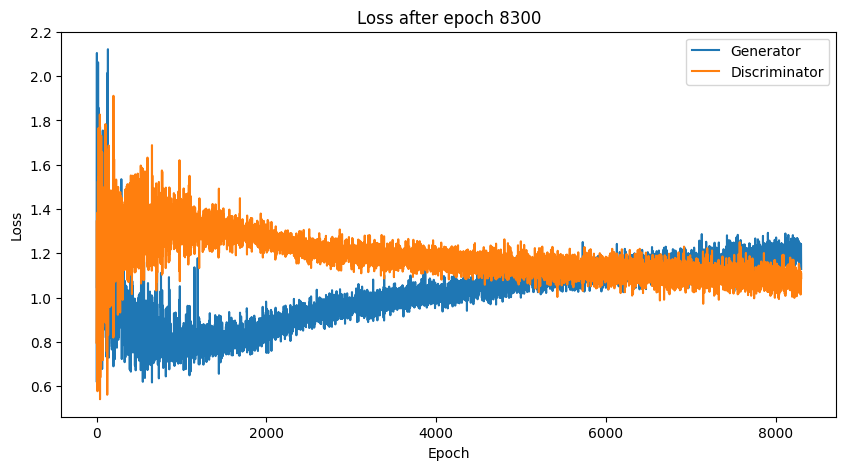

Time for epoch 8300 is 3.66310977935791 sec
Time for epoch 8301 is 0.8681595325469971 sec
Time for epoch 8302 is 0.864990234375 sec
Time for epoch 8303 is 0.8668177127838135 sec
Time for epoch 8304 is 0.8727550506591797 sec
Time for epoch 8305 is 0.8742847442626953 sec
Time for epoch 8306 is 0.8790392875671387 sec
Time for epoch 8307 is 0.8745496273040771 sec
Time for epoch 8308 is 0.8762845993041992 sec
Time for epoch 8309 is 0.8800544738769531 sec
Time for epoch 8310 is 0.8837776184082031 sec
Time for epoch 8311 is 0.8746061325073242 sec
Time for epoch 8312 is 0.8835325241088867 sec
Time for epoch 8313 is 0.8827450275421143 sec
Time for epoch 8314 is 0.8852906227111816 sec
Time for epoch 8315 is 0.8844797611236572 sec
Time for epoch 8316 is 0.8840835094451904 sec
Time for epoch 8317 is 0.8821370601654053 sec
Time for epoch 8318 is 0.880479097366333 sec
Time for epoch 8319 is 0.8854930400848389 sec
Time for epoch 8320 is 0.8862569332122803 sec
Time for epoch 8321 is 0.8872745037078857

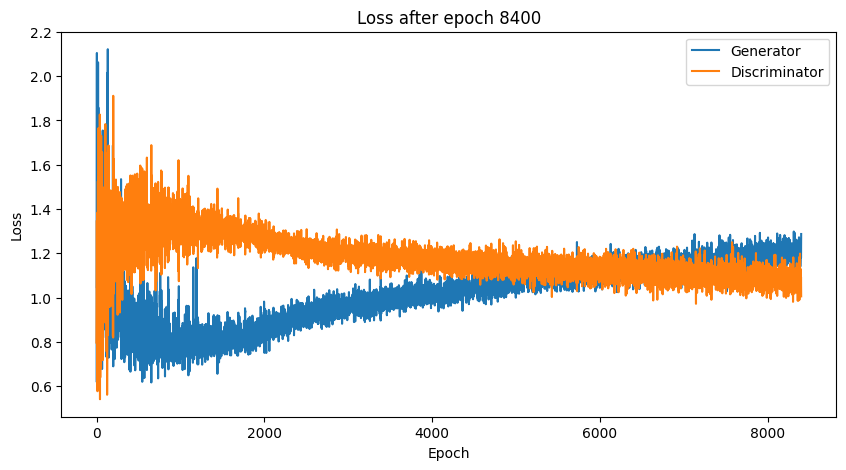

Time for epoch 8400 is 3.66878080368042 sec
Time for epoch 8401 is 0.8644006252288818 sec
Time for epoch 8402 is 0.8685352802276611 sec
Time for epoch 8403 is 0.8698971271514893 sec
Time for epoch 8404 is 0.8685948848724365 sec
Time for epoch 8405 is 0.8761134147644043 sec
Time for epoch 8406 is 0.8839354515075684 sec
Time for epoch 8407 is 0.883603572845459 sec
Time for epoch 8408 is 0.8780901432037354 sec
Time for epoch 8409 is 0.8748025894165039 sec
Time for epoch 8410 is 0.8825838565826416 sec
Time for epoch 8411 is 0.8821818828582764 sec
Time for epoch 8412 is 0.8817291259765625 sec
Time for epoch 8413 is 0.8809843063354492 sec
Time for epoch 8414 is 0.8814780712127686 sec
Time for epoch 8415 is 0.8799562454223633 sec
Time for epoch 8416 is 0.8843719959259033 sec
Time for epoch 8417 is 0.88177490234375 sec
Time for epoch 8418 is 0.8815970420837402 sec
Time for epoch 8419 is 0.8877339363098145 sec
Time for epoch 8420 is 0.8856275081634521 sec
Time for epoch 8421 is 0.88377571105957

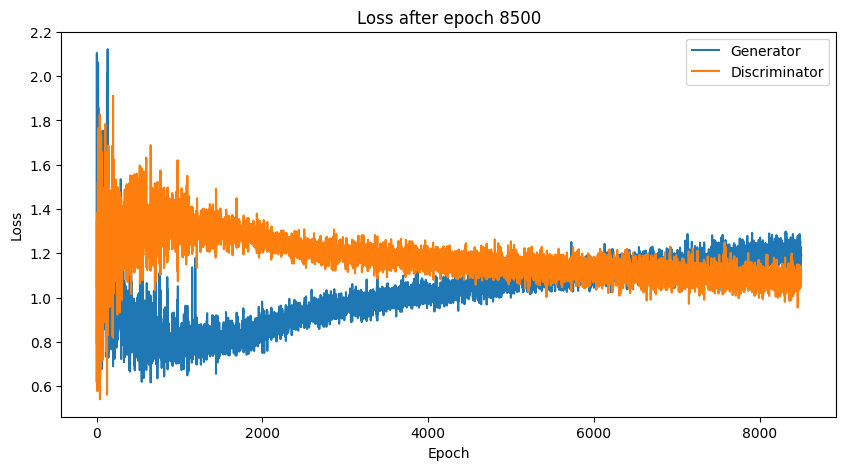

Time for epoch 8500 is 3.5480523109436035 sec
Time for epoch 8501 is 0.8670854568481445 sec
Time for epoch 8502 is 0.8638784885406494 sec
Time for epoch 8503 is 0.8721458911895752 sec
Time for epoch 8504 is 0.87367844581604 sec
Time for epoch 8505 is 0.87461256980896 sec
Time for epoch 8506 is 0.8739268779754639 sec
Time for epoch 8507 is 0.8761906623840332 sec
Time for epoch 8508 is 0.8783307075500488 sec
Time for epoch 8509 is 0.8848919868469238 sec
Time for epoch 8510 is 0.8751664161682129 sec
Time for epoch 8511 is 0.8837292194366455 sec
Time for epoch 8512 is 0.8779728412628174 sec
Time for epoch 8513 is 0.8806948661804199 sec
Time for epoch 8514 is 0.8844459056854248 sec
Time for epoch 8515 is 0.8860242366790771 sec
Time for epoch 8516 is 0.8839015960693359 sec
Time for epoch 8517 is 0.8849794864654541 sec
Time for epoch 8518 is 0.8822815418243408 sec
Time for epoch 8519 is 0.8862640857696533 sec
Time for epoch 8520 is 0.8834254741668701 sec
Time for epoch 8521 is 0.8817429542541

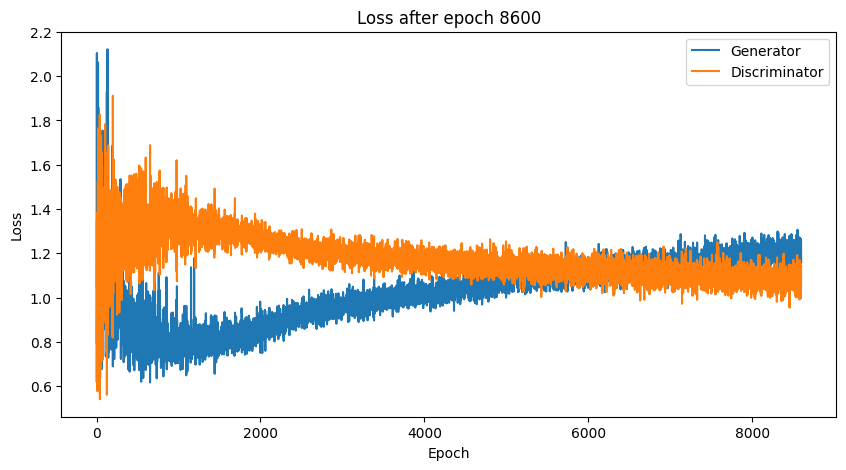

Time for epoch 8600 is 3.659118175506592 sec
Time for epoch 8601 is 0.8566968441009521 sec
Time for epoch 8602 is 0.8678631782531738 sec
Time for epoch 8603 is 0.8663027286529541 sec
Time for epoch 8604 is 0.8668200969696045 sec
Time for epoch 8605 is 0.872718334197998 sec
Time for epoch 8606 is 0.8701951503753662 sec
Time for epoch 8607 is 0.8768846988677979 sec
Time for epoch 8608 is 0.8757846355438232 sec
Time for epoch 8609 is 0.87947678565979 sec
Time for epoch 8610 is 0.8779981136322021 sec
Time for epoch 8611 is 0.876556396484375 sec
Time for epoch 8612 is 0.8770439624786377 sec
Time for epoch 8613 is 0.8842666149139404 sec
Time for epoch 8614 is 0.879887580871582 sec
Time for epoch 8615 is 0.8841695785522461 sec
Time for epoch 8616 is 0.8790276050567627 sec
Time for epoch 8617 is 0.8884217739105225 sec
Time for epoch 8618 is 0.8822402954101562 sec
Time for epoch 8619 is 0.881094217300415 sec
Time for epoch 8620 is 0.8862011432647705 sec
Time for epoch 8621 is 0.8882083892822266

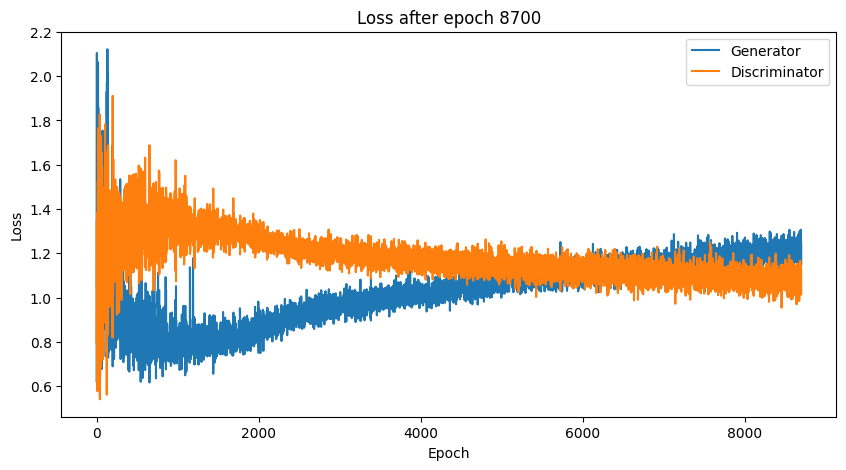

Time for epoch 8700 is 3.503232717514038 sec
Time for epoch 8701 is 0.8643927574157715 sec
Time for epoch 8702 is 0.8719072341918945 sec
Time for epoch 8703 is 0.8722515106201172 sec
Time for epoch 8704 is 0.8696022033691406 sec
Time for epoch 8705 is 0.8776345252990723 sec
Time for epoch 8706 is 0.8774471282958984 sec
Time for epoch 8707 is 0.8758964538574219 sec
Time for epoch 8708 is 0.882800817489624 sec
Time for epoch 8709 is 0.8788766860961914 sec
Time for epoch 8710 is 0.878838300704956 sec
Time for epoch 8711 is 0.8793425559997559 sec
Time for epoch 8712 is 0.8812499046325684 sec
Time for epoch 8713 is 0.8824501037597656 sec
Time for epoch 8714 is 0.882972240447998 sec
Time for epoch 8715 is 0.8805456161499023 sec
Time for epoch 8716 is 0.8840711116790771 sec
Time for epoch 8717 is 0.8826780319213867 sec
Time for epoch 8718 is 0.8813648223876953 sec
Time for epoch 8719 is 0.8872945308685303 sec
Time for epoch 8720 is 0.884981632232666 sec
Time for epoch 8721 is 0.88820648193359

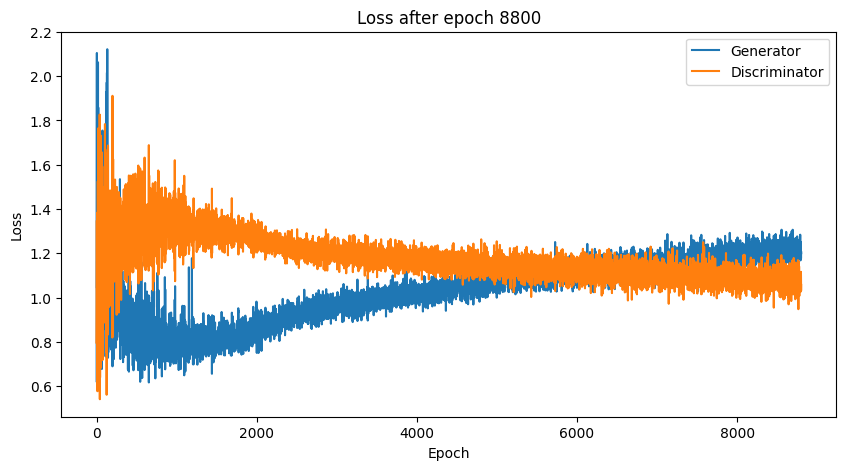

Time for epoch 8800 is 3.6551718711853027 sec
Time for epoch 8801 is 0.8661141395568848 sec
Time for epoch 8802 is 0.8609449863433838 sec
Time for epoch 8803 is 0.8775830268859863 sec
Time for epoch 8804 is 0.8698911666870117 sec
Time for epoch 8805 is 0.8760714530944824 sec
Time for epoch 8806 is 0.8726520538330078 sec
Time for epoch 8807 is 0.8755242824554443 sec
Time for epoch 8808 is 0.8787181377410889 sec
Time for epoch 8809 is 0.884192705154419 sec
Time for epoch 8810 is 0.8792624473571777 sec
Time for epoch 8811 is 0.8769369125366211 sec
Time for epoch 8812 is 0.8813071250915527 sec
Time for epoch 8813 is 0.8809888362884521 sec
Time for epoch 8814 is 0.8822422027587891 sec
Time for epoch 8815 is 0.8835968971252441 sec
Time for epoch 8816 is 0.8794558048248291 sec
Time for epoch 8817 is 0.8886449337005615 sec
Time for epoch 8818 is 0.8848423957824707 sec
Time for epoch 8819 is 0.8803019523620605 sec
Time for epoch 8820 is 0.8827509880065918 sec
Time for epoch 8821 is 0.8869345188

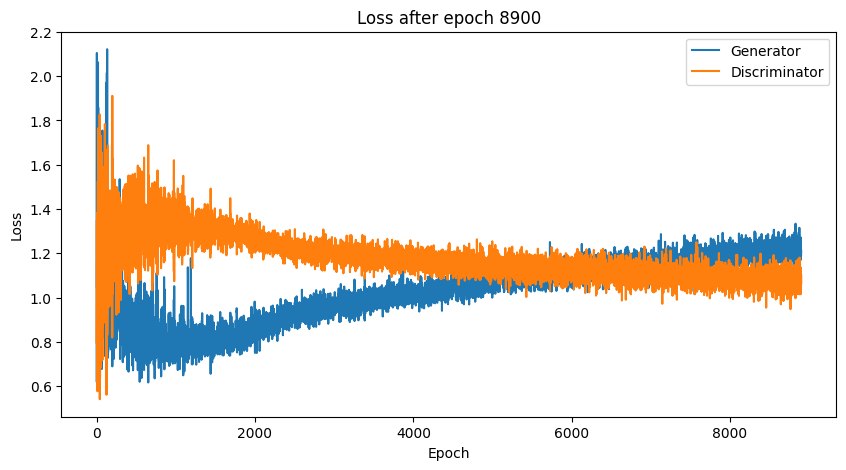

Time for epoch 8900 is 3.4816675186157227 sec
Time for epoch 8901 is 0.8642468452453613 sec
Time for epoch 8902 is 0.8657989501953125 sec
Time for epoch 8903 is 0.8722021579742432 sec
Time for epoch 8904 is 0.8751740455627441 sec
Time for epoch 8905 is 0.8784167766571045 sec
Time for epoch 8906 is 0.8798143863677979 sec
Time for epoch 8907 is 0.8789913654327393 sec
Time for epoch 8908 is 0.8762683868408203 sec
Time for epoch 8909 is 0.8807969093322754 sec
Time for epoch 8910 is 0.888892412185669 sec
Time for epoch 8911 is 0.8820178508758545 sec
Time for epoch 8912 is 0.8794405460357666 sec
Time for epoch 8913 is 0.8858077526092529 sec
Time for epoch 8914 is 0.8805720806121826 sec
Time for epoch 8915 is 0.885523796081543 sec
Time for epoch 8916 is 0.8884642124176025 sec
Time for epoch 8917 is 0.8842010498046875 sec
Time for epoch 8918 is 0.8890740871429443 sec
Time for epoch 8919 is 0.8844900131225586 sec
Time for epoch 8920 is 0.8857681751251221 sec
Time for epoch 8921 is 0.88758111000

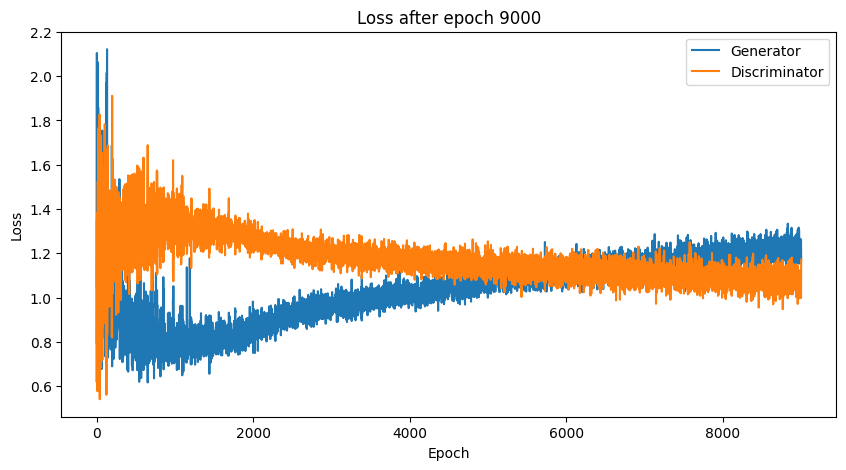

Time for epoch 9000 is 3.705608367919922 sec
Time for epoch 9001 is 0.8611915111541748 sec
Time for epoch 9002 is 0.8650312423706055 sec
Time for epoch 9003 is 0.8701045513153076 sec
Time for epoch 9004 is 0.8718242645263672 sec
Time for epoch 9005 is 0.878497838973999 sec
Time for epoch 9006 is 0.8674368858337402 sec
Time for epoch 9007 is 0.8781390190124512 sec
Time for epoch 9008 is 0.8794815540313721 sec
Time for epoch 9009 is 0.8783478736877441 sec
Time for epoch 9010 is 0.8817095756530762 sec
Time for epoch 9011 is 0.8826301097869873 sec
Time for epoch 9012 is 0.878730297088623 sec
Time for epoch 9013 is 0.8835580348968506 sec
Time for epoch 9014 is 0.8806557655334473 sec
Time for epoch 9015 is 0.8877623081207275 sec
Time for epoch 9016 is 0.8853063583374023 sec
Time for epoch 9017 is 0.8819587230682373 sec
Time for epoch 9018 is 0.8831465244293213 sec
Time for epoch 9019 is 0.8889532089233398 sec
Time for epoch 9020 is 0.885009765625 sec
Time for epoch 9021 is 0.8845138549804688

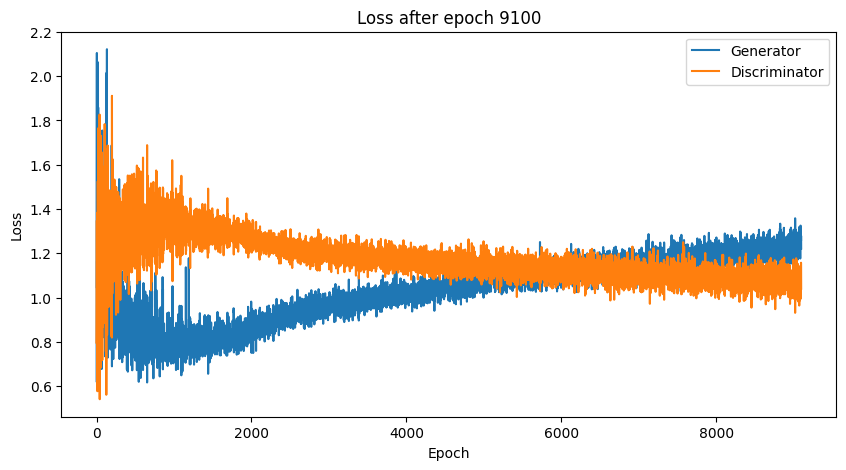

Time for epoch 9100 is 3.7706384658813477 sec
Time for epoch 9101 is 0.8540267944335938 sec
Time for epoch 9102 is 0.8684029579162598 sec
Time for epoch 9103 is 0.8668086528778076 sec
Time for epoch 9104 is 0.8731369972229004 sec
Time for epoch 9105 is 0.870037317276001 sec
Time for epoch 9106 is 0.8717763423919678 sec
Time for epoch 9107 is 0.8763062953948975 sec
Time for epoch 9108 is 0.8766558170318604 sec
Time for epoch 9109 is 0.8792436122894287 sec
Time for epoch 9110 is 0.8821861743927002 sec
Time for epoch 9111 is 0.8832108974456787 sec
Time for epoch 9112 is 0.8802778720855713 sec
Time for epoch 9113 is 0.8790996074676514 sec
Time for epoch 9114 is 0.8843488693237305 sec
Time for epoch 9115 is 0.8850224018096924 sec
Time for epoch 9116 is 0.8837580680847168 sec
Time for epoch 9117 is 0.8813652992248535 sec
Time for epoch 9118 is 0.8850362300872803 sec
Time for epoch 9119 is 0.8829071521759033 sec
Time for epoch 9120 is 0.8855612277984619 sec
Time for epoch 9121 is 0.8851380348

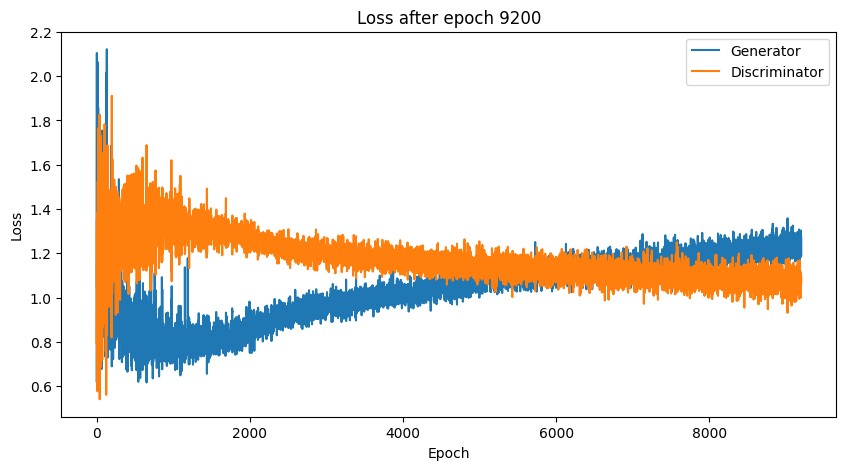

Time for epoch 9200 is 3.567577838897705 sec
Time for epoch 9201 is 0.8642776012420654 sec
Time for epoch 9202 is 0.8656437397003174 sec
Time for epoch 9203 is 0.8694615364074707 sec
Time for epoch 9204 is 0.8698868751525879 sec
Time for epoch 9205 is 0.8809854984283447 sec
Time for epoch 9206 is 0.8756380081176758 sec
Time for epoch 9207 is 0.8746795654296875 sec
Time for epoch 9208 is 0.8794794082641602 sec
Time for epoch 9209 is 0.8800392150878906 sec
Time for epoch 9210 is 0.8820855617523193 sec
Time for epoch 9211 is 0.8798871040344238 sec
Time for epoch 9212 is 0.8816406726837158 sec
Time for epoch 9213 is 0.8866326808929443 sec
Time for epoch 9214 is 0.8858423233032227 sec
Time for epoch 9215 is 0.8843064308166504 sec
Time for epoch 9216 is 0.8831193447113037 sec
Time for epoch 9217 is 0.8854427337646484 sec
Time for epoch 9218 is 0.8834707736968994 sec
Time for epoch 9219 is 0.8830714225769043 sec
Time for epoch 9220 is 0.8866579532623291 sec
Time for epoch 9221 is 0.8858733177

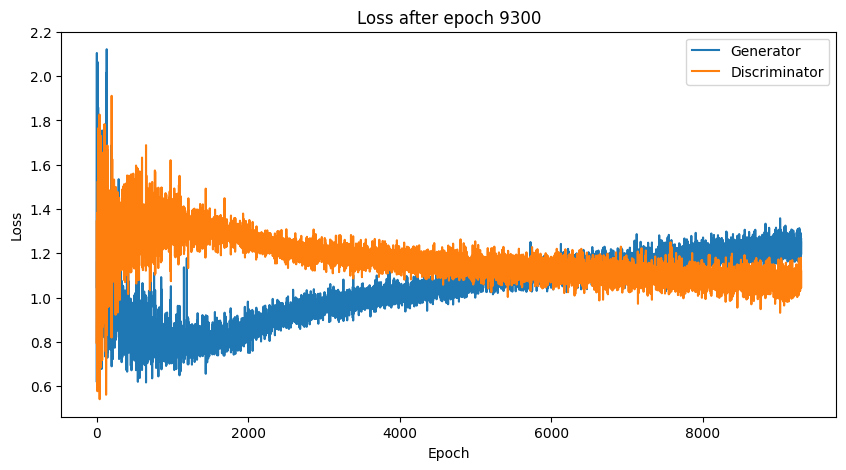

Time for epoch 9300 is 3.6915183067321777 sec
Time for epoch 9301 is 0.8603084087371826 sec
Time for epoch 9302 is 0.8715615272521973 sec
Time for epoch 9303 is 0.8692407608032227 sec
Time for epoch 9304 is 0.8759477138519287 sec
Time for epoch 9305 is 0.8742947578430176 sec
Time for epoch 9306 is 0.8766920566558838 sec
Time for epoch 9307 is 0.8769090175628662 sec
Time for epoch 9308 is 0.8885068893432617 sec
Time for epoch 9309 is 0.8787431716918945 sec
Time for epoch 9310 is 0.8799769878387451 sec
Time for epoch 9311 is 0.882042646408081 sec
Time for epoch 9312 is 0.878624439239502 sec
Time for epoch 9313 is 0.8809545040130615 sec
Time for epoch 9314 is 0.8809762001037598 sec
Time for epoch 9315 is 0.8887979984283447 sec
Time for epoch 9316 is 0.8806989192962646 sec
Time for epoch 9317 is 0.8880250453948975 sec
Time for epoch 9318 is 0.8814036846160889 sec
Time for epoch 9319 is 0.887500524520874 sec
Time for epoch 9320 is 0.8879797458648682 sec
Time for epoch 9321 is 0.886467456817

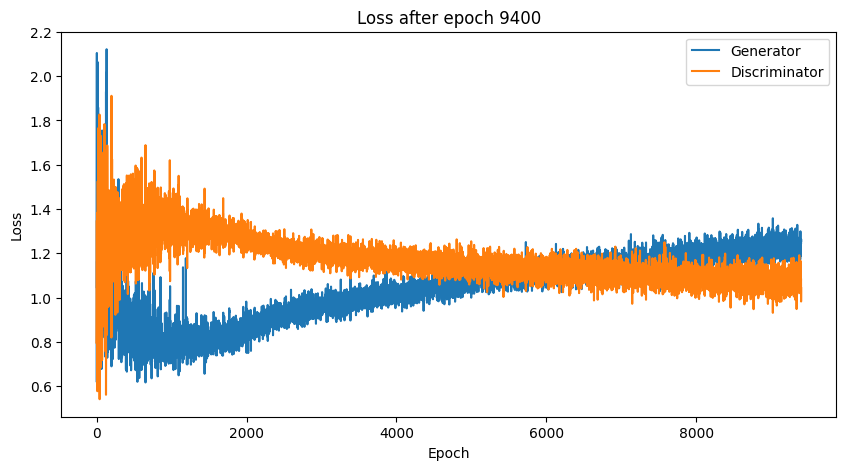

Time for epoch 9400 is 3.7067699432373047 sec
Time for epoch 9401 is 0.8722178936004639 sec
Time for epoch 9402 is 0.8621821403503418 sec
Time for epoch 9403 is 0.8651742935180664 sec
Time for epoch 9404 is 0.8722786903381348 sec
Time for epoch 9405 is 0.8737928867340088 sec
Time for epoch 9406 is 0.8750407695770264 sec
Time for epoch 9407 is 0.8720095157623291 sec
Time for epoch 9408 is 0.8773412704467773 sec
Time for epoch 9409 is 0.8803191184997559 sec
Time for epoch 9410 is 0.8783016204833984 sec
Time for epoch 9411 is 0.8781375885009766 sec
Time for epoch 9412 is 0.8808999061584473 sec
Time for epoch 9413 is 0.8819386959075928 sec
Time for epoch 9414 is 0.8833303451538086 sec
Time for epoch 9415 is 0.8788228034973145 sec
Time for epoch 9416 is 0.8783731460571289 sec
Time for epoch 9417 is 0.8848989009857178 sec
Time for epoch 9418 is 0.8823764324188232 sec
Time for epoch 9419 is 0.8855326175689697 sec
Time for epoch 9420 is 0.8864727020263672 sec
Time for epoch 9421 is 0.882247924

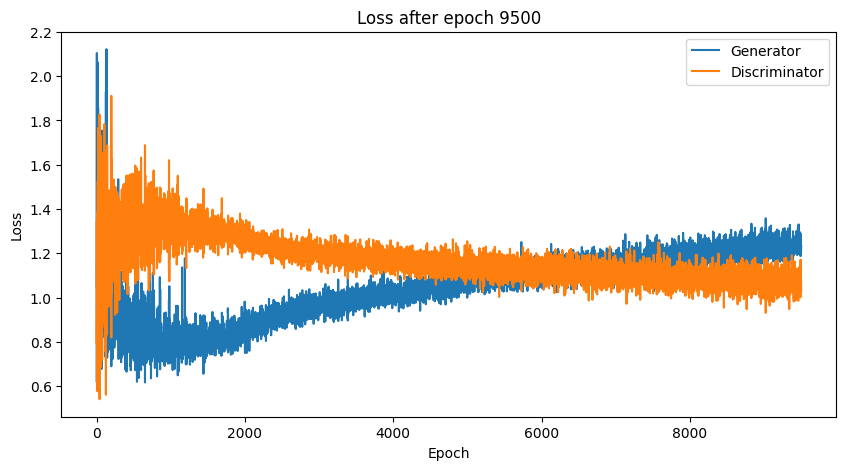

Time for epoch 9500 is 3.474397897720337 sec
Time for epoch 9501 is 0.865147590637207 sec
Time for epoch 9502 is 0.8687798976898193 sec
Time for epoch 9503 is 0.8745918273925781 sec
Time for epoch 9504 is 0.8815350532531738 sec
Time for epoch 9505 is 0.8765170574188232 sec
Time for epoch 9506 is 0.8763546943664551 sec
Time for epoch 9507 is 0.87801194190979 sec
Time for epoch 9508 is 0.8826048374176025 sec
Time for epoch 9509 is 0.8805601596832275 sec
Time for epoch 9510 is 0.8807790279388428 sec
Time for epoch 9511 is 0.880598783493042 sec
Time for epoch 9512 is 0.8803930282592773 sec
Time for epoch 9513 is 0.8798108100891113 sec
Time for epoch 9514 is 0.8845179080963135 sec
Time for epoch 9515 is 0.881605863571167 sec
Time for epoch 9516 is 0.885826826095581 sec
Time for epoch 9517 is 0.8806579113006592 sec
Time for epoch 9518 is 0.8880796432495117 sec
Time for epoch 9519 is 0.8861043453216553 sec
Time for epoch 9520 is 0.8828728199005127 sec
Time for epoch 9521 is 0.8943350315093994

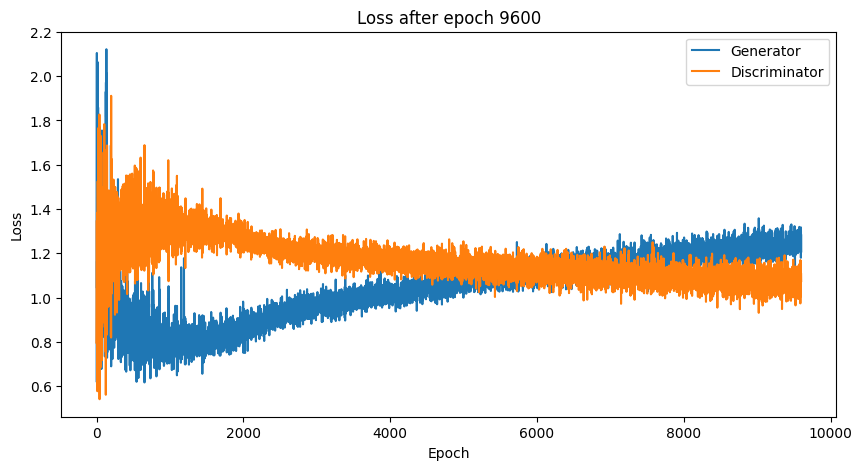

Time for epoch 9600 is 3.7237112522125244 sec
Time for epoch 9601 is 0.8473358154296875 sec
Time for epoch 9602 is 0.8657891750335693 sec
Time for epoch 9603 is 0.8709714412689209 sec
Time for epoch 9604 is 0.8723959922790527 sec
Time for epoch 9605 is 0.8787908554077148 sec
Time for epoch 9606 is 0.8721499443054199 sec
Time for epoch 9607 is 0.8739211559295654 sec
Time for epoch 9608 is 0.8766214847564697 sec
Time for epoch 9609 is 0.880286455154419 sec
Time for epoch 9610 is 0.8792049884796143 sec
Time for epoch 9611 is 0.8832085132598877 sec
Time for epoch 9612 is 0.8797731399536133 sec
Time for epoch 9613 is 0.878981351852417 sec
Time for epoch 9614 is 0.8791356086730957 sec
Time for epoch 9615 is 0.8854641914367676 sec
Time for epoch 9616 is 0.8845791816711426 sec
Time for epoch 9617 is 0.8827438354492188 sec
Time for epoch 9618 is 0.8841695785522461 sec
Time for epoch 9619 is 0.8833422660827637 sec
Time for epoch 9620 is 0.8872075080871582 sec
Time for epoch 9621 is 0.88993644714

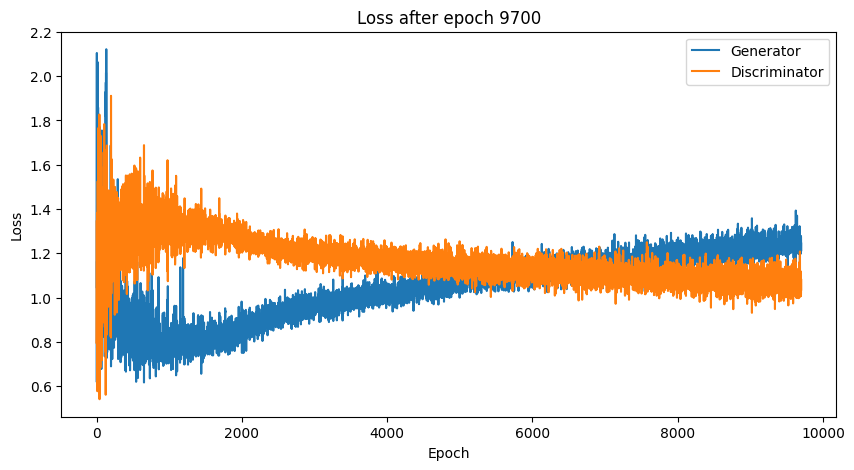

Time for epoch 9700 is 3.4945218563079834 sec
Time for epoch 9701 is 0.8580689430236816 sec
Time for epoch 9702 is 0.8631792068481445 sec
Time for epoch 9703 is 0.871539831161499 sec
Time for epoch 9704 is 0.8695664405822754 sec
Time for epoch 9705 is 0.8764605522155762 sec
Time for epoch 9706 is 0.8746137619018555 sec
Time for epoch 9707 is 0.8835325241088867 sec
Time for epoch 9708 is 0.8735458850860596 sec
Time for epoch 9709 is 0.8840038776397705 sec
Time for epoch 9710 is 0.8827767372131348 sec
Time for epoch 9711 is 0.8785057067871094 sec
Time for epoch 9712 is 0.8812079429626465 sec
Time for epoch 9713 is 0.8811867237091064 sec
Time for epoch 9714 is 0.8861348628997803 sec
Time for epoch 9715 is 0.8838889598846436 sec
Time for epoch 9716 is 0.8842911720275879 sec
Time for epoch 9717 is 0.8830158710479736 sec
Time for epoch 9718 is 0.8827335834503174 sec
Time for epoch 9719 is 0.8828396797180176 sec
Time for epoch 9720 is 0.8850407600402832 sec
Time for epoch 9721 is 0.8872327804

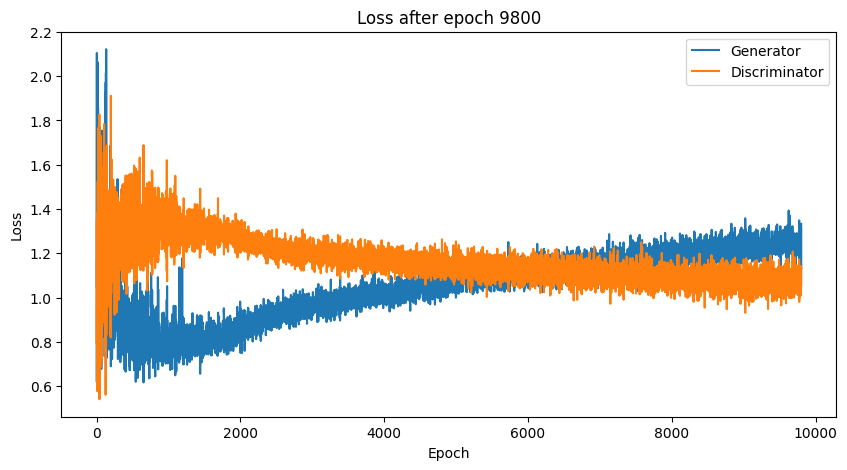

Time for epoch 9800 is 3.6591649055480957 sec
Time for epoch 9801 is 0.8582932949066162 sec
Time for epoch 9802 is 0.8603384494781494 sec
Time for epoch 9803 is 0.8683171272277832 sec
Time for epoch 9804 is 0.8736271858215332 sec
Time for epoch 9805 is 0.8748211860656738 sec
Time for epoch 9806 is 0.8762378692626953 sec
Time for epoch 9807 is 0.8751778602600098 sec
Time for epoch 9808 is 0.8749110698699951 sec
Time for epoch 9809 is 0.8765637874603271 sec
Time for epoch 9810 is 0.8790102005004883 sec
Time for epoch 9811 is 0.8772425651550293 sec
Time for epoch 9812 is 0.886359453201294 sec
Time for epoch 9813 is 0.8834693431854248 sec
Time for epoch 9814 is 0.8755724430084229 sec
Time for epoch 9815 is 0.8806428909301758 sec
Time for epoch 9816 is 0.8843255043029785 sec
Time for epoch 9817 is 0.8834292888641357 sec
Time for epoch 9818 is 0.8839859962463379 sec
Time for epoch 9819 is 0.8816440105438232 sec
Time for epoch 9820 is 0.885474681854248 sec
Time for epoch 9821 is 0.88448047637

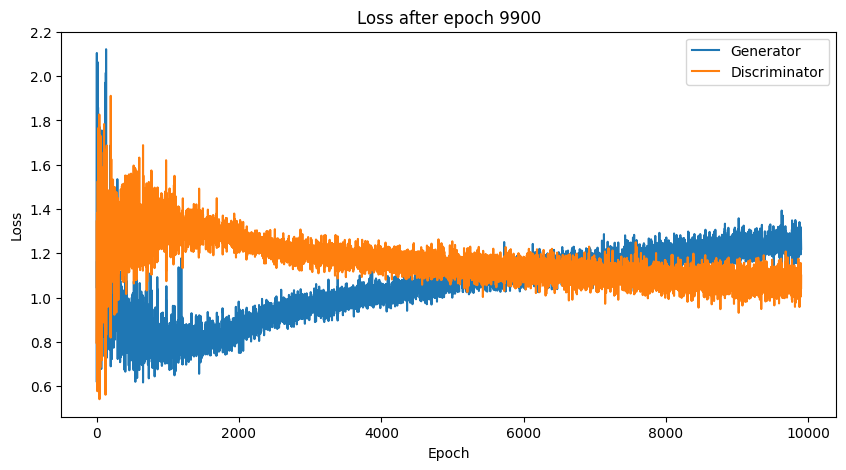

Time for epoch 9900 is 3.7221832275390625 sec
Time for epoch 9901 is 0.8662934303283691 sec
Time for epoch 9902 is 0.8646872043609619 sec
Time for epoch 9903 is 0.8657736778259277 sec
Time for epoch 9904 is 0.8706774711608887 sec
Time for epoch 9905 is 0.8775897026062012 sec
Time for epoch 9906 is 0.8709044456481934 sec
Time for epoch 9907 is 0.8814969062805176 sec
Time for epoch 9908 is 0.8761696815490723 sec
Time for epoch 9909 is 0.8753213882446289 sec
Time for epoch 9910 is 0.8765861988067627 sec
Time for epoch 9911 is 0.8827259540557861 sec
Time for epoch 9912 is 0.8813991546630859 sec
Time for epoch 9913 is 0.8813562393188477 sec
Time for epoch 9914 is 0.8806211948394775 sec
Time for epoch 9915 is 0.8800766468048096 sec
Time for epoch 9916 is 0.8865761756896973 sec
Time for epoch 9917 is 0.8784942626953125 sec
Time for epoch 9918 is 0.8841662406921387 sec
Time for epoch 9919 is 0.8836493492126465 sec
Time for epoch 9920 is 0.883575439453125 sec
Time for epoch 9921 is 0.8824844360

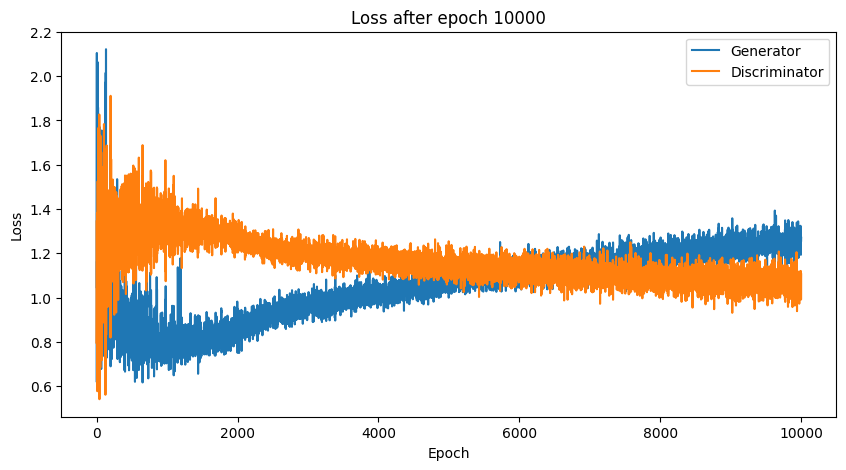

Time for epoch 10000 is 3.518784761428833 sec
Time for epoch 10001 is 0.8651976585388184 sec
Time for epoch 10002 is 0.8663487434387207 sec
Time for epoch 10003 is 0.8681411743164062 sec
Time for epoch 10004 is 0.8745982646942139 sec
Time for epoch 10005 is 0.8738970756530762 sec
Time for epoch 10006 is 0.8738188743591309 sec
Time for epoch 10007 is 0.8830051422119141 sec
Time for epoch 10008 is 0.8828728199005127 sec
Time for epoch 10009 is 0.8799376487731934 sec
Time for epoch 10010 is 0.8791766166687012 sec
Time for epoch 10011 is 0.8811099529266357 sec
Time for epoch 10012 is 0.8797845840454102 sec
Time for epoch 10013 is 0.880732536315918 sec
Time for epoch 10014 is 0.8848984241485596 sec
Time for epoch 10015 is 0.885324239730835 sec
Time for epoch 10016 is 0.8864388465881348 sec
Time for epoch 10017 is 0.8839678764343262 sec
Time for epoch 10018 is 0.8817095756530762 sec
Time for epoch 10019 is 0.8858528137207031 sec
Time for epoch 10020 is 0.8822546005249023 sec
Time for epoch 1

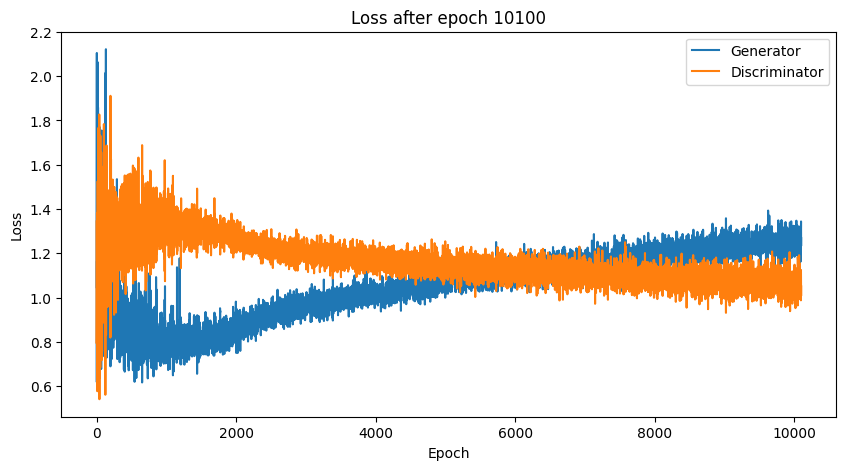

Time for epoch 10100 is 3.660569667816162 sec
Time for epoch 10101 is 0.8589663505554199 sec
Time for epoch 10102 is 0.8637371063232422 sec
Time for epoch 10103 is 0.8719782829284668 sec
Time for epoch 10104 is 0.87290358543396 sec
Time for epoch 10105 is 0.8771119117736816 sec
Time for epoch 10106 is 0.8721914291381836 sec
Time for epoch 10107 is 0.8772985935211182 sec
Time for epoch 10108 is 0.8785626888275146 sec
Time for epoch 10109 is 0.8798420429229736 sec
Time for epoch 10110 is 0.8835301399230957 sec
Time for epoch 10111 is 0.8775954246520996 sec
Time for epoch 10112 is 0.879432201385498 sec
Time for epoch 10113 is 0.8813624382019043 sec
Time for epoch 10114 is 0.8817112445831299 sec
Time for epoch 10115 is 0.88149094581604 sec
Time for epoch 10116 is 0.8841831684112549 sec
Time for epoch 10117 is 0.8864543437957764 sec
Time for epoch 10118 is 0.8788673877716064 sec
Time for epoch 10119 is 0.8888769149780273 sec
Time for epoch 10120 is 0.8876750469207764 sec
Time for epoch 1012

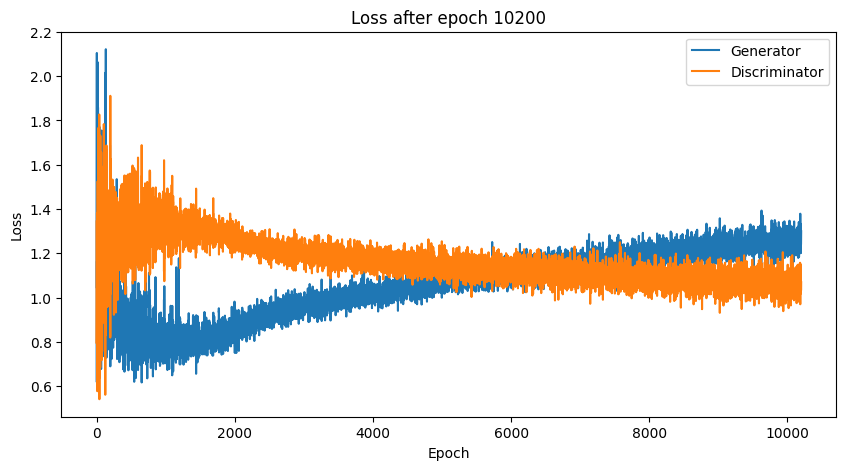

Time for epoch 10200 is 3.744396448135376 sec
Time for epoch 10201 is 0.8688199520111084 sec
Time for epoch 10202 is 0.8683433532714844 sec
Time for epoch 10203 is 0.8663899898529053 sec
Time for epoch 10204 is 0.8682646751403809 sec
Time for epoch 10205 is 0.8744916915893555 sec
Time for epoch 10206 is 0.8760890960693359 sec
Time for epoch 10207 is 0.8744003772735596 sec
Time for epoch 10208 is 0.879319429397583 sec
Time for epoch 10209 is 0.8763549327850342 sec
Time for epoch 10210 is 0.8764410018920898 sec
Time for epoch 10211 is 0.879643440246582 sec
Time for epoch 10212 is 0.8820207118988037 sec
Time for epoch 10213 is 0.8773524761199951 sec
Time for epoch 10214 is 0.8855776786804199 sec
Time for epoch 10215 is 0.880885124206543 sec
Time for epoch 10216 is 0.8856394290924072 sec
Time for epoch 10217 is 0.8806900978088379 sec
Time for epoch 10218 is 0.8816165924072266 sec
Time for epoch 10219 is 0.8829822540283203 sec
Time for epoch 10220 is 0.8846254348754883 sec
Time for epoch 10

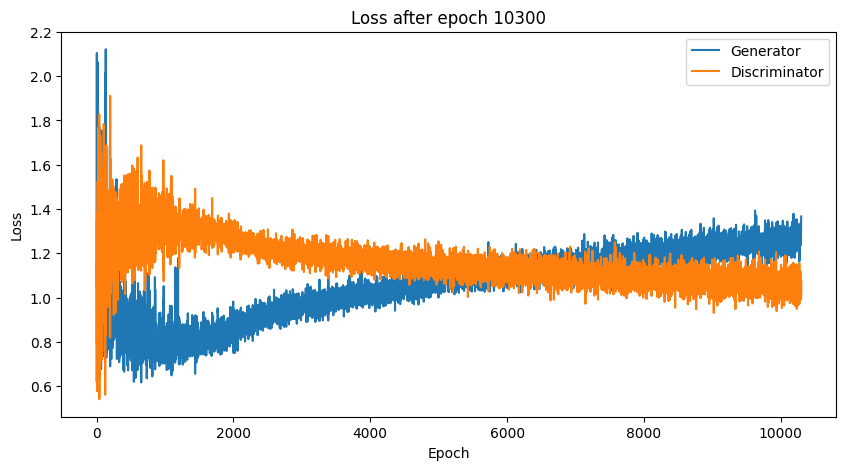

Time for epoch 10300 is 3.5015921592712402 sec
Time for epoch 10301 is 0.8685953617095947 sec
Time for epoch 10302 is 0.8650000095367432 sec
Time for epoch 10303 is 0.8756473064422607 sec
Time for epoch 10304 is 0.867163896560669 sec
Time for epoch 10305 is 0.875016450881958 sec
Time for epoch 10306 is 0.8761720657348633 sec
Time for epoch 10307 is 0.8754630088806152 sec
Time for epoch 10308 is 0.8785054683685303 sec
Time for epoch 10309 is 0.8795959949493408 sec
Time for epoch 10310 is 0.8770918846130371 sec
Time for epoch 10311 is 0.8827731609344482 sec
Time for epoch 10312 is 0.8793990612030029 sec
Time for epoch 10313 is 0.8830454349517822 sec
Time for epoch 10314 is 0.8791487216949463 sec
Time for epoch 10315 is 0.8841972351074219 sec
Time for epoch 10316 is 0.884533166885376 sec
Time for epoch 10317 is 0.879173755645752 sec
Time for epoch 10318 is 0.886479377746582 sec
Time for epoch 10319 is 0.8896842002868652 sec
Time for epoch 10320 is 0.8913559913635254 sec
Time for epoch 103

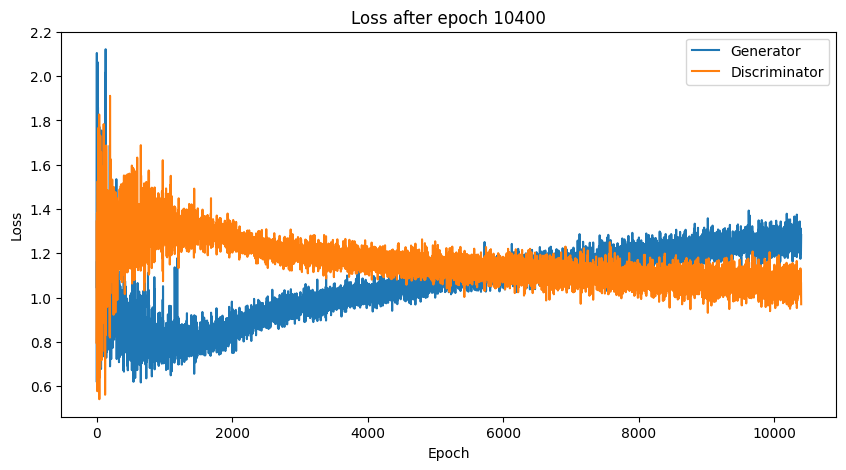

Time for epoch 10400 is 3.7430076599121094 sec
Time for epoch 10401 is 0.8526797294616699 sec
Time for epoch 10402 is 0.8666126728057861 sec
Time for epoch 10403 is 0.8717997074127197 sec
Time for epoch 10404 is 0.8689231872558594 sec
Time for epoch 10405 is 0.8750972747802734 sec
Time for epoch 10406 is 0.8774442672729492 sec
Time for epoch 10407 is 0.8785543441772461 sec
Time for epoch 10408 is 0.880403995513916 sec
Time for epoch 10409 is 0.8752517700195312 sec
Time for epoch 10410 is 0.8810935020446777 sec
Time for epoch 10411 is 0.8842005729675293 sec
Time for epoch 10412 is 0.8766689300537109 sec
Time for epoch 10413 is 0.8807768821716309 sec
Time for epoch 10414 is 0.8806614875793457 sec
Time for epoch 10415 is 0.8824806213378906 sec
Time for epoch 10416 is 0.8839590549468994 sec
Time for epoch 10417 is 0.887237548828125 sec
Time for epoch 10418 is 0.8814828395843506 sec
Time for epoch 10419 is 0.8858733177185059 sec
Time for epoch 10420 is 0.8811800479888916 sec
Time for epoch 

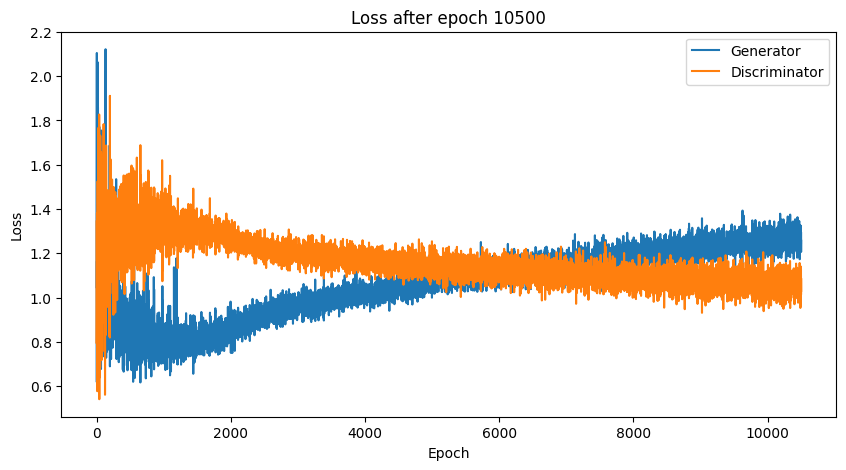

Time for epoch 10500 is 3.6953139305114746 sec
Time for epoch 10501 is 0.8560464382171631 sec
Time for epoch 10502 is 0.8633983135223389 sec
Time for epoch 10503 is 0.8787188529968262 sec
Time for epoch 10504 is 0.8780632019042969 sec
Time for epoch 10505 is 0.8709971904754639 sec
Time for epoch 10506 is 0.8760571479797363 sec
Time for epoch 10507 is 0.8804347515106201 sec
Time for epoch 10508 is 0.8747165203094482 sec
Time for epoch 10509 is 0.8866019248962402 sec
Time for epoch 10510 is 0.8809802532196045 sec
Time for epoch 10511 is 0.8827588558197021 sec
Time for epoch 10512 is 0.8795762062072754 sec
Time for epoch 10513 is 0.8796899318695068 sec
Time for epoch 10514 is 0.8790388107299805 sec
Time for epoch 10515 is 0.879270076751709 sec
Time for epoch 10516 is 0.8837826251983643 sec
Time for epoch 10517 is 0.885223388671875 sec
Time for epoch 10518 is 0.8800315856933594 sec
Time for epoch 10519 is 0.8843207359313965 sec
Time for epoch 10520 is 0.8860185146331787 sec
Time for epoch 

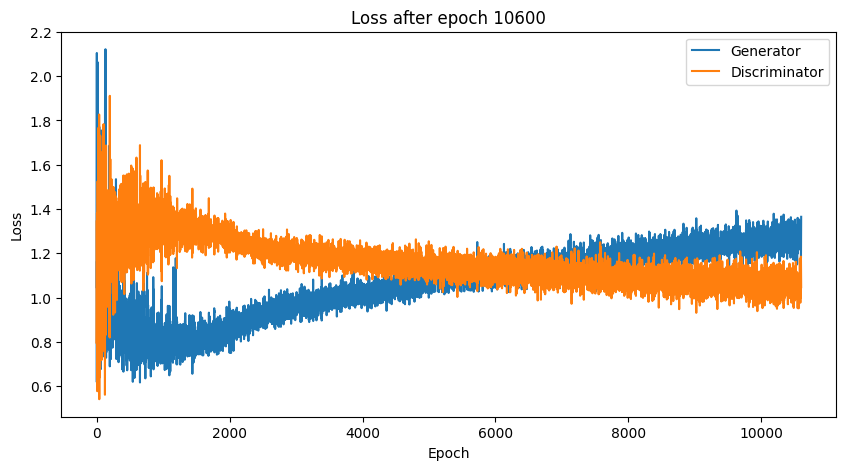

Time for epoch 10600 is 3.5385732650756836 sec
Time for epoch 10601 is 0.8686008453369141 sec
Time for epoch 10602 is 0.8684587478637695 sec
Time for epoch 10603 is 0.873100757598877 sec
Time for epoch 10604 is 0.8693456649780273 sec
Time for epoch 10605 is 0.8778748512268066 sec
Time for epoch 10606 is 0.8757641315460205 sec
Time for epoch 10607 is 0.8771061897277832 sec
Time for epoch 10608 is 0.8808283805847168 sec
Time for epoch 10609 is 0.875070333480835 sec
Time for epoch 10610 is 0.8831491470336914 sec
Time for epoch 10611 is 0.879603385925293 sec
Time for epoch 10612 is 0.8801066875457764 sec
Time for epoch 10613 is 0.887725830078125 sec
Time for epoch 10614 is 0.8812718391418457 sec
Time for epoch 10615 is 0.8814952373504639 sec
Time for epoch 10616 is 0.8951098918914795 sec
Time for epoch 10617 is 0.879417896270752 sec
Time for epoch 10618 is 0.8848912715911865 sec
Time for epoch 10619 is 0.8841981887817383 sec
Time for epoch 10620 is 0.8851561546325684 sec
Time for epoch 106

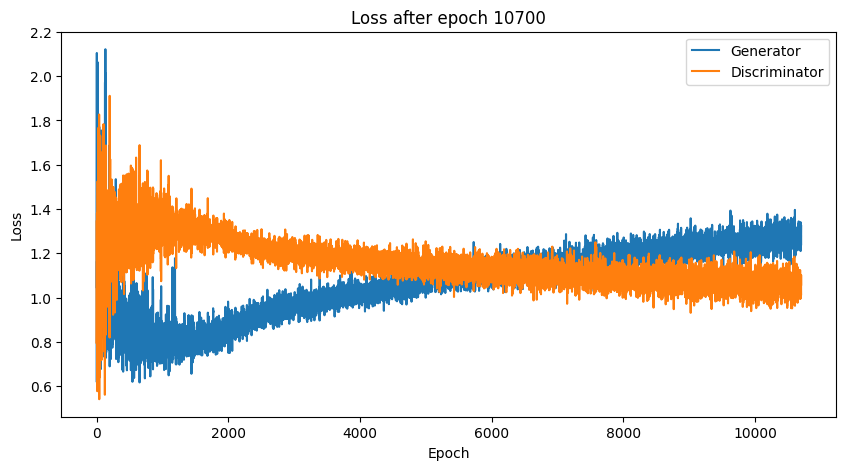

Time for epoch 10700 is 3.7293355464935303 sec
Time for epoch 10701 is 0.8520514965057373 sec
Time for epoch 10702 is 0.8670508861541748 sec
Time for epoch 10703 is 0.8672471046447754 sec
Time for epoch 10704 is 0.8702919483184814 sec
Time for epoch 10705 is 0.8753151893615723 sec
Time for epoch 10706 is 0.8715689182281494 sec
Time for epoch 10707 is 0.8790543079376221 sec
Time for epoch 10708 is 0.8765265941619873 sec
Time for epoch 10709 is 0.8741304874420166 sec
Time for epoch 10710 is 0.8811075687408447 sec
Time for epoch 10711 is 0.8792626857757568 sec
Time for epoch 10712 is 0.8825397491455078 sec
Time for epoch 10713 is 0.8835697174072266 sec
Time for epoch 10714 is 0.8813538551330566 sec
Time for epoch 10715 is 0.8827817440032959 sec
Time for epoch 10716 is 0.8778493404388428 sec
Time for epoch 10717 is 0.8875188827514648 sec
Time for epoch 10718 is 0.8790442943572998 sec
Time for epoch 10719 is 0.8823962211608887 sec
Time for epoch 10720 is 0.8890829086303711 sec
Time for epoc

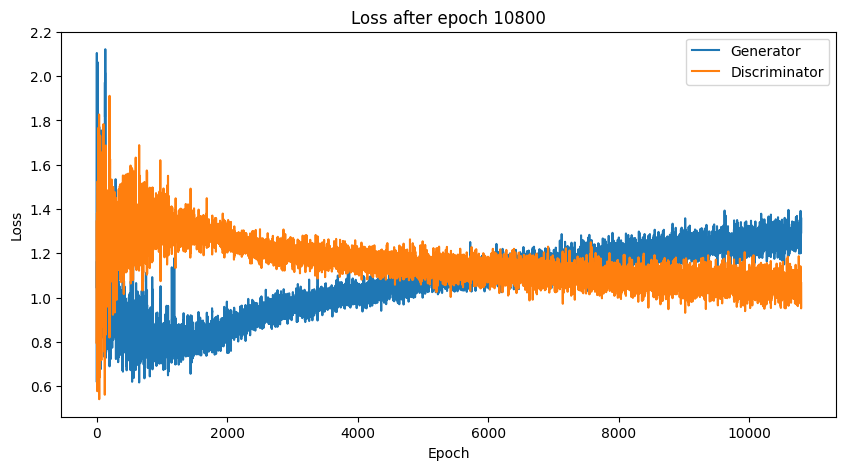

Time for epoch 10800 is 3.715379238128662 sec
Time for epoch 10801 is 0.8566510677337646 sec
Time for epoch 10802 is 0.8638975620269775 sec
Time for epoch 10803 is 0.8645853996276855 sec
Time for epoch 10804 is 0.8748073577880859 sec
Time for epoch 10805 is 0.8743886947631836 sec
Time for epoch 10806 is 0.8748695850372314 sec
Time for epoch 10807 is 0.8794903755187988 sec
Time for epoch 10808 is 0.8733761310577393 sec
Time for epoch 10809 is 0.8829405307769775 sec
Time for epoch 10810 is 0.8803761005401611 sec
Time for epoch 10811 is 0.8843116760253906 sec
Time for epoch 10812 is 0.8746087551116943 sec
Time for epoch 10813 is 0.879542350769043 sec
Time for epoch 10814 is 0.885000467300415 sec
Time for epoch 10815 is 0.87917160987854 sec
Time for epoch 10816 is 0.8812344074249268 sec
Time for epoch 10817 is 0.8838214874267578 sec
Time for epoch 10818 is 0.881864070892334 sec
Time for epoch 10819 is 0.8831930160522461 sec
Time for epoch 10820 is 0.886821985244751 sec
Time for epoch 10821

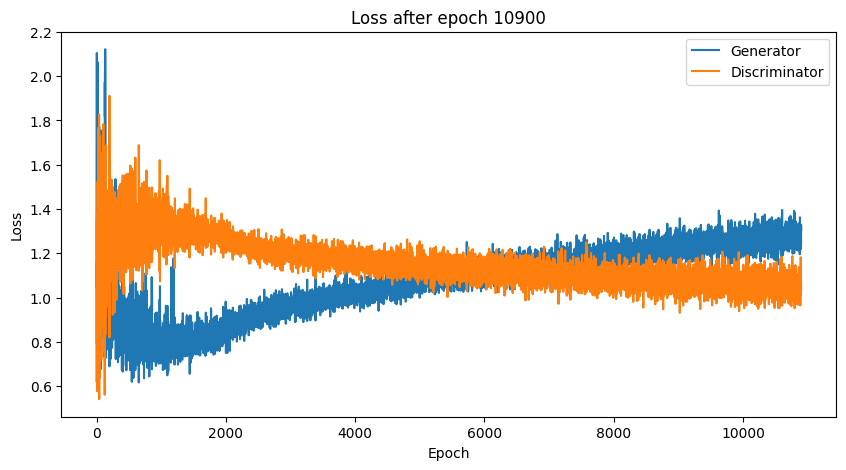

Time for epoch 10900 is 3.544551134109497 sec
Time for epoch 10901 is 0.8697481155395508 sec
Time for epoch 10902 is 0.8627257347106934 sec
Time for epoch 10903 is 0.8714511394500732 sec
Time for epoch 10904 is 0.8681964874267578 sec
Time for epoch 10905 is 0.8748540878295898 sec
Time for epoch 10906 is 0.8733999729156494 sec
Time for epoch 10907 is 0.87953782081604 sec
Time for epoch 10908 is 0.8744256496429443 sec
Time for epoch 10909 is 0.886038064956665 sec
Time for epoch 10910 is 0.8783831596374512 sec
Time for epoch 10911 is 0.8799350261688232 sec
Time for epoch 10912 is 0.881359338760376 sec
Time for epoch 10913 is 0.87778639793396 sec
Time for epoch 10914 is 0.8823301792144775 sec
Time for epoch 10915 is 0.8848567008972168 sec
Time for epoch 10916 is 0.8829367160797119 sec
Time for epoch 10917 is 0.8847384452819824 sec
Time for epoch 10918 is 0.8838021755218506 sec
Time for epoch 10919 is 0.882911205291748 sec
Time for epoch 10920 is 0.8877954483032227 sec
Time for epoch 10921 

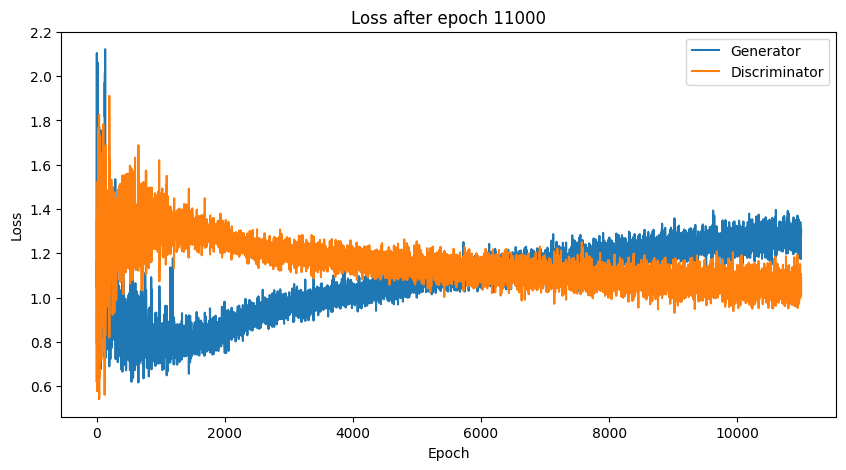

Time for epoch 11000 is 3.6929168701171875 sec
Time for epoch 11001 is 0.8705503940582275 sec
Time for epoch 11002 is 0.8598031997680664 sec
Time for epoch 11003 is 0.8719899654388428 sec
Time for epoch 11004 is 0.8780369758605957 sec
Time for epoch 11005 is 0.8668112754821777 sec
Time for epoch 11006 is 0.8749778270721436 sec
Time for epoch 11007 is 0.8783469200134277 sec
Time for epoch 11008 is 0.8709397315979004 sec
Time for epoch 11009 is 0.8809292316436768 sec
Time for epoch 11010 is 0.8770477771759033 sec
Time for epoch 11011 is 0.884845495223999 sec
Time for epoch 11012 is 0.8825500011444092 sec
Time for epoch 11013 is 0.8841018676757812 sec
Time for epoch 11014 is 0.8830423355102539 sec
Time for epoch 11015 is 0.8792684078216553 sec
Time for epoch 11016 is 0.8820745944976807 sec
Time for epoch 11017 is 0.8807659149169922 sec
Time for epoch 11018 is 0.8822884559631348 sec
Time for epoch 11019 is 0.8831396102905273 sec
Time for epoch 11020 is 0.8841841220855713 sec
Time for epoch

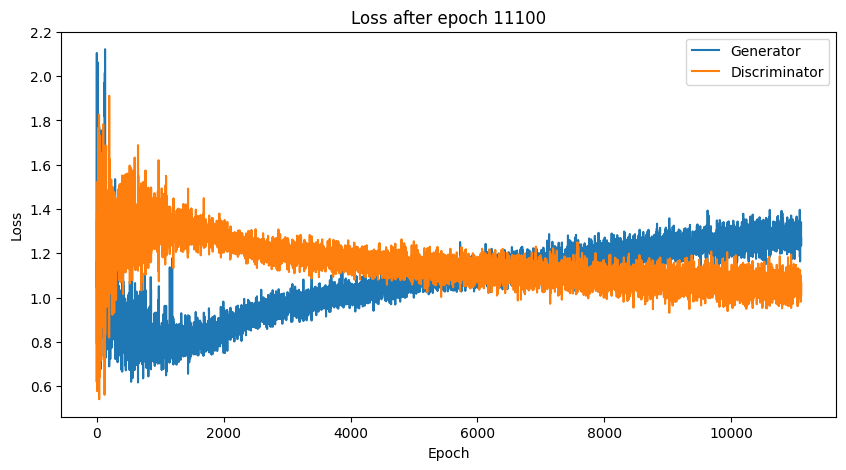

Time for epoch 11100 is 3.7223117351531982 sec
Time for epoch 11101 is 0.8675336837768555 sec
Time for epoch 11102 is 0.864924430847168 sec
Time for epoch 11103 is 0.8739111423492432 sec
Time for epoch 11104 is 0.8700788021087646 sec
Time for epoch 11105 is 0.8736832141876221 sec
Time for epoch 11106 is 0.8744292259216309 sec
Time for epoch 11107 is 0.8772563934326172 sec
Time for epoch 11108 is 0.8744363784790039 sec
Time for epoch 11109 is 0.8790335655212402 sec
Time for epoch 11110 is 0.8793938159942627 sec
Time for epoch 11111 is 0.8784773349761963 sec
Time for epoch 11112 is 0.8823745250701904 sec
Time for epoch 11113 is 0.8844988346099854 sec
Time for epoch 11114 is 0.8820962905883789 sec
Time for epoch 11115 is 0.8860926628112793 sec
Time for epoch 11116 is 0.8811533451080322 sec
Time for epoch 11117 is 0.8817582130432129 sec
Time for epoch 11118 is 0.8821735382080078 sec
Time for epoch 11119 is 0.8846530914306641 sec
Time for epoch 11120 is 0.880547046661377 sec
Time for epoch 

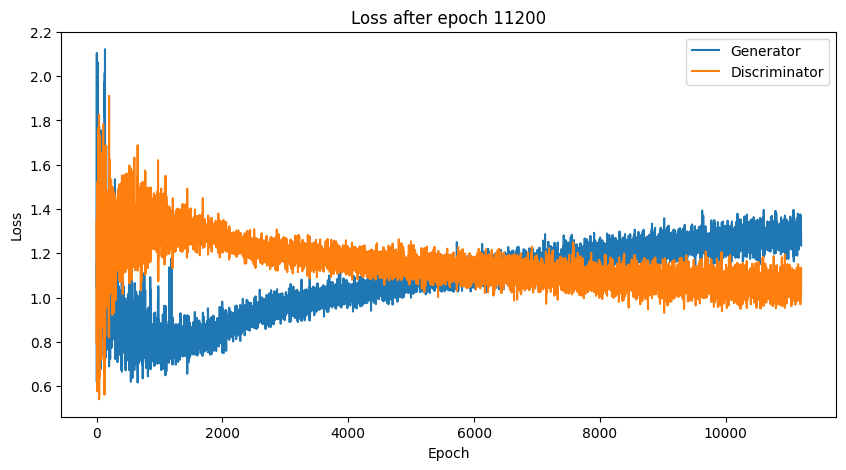

Time for epoch 11200 is 3.547501564025879 sec
Time for epoch 11201 is 0.8481311798095703 sec
Time for epoch 11202 is 0.8689975738525391 sec
Time for epoch 11203 is 0.8728151321411133 sec
Time for epoch 11204 is 0.8791930675506592 sec
Time for epoch 11205 is 0.8721280097961426 sec
Time for epoch 11206 is 0.8789138793945312 sec
Time for epoch 11207 is 0.8786792755126953 sec
Time for epoch 11208 is 0.8792312145233154 sec
Time for epoch 11209 is 0.8752751350402832 sec
Time for epoch 11210 is 0.8849184513092041 sec
Time for epoch 11211 is 0.8806841373443604 sec
Time for epoch 11212 is 0.8811664581298828 sec
Time for epoch 11213 is 0.8803627490997314 sec
Time for epoch 11214 is 0.8825833797454834 sec
Time for epoch 11215 is 0.8822581768035889 sec
Time for epoch 11216 is 0.8833162784576416 sec
Time for epoch 11217 is 0.88291335105896 sec
Time for epoch 11218 is 0.8812189102172852 sec
Time for epoch 11219 is 0.8898396492004395 sec
Time for epoch 11220 is 0.8880057334899902 sec
Time for epoch 1

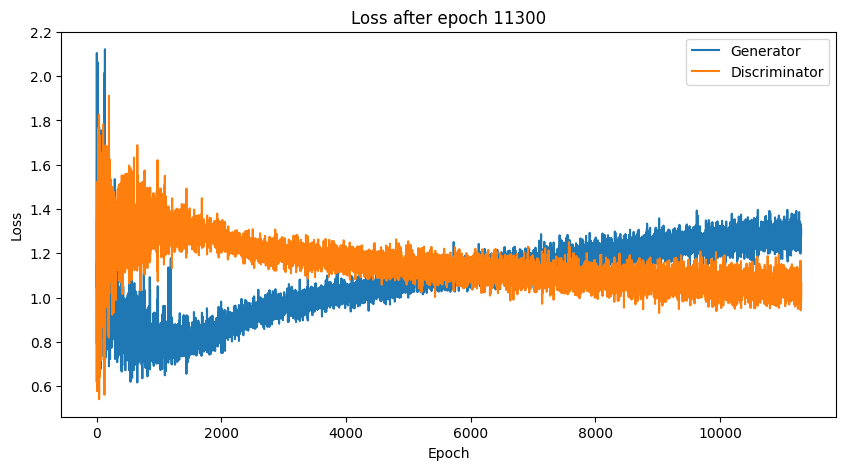

Time for epoch 11300 is 3.7138421535491943 sec
Time for epoch 11301 is 0.8573760986328125 sec
Time for epoch 11302 is 0.8639736175537109 sec
Time for epoch 11303 is 0.8699660301208496 sec
Time for epoch 11304 is 0.8692111968994141 sec
Time for epoch 11305 is 0.8724527359008789 sec
Time for epoch 11306 is 0.8771717548370361 sec
Time for epoch 11307 is 0.8759820461273193 sec
Time for epoch 11308 is 0.8779494762420654 sec
Time for epoch 11309 is 0.8803062438964844 sec
Time for epoch 11310 is 0.8809666633605957 sec
Time for epoch 11311 is 0.8785912990570068 sec
Time for epoch 11312 is 0.879209041595459 sec
Time for epoch 11313 is 0.8832428455352783 sec
Time for epoch 11314 is 0.8786623477935791 sec
Time for epoch 11315 is 0.8821096420288086 sec
Time for epoch 11316 is 0.8813674449920654 sec
Time for epoch 11317 is 0.8803410530090332 sec
Time for epoch 11318 is 0.8840773105621338 sec
Time for epoch 11319 is 0.8841636180877686 sec
Time for epoch 11320 is 0.8820598125457764 sec
Time for epoch

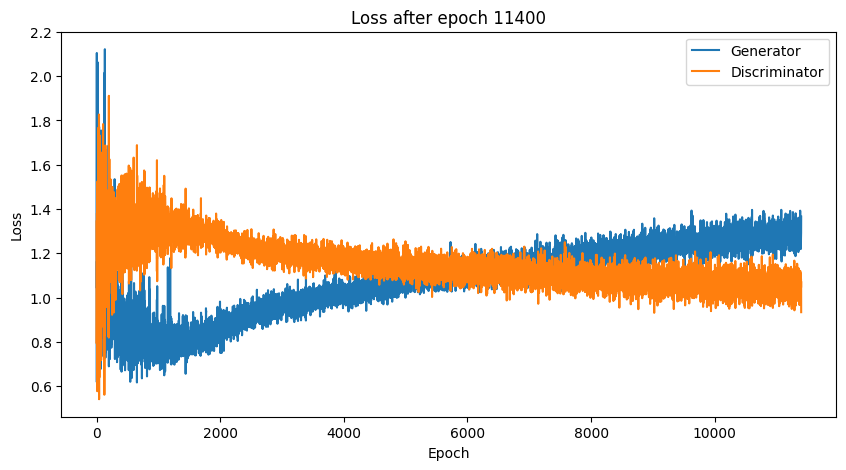

Time for epoch 11400 is 3.7193305492401123 sec
Time for epoch 11401 is 0.8576838970184326 sec
Time for epoch 11402 is 0.8671994209289551 sec
Time for epoch 11403 is 0.8692605495452881 sec
Time for epoch 11404 is 0.873345136642456 sec
Time for epoch 11405 is 0.876070499420166 sec
Time for epoch 11406 is 0.8721263408660889 sec
Time for epoch 11407 is 0.8746678829193115 sec
Time for epoch 11408 is 0.890509843826294 sec
Time for epoch 11409 is 0.8807446956634521 sec
Time for epoch 11410 is 0.8778853416442871 sec
Time for epoch 11411 is 0.878575325012207 sec
Time for epoch 11412 is 0.8863613605499268 sec
Time for epoch 11413 is 0.8772985935211182 sec
Time for epoch 11414 is 0.8769292831420898 sec
Time for epoch 11415 is 0.8809242248535156 sec
Time for epoch 11416 is 0.8826370239257812 sec
Time for epoch 11417 is 0.884871244430542 sec
Time for epoch 11418 is 0.883704423904419 sec
Time for epoch 11419 is 0.8861923217773438 sec
Time for epoch 11420 is 0.886040449142456 sec
Time for epoch 11421

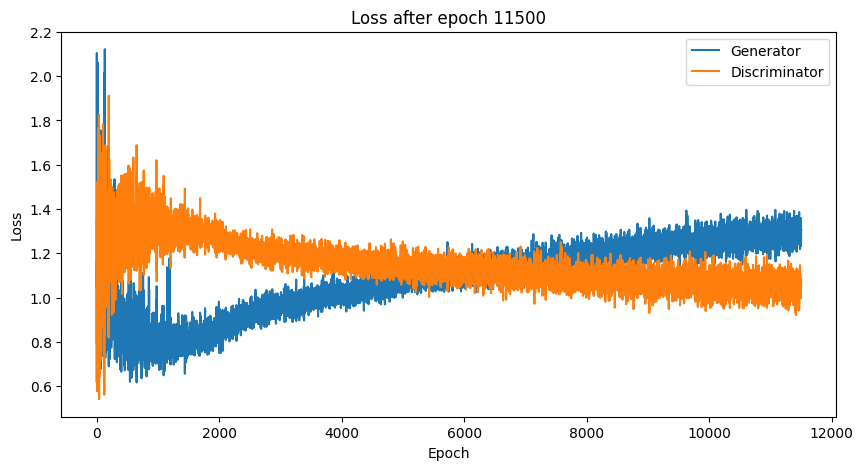

Time for epoch 11500 is 3.5717079639434814 sec
Time for epoch 11501 is 0.8580315113067627 sec
Time for epoch 11502 is 0.864081859588623 sec
Time for epoch 11503 is 0.8703639507293701 sec
Time for epoch 11504 is 0.8662581443786621 sec
Time for epoch 11505 is 0.8741593360900879 sec
Time for epoch 11506 is 0.869605302810669 sec
Time for epoch 11507 is 0.8752617835998535 sec
Time for epoch 11508 is 0.8755733966827393 sec
Time for epoch 11509 is 0.8768980503082275 sec
Time for epoch 11510 is 0.8774378299713135 sec
Time for epoch 11511 is 0.8779647350311279 sec
Time for epoch 11512 is 0.8852715492248535 sec
Time for epoch 11513 is 0.8800697326660156 sec
Time for epoch 11514 is 0.8789920806884766 sec
Time for epoch 11515 is 0.8815007209777832 sec
Time for epoch 11516 is 0.8835670948028564 sec
Time for epoch 11517 is 0.88299560546875 sec
Time for epoch 11518 is 0.8861920833587646 sec
Time for epoch 11519 is 0.881927490234375 sec
Time for epoch 11520 is 0.8848159313201904 sec
Time for epoch 115

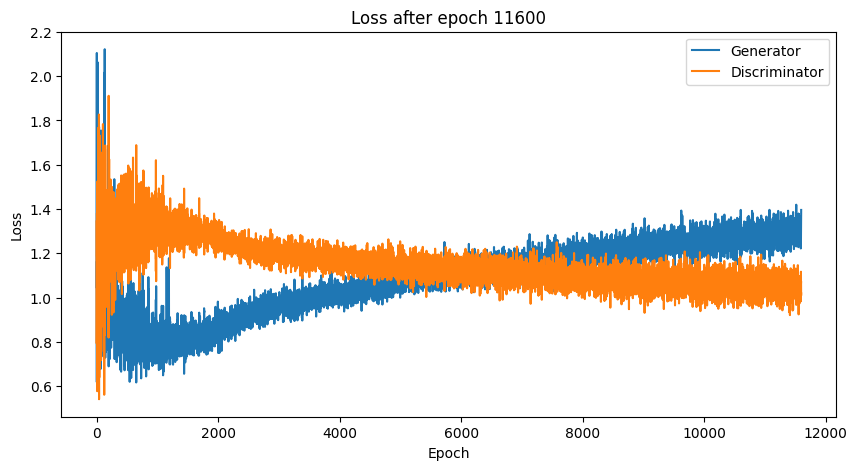

Time for epoch 11600 is 3.718808889389038 sec
Time for epoch 11601 is 0.8626255989074707 sec
Time for epoch 11602 is 0.8620872497558594 sec
Time for epoch 11603 is 0.8671424388885498 sec
Time for epoch 11604 is 0.8696215152740479 sec
Time for epoch 11605 is 0.8735346794128418 sec
Time for epoch 11606 is 0.8731443881988525 sec
Time for epoch 11607 is 0.8702120780944824 sec
Time for epoch 11608 is 0.8757040500640869 sec
Time for epoch 11609 is 0.8753385543823242 sec
Time for epoch 11610 is 0.8766412734985352 sec
Time for epoch 11611 is 0.8739686012268066 sec
Time for epoch 11612 is 0.8737366199493408 sec
Time for epoch 11613 is 0.8793125152587891 sec
Time for epoch 11614 is 0.8754818439483643 sec
Time for epoch 11615 is 0.880598783493042 sec
Time for epoch 11616 is 0.8789749145507812 sec
Time for epoch 11617 is 0.8830897808074951 sec
Time for epoch 11618 is 0.8847019672393799 sec
Time for epoch 11619 is 0.8821091651916504 sec
Time for epoch 11620 is 0.880906343460083 sec
Time for epoch 1

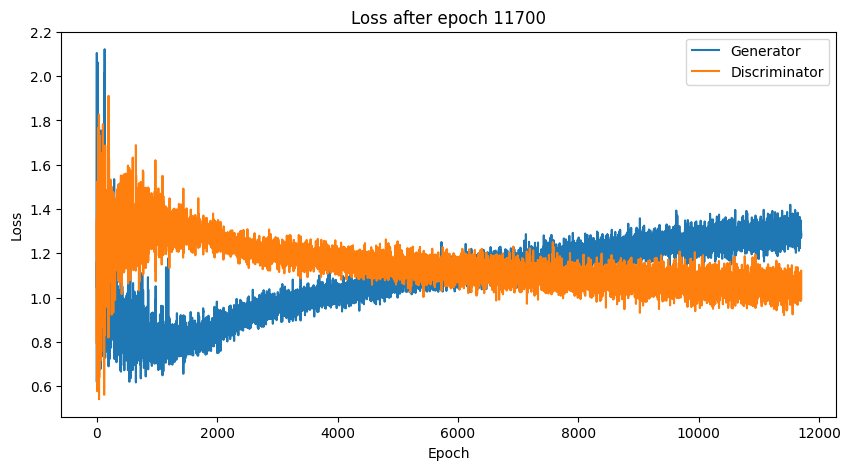

Time for epoch 11700 is 3.7670841217041016 sec
Time for epoch 11701 is 0.8521556854248047 sec
Time for epoch 11702 is 0.866901159286499 sec
Time for epoch 11703 is 0.8706560134887695 sec
Time for epoch 11704 is 0.8677027225494385 sec
Time for epoch 11705 is 0.8755288124084473 sec
Time for epoch 11706 is 0.876878023147583 sec
Time for epoch 11707 is 0.8758440017700195 sec
Time for epoch 11708 is 0.8757612705230713 sec
Time for epoch 11709 is 0.8753595352172852 sec
Time for epoch 11710 is 0.8776824474334717 sec
Time for epoch 11711 is 0.8846874237060547 sec
Time for epoch 11712 is 0.876629114151001 sec
Time for epoch 11713 is 0.8804943561553955 sec
Time for epoch 11714 is 0.8790462017059326 sec
Time for epoch 11715 is 0.8813283443450928 sec
Time for epoch 11716 is 0.8814496994018555 sec
Time for epoch 11717 is 0.882453203201294 sec
Time for epoch 11718 is 0.8829972743988037 sec
Time for epoch 11719 is 0.885382890701294 sec
Time for epoch 11720 is 0.881335973739624 sec
Time for epoch 1172

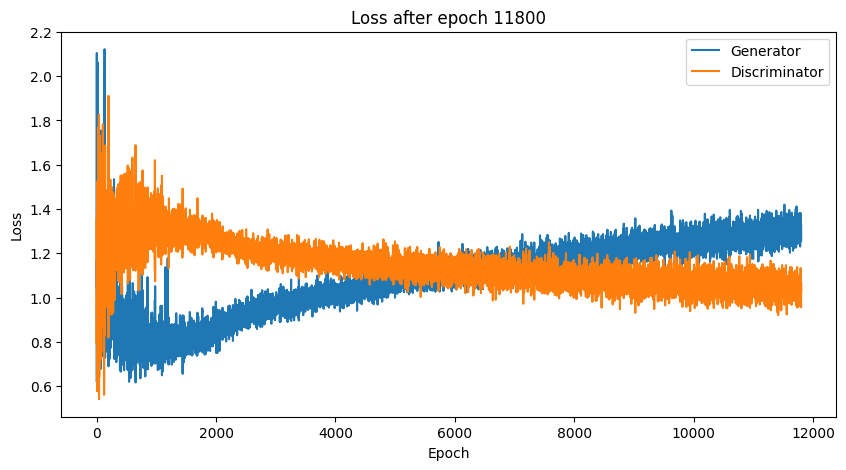

Time for epoch 11800 is 3.7512152194976807 sec
Time for epoch 11801 is 0.8631577491760254 sec
Time for epoch 11802 is 0.8596470355987549 sec
Time for epoch 11803 is 0.8630349636077881 sec
Time for epoch 11804 is 0.8689045906066895 sec
Time for epoch 11805 is 0.8750829696655273 sec
Time for epoch 11806 is 0.8718299865722656 sec
Time for epoch 11807 is 0.8745546340942383 sec
Time for epoch 11808 is 0.8723099231719971 sec
Time for epoch 11809 is 0.8702330589294434 sec
Time for epoch 11810 is 0.8771219253540039 sec
Time for epoch 11811 is 0.8794949054718018 sec
Time for epoch 11812 is 0.8745286464691162 sec
Time for epoch 11813 is 0.8815171718597412 sec
Time for epoch 11814 is 0.8785827159881592 sec
Time for epoch 11815 is 0.8844680786132812 sec
Time for epoch 11816 is 0.8822288513183594 sec
Time for epoch 11817 is 0.884249210357666 sec
Time for epoch 11818 is 1.2680671215057373 sec
Time for epoch 11819 is 0.864412784576416 sec
Time for epoch 11820 is 0.8827755451202393 sec
Time for epoch 

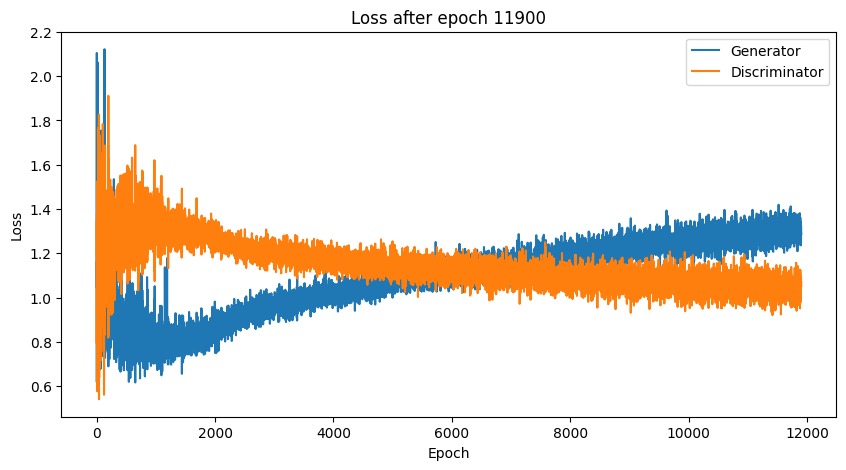

Time for epoch 11900 is 3.596820831298828 sec
Time for epoch 11901 is 0.8604192733764648 sec
Time for epoch 11902 is 0.8653609752655029 sec
Time for epoch 11903 is 0.8718459606170654 sec
Time for epoch 11904 is 0.8711049556732178 sec
Time for epoch 11905 is 0.8780219554901123 sec
Time for epoch 11906 is 0.8777720928192139 sec
Time for epoch 11907 is 0.8735370635986328 sec
Time for epoch 11908 is 0.8733024597167969 sec
Time for epoch 11909 is 0.8823463916778564 sec
Time for epoch 11910 is 0.8766953945159912 sec
Time for epoch 11911 is 0.8787176609039307 sec
Time for epoch 11912 is 0.8782961368560791 sec
Time for epoch 11913 is 0.8819456100463867 sec
Time for epoch 11914 is 0.8842475414276123 sec
Time for epoch 11915 is 0.8812274932861328 sec
Time for epoch 11916 is 0.878406286239624 sec
Time for epoch 11917 is 0.8820123672485352 sec
Time for epoch 11918 is 0.8847806453704834 sec
Time for epoch 11919 is 0.8884196281433105 sec
Time for epoch 11920 is 0.8839097023010254 sec
Time for epoch 

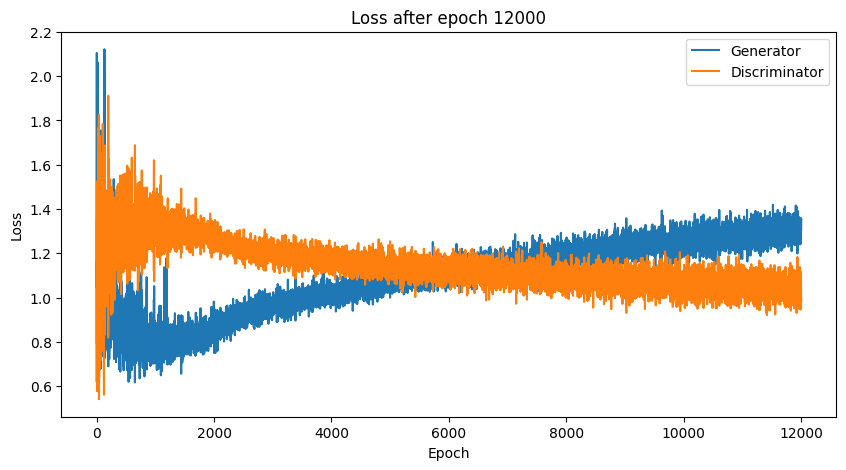

Time for epoch 12000 is 3.74049711227417 sec
Time for epoch 12001 is 0.8662431240081787 sec
Time for epoch 12002 is 0.8615157604217529 sec
Time for epoch 12003 is 0.8735737800598145 sec
Time for epoch 12004 is 0.8684546947479248 sec
Time for epoch 12005 is 0.8729329109191895 sec
Time for epoch 12006 is 0.8760614395141602 sec
Time for epoch 12007 is 0.8753616809844971 sec
Time for epoch 12008 is 0.8776395320892334 sec
Time for epoch 12009 is 0.8742055892944336 sec
Time for epoch 12010 is 0.8769104480743408 sec
Time for epoch 12011 is 0.8807265758514404 sec
Time for epoch 12012 is 0.8809099197387695 sec
Time for epoch 12013 is 0.882171630859375 sec
Time for epoch 12014 is 0.8802344799041748 sec
Time for epoch 12015 is 0.8796913623809814 sec
Time for epoch 12016 is 0.8810274600982666 sec
Time for epoch 12017 is 0.8827197551727295 sec
Time for epoch 12018 is 0.8803608417510986 sec
Time for epoch 12019 is 0.8795425891876221 sec
Time for epoch 12020 is 0.8816397190093994 sec
Time for epoch 1

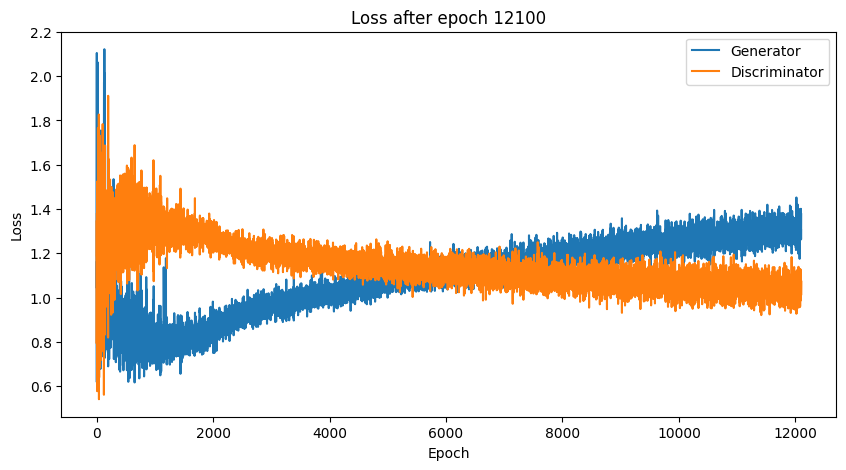

Time for epoch 12100 is 3.7626075744628906 sec
Time for epoch 12101 is 0.8559010028839111 sec
Time for epoch 12102 is 0.8679909706115723 sec
Time for epoch 12103 is 0.8633360862731934 sec
Time for epoch 12104 is 0.8702781200408936 sec
Time for epoch 12105 is 0.8712763786315918 sec
Time for epoch 12106 is 0.876300573348999 sec
Time for epoch 12107 is 0.8767426013946533 sec
Time for epoch 12108 is 0.8764386177062988 sec
Time for epoch 12109 is 0.8754384517669678 sec
Time for epoch 12110 is 0.8791816234588623 sec
Time for epoch 12111 is 0.881378173828125 sec
Time for epoch 12112 is 0.8817517757415771 sec
Time for epoch 12113 is 0.8787224292755127 sec
Time for epoch 12114 is 0.8785169124603271 sec
Time for epoch 12115 is 0.8854153156280518 sec
Time for epoch 12116 is 0.8751635551452637 sec
Time for epoch 12117 is 0.8835353851318359 sec
Time for epoch 12118 is 0.8825109004974365 sec
Time for epoch 12119 is 0.8828504085540771 sec
Time for epoch 12120 is 0.8818972110748291 sec
Time for epoch 

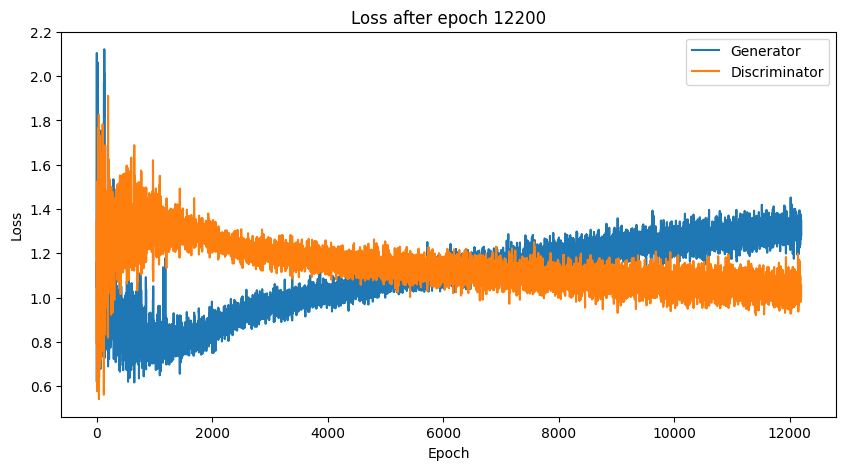

Time for epoch 12200 is 3.5548579692840576 sec
Time for epoch 12201 is 0.8531255722045898 sec
Time for epoch 12202 is 0.8716921806335449 sec
Time for epoch 12203 is 0.8675870895385742 sec
Time for epoch 12204 is 0.8730340003967285 sec
Time for epoch 12205 is 0.8719923496246338 sec
Time for epoch 12206 is 0.8794348239898682 sec
Time for epoch 12207 is 0.8788447380065918 sec
Time for epoch 12208 is 0.8756532669067383 sec
Time for epoch 12209 is 0.882056713104248 sec
Time for epoch 12210 is 0.8744597434997559 sec
Time for epoch 12211 is 0.8800802230834961 sec
Time for epoch 12212 is 0.8850395679473877 sec
Time for epoch 12213 is 0.880988597869873 sec
Time for epoch 12214 is 0.8811187744140625 sec
Time for epoch 12215 is 0.8829147815704346 sec
Time for epoch 12216 is 0.8817963600158691 sec
Time for epoch 12217 is 0.8837175369262695 sec
Time for epoch 12218 is 0.8784191608428955 sec
Time for epoch 12219 is 0.8858628273010254 sec
Time for epoch 12220 is 0.8844778537750244 sec
Time for epoch 

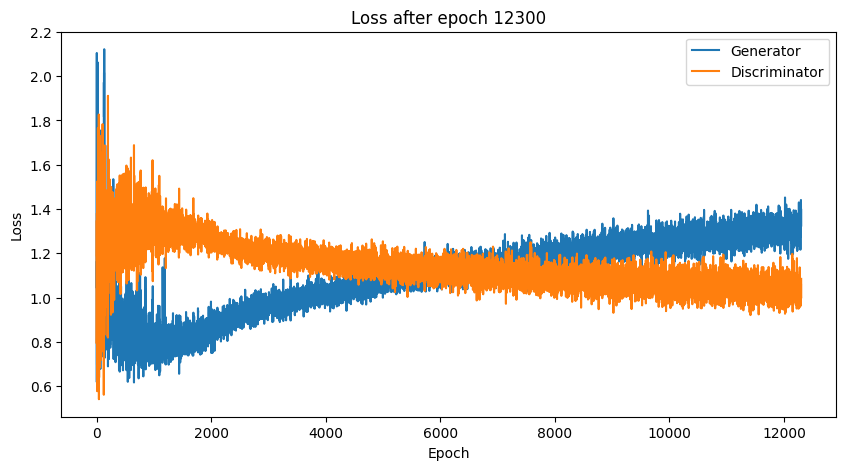

Time for epoch 12300 is 3.760603427886963 sec
Time for epoch 12301 is 0.8581130504608154 sec
Time for epoch 12302 is 0.8641767501831055 sec
Time for epoch 12303 is 0.8665540218353271 sec
Time for epoch 12304 is 0.8721866607666016 sec
Time for epoch 12305 is 0.8689022064208984 sec
Time for epoch 12306 is 0.8782281875610352 sec
Time for epoch 12307 is 0.875105619430542 sec
Time for epoch 12308 is 0.8751471042633057 sec
Time for epoch 12309 is 0.8767290115356445 sec
Time for epoch 12310 is 0.8750605583190918 sec
Time for epoch 12311 is 0.8750650882720947 sec
Time for epoch 12312 is 0.8749611377716064 sec
Time for epoch 12313 is 0.8809807300567627 sec
Time for epoch 12314 is 0.8767385482788086 sec
Time for epoch 12315 is 0.8829553127288818 sec
Time for epoch 12316 is 0.8770685195922852 sec
Time for epoch 12317 is 0.8800432682037354 sec
Time for epoch 12318 is 0.8842763900756836 sec
Time for epoch 12319 is 0.8833768367767334 sec
Time for epoch 12320 is 0.8851001262664795 sec
Time for epoch 

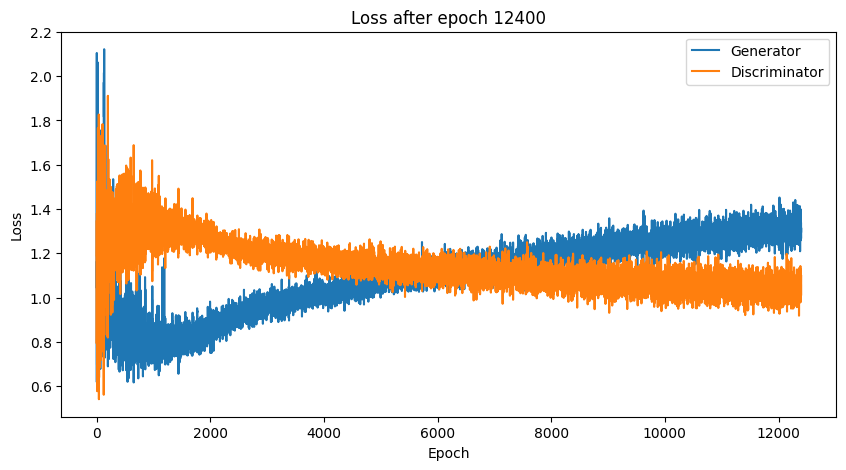

Time for epoch 12400 is 3.837535858154297 sec
Time for epoch 12401 is 0.8612072467803955 sec
Time for epoch 12402 is 0.8601398468017578 sec
Time for epoch 12403 is 0.86777663230896 sec
Time for epoch 12404 is 0.8689076900482178 sec
Time for epoch 12405 is 0.875838041305542 sec
Time for epoch 12406 is 0.8667123317718506 sec
Time for epoch 12407 is 0.8806095123291016 sec
Time for epoch 12408 is 0.8769741058349609 sec
Time for epoch 12409 is 0.870520830154419 sec
Time for epoch 12410 is 0.8830254077911377 sec
Time for epoch 12411 is 0.8804829120635986 sec
Time for epoch 12412 is 0.8836615085601807 sec
Time for epoch 12413 is 0.880033016204834 sec
Time for epoch 12414 is 0.8799097537994385 sec
Time for epoch 12415 is 0.8802905082702637 sec
Time for epoch 12416 is 0.8837568759918213 sec
Time for epoch 12417 is 0.8812241554260254 sec
Time for epoch 12418 is 0.8856697082519531 sec
Time for epoch 12419 is 0.8829381465911865 sec
Time for epoch 12420 is 0.8860971927642822 sec
Time for epoch 1242

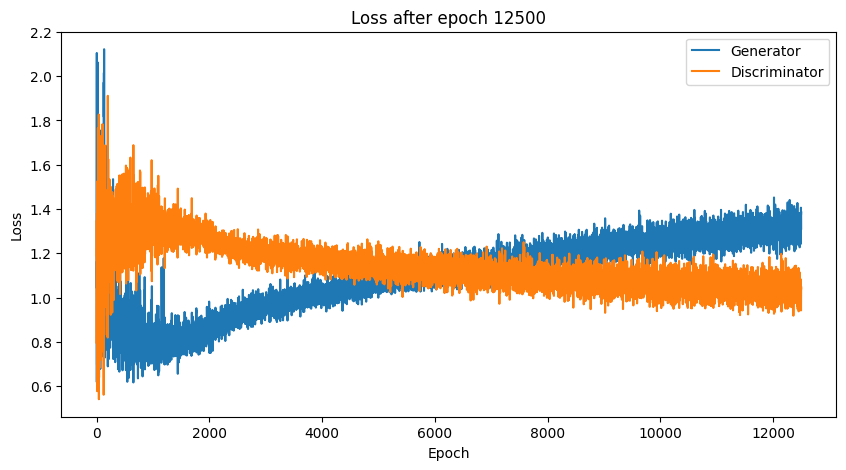

Time for epoch 12500 is 3.6186563968658447 sec
Time for epoch 12501 is 0.8669736385345459 sec
Time for epoch 12502 is 0.8610315322875977 sec
Time for epoch 12503 is 0.867457389831543 sec
Time for epoch 12504 is 0.8710064888000488 sec
Time for epoch 12505 is 0.8767614364624023 sec
Time for epoch 12506 is 0.8780555725097656 sec
Time for epoch 12507 is 0.8729639053344727 sec
Time for epoch 12508 is 0.8780395984649658 sec
Time for epoch 12509 is 0.8793675899505615 sec
Time for epoch 12510 is 0.8758633136749268 sec
Time for epoch 12511 is 0.8857583999633789 sec
Time for epoch 12512 is 0.8743915557861328 sec
Time for epoch 12513 is 0.8778669834136963 sec
Time for epoch 12514 is 0.8768713474273682 sec
Time for epoch 12515 is 0.8846380710601807 sec
Time for epoch 12516 is 0.878462553024292 sec
Time for epoch 12517 is 0.8845946788787842 sec
Time for epoch 12518 is 0.8811888694763184 sec
Time for epoch 12519 is 0.8821372985839844 sec
Time for epoch 12520 is 0.8892576694488525 sec
Time for epoch 

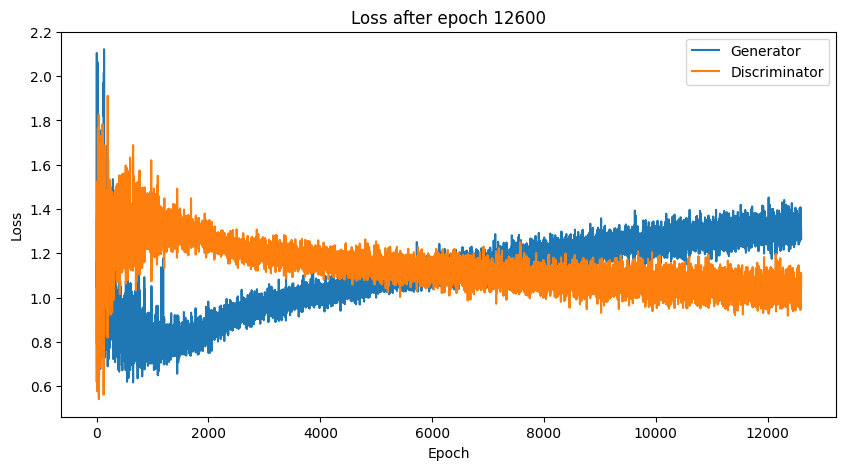

Time for epoch 12600 is 3.760991096496582 sec
Time for epoch 12601 is 0.8516373634338379 sec
Time for epoch 12602 is 0.8660435676574707 sec
Time for epoch 12603 is 0.8634827136993408 sec
Time for epoch 12604 is 0.8686985969543457 sec
Time for epoch 12605 is 0.8708927631378174 sec
Time for epoch 12606 is 0.872791051864624 sec
Time for epoch 12607 is 0.8723616600036621 sec
Time for epoch 12608 is 0.8821935653686523 sec
Time for epoch 12609 is 0.877777099609375 sec
Time for epoch 12610 is 0.879857063293457 sec
Time for epoch 12611 is 0.8828394412994385 sec
Time for epoch 12612 is 0.8775098323822021 sec
Time for epoch 12613 is 0.8758184909820557 sec
Time for epoch 12614 is 0.8762705326080322 sec
Time for epoch 12615 is 0.880826473236084 sec
Time for epoch 12616 is 0.8785324096679688 sec
Time for epoch 12617 is 0.8814809322357178 sec
Time for epoch 12618 is 0.8809537887573242 sec
Time for epoch 12619 is 0.8848233222961426 sec
Time for epoch 12620 is 0.8817956447601318 sec
Time for epoch 126

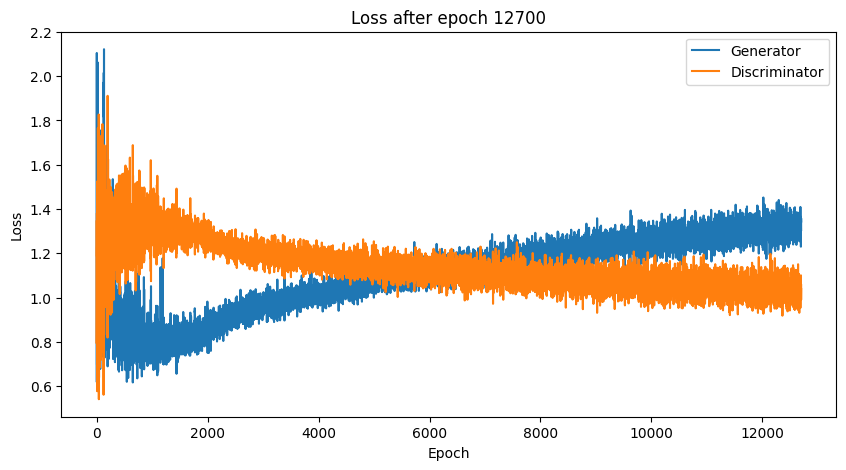

Time for epoch 12700 is 3.807316780090332 sec
Time for epoch 12701 is 0.8583788871765137 sec
Time for epoch 12702 is 0.8700993061065674 sec
Time for epoch 12703 is 0.8702802658081055 sec
Time for epoch 12704 is 0.8649051189422607 sec
Time for epoch 12705 is 0.8727192878723145 sec
Time for epoch 12706 is 0.8795294761657715 sec
Time for epoch 12707 is 0.87217116355896 sec
Time for epoch 12708 is 0.877962589263916 sec
Time for epoch 12709 is 0.8799054622650146 sec
Time for epoch 12710 is 0.8741288185119629 sec
Time for epoch 12711 is 0.8784499168395996 sec
Time for epoch 12712 is 0.8756310939788818 sec
Time for epoch 12713 is 0.8845677375793457 sec
Time for epoch 12714 is 0.87424635887146 sec
Time for epoch 12715 is 0.8818953037261963 sec
Time for epoch 12716 is 0.8846306800842285 sec
Time for epoch 12717 is 0.8837277889251709 sec
Time for epoch 12718 is 0.8861277103424072 sec
Time for epoch 12719 is 0.8829913139343262 sec
Time for epoch 12720 is 0.881190299987793 sec
Time for epoch 12721

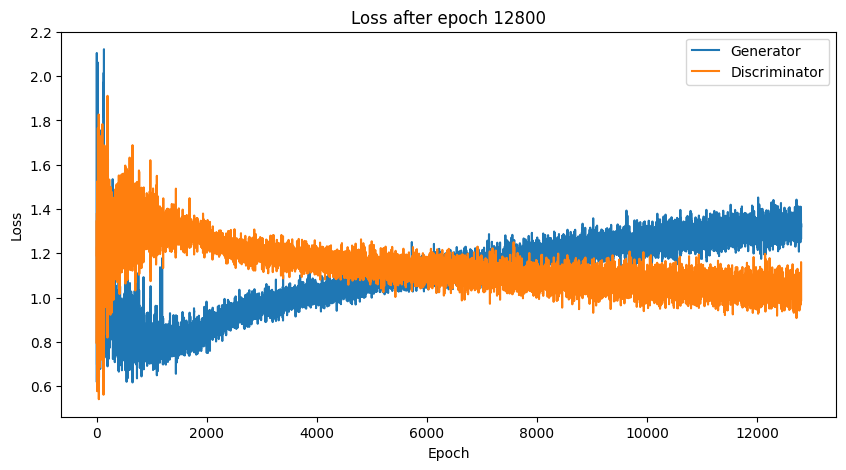

Time for epoch 12800 is 3.800811529159546 sec
Time for epoch 12801 is 0.8534963130950928 sec
Time for epoch 12802 is 0.865337610244751 sec
Time for epoch 12803 is 0.8714947700500488 sec
Time for epoch 12804 is 0.87058424949646 sec
Time for epoch 12805 is 0.8764913082122803 sec
Time for epoch 12806 is 0.8746824264526367 sec
Time for epoch 12807 is 0.8751716613769531 sec
Time for epoch 12808 is 0.8752353191375732 sec
Time for epoch 12809 is 0.8743910789489746 sec
Time for epoch 12810 is 0.8761641979217529 sec
Time for epoch 12811 is 0.8797042369842529 sec
Time for epoch 12812 is 0.8796441555023193 sec
Time for epoch 12813 is 0.8754808902740479 sec
Time for epoch 12814 is 0.8772172927856445 sec
Time for epoch 12815 is 0.8885774612426758 sec
Time for epoch 12816 is 0.8798601627349854 sec
Time for epoch 12817 is 0.883812665939331 sec
Time for epoch 12818 is 0.8842599391937256 sec
Time for epoch 12819 is 0.8793745040893555 sec
Time for epoch 12820 is 0.8847191333770752 sec
Time for epoch 128

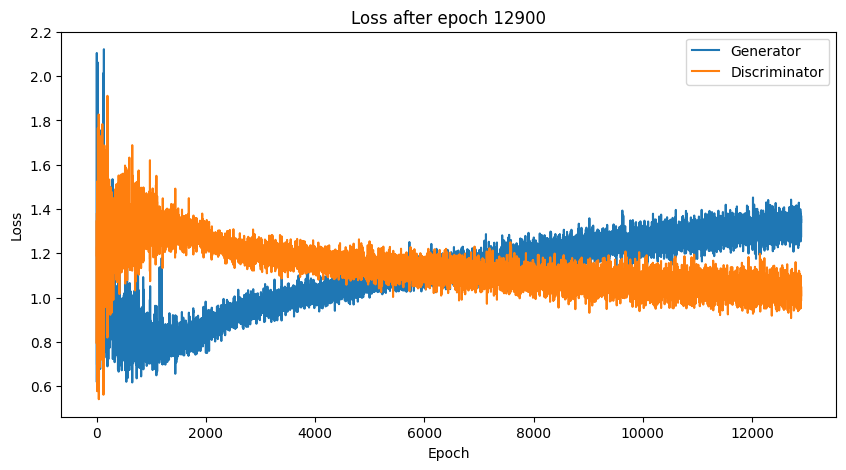

Time for epoch 12900 is 3.659079074859619 sec
Time for epoch 12901 is 0.8547186851501465 sec
Time for epoch 12902 is 0.8579621315002441 sec
Time for epoch 12903 is 0.8681216239929199 sec
Time for epoch 12904 is 0.873784065246582 sec
Time for epoch 12905 is 0.8701939582824707 sec
Time for epoch 12906 is 0.8759713172912598 sec
Time for epoch 12907 is 0.87396240234375 sec
Time for epoch 12908 is 0.8742635250091553 sec
Time for epoch 12909 is 0.8764462471008301 sec
Time for epoch 12910 is 0.8785645961761475 sec
Time for epoch 12911 is 0.8764824867248535 sec
Time for epoch 12912 is 0.8770875930786133 sec
Time for epoch 12913 is 0.8816726207733154 sec
Time for epoch 12914 is 0.8760089874267578 sec
Time for epoch 12915 is 0.8809022903442383 sec
Time for epoch 12916 is 0.8865761756896973 sec
Time for epoch 12917 is 0.8832523822784424 sec
Time for epoch 12918 is 0.8853209018707275 sec
Time for epoch 12919 is 0.8763775825500488 sec
Time for epoch 12920 is 0.8821020126342773 sec
Time for epoch 12

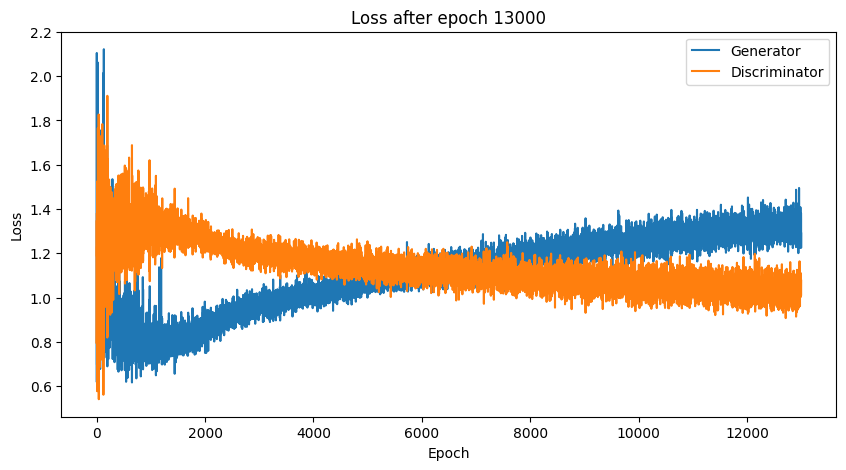

Time for epoch 13000 is 3.7930235862731934 sec
Time for epoch 13001 is 0.855259895324707 sec
Time for epoch 13002 is 0.8720498085021973 sec
Time for epoch 13003 is 0.8704683780670166 sec
Time for epoch 13004 is 0.8647997379302979 sec
Time for epoch 13005 is 0.8730134963989258 sec
Time for epoch 13006 is 0.8772838115692139 sec
Time for epoch 13007 is 0.8760395050048828 sec
Time for epoch 13008 is 0.8749175071716309 sec
Time for epoch 13009 is 0.8798861503601074 sec
Time for epoch 13010 is 0.8802716732025146 sec
Time for epoch 13011 is 0.8801343441009521 sec
Time for epoch 13012 is 0.8796231746673584 sec
Time for epoch 13013 is 0.8840732574462891 sec
Time for epoch 13014 is 0.878197193145752 sec
Time for epoch 13015 is 0.880143404006958 sec
Time for epoch 13016 is 0.8744494915008545 sec
Time for epoch 13017 is 0.8844931125640869 sec
Time for epoch 13018 is 0.8798139095306396 sec
Time for epoch 13019 is 0.8866040706634521 sec
Time for epoch 13020 is 0.8827342987060547 sec
Time for epoch 1

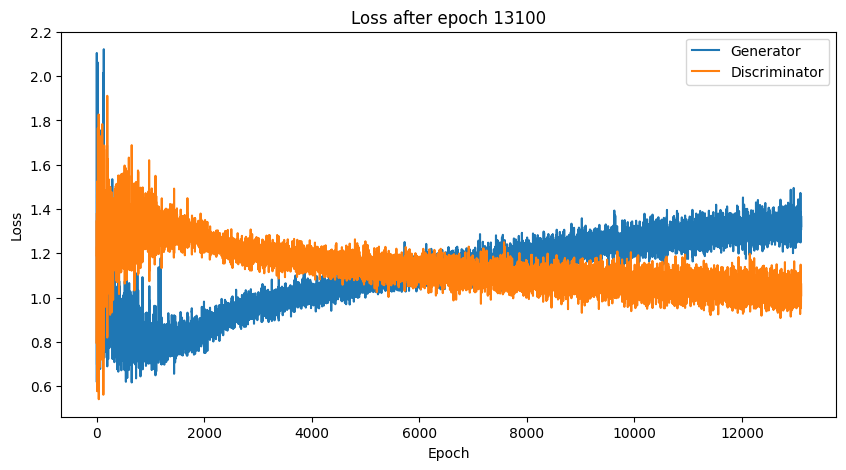

Time for epoch 13100 is 3.8160269260406494 sec
Time for epoch 13101 is 0.8539462089538574 sec
Time for epoch 13102 is 0.8693702220916748 sec
Time for epoch 13103 is 0.8675742149353027 sec
Time for epoch 13104 is 0.8684775829315186 sec
Time for epoch 13105 is 0.8770115375518799 sec
Time for epoch 13106 is 0.8783421516418457 sec
Time for epoch 13107 is 0.8738155364990234 sec
Time for epoch 13108 is 0.8786756992340088 sec
Time for epoch 13109 is 0.8769216537475586 sec
Time for epoch 13110 is 0.8846902847290039 sec
Time for epoch 13111 is 0.8767340183258057 sec
Time for epoch 13112 is 0.8816447257995605 sec
Time for epoch 13113 is 0.8770713806152344 sec
Time for epoch 13114 is 0.8727214336395264 sec
Time for epoch 13115 is 0.8827548027038574 sec
Time for epoch 13116 is 0.884037971496582 sec
Time for epoch 13117 is 0.8804504871368408 sec
Time for epoch 13118 is 0.8814923763275146 sec
Time for epoch 13119 is 0.8803377151489258 sec
Time for epoch 13120 is 0.8830456733703613 sec
Time for epoch

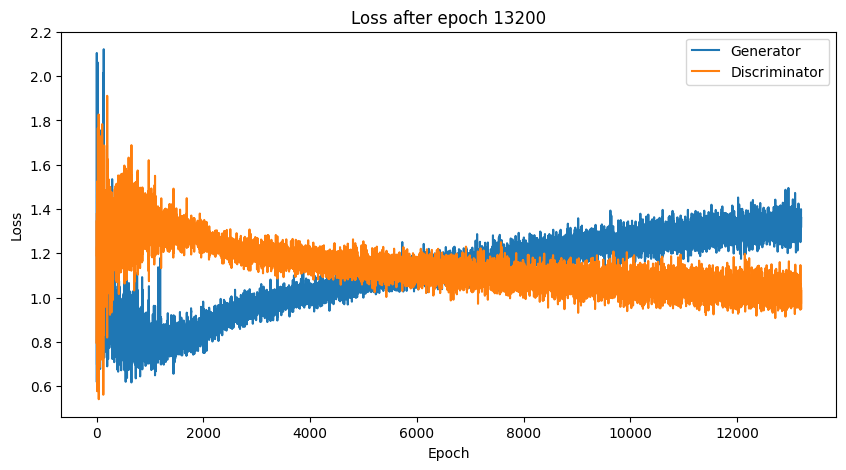

Time for epoch 13200 is 3.776193380355835 sec
Time for epoch 13201 is 0.8544149398803711 sec
Time for epoch 13202 is 0.8652040958404541 sec
Time for epoch 13203 is 0.8641595840454102 sec
Time for epoch 13204 is 0.8736968040466309 sec
Time for epoch 13205 is 0.8732955455780029 sec
Time for epoch 13206 is 0.8819665908813477 sec
Time for epoch 13207 is 0.8737034797668457 sec
Time for epoch 13208 is 0.8769130706787109 sec
Time for epoch 13209 is 0.8797919750213623 sec
Time for epoch 13210 is 0.8774697780609131 sec
Time for epoch 13211 is 0.8810248374938965 sec
Time for epoch 13212 is 0.8790771961212158 sec
Time for epoch 13213 is 0.882732629776001 sec
Time for epoch 13214 is 0.8787052631378174 sec
Time for epoch 13215 is 0.8808040618896484 sec
Time for epoch 13216 is 0.8797731399536133 sec
Time for epoch 13217 is 0.8809823989868164 sec
Time for epoch 13218 is 0.8832740783691406 sec
Time for epoch 13219 is 0.8867990970611572 sec
Time for epoch 13220 is 0.8791539669036865 sec
Time for epoch 

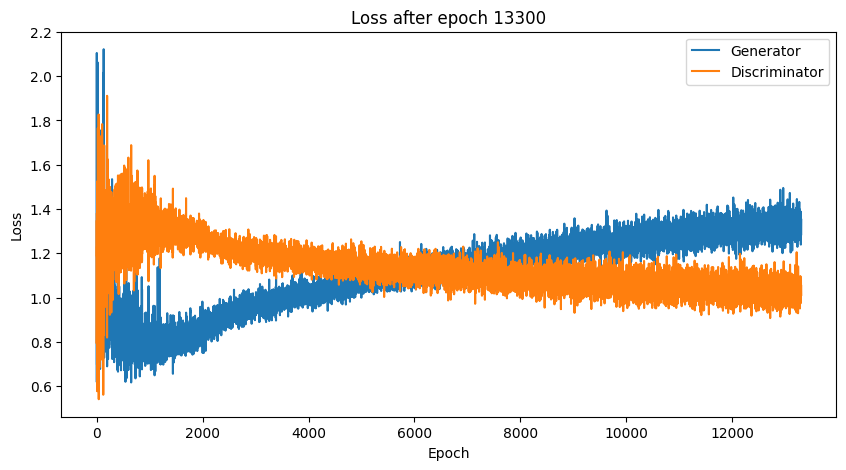

Time for epoch 13300 is 3.6264750957489014 sec
Time for epoch 13301 is 0.8493468761444092 sec
Time for epoch 13302 is 0.8677182197570801 sec
Time for epoch 13303 is 0.8704452514648438 sec
Time for epoch 13304 is 0.8753018379211426 sec
Time for epoch 13305 is 0.872427225112915 sec
Time for epoch 13306 is 0.8756327629089355 sec
Time for epoch 13307 is 0.8732776641845703 sec
Time for epoch 13308 is 0.8749535083770752 sec
Time for epoch 13309 is 0.8748269081115723 sec
Time for epoch 13310 is 0.8805851936340332 sec
Time for epoch 13311 is 0.8756253719329834 sec
Time for epoch 13312 is 0.8773252964019775 sec
Time for epoch 13313 is 0.884056806564331 sec
Time for epoch 13314 is 0.8865013122558594 sec
Time for epoch 13315 is 0.882544755935669 sec
Time for epoch 13316 is 0.8784024715423584 sec
Time for epoch 13317 is 0.8868486881256104 sec
Time for epoch 13318 is 0.8813846111297607 sec
Time for epoch 13319 is 0.8820586204528809 sec
Time for epoch 13320 is 0.8861258029937744 sec
Time for epoch 1

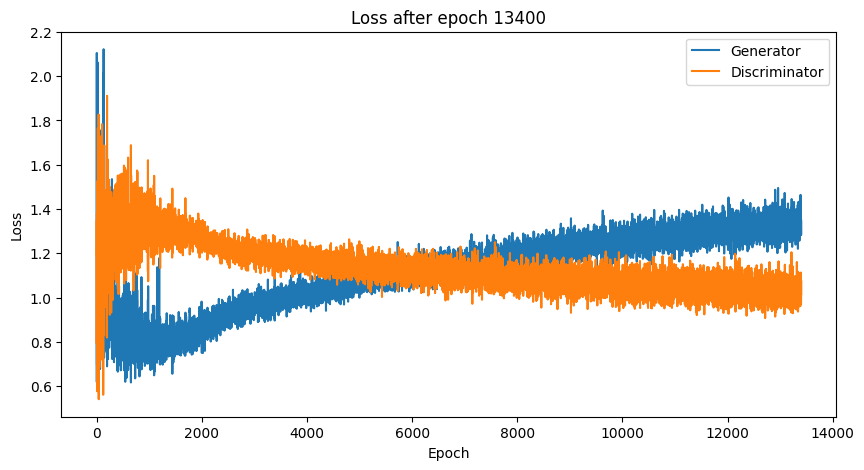

Time for epoch 13400 is 3.789914846420288 sec
Time for epoch 13401 is 0.8570234775543213 sec
Time for epoch 13402 is 0.8637673854827881 sec
Time for epoch 13403 is 0.8675789833068848 sec
Time for epoch 13404 is 0.8687207698822021 sec
Time for epoch 13405 is 0.8715977668762207 sec
Time for epoch 13406 is 0.8762812614440918 sec
Time for epoch 13407 is 0.8723671436309814 sec
Time for epoch 13408 is 0.8751976490020752 sec
Time for epoch 13409 is 0.8793318271636963 sec
Time for epoch 13410 is 0.8749489784240723 sec
Time for epoch 13411 is 0.8781812191009521 sec
Time for epoch 13412 is 0.8809814453125 sec
Time for epoch 13413 is 0.8771252632141113 sec
Time for epoch 13414 is 0.8792188167572021 sec
Time for epoch 13415 is 0.8837122917175293 sec
Time for epoch 13416 is 0.8797545433044434 sec
Time for epoch 13417 is 0.8833718299865723 sec
Time for epoch 13418 is 0.8826470375061035 sec
Time for epoch 13419 is 0.8829100131988525 sec
Time for epoch 13420 is 0.8863868713378906 sec
Time for epoch 13

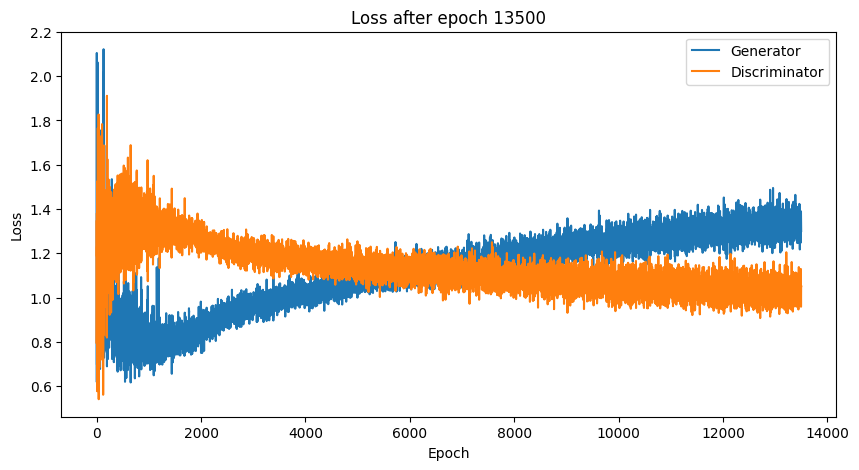

Time for epoch 13500 is 3.8107895851135254 sec
Time for epoch 13501 is 0.858661413192749 sec
Time for epoch 13502 is 0.8639724254608154 sec
Time for epoch 13503 is 0.8687717914581299 sec
Time for epoch 13504 is 0.8691155910491943 sec
Time for epoch 13505 is 0.8690197467803955 sec
Time for epoch 13506 is 0.8755660057067871 sec
Time for epoch 13507 is 0.881767749786377 sec
Time for epoch 13508 is 0.869426965713501 sec
Time for epoch 13509 is 0.8809971809387207 sec
Time for epoch 13510 is 0.8772146701812744 sec
Time for epoch 13511 is 0.8789980411529541 sec
Time for epoch 13512 is 0.8783600330352783 sec
Time for epoch 13513 is 0.8796792030334473 sec
Time for epoch 13514 is 0.8808019161224365 sec
Time for epoch 13515 is 0.8830246925354004 sec
Time for epoch 13516 is 0.8861055374145508 sec
Time for epoch 13517 is 0.8819243907928467 sec
Time for epoch 13518 is 0.8864541053771973 sec
Time for epoch 13519 is 0.881403923034668 sec
Time for epoch 13520 is 0.8851983547210693 sec
Time for epoch 13

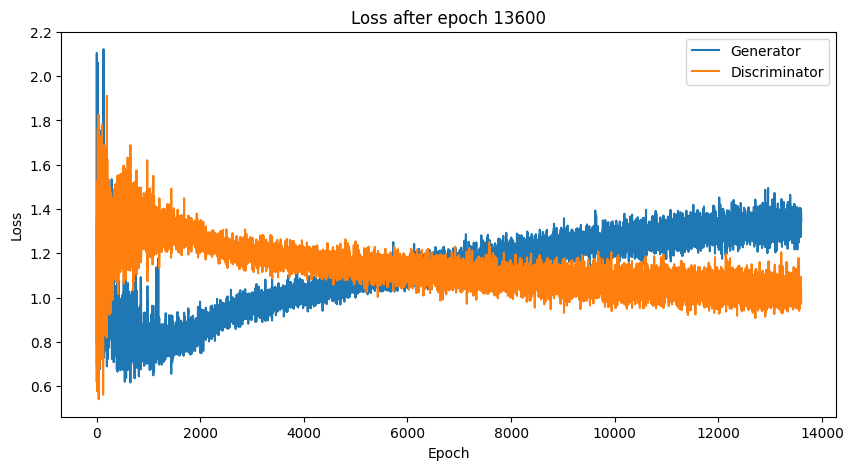

Time for epoch 13600 is 3.6319468021392822 sec
Time for epoch 13601 is 0.8540468215942383 sec
Time for epoch 13602 is 0.8663198947906494 sec
Time for epoch 13603 is 0.8688380718231201 sec
Time for epoch 13604 is 0.8744790554046631 sec
Time for epoch 13605 is 0.8724935054779053 sec
Time for epoch 13606 is 0.8744316101074219 sec
Time for epoch 13607 is 0.8784093856811523 sec
Time for epoch 13608 is 0.8793044090270996 sec
Time for epoch 13609 is 0.8740932941436768 sec
Time for epoch 13610 is 0.8806707859039307 sec
Time for epoch 13611 is 0.8799567222595215 sec
Time for epoch 13612 is 0.8821053504943848 sec
Time for epoch 13613 is 0.8825769424438477 sec
Time for epoch 13614 is 0.88303542137146 sec
Time for epoch 13615 is 0.8835186958312988 sec
Time for epoch 13616 is 0.8804521560668945 sec
Time for epoch 13617 is 0.8850827217102051 sec
Time for epoch 13618 is 0.8799445629119873 sec
Time for epoch 13619 is 0.8842566013336182 sec
Time for epoch 13620 is 0.8847925662994385 sec
Time for epoch 

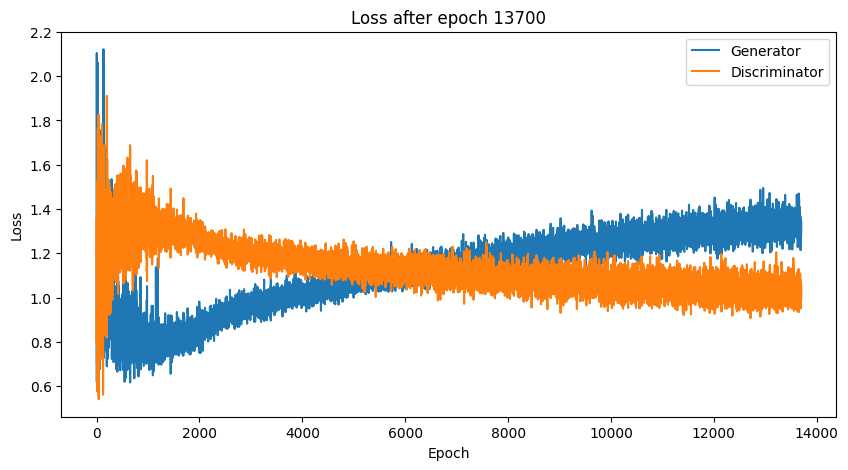

Time for epoch 13700 is 3.799459457397461 sec
Time for epoch 13701 is 0.8656022548675537 sec
Time for epoch 13702 is 0.8622732162475586 sec
Time for epoch 13703 is 0.8660545349121094 sec
Time for epoch 13704 is 0.8747849464416504 sec
Time for epoch 13705 is 0.8678951263427734 sec
Time for epoch 13706 is 0.8753435611724854 sec
Time for epoch 13707 is 0.8774611949920654 sec
Time for epoch 13708 is 0.8737261295318604 sec
Time for epoch 13709 is 0.8772366046905518 sec
Time for epoch 13710 is 0.8799748420715332 sec
Time for epoch 13711 is 0.8783376216888428 sec
Time for epoch 13712 is 0.8786115646362305 sec
Time for epoch 13713 is 0.8819756507873535 sec
Time for epoch 13714 is 0.8798835277557373 sec
Time for epoch 13715 is 0.8828129768371582 sec
Time for epoch 13716 is 0.8772001266479492 sec
Time for epoch 13717 is 0.8875529766082764 sec
Time for epoch 13718 is 0.8844547271728516 sec
Time for epoch 13719 is 0.8831417560577393 sec
Time for epoch 13720 is 0.8828239440917969 sec
Time for epoch

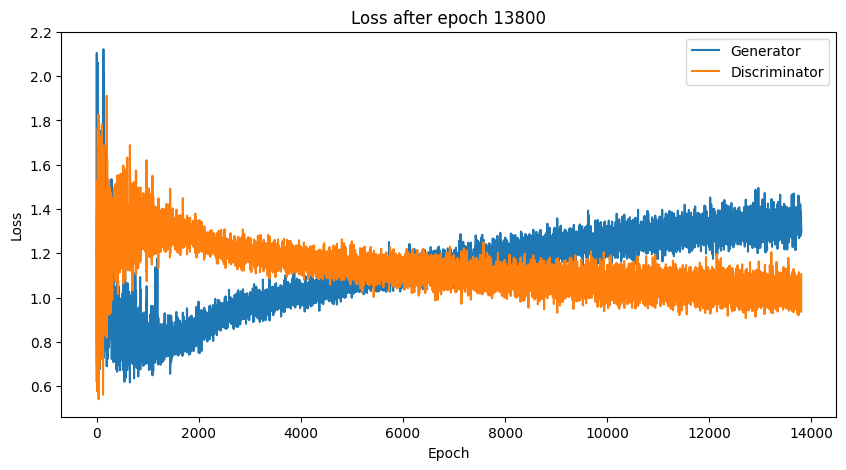

Time for epoch 13800 is 3.7999300956726074 sec
Time for epoch 13801 is 0.8554470539093018 sec
Time for epoch 13802 is 0.8652243614196777 sec
Time for epoch 13803 is 0.8745436668395996 sec
Time for epoch 13804 is 0.8693892955780029 sec
Time for epoch 13805 is 0.8714461326599121 sec
Time for epoch 13806 is 0.874636173248291 sec
Time for epoch 13807 is 0.8821377754211426 sec
Time for epoch 13808 is 0.8799042701721191 sec
Time for epoch 13809 is 0.8763959407806396 sec
Time for epoch 13810 is 0.880183219909668 sec
Time for epoch 13811 is 0.8806650638580322 sec
Time for epoch 13812 is 0.8786680698394775 sec
Time for epoch 13813 is 0.8757529258728027 sec
Time for epoch 13814 is 0.8838708400726318 sec
Time for epoch 13815 is 0.8833565711975098 sec
Time for epoch 13816 is 0.8831334114074707 sec
Time for epoch 13817 is 0.8792018890380859 sec
Time for epoch 13818 is 0.8816795349121094 sec
Time for epoch 13819 is 0.8828208446502686 sec
Time for epoch 13820 is 0.8813161849975586 sec
Time for epoch 

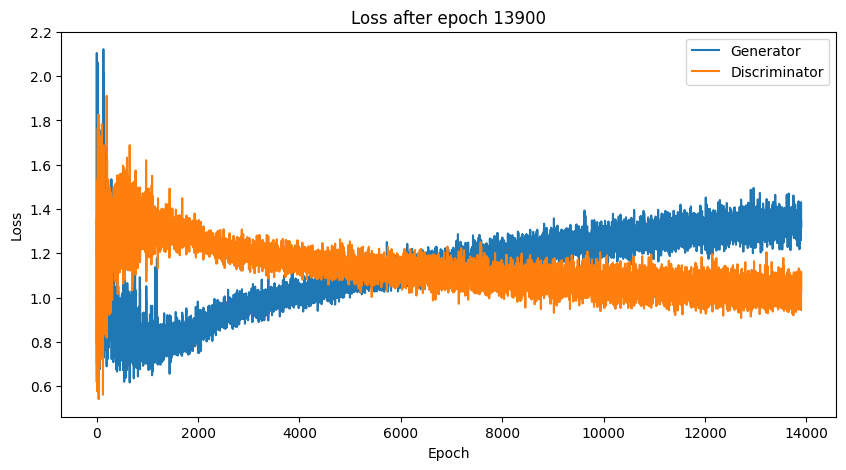

Time for epoch 13900 is 3.799283027648926 sec
Time for epoch 13901 is 0.8614153861999512 sec
Time for epoch 13902 is 0.8629806041717529 sec
Time for epoch 13903 is 0.8714761734008789 sec
Time for epoch 13904 is 0.8692402839660645 sec
Time for epoch 13905 is 0.8735880851745605 sec
Time for epoch 13906 is 0.8710639476776123 sec
Time for epoch 13907 is 0.8728735446929932 sec
Time for epoch 13908 is 0.8778018951416016 sec
Time for epoch 13909 is 0.8751029968261719 sec
Time for epoch 13910 is 0.8796427249908447 sec
Time for epoch 13911 is 0.8787209987640381 sec
Time for epoch 13912 is 0.8852519989013672 sec
Time for epoch 13913 is 0.8831460475921631 sec
Time for epoch 13914 is 0.8776450157165527 sec
Time for epoch 13915 is 0.884117841720581 sec
Time for epoch 13916 is 0.8767032623291016 sec
Time for epoch 13917 is 0.8872733116149902 sec
Time for epoch 13918 is 0.880671501159668 sec
Time for epoch 13919 is 0.8814413547515869 sec
Time for epoch 13920 is 0.888416051864624 sec
Time for epoch 13

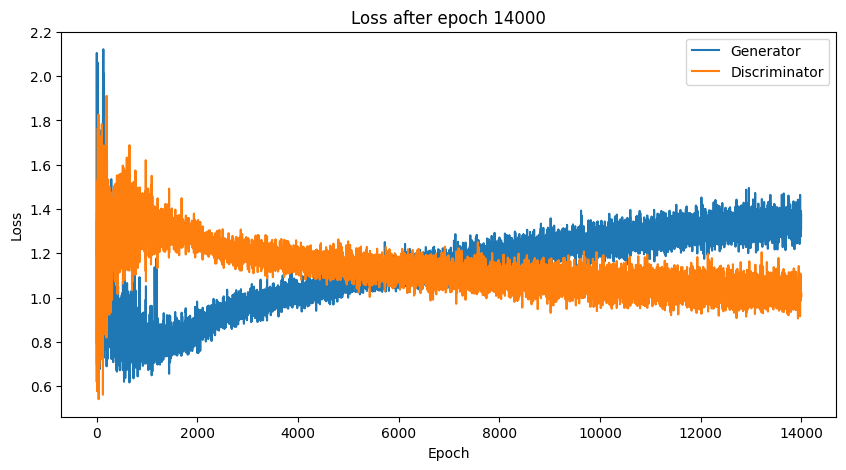

Time for epoch 14000 is 3.807725191116333 sec
Time for epoch 14001 is 0.8468513488769531 sec
Time for epoch 14002 is 0.8683600425720215 sec
Time for epoch 14003 is 0.8666479587554932 sec
Time for epoch 14004 is 0.8745732307434082 sec
Time for epoch 14005 is 0.8750407695770264 sec
Time for epoch 14006 is 0.881422758102417 sec
Time for epoch 14007 is 0.8722677230834961 sec
Time for epoch 14008 is 0.8780102729797363 sec
Time for epoch 14009 is 0.8825485706329346 sec
Time for epoch 14010 is 0.874711275100708 sec
Time for epoch 14011 is 0.880744218826294 sec
Time for epoch 14012 is 0.8816330432891846 sec
Time for epoch 14013 is 0.8814809322357178 sec
Time for epoch 14014 is 0.8794476985931396 sec
Time for epoch 14015 is 0.880258321762085 sec
Time for epoch 14016 is 0.8839876651763916 sec
Time for epoch 14017 is 0.8836264610290527 sec
Time for epoch 14018 is 0.8803915977478027 sec
Time for epoch 14019 is 0.8842153549194336 sec
Time for epoch 14020 is 0.8858883380889893 sec
Time for epoch 140

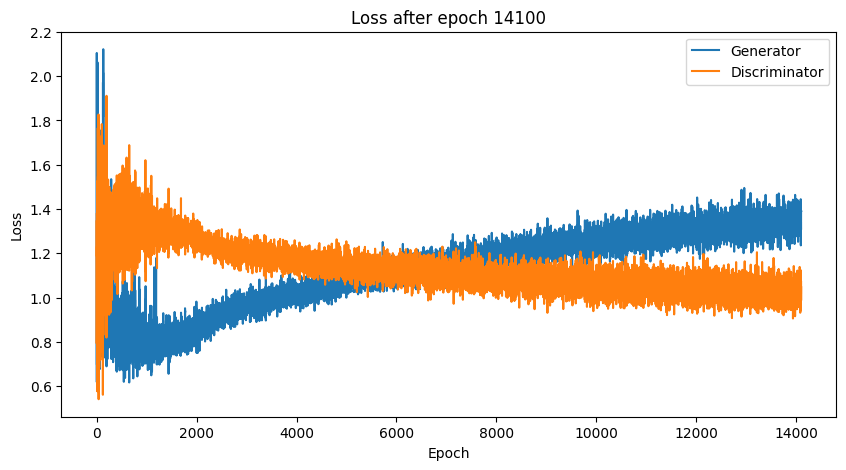

Time for epoch 14100 is 3.6292381286621094 sec
Time for epoch 14101 is 0.8624303340911865 sec
Time for epoch 14102 is 0.8631460666656494 sec
Time for epoch 14103 is 0.8683023452758789 sec
Time for epoch 14104 is 0.8730995655059814 sec
Time for epoch 14105 is 0.8737542629241943 sec
Time for epoch 14106 is 0.8752262592315674 sec
Time for epoch 14107 is 0.873638391494751 sec
Time for epoch 14108 is 0.87636399269104 sec
Time for epoch 14109 is 0.8797225952148438 sec
Time for epoch 14110 is 0.8761985301971436 sec
Time for epoch 14111 is 0.8765280246734619 sec
Time for epoch 14112 is 0.8822295665740967 sec
Time for epoch 14113 is 0.8804492950439453 sec
Time for epoch 14114 is 0.8805527687072754 sec
Time for epoch 14115 is 0.882957935333252 sec
Time for epoch 14116 is 0.8808515071868896 sec
Time for epoch 14117 is 0.8808088302612305 sec
Time for epoch 14118 is 0.8812954425811768 sec
Time for epoch 14119 is 0.8847827911376953 sec
Time for epoch 14120 is 0.8833601474761963 sec
Time for epoch 14

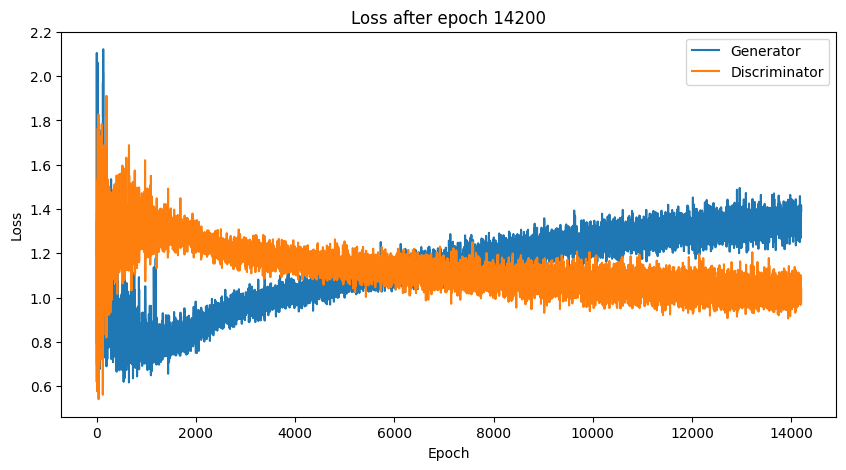

Time for epoch 14200 is 3.784759283065796 sec
Time for epoch 14201 is 0.8636379241943359 sec
Time for epoch 14202 is 0.862138032913208 sec
Time for epoch 14203 is 0.8693633079528809 sec
Time for epoch 14204 is 0.8695669174194336 sec
Time for epoch 14205 is 0.8698368072509766 sec
Time for epoch 14206 is 0.878781795501709 sec
Time for epoch 14207 is 0.8733103275299072 sec
Time for epoch 14208 is 0.8750650882720947 sec
Time for epoch 14209 is 0.8840816020965576 sec
Time for epoch 14210 is 0.8793351650238037 sec
Time for epoch 14211 is 0.8783149719238281 sec
Time for epoch 14212 is 0.8776340484619141 sec
Time for epoch 14213 is 0.8815984725952148 sec
Time for epoch 14214 is 0.8790380954742432 sec
Time for epoch 14215 is 0.8776233196258545 sec
Time for epoch 14216 is 0.8846347332000732 sec
Time for epoch 14217 is 0.8830256462097168 sec
Time for epoch 14218 is 0.8795173168182373 sec
Time for epoch 14219 is 0.882972002029419 sec
Time for epoch 14220 is 0.881676197052002 sec
Time for epoch 142

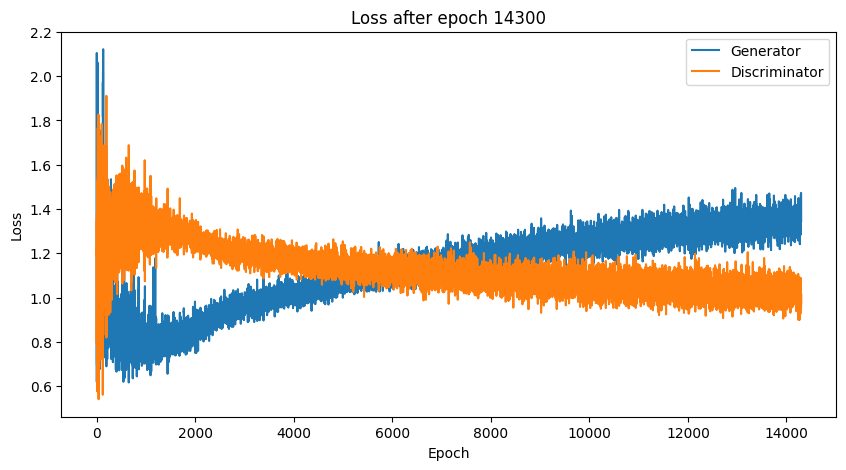

Time for epoch 14300 is 3.807905673980713 sec
Time for epoch 14301 is 0.8612785339355469 sec
Time for epoch 14302 is 0.861853837966919 sec
Time for epoch 14303 is 0.8669440746307373 sec
Time for epoch 14304 is 0.8690891265869141 sec
Time for epoch 14305 is 0.8704254627227783 sec
Time for epoch 14306 is 0.8728365898132324 sec
Time for epoch 14307 is 0.8760225772857666 sec
Time for epoch 14308 is 0.8801190853118896 sec
Time for epoch 14309 is 0.8767416477203369 sec
Time for epoch 14310 is 0.8803515434265137 sec
Time for epoch 14311 is 0.876086950302124 sec
Time for epoch 14312 is 0.8802938461303711 sec
Time for epoch 14313 is 0.8790357112884521 sec
Time for epoch 14314 is 0.8776614665985107 sec
Time for epoch 14315 is 0.882317304611206 sec
Time for epoch 14316 is 0.8808369636535645 sec
Time for epoch 14317 is 0.8869588375091553 sec
Time for epoch 14318 is 0.8779435157775879 sec
Time for epoch 14319 is 0.8857393264770508 sec
Time for epoch 14320 is 0.8822894096374512 sec
Time for epoch 14

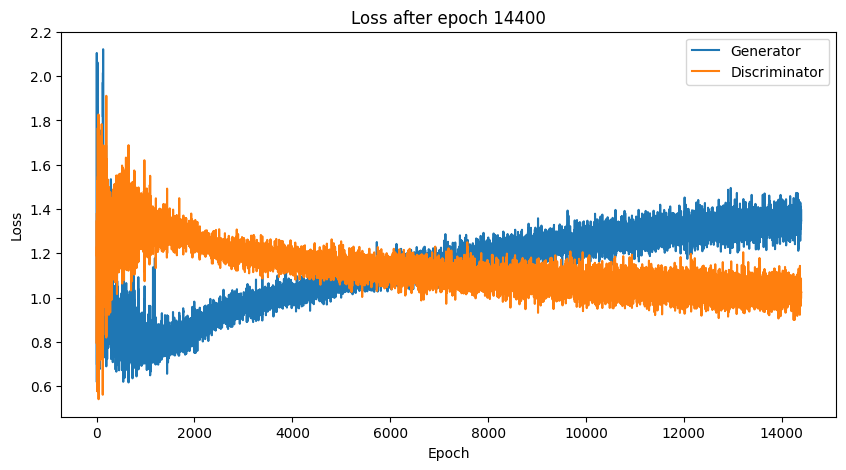

Time for epoch 14400 is 3.8346235752105713 sec
Time for epoch 14401 is 0.862375020980835 sec
Time for epoch 14402 is 0.856848955154419 sec
Time for epoch 14403 is 0.8666319847106934 sec
Time for epoch 14404 is 0.8731474876403809 sec
Time for epoch 14405 is 0.8756353855133057 sec
Time for epoch 14406 is 0.8773784637451172 sec
Time for epoch 14407 is 0.8765270709991455 sec
Time for epoch 14408 is 0.8706300258636475 sec
Time for epoch 14409 is 0.8753445148468018 sec
Time for epoch 14410 is 0.875807523727417 sec
Time for epoch 14411 is 0.8787636756896973 sec
Time for epoch 14412 is 0.8793127536773682 sec
Time for epoch 14413 is 0.8823299407958984 sec
Time for epoch 14414 is 0.8785099983215332 sec
Time for epoch 14415 is 0.8783140182495117 sec
Time for epoch 14416 is 0.8786885738372803 sec
Time for epoch 14417 is 0.882979154586792 sec
Time for epoch 14418 is 0.8801858425140381 sec
Time for epoch 14419 is 0.8821804523468018 sec
Time for epoch 14420 is 0.8821713924407959 sec
Time for epoch 14

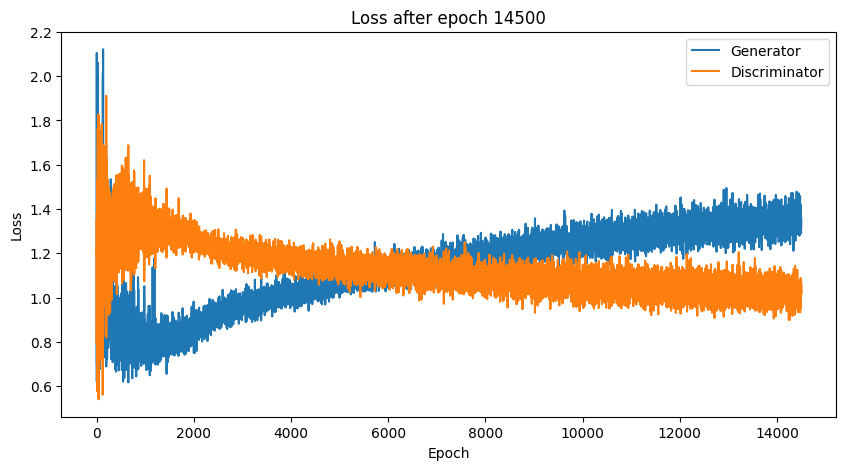

Time for epoch 14500 is 3.8398425579071045 sec
Time for epoch 14501 is 0.8587384223937988 sec
Time for epoch 14502 is 0.863100528717041 sec
Time for epoch 14503 is 0.8683109283447266 sec
Time for epoch 14504 is 0.8693325519561768 sec
Time for epoch 14505 is 0.8725929260253906 sec
Time for epoch 14506 is 0.8757402896881104 sec
Time for epoch 14507 is 0.8734924793243408 sec
Time for epoch 14508 is 0.8752481937408447 sec
Time for epoch 14509 is 0.8787984848022461 sec
Time for epoch 14510 is 0.8724009990692139 sec
Time for epoch 14511 is 0.8782460689544678 sec
Time for epoch 14512 is 0.8736870288848877 sec
Time for epoch 14513 is 0.8813605308532715 sec
Time for epoch 14514 is 0.8802773952484131 sec
Time for epoch 14515 is 0.8746068477630615 sec
Time for epoch 14516 is 0.8876948356628418 sec
Time for epoch 14517 is 0.8789787292480469 sec
Time for epoch 14518 is 0.8840370178222656 sec
Time for epoch 14519 is 0.886035680770874 sec
Time for epoch 14520 is 0.8893928527832031 sec
Time for epoch 

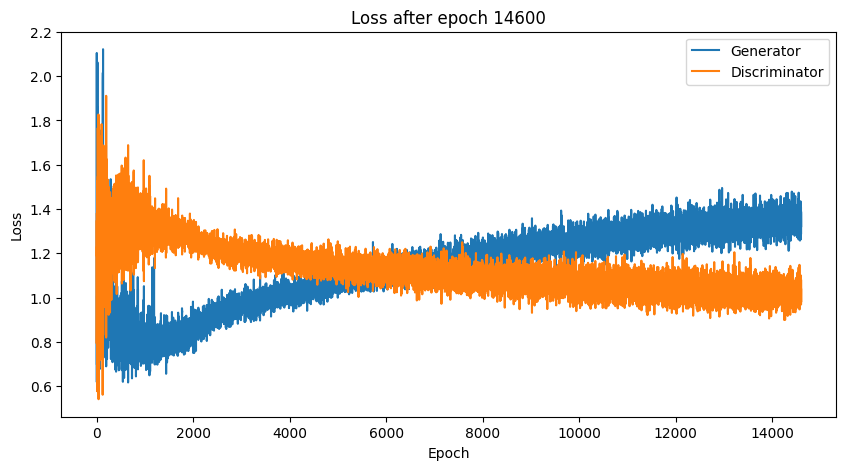

Time for epoch 14600 is 3.6544206142425537 sec
Time for epoch 14601 is 0.8589997291564941 sec
Time for epoch 14602 is 0.8619163036346436 sec
Time for epoch 14603 is 0.864516019821167 sec
Time for epoch 14604 is 1.263244867324829 sec
Time for epoch 14605 is 0.858196496963501 sec
Time for epoch 14606 is 0.8754861354827881 sec
Time for epoch 14607 is 0.8683764934539795 sec
Time for epoch 14608 is 0.8820161819458008 sec
Time for epoch 14609 is 0.8766942024230957 sec
Time for epoch 14610 is 0.8712515830993652 sec
Time for epoch 14611 is 0.87666916847229 sec
Time for epoch 14612 is 0.8776021003723145 sec
Time for epoch 14613 is 0.8774399757385254 sec
Time for epoch 14614 is 0.8825891017913818 sec
Time for epoch 14615 is 0.8801412582397461 sec
Time for epoch 14616 is 0.8774716854095459 sec
Time for epoch 14617 is 0.8802523612976074 sec
Time for epoch 14618 is 0.8831660747528076 sec
Time for epoch 14619 is 0.8804161548614502 sec
Time for epoch 14620 is 0.8817102909088135 sec
Time for epoch 146

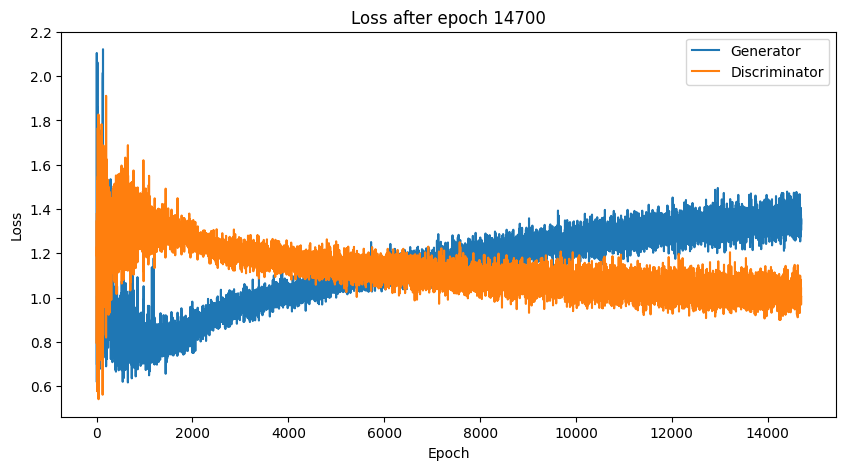

Time for epoch 14700 is 3.6221542358398438 sec
Time for epoch 14701 is 0.8752961158752441 sec
Time for epoch 14702 is 0.8665037155151367 sec
Time for epoch 14703 is 0.8624465465545654 sec
Time for epoch 14704 is 0.8697683811187744 sec
Time for epoch 14705 is 0.8716473579406738 sec
Time for epoch 14706 is 0.8757905960083008 sec
Time for epoch 14707 is 0.8762094974517822 sec
Time for epoch 14708 is 0.8805160522460938 sec
Time for epoch 14709 is 0.8795158863067627 sec
Time for epoch 14710 is 0.8789710998535156 sec
Time for epoch 14711 is 0.8779473304748535 sec
Time for epoch 14712 is 0.8792219161987305 sec
Time for epoch 14713 is 0.8779075145721436 sec
Time for epoch 14714 is 0.8771567344665527 sec
Time for epoch 14715 is 0.8848211765289307 sec
Time for epoch 14716 is 0.8780689239501953 sec
Time for epoch 14717 is 0.884087324142456 sec
Time for epoch 14718 is 0.8815863132476807 sec
Time for epoch 14719 is 0.8817493915557861 sec
Time for epoch 14720 is 0.880486249923706 sec
Time for epoch 

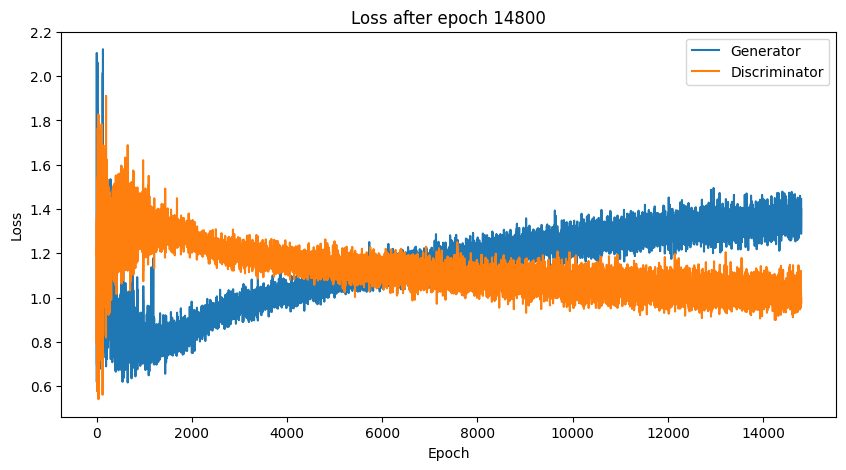

Time for epoch 14800 is 3.8538506031036377 sec
Time for epoch 14801 is 0.8601937294006348 sec
Time for epoch 14802 is 0.8640680313110352 sec
Time for epoch 14803 is 0.8651559352874756 sec
Time for epoch 14804 is 0.8756237030029297 sec
Time for epoch 14805 is 0.8679013252258301 sec
Time for epoch 14806 is 0.8720619678497314 sec
Time for epoch 14807 is 0.8773605823516846 sec
Time for epoch 14808 is 0.8755941390991211 sec
Time for epoch 14809 is 0.8729913234710693 sec
Time for epoch 14810 is 0.8751060962677002 sec
Time for epoch 14811 is 0.8809282779693604 sec
Time for epoch 14812 is 0.877586841583252 sec
Time for epoch 14813 is 0.8883092403411865 sec
Time for epoch 14814 is 0.877387285232544 sec
Time for epoch 14815 is 0.880488395690918 sec
Time for epoch 14816 is 0.8856322765350342 sec
Time for epoch 14817 is 0.8790860176086426 sec
Time for epoch 14818 is 0.8859541416168213 sec
Time for epoch 14819 is 0.882704496383667 sec
Time for epoch 14820 is 0.8850834369659424 sec
Time for epoch 14

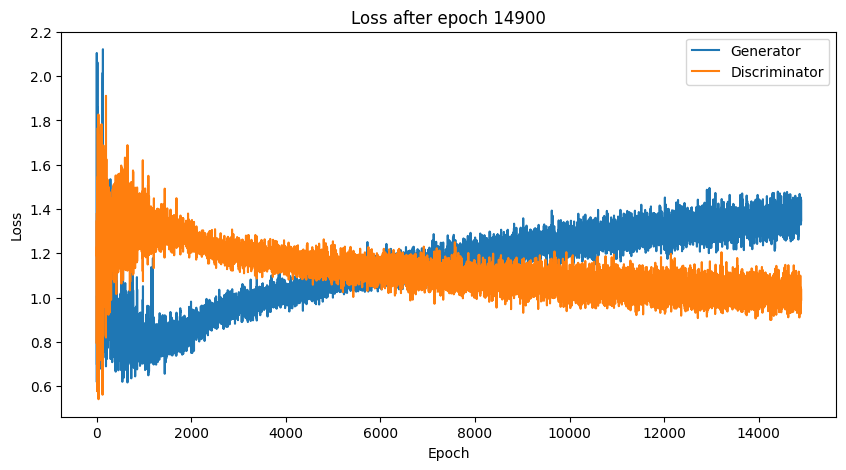

Time for epoch 14900 is 3.8149092197418213 sec
Time for epoch 14901 is 0.859309196472168 sec
Time for epoch 14902 is 0.8634626865386963 sec
Time for epoch 14903 is 0.8615636825561523 sec
Time for epoch 14904 is 0.8691442012786865 sec
Time for epoch 14905 is 0.8723535537719727 sec
Time for epoch 14906 is 0.873375654220581 sec
Time for epoch 14907 is 0.873943567276001 sec
Time for epoch 14908 is 0.8781204223632812 sec
Time for epoch 14909 is 0.8739368915557861 sec
Time for epoch 14910 is 0.8758382797241211 sec
Time for epoch 14911 is 0.8758625984191895 sec
Time for epoch 14912 is 0.8805201053619385 sec
Time for epoch 14913 is 0.8741593360900879 sec
Time for epoch 14914 is 0.8833034038543701 sec
Time for epoch 14915 is 0.8803961277008057 sec
Time for epoch 14916 is 0.881596565246582 sec
Time for epoch 14917 is 0.8800320625305176 sec
Time for epoch 14918 is 0.8824539184570312 sec
Time for epoch 14919 is 0.8843832015991211 sec
Time for epoch 14920 is 0.8793456554412842 sec
Time for epoch 14

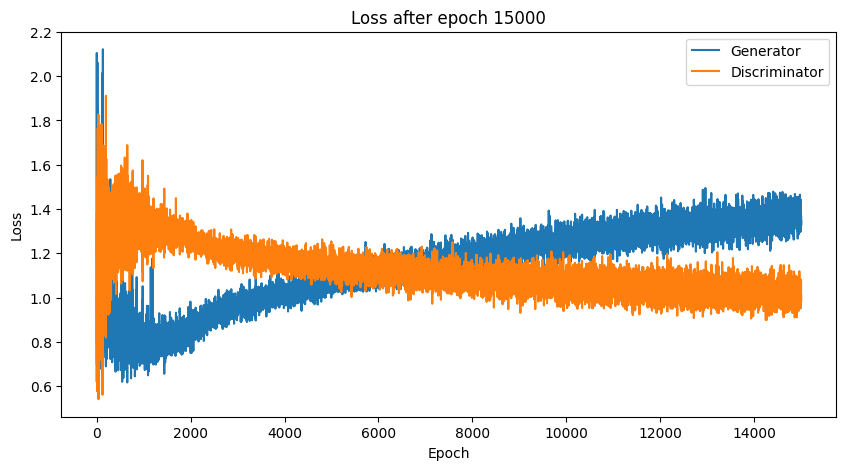

Time for epoch 15000 is 3.889709711074829 sec
Time for epoch 15001 is 0.859513521194458 sec
Time for epoch 15002 is 0.8605201244354248 sec
Time for epoch 15003 is 0.8707790374755859 sec
Time for epoch 15004 is 0.8695483207702637 sec
Time for epoch 15005 is 0.8744959831237793 sec
Time for epoch 15006 is 0.8703067302703857 sec
Time for epoch 15007 is 0.8740975856781006 sec
Time for epoch 15008 is 0.8773791790008545 sec
Time for epoch 15009 is 0.8757367134094238 sec
Time for epoch 15010 is 0.8722422122955322 sec
Time for epoch 15011 is 0.8795568943023682 sec
Time for epoch 15012 is 0.8740131855010986 sec
Time for epoch 15013 is 0.8809349536895752 sec
Time for epoch 15014 is 0.8801171779632568 sec
Time for epoch 15015 is 0.8755669593811035 sec
Time for epoch 15016 is 0.8842775821685791 sec
Time for epoch 15017 is 0.8806416988372803 sec
Time for epoch 15018 is 0.8834981918334961 sec
Time for epoch 15019 is 0.8752994537353516 sec
Time for epoch 15020 is 0.8843724727630615 sec
Time for epoch 

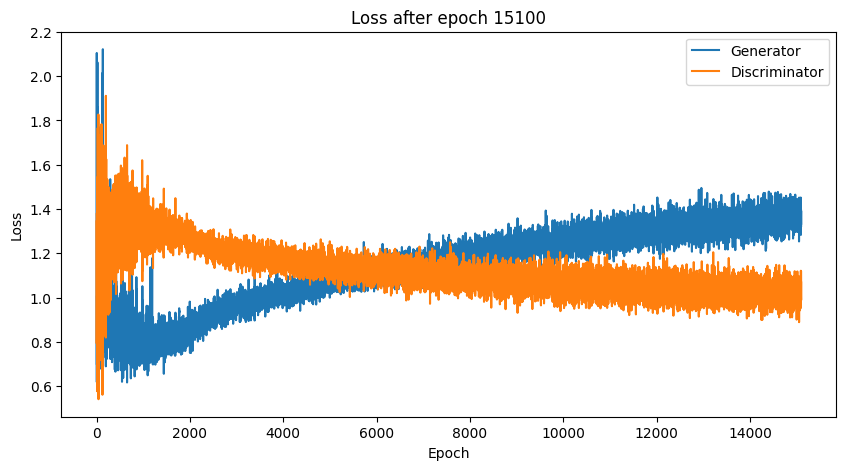

Time for epoch 15100 is 3.818740129470825 sec
Time for epoch 15101 is 0.8505117893218994 sec
Time for epoch 15102 is 0.8649358749389648 sec
Time for epoch 15103 is 0.8702521324157715 sec
Time for epoch 15104 is 0.8704605102539062 sec
Time for epoch 15105 is 0.8713383674621582 sec
Time for epoch 15106 is 0.8798024654388428 sec
Time for epoch 15107 is 0.8773219585418701 sec
Time for epoch 15108 is 0.8751952648162842 sec
Time for epoch 15109 is 0.8793861865997314 sec
Time for epoch 15110 is 0.8810663223266602 sec
Time for epoch 15111 is 0.8750646114349365 sec
Time for epoch 15112 is 0.87782883644104 sec
Time for epoch 15113 is 0.8782434463500977 sec
Time for epoch 15114 is 0.8820695877075195 sec
Time for epoch 15115 is 0.8825304508209229 sec
Time for epoch 15116 is 0.8846092224121094 sec
Time for epoch 15117 is 0.8796112537384033 sec
Time for epoch 15118 is 0.8812944889068604 sec
Time for epoch 15119 is 0.8815195560455322 sec
Time for epoch 15120 is 0.8828763961791992 sec
Time for epoch 1

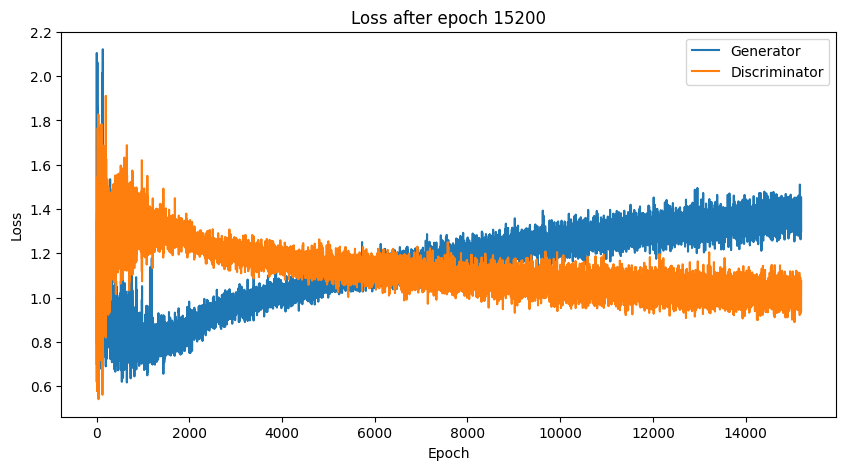

Time for epoch 15200 is 3.6643457412719727 sec
Time for epoch 15201 is 0.8532166481018066 sec
Time for epoch 15202 is 0.8584115505218506 sec
Time for epoch 15203 is 0.8719894886016846 sec
Time for epoch 15204 is 0.8662610054016113 sec
Time for epoch 15205 is 0.8726241588592529 sec
Time for epoch 15206 is 0.8737242221832275 sec
Time for epoch 15207 is 0.8782563209533691 sec
Time for epoch 15208 is 0.8763680458068848 sec
Time for epoch 15209 is 0.875819206237793 sec
Time for epoch 15210 is 0.8771188259124756 sec
Time for epoch 15211 is 0.8768322467803955 sec
Time for epoch 15212 is 0.8754720687866211 sec
Time for epoch 15213 is 0.878767728805542 sec
Time for epoch 15214 is 0.8808424472808838 sec
Time for epoch 15215 is 0.8825476169586182 sec
Time for epoch 15216 is 0.8796000480651855 sec
Time for epoch 15217 is 0.8835597038269043 sec
Time for epoch 15218 is 0.8815150260925293 sec
Time for epoch 15219 is 0.8800456523895264 sec
Time for epoch 15220 is 0.8834037780761719 sec
Time for epoch 

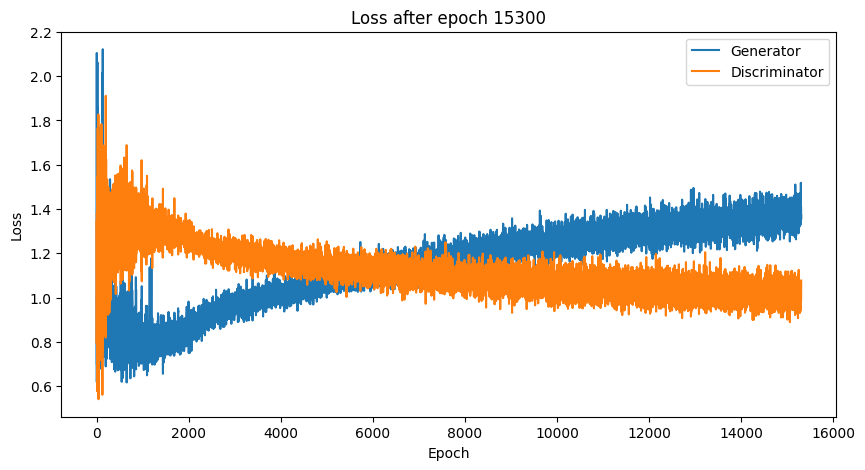

Time for epoch 15300 is 3.823758363723755 sec
Time for epoch 15301 is 0.8491685390472412 sec
Time for epoch 15302 is 0.8664636611938477 sec
Time for epoch 15303 is 0.8659789562225342 sec
Time for epoch 15304 is 0.8722434043884277 sec
Time for epoch 15305 is 0.8735783100128174 sec
Time for epoch 15306 is 0.8719983100891113 sec
Time for epoch 15307 is 0.8784410953521729 sec
Time for epoch 15308 is 0.8723676204681396 sec
Time for epoch 15309 is 0.8725776672363281 sec
Time for epoch 15310 is 0.8780548572540283 sec
Time for epoch 15311 is 0.8776185512542725 sec
Time for epoch 15312 is 0.8780248165130615 sec
Time for epoch 15313 is 0.874758243560791 sec
Time for epoch 15314 is 0.8842160701751709 sec
Time for epoch 15315 is 0.8782403469085693 sec
Time for epoch 15316 is 0.8786818981170654 sec
Time for epoch 15317 is 0.8815882205963135 sec
Time for epoch 15318 is 0.8835904598236084 sec
Time for epoch 15319 is 0.8813135623931885 sec
Time for epoch 15320 is 0.8819324970245361 sec
Time for epoch 

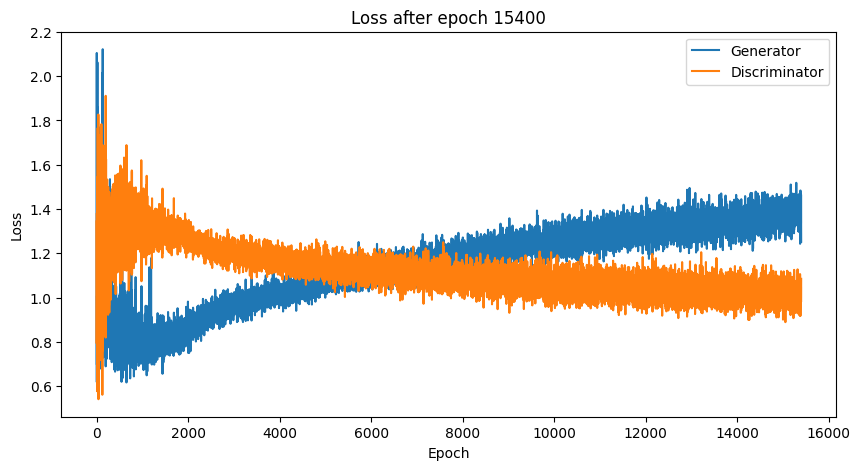

Time for epoch 15400 is 3.8648781776428223 sec
Time for epoch 15401 is 0.8696601390838623 sec
Time for epoch 15402 is 0.8623313903808594 sec
Time for epoch 15403 is 0.8650860786437988 sec
Time for epoch 15404 is 0.8647725582122803 sec
Time for epoch 15405 is 0.8722097873687744 sec
Time for epoch 15406 is 0.8692066669464111 sec
Time for epoch 15407 is 0.8751626014709473 sec
Time for epoch 15408 is 0.8755044937133789 sec
Time for epoch 15409 is 0.8737564086914062 sec
Time for epoch 15410 is 0.8771271705627441 sec
Time for epoch 15411 is 0.8754673004150391 sec
Time for epoch 15412 is 0.8785006999969482 sec
Time for epoch 15413 is 0.8794317245483398 sec
Time for epoch 15414 is 0.8776097297668457 sec
Time for epoch 15415 is 0.8792707920074463 sec
Time for epoch 15416 is 0.8806004524230957 sec
Time for epoch 15417 is 0.8801562786102295 sec
Time for epoch 15418 is 0.8843517303466797 sec
Time for epoch 15419 is 0.8832910060882568 sec
Time for epoch 15420 is 0.8812994956970215 sec
Time for epoc

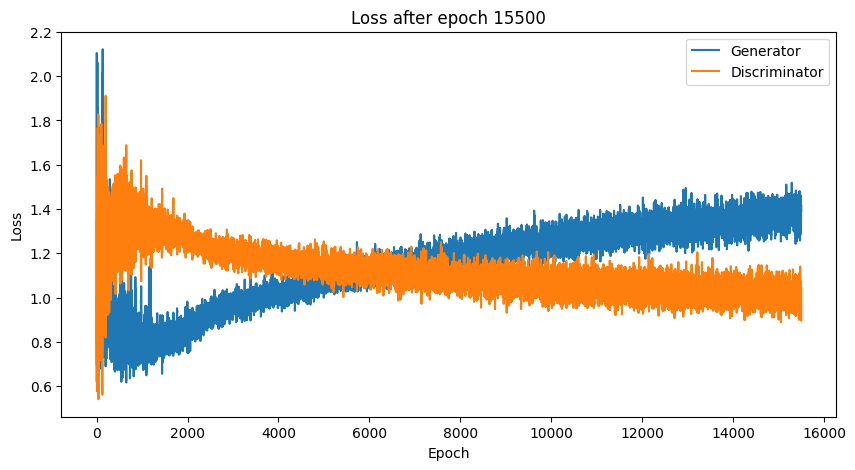

Time for epoch 15500 is 3.8706700801849365 sec
Time for epoch 15501 is 0.8573739528656006 sec
Time for epoch 15502 is 0.86604905128479 sec
Time for epoch 15503 is 0.8709077835083008 sec
Time for epoch 15504 is 0.8629682064056396 sec
Time for epoch 15505 is 0.8727107048034668 sec
Time for epoch 15506 is 0.8749580383300781 sec
Time for epoch 15507 is 0.8707973957061768 sec
Time for epoch 15508 is 0.8759489059448242 sec
Time for epoch 15509 is 0.8785407543182373 sec
Time for epoch 15510 is 0.8806033134460449 sec
Time for epoch 15511 is 0.8766674995422363 sec
Time for epoch 15512 is 0.8783001899719238 sec
Time for epoch 15513 is 0.8818814754486084 sec
Time for epoch 15514 is 0.8797779083251953 sec
Time for epoch 15515 is 0.8783383369445801 sec
Time for epoch 15516 is 0.8796627521514893 sec
Time for epoch 15517 is 0.8819646835327148 sec
Time for epoch 15518 is 0.8858907222747803 sec
Time for epoch 15519 is 0.8803434371948242 sec
Time for epoch 15520 is 0.8814966678619385 sec
Time for epoch 

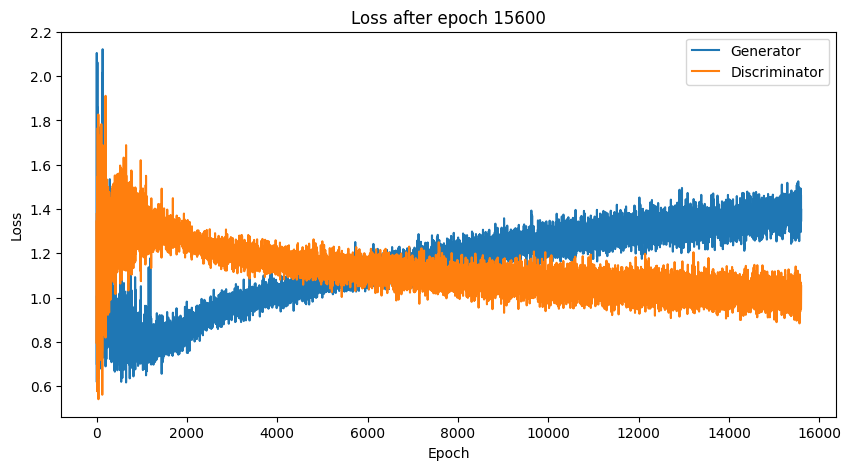

Time for epoch 15600 is 3.8198118209838867 sec
Time for epoch 15601 is 0.8614745140075684 sec
Time for epoch 15602 is 0.8665266036987305 sec
Time for epoch 15603 is 0.8622493743896484 sec
Time for epoch 15604 is 0.8680872917175293 sec
Time for epoch 15605 is 0.8752269744873047 sec
Time for epoch 15606 is 0.872525691986084 sec
Time for epoch 15607 is 0.8757350444793701 sec
Time for epoch 15608 is 0.8740313053131104 sec
Time for epoch 15609 is 0.8726248741149902 sec
Time for epoch 15610 is 0.8775627613067627 sec
Time for epoch 15611 is 0.8816604614257812 sec
Time for epoch 15612 is 0.8781757354736328 sec
Time for epoch 15613 is 0.8769638538360596 sec
Time for epoch 15614 is 0.880756139755249 sec
Time for epoch 15615 is 0.8777239322662354 sec
Time for epoch 15616 is 0.8817524909973145 sec
Time for epoch 15617 is 0.879281759262085 sec
Time for epoch 15618 is 0.8849613666534424 sec
Time for epoch 15619 is 0.8812727928161621 sec
Time for epoch 15620 is 0.8830091953277588 sec
Time for epoch 1

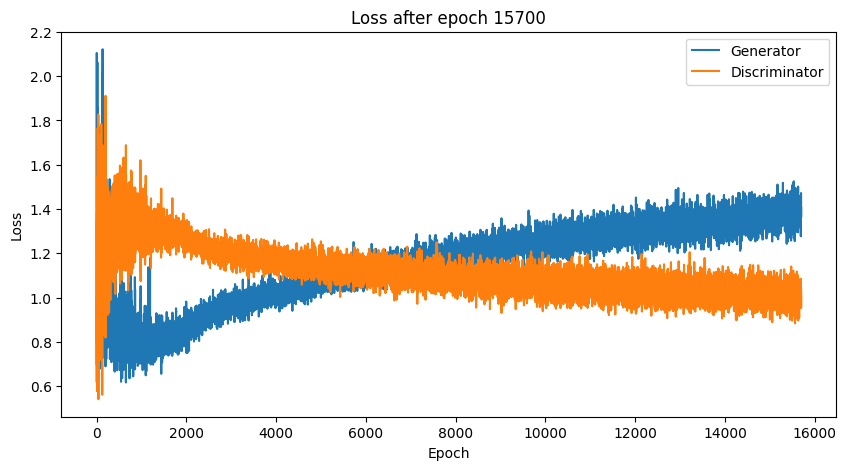

Time for epoch 15700 is 3.8880717754364014 sec
Time for epoch 15701 is 0.858182430267334 sec
Time for epoch 15702 is 0.8645286560058594 sec
Time for epoch 15703 is 0.8649420738220215 sec
Time for epoch 15704 is 0.8657546043395996 sec
Time for epoch 15705 is 0.8733553886413574 sec
Time for epoch 15706 is 0.8726365566253662 sec
Time for epoch 15707 is 0.8789224624633789 sec
Time for epoch 15708 is 0.8760449886322021 sec
Time for epoch 15709 is 0.874445915222168 sec
Time for epoch 15710 is 0.8793210983276367 sec
Time for epoch 15711 is 0.8750228881835938 sec
Time for epoch 15712 is 0.8787267208099365 sec
Time for epoch 15713 is 0.8786797523498535 sec
Time for epoch 15714 is 0.8852722644805908 sec
Time for epoch 15715 is 0.8835651874542236 sec
Time for epoch 15716 is 0.8805832862854004 sec
Time for epoch 15717 is 0.8836722373962402 sec
Time for epoch 15718 is 0.8804686069488525 sec
Time for epoch 15719 is 0.8802597522735596 sec
Time for epoch 15720 is 0.8822803497314453 sec
Time for epoch 

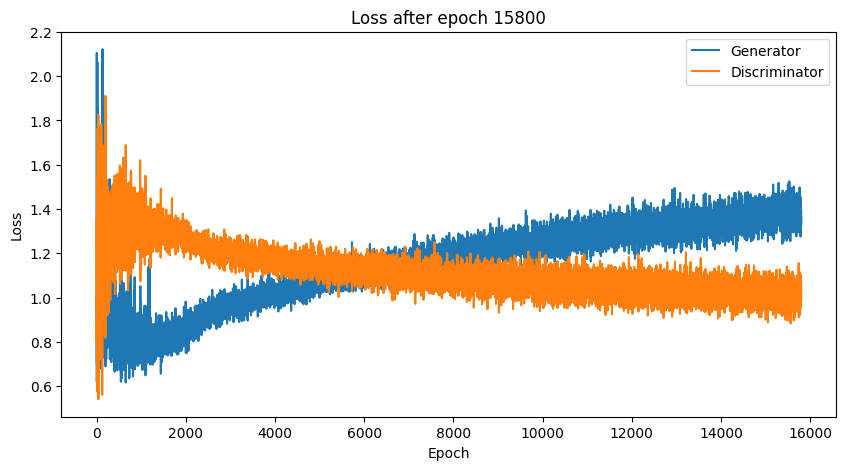

Time for epoch 15800 is 3.6450109481811523 sec
Time for epoch 15801 is 0.8543825149536133 sec
Time for epoch 15802 is 0.8661589622497559 sec
Time for epoch 15803 is 0.8681676387786865 sec
Time for epoch 15804 is 0.8687911033630371 sec
Time for epoch 15805 is 0.8747317790985107 sec
Time for epoch 15806 is 0.8772761821746826 sec
Time for epoch 15807 is 0.8758807182312012 sec
Time for epoch 15808 is 0.8765087127685547 sec
Time for epoch 15809 is 0.8761849403381348 sec
Time for epoch 15810 is 0.8780972957611084 sec
Time for epoch 15811 is 0.8785688877105713 sec
Time for epoch 15812 is 0.8776397705078125 sec
Time for epoch 15813 is 0.8759477138519287 sec
Time for epoch 15814 is 0.8832612037658691 sec
Time for epoch 15815 is 0.8813536167144775 sec
Time for epoch 15816 is 0.8791782855987549 sec
Time for epoch 15817 is 0.8808803558349609 sec
Time for epoch 15818 is 0.8861634731292725 sec
Time for epoch 15819 is 0.8803620338439941 sec
Time for epoch 15820 is 0.8825469017028809 sec
Time for epoc

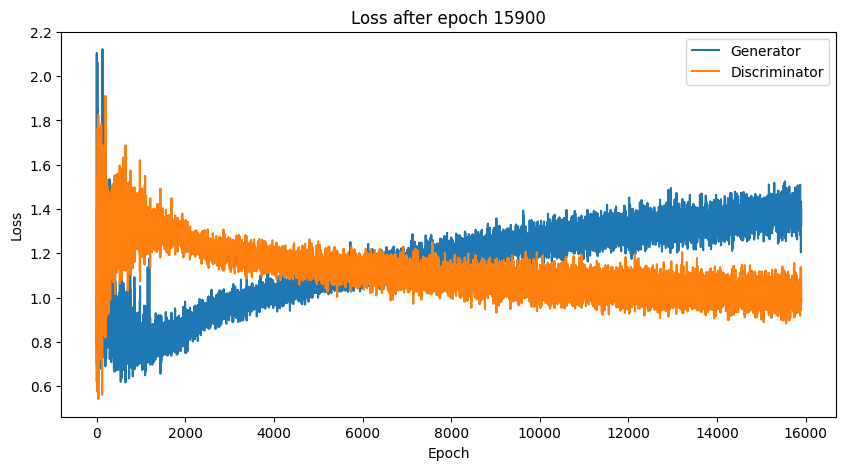

Time for epoch 15900 is 3.884326219558716 sec
Time for epoch 15901 is 0.849048376083374 sec
Time for epoch 15902 is 0.8627660274505615 sec
Time for epoch 15903 is 0.8625824451446533 sec
Time for epoch 15904 is 0.8691544532775879 sec
Time for epoch 15905 is 0.8656811714172363 sec
Time for epoch 15906 is 0.872183084487915 sec
Time for epoch 15907 is 0.8761961460113525 sec
Time for epoch 15908 is 0.8698618412017822 sec
Time for epoch 15909 is 0.8765342235565186 sec
Time for epoch 15910 is 0.8787636756896973 sec
Time for epoch 15911 is 0.87754225730896 sec
Time for epoch 15912 is 0.8742482662200928 sec
Time for epoch 15913 is 0.8820922374725342 sec
Time for epoch 15914 is 0.880068302154541 sec
Time for epoch 15915 is 0.8791062831878662 sec
Time for epoch 15916 is 0.8795058727264404 sec
Time for epoch 15917 is 0.8828039169311523 sec
Time for epoch 15918 is 0.8821136951446533 sec
Time for epoch 15919 is 0.8821744918823242 sec
Time for epoch 15920 is 0.8783955574035645 sec
Time for epoch 1592

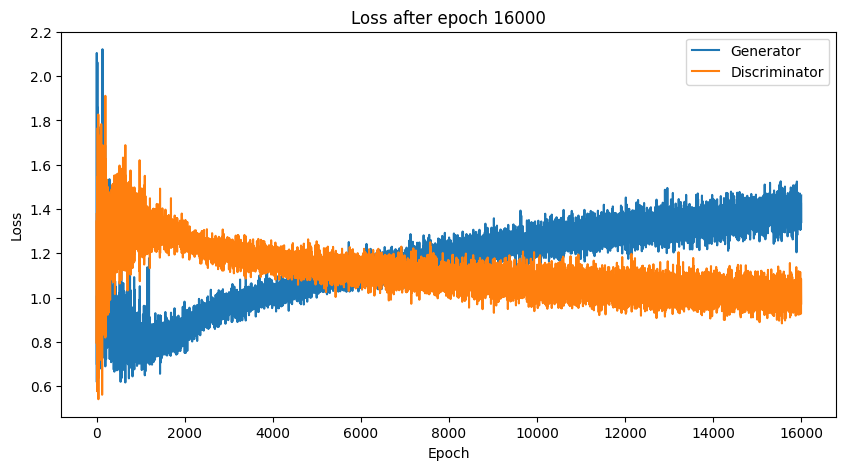

Time for epoch 16000 is 3.805011034011841 sec
Time for epoch 16001 is 0.8481357097625732 sec
Time for epoch 16002 is 0.8653507232666016 sec
Time for epoch 16003 is 0.8640415668487549 sec
Time for epoch 16004 is 0.8676958084106445 sec
Time for epoch 16005 is 0.8705167770385742 sec
Time for epoch 16006 is 0.8754873275756836 sec
Time for epoch 16007 is 0.8767435550689697 sec
Time for epoch 16008 is 0.8766090869903564 sec
Time for epoch 16009 is 0.881767988204956 sec
Time for epoch 16010 is 0.8759002685546875 sec
Time for epoch 16011 is 0.8840525150299072 sec
Time for epoch 16012 is 0.8804104328155518 sec
Time for epoch 16013 is 0.8804037570953369 sec
Time for epoch 16014 is 0.8801493644714355 sec
Time for epoch 16015 is 0.8817429542541504 sec
Time for epoch 16016 is 0.8792519569396973 sec
Time for epoch 16017 is 0.8860945701599121 sec
Time for epoch 16018 is 0.8805739879608154 sec
Time for epoch 16019 is 0.8795332908630371 sec
Time for epoch 16020 is 0.8807547092437744 sec
Time for epoch 

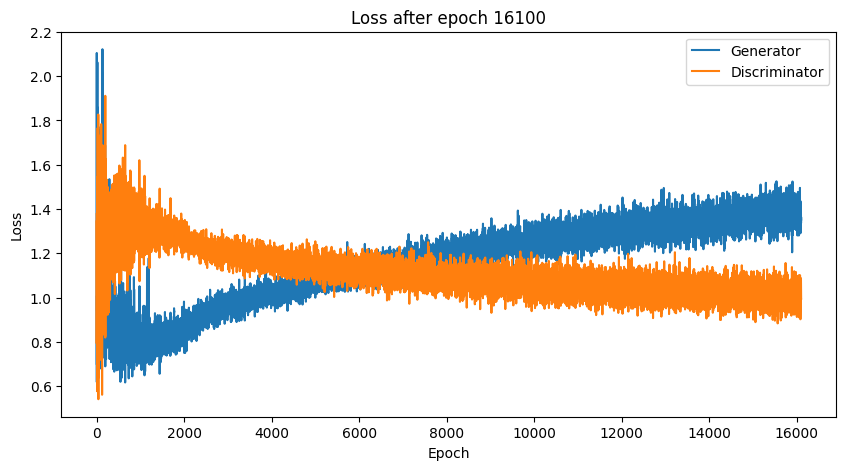

Time for epoch 16100 is 3.935413122177124 sec
Time for epoch 16101 is 0.8644921779632568 sec
Time for epoch 16102 is 0.8626651763916016 sec
Time for epoch 16103 is 0.8685009479522705 sec
Time for epoch 16104 is 0.8668911457061768 sec
Time for epoch 16105 is 0.8741636276245117 sec
Time for epoch 16106 is 0.8727500438690186 sec
Time for epoch 16107 is 0.8688657283782959 sec
Time for epoch 16108 is 0.8774962425231934 sec
Time for epoch 16109 is 0.8782169818878174 sec
Time for epoch 16110 is 0.8724477291107178 sec
Time for epoch 16111 is 0.8810760974884033 sec
Time for epoch 16112 is 0.8732519149780273 sec
Time for epoch 16113 is 0.8808939456939697 sec
Time for epoch 16114 is 0.8770794868469238 sec
Time for epoch 16115 is 0.8796424865722656 sec
Time for epoch 16116 is 0.8792617321014404 sec
Time for epoch 16117 is 0.882453203201294 sec
Time for epoch 16118 is 0.8786039352416992 sec
Time for epoch 16119 is 0.8775432109832764 sec
Time for epoch 16120 is 0.8800065517425537 sec
Time for epoch 

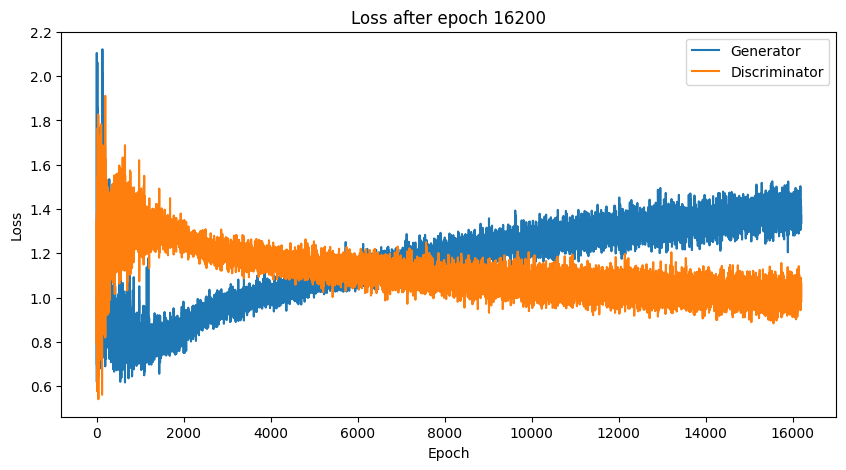

Time for epoch 16200 is 3.8175816535949707 sec
Time for epoch 16201 is 0.8518788814544678 sec
Time for epoch 16202 is 0.8654627799987793 sec
Time for epoch 16203 is 0.8676657676696777 sec
Time for epoch 16204 is 0.8659186363220215 sec
Time for epoch 16205 is 0.8703615665435791 sec
Time for epoch 16206 is 0.8711376190185547 sec
Time for epoch 16207 is 0.8754003047943115 sec
Time for epoch 16208 is 0.8750979900360107 sec
Time for epoch 16209 is 0.8828005790710449 sec
Time for epoch 16210 is 0.875838041305542 sec
Time for epoch 16211 is 0.8753523826599121 sec
Time for epoch 16212 is 0.8771016597747803 sec
Time for epoch 16213 is 0.878809928894043 sec
Time for epoch 16214 is 0.87992262840271 sec
Time for epoch 16215 is 0.8798713684082031 sec
Time for epoch 16216 is 0.882148265838623 sec
Time for epoch 16217 is 0.8817288875579834 sec
Time for epoch 16218 is 0.8861877918243408 sec
Time for epoch 16219 is 0.883425235748291 sec
Time for epoch 16220 is 0.8807508945465088 sec
Time for epoch 1622

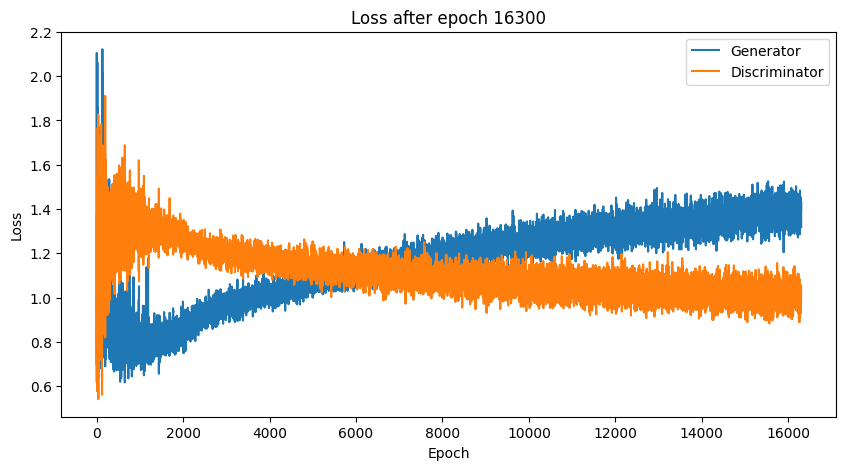

Time for epoch 16300 is 3.868065357208252 sec
Time for epoch 16301 is 0.8544411659240723 sec
Time for epoch 16302 is 0.8656768798828125 sec
Time for epoch 16303 is 0.8706221580505371 sec
Time for epoch 16304 is 0.8699095249176025 sec
Time for epoch 16305 is 0.8727493286132812 sec
Time for epoch 16306 is 0.8765313625335693 sec
Time for epoch 16307 is 0.8735237121582031 sec
Time for epoch 16308 is 0.8762364387512207 sec
Time for epoch 16309 is 0.872950553894043 sec
Time for epoch 16310 is 0.8756709098815918 sec
Time for epoch 16311 is 0.8835532665252686 sec
Time for epoch 16312 is 0.8770031929016113 sec
Time for epoch 16313 is 0.8754873275756836 sec
Time for epoch 16314 is 0.8805410861968994 sec
Time for epoch 16315 is 0.8840951919555664 sec
Time for epoch 16316 is 0.8843989372253418 sec
Time for epoch 16317 is 0.8810951709747314 sec
Time for epoch 16318 is 0.879469633102417 sec
Time for epoch 16319 is 0.8806548118591309 sec
Time for epoch 16320 is 0.8812165260314941 sec
Time for epoch 1

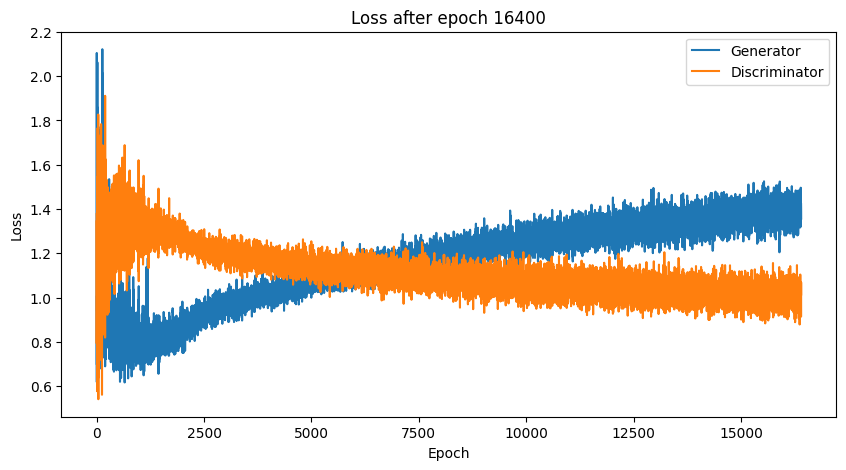

Time for epoch 16400 is 3.821967840194702 sec
Time for epoch 16401 is 0.8640198707580566 sec
Time for epoch 16402 is 0.8622841835021973 sec
Time for epoch 16403 is 0.8682048320770264 sec
Time for epoch 16404 is 0.8689591884613037 sec
Time for epoch 16405 is 0.8754808902740479 sec
Time for epoch 16406 is 0.8713204860687256 sec
Time for epoch 16407 is 0.8757691383361816 sec
Time for epoch 16408 is 0.879859209060669 sec
Time for epoch 16409 is 0.8765640258789062 sec
Time for epoch 16410 is 0.8736193180084229 sec
Time for epoch 16411 is 0.8786032199859619 sec
Time for epoch 16412 is 0.8779137134552002 sec
Time for epoch 16413 is 0.8812060356140137 sec
Time for epoch 16414 is 0.8824338912963867 sec
Time for epoch 16415 is 0.87823486328125 sec
Time for epoch 16416 is 0.8851413726806641 sec
Time for epoch 16417 is 0.87630295753479 sec
Time for epoch 16418 is 0.8838965892791748 sec
Time for epoch 16419 is 0.8824567794799805 sec
Time for epoch 16420 is 0.8806095123291016 sec
Time for epoch 1642

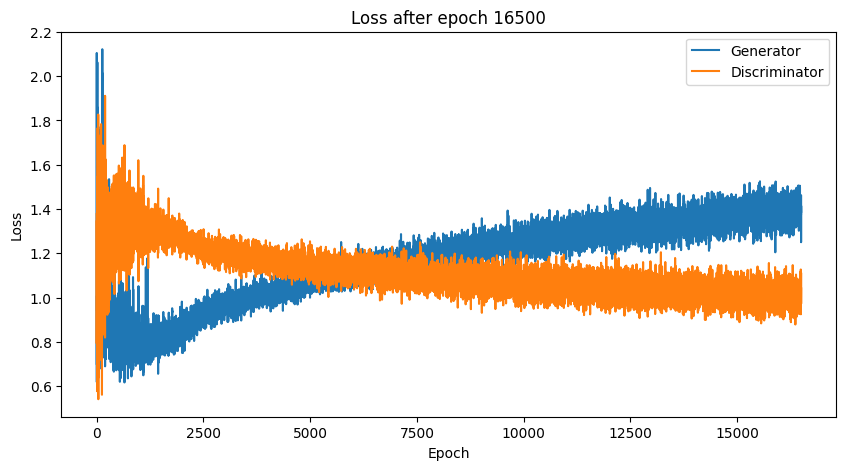

Time for epoch 16500 is 3.697643756866455 sec
Time for epoch 16501 is 0.8608896732330322 sec
Time for epoch 16502 is 0.8729312419891357 sec
Time for epoch 16503 is 0.8671112060546875 sec
Time for epoch 16504 is 0.8641355037689209 sec
Time for epoch 16505 is 0.8721544742584229 sec
Time for epoch 16506 is 0.8757636547088623 sec
Time for epoch 16507 is 0.8755979537963867 sec
Time for epoch 16508 is 0.8765163421630859 sec
Time for epoch 16509 is 0.8780949115753174 sec
Time for epoch 16510 is 0.8750479221343994 sec
Time for epoch 16511 is 0.8780515193939209 sec
Time for epoch 16512 is 0.8781712055206299 sec
Time for epoch 16513 is 0.8768894672393799 sec
Time for epoch 16514 is 0.879004716873169 sec
Time for epoch 16515 is 0.8809309005737305 sec
Time for epoch 16516 is 0.8876297473907471 sec
Time for epoch 16517 is 0.8791599273681641 sec
Time for epoch 16518 is 0.8810079097747803 sec
Time for epoch 16519 is 0.886101245880127 sec
Time for epoch 16520 is 0.885591983795166 sec
Time for epoch 16

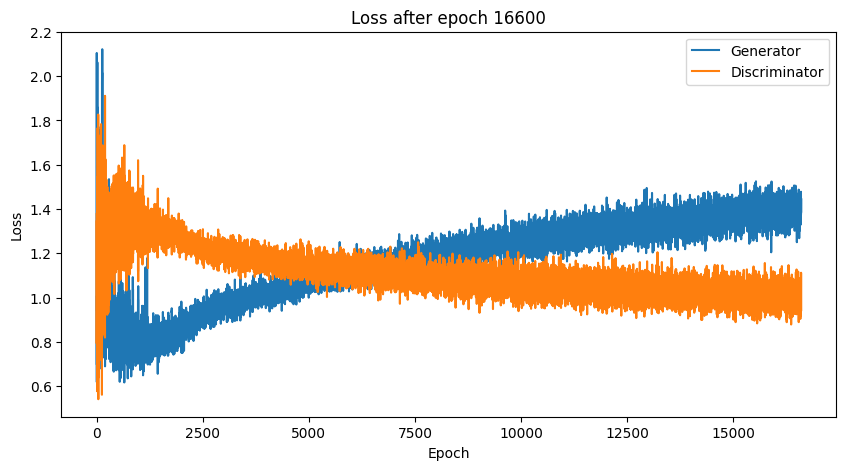

Time for epoch 16600 is 3.8257195949554443 sec
Time for epoch 16601 is 0.8616600036621094 sec
Time for epoch 16602 is 0.8641188144683838 sec
Time for epoch 16603 is 0.8654956817626953 sec
Time for epoch 16604 is 0.8663625717163086 sec
Time for epoch 16605 is 0.8685715198516846 sec
Time for epoch 16606 is 0.8716018199920654 sec
Time for epoch 16607 is 0.8748617172241211 sec
Time for epoch 16608 is 0.8715109825134277 sec
Time for epoch 16609 is 0.8756754398345947 sec
Time for epoch 16610 is 0.8765766620635986 sec
Time for epoch 16611 is 0.8790431022644043 sec
Time for epoch 16612 is 0.8780019283294678 sec
Time for epoch 16613 is 0.8848834037780762 sec
Time for epoch 16614 is 0.8783178329467773 sec
Time for epoch 16615 is 0.8826043605804443 sec
Time for epoch 16616 is 0.8797554969787598 sec
Time for epoch 16617 is 0.8852138519287109 sec
Time for epoch 16618 is 0.8798544406890869 sec
Time for epoch 16619 is 0.8810579776763916 sec
Time for epoch 16620 is 0.8793606758117676 sec
Time for epoc

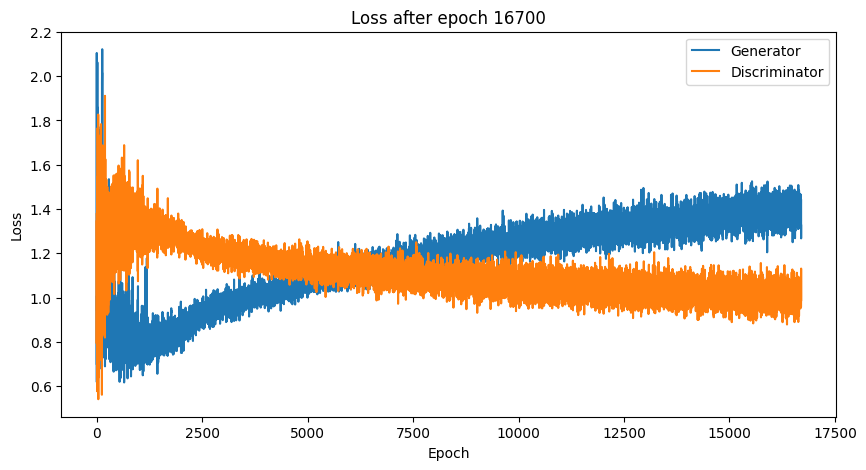

Time for epoch 16700 is 3.9058799743652344 sec
Time for epoch 16701 is 0.8633434772491455 sec
Time for epoch 16702 is 0.8571579456329346 sec
Time for epoch 16703 is 0.863389253616333 sec
Time for epoch 16704 is 0.8694145679473877 sec
Time for epoch 16705 is 0.8742992877960205 sec
Time for epoch 16706 is 0.8755764961242676 sec
Time for epoch 16707 is 0.869640588760376 sec
Time for epoch 16708 is 0.8732407093048096 sec
Time for epoch 16709 is 0.8807985782623291 sec
Time for epoch 16710 is 0.878901481628418 sec
Time for epoch 16711 is 0.8773398399353027 sec
Time for epoch 16712 is 0.8736655712127686 sec
Time for epoch 16713 is 0.8784582614898682 sec
Time for epoch 16714 is 0.8816590309143066 sec
Time for epoch 16715 is 0.8815951347351074 sec
Time for epoch 16716 is 0.8774898052215576 sec
Time for epoch 16717 is 0.8779222965240479 sec
Time for epoch 16718 is 0.8819749355316162 sec
Time for epoch 16719 is 0.8843536376953125 sec
Time for epoch 16720 is 0.8809678554534912 sec
Time for epoch 1

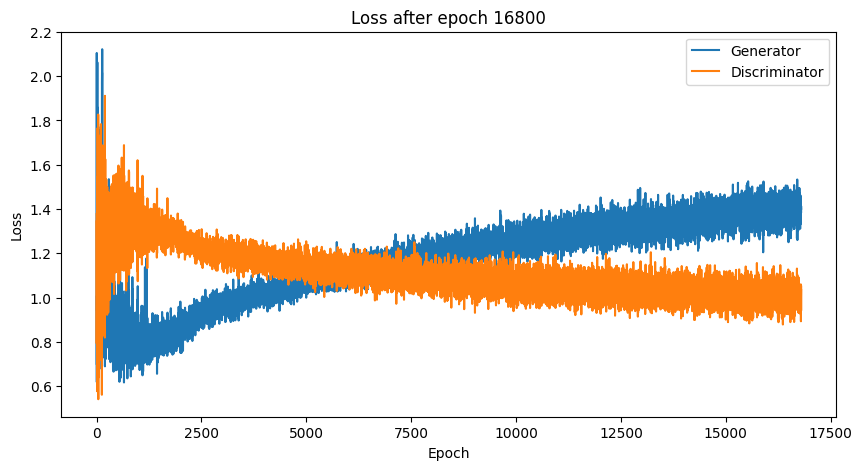

Time for epoch 16800 is 3.8432254791259766 sec
Time for epoch 16801 is 0.8516721725463867 sec
Time for epoch 16802 is 0.8623154163360596 sec
Time for epoch 16803 is 0.8668239116668701 sec
Time for epoch 16804 is 0.8664841651916504 sec
Time for epoch 16805 is 0.8723886013031006 sec
Time for epoch 16806 is 0.8755712509155273 sec
Time for epoch 16807 is 0.8728024959564209 sec
Time for epoch 16808 is 0.8717315196990967 sec
Time for epoch 16809 is 0.8742377758026123 sec
Time for epoch 16810 is 0.8743746280670166 sec
Time for epoch 16811 is 0.8740260601043701 sec
Time for epoch 16812 is 0.8794708251953125 sec
Time for epoch 16813 is 0.8862643241882324 sec
Time for epoch 16814 is 0.8785262107849121 sec
Time for epoch 16815 is 0.885430097579956 sec
Time for epoch 16816 is 0.8767974376678467 sec
Time for epoch 16817 is 0.8841760158538818 sec
Time for epoch 16818 is 0.8821754455566406 sec
Time for epoch 16819 is 0.88163161277771 sec
Time for epoch 16820 is 0.8780536651611328 sec
Time for epoch 1

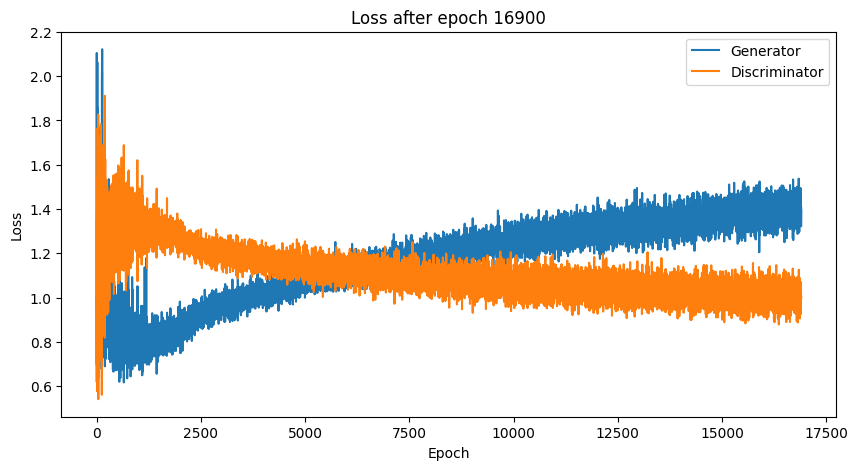

Time for epoch 16900 is 3.9016528129577637 sec
Time for epoch 16901 is 0.8591868877410889 sec
Time for epoch 16902 is 0.8577132225036621 sec
Time for epoch 16903 is 0.866990327835083 sec
Time for epoch 16904 is 0.8708481788635254 sec
Time for epoch 16905 is 0.8691549301147461 sec
Time for epoch 16906 is 0.87636399269104 sec
Time for epoch 16907 is 0.8761446475982666 sec
Time for epoch 16908 is 0.8695669174194336 sec
Time for epoch 16909 is 0.8741631507873535 sec
Time for epoch 16910 is 0.8734679222106934 sec
Time for epoch 16911 is 0.8766999244689941 sec
Time for epoch 16912 is 0.8782281875610352 sec
Time for epoch 16913 is 0.8826696872711182 sec
Time for epoch 16914 is 0.8772799968719482 sec
Time for epoch 16915 is 0.8820252418518066 sec
Time for epoch 16916 is 0.8735005855560303 sec
Time for epoch 16917 is 0.8827893733978271 sec
Time for epoch 16918 is 0.8787498474121094 sec
Time for epoch 16919 is 0.8751249313354492 sec
Time for epoch 16920 is 0.8851199150085449 sec
Time for epoch 1

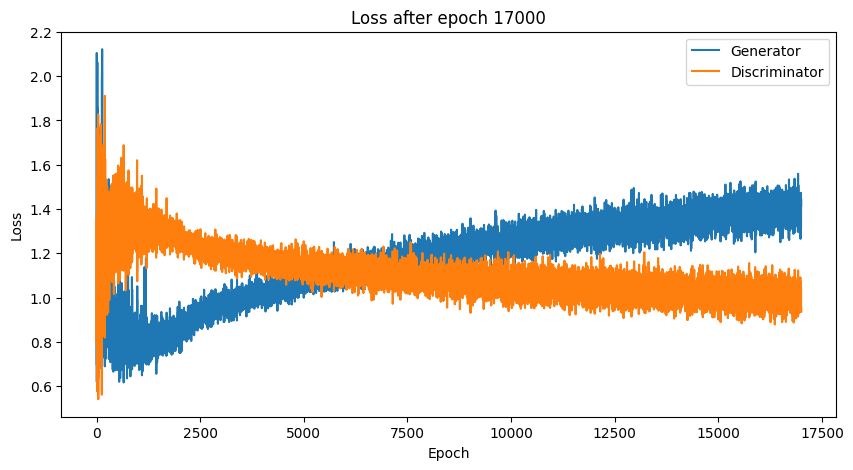

Time for epoch 17000 is 3.8453316688537598 sec
Time for epoch 17001 is 0.8661222457885742 sec
Time for epoch 17002 is 0.8635656833648682 sec
Time for epoch 17003 is 0.8668756484985352 sec
Time for epoch 17004 is 0.8744559288024902 sec
Time for epoch 17005 is 0.8741147518157959 sec
Time for epoch 17006 is 0.872875452041626 sec
Time for epoch 17007 is 0.8768198490142822 sec
Time for epoch 17008 is 0.8719840049743652 sec
Time for epoch 17009 is 0.8764653205871582 sec
Time for epoch 17010 is 0.8749728202819824 sec
Time for epoch 17011 is 0.8755922317504883 sec
Time for epoch 17012 is 0.876495361328125 sec
Time for epoch 17013 is 0.8791308403015137 sec
Time for epoch 17014 is 0.8794140815734863 sec
Time for epoch 17015 is 0.8738343715667725 sec
Time for epoch 17016 is 0.8818850517272949 sec
Time for epoch 17017 is 0.8770983219146729 sec
Time for epoch 17018 is 0.8817968368530273 sec
Time for epoch 17019 is 0.87941575050354 sec
Time for epoch 17020 is 0.8855617046356201 sec
Time for epoch 17

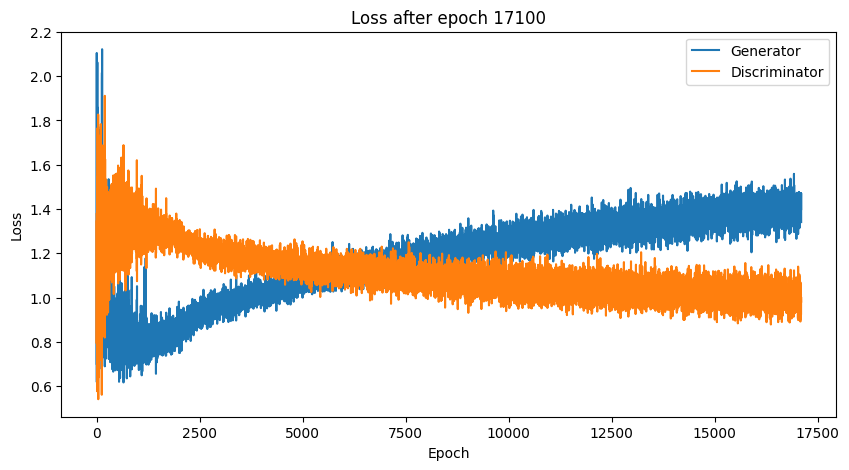

Time for epoch 17100 is 3.880906581878662 sec
Time for epoch 17101 is 0.8623249530792236 sec
Time for epoch 17102 is 0.8607909679412842 sec
Time for epoch 17103 is 0.8664126396179199 sec
Time for epoch 17104 is 0.8707075119018555 sec
Time for epoch 17105 is 0.8717281818389893 sec
Time for epoch 17106 is 0.8684360980987549 sec
Time for epoch 17107 is 0.8749783039093018 sec
Time for epoch 17108 is 0.880225658416748 sec
Time for epoch 17109 is 0.8730502128601074 sec
Time for epoch 17110 is 0.8764207363128662 sec
Time for epoch 17111 is 0.8794927597045898 sec
Time for epoch 17112 is 0.8812203407287598 sec
Time for epoch 17113 is 0.8757061958312988 sec
Time for epoch 17114 is 0.877826452255249 sec
Time for epoch 17115 is 0.8802714347839355 sec
Time for epoch 17116 is 0.8871879577636719 sec
Time for epoch 17117 is 0.8792181015014648 sec
Time for epoch 17118 is 0.8878846168518066 sec
Time for epoch 17119 is 0.8838813304901123 sec
Time for epoch 17120 is 0.8798038959503174 sec
Time for epoch 1

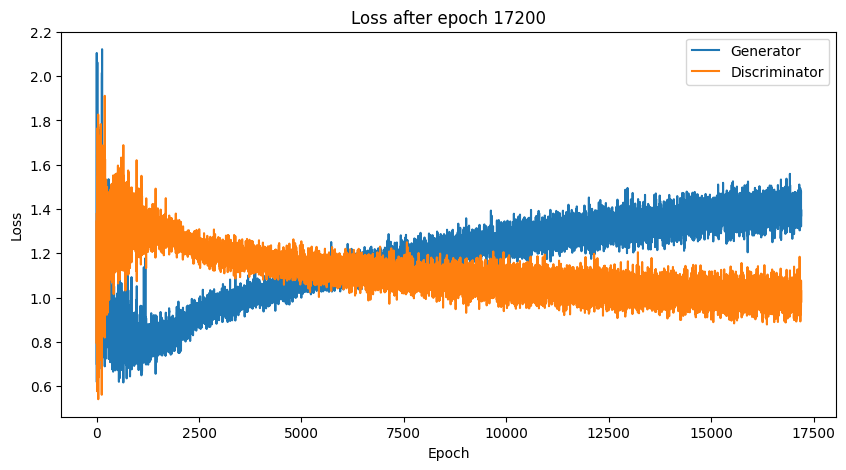

Time for epoch 17200 is 3.905806541442871 sec
Time for epoch 17201 is 0.8576943874359131 sec
Time for epoch 17202 is 0.8754005432128906 sec
Time for epoch 17203 is 0.8648018836975098 sec
Time for epoch 17204 is 0.8643388748168945 sec
Time for epoch 17205 is 0.8730151653289795 sec
Time for epoch 17206 is 0.8739697933197021 sec
Time for epoch 17207 is 0.8748414516448975 sec
Time for epoch 17208 is 0.8753876686096191 sec
Time for epoch 17209 is 0.8766434192657471 sec
Time for epoch 17210 is 0.8770172595977783 sec
Time for epoch 17211 is 0.8777580261230469 sec
Time for epoch 17212 is 0.878070592880249 sec
Time for epoch 17213 is 0.8775315284729004 sec
Time for epoch 17214 is 0.877932071685791 sec
Time for epoch 17215 is 0.8828623294830322 sec
Time for epoch 17216 is 0.8786752223968506 sec
Time for epoch 17217 is 0.8840711116790771 sec
Time for epoch 17218 is 0.8821840286254883 sec
Time for epoch 17219 is 0.8789534568786621 sec
Time for epoch 17220 is 0.882354736328125 sec
Time for epoch 17

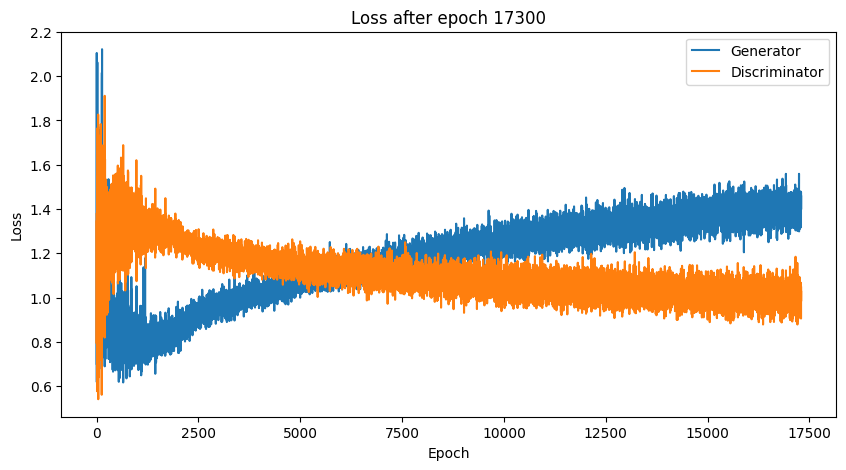

Time for epoch 17300 is 3.840860605239868 sec
Time for epoch 17301 is 0.8691239356994629 sec
Time for epoch 17302 is 0.8592820167541504 sec
Time for epoch 17303 is 0.8664035797119141 sec
Time for epoch 17304 is 0.869786262512207 sec
Time for epoch 17305 is 0.8796453475952148 sec
Time for epoch 17306 is 0.8711767196655273 sec
Time for epoch 17307 is 0.8701558113098145 sec
Time for epoch 17308 is 0.8769900798797607 sec
Time for epoch 17309 is 0.8769440650939941 sec
Time for epoch 17310 is 0.8722004890441895 sec
Time for epoch 17311 is 0.8815083503723145 sec
Time for epoch 17312 is 0.8760409355163574 sec
Time for epoch 17313 is 0.8785707950592041 sec
Time for epoch 17314 is 0.8787672519683838 sec
Time for epoch 17315 is 0.8799431324005127 sec
Time for epoch 17316 is 0.8809795379638672 sec
Time for epoch 17317 is 0.8816390037536621 sec
Time for epoch 17318 is 0.8777360916137695 sec
Time for epoch 17319 is 0.8801729679107666 sec
Time for epoch 17320 is 0.8806993961334229 sec
Time for epoch 

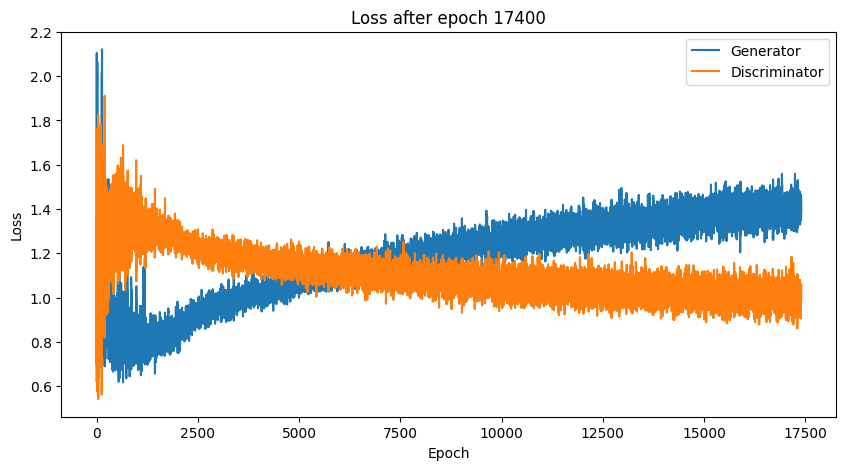

Time for epoch 17400 is 3.840359687805176 sec
Time for epoch 17401 is 0.8531780242919922 sec
Time for epoch 17402 is 0.8657796382904053 sec
Time for epoch 17403 is 0.8645050525665283 sec
Time for epoch 17404 is 0.8641271591186523 sec
Time for epoch 17405 is 0.8760116100311279 sec
Time for epoch 17406 is 0.8715634346008301 sec
Time for epoch 17407 is 0.8749070167541504 sec
Time for epoch 17408 is 0.8733563423156738 sec
Time for epoch 17409 is 0.8754465579986572 sec
Time for epoch 17410 is 0.8767585754394531 sec
Time for epoch 17411 is 0.880577802658081 sec
Time for epoch 17412 is 0.8779399394989014 sec
Time for epoch 17413 is 0.8781237602233887 sec
Time for epoch 17414 is 0.8808174133300781 sec
Time for epoch 17415 is 0.8744170665740967 sec
Time for epoch 17416 is 0.8836214542388916 sec
Time for epoch 17417 is 0.8804583549499512 sec
Time for epoch 17418 is 0.8838262557983398 sec
Time for epoch 17419 is 0.8783040046691895 sec
Time for epoch 17420 is 0.8812406063079834 sec
Time for epoch 

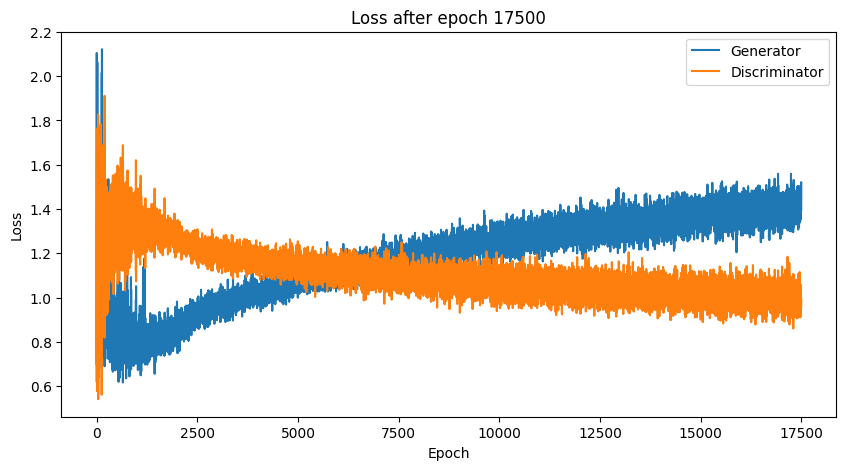

Time for epoch 17500 is 3.863503932952881 sec
Time for epoch 17501 is 0.8572697639465332 sec
Time for epoch 17502 is 0.8672287464141846 sec
Time for epoch 17503 is 0.863011360168457 sec
Time for epoch 17504 is 0.8681912422180176 sec
Time for epoch 17505 is 0.8705489635467529 sec
Time for epoch 17506 is 0.8759617805480957 sec
Time for epoch 17507 is 0.8690693378448486 sec
Time for epoch 17508 is 0.8724818229675293 sec
Time for epoch 17509 is 0.8717715740203857 sec
Time for epoch 17510 is 0.877129077911377 sec
Time for epoch 17511 is 0.8769114017486572 sec
Time for epoch 17512 is 0.8762428760528564 sec
Time for epoch 17513 is 0.8803877830505371 sec
Time for epoch 17514 is 0.8800241947174072 sec
Time for epoch 17515 is 0.8784887790679932 sec
Time for epoch 17516 is 0.8749575614929199 sec
Time for epoch 17517 is 0.8794608116149902 sec
Time for epoch 17518 is 0.8791773319244385 sec
Time for epoch 17519 is 0.8868246078491211 sec
Time for epoch 17520 is 0.8807559013366699 sec
Time for epoch 1

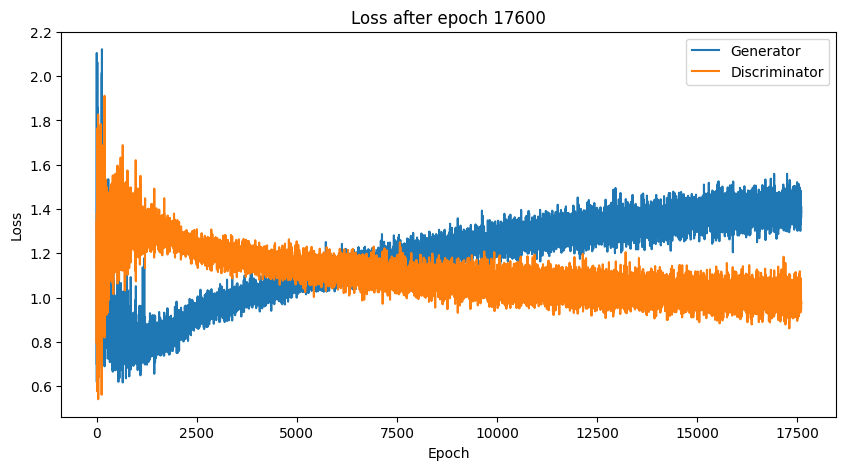

Time for epoch 17600 is 3.8732547760009766 sec
Time for epoch 17601 is 0.8674843311309814 sec
Time for epoch 17602 is 0.8678228855133057 sec
Time for epoch 17603 is 0.8619012832641602 sec
Time for epoch 17604 is 0.865565299987793 sec
Time for epoch 17605 is 0.8725521564483643 sec
Time for epoch 17606 is 0.8694033622741699 sec
Time for epoch 17607 is 0.8777201175689697 sec
Time for epoch 17608 is 0.8688695430755615 sec
Time for epoch 17609 is 0.8749268054962158 sec
Time for epoch 17610 is 0.8774383068084717 sec
Time for epoch 17611 is 0.8805878162384033 sec
Time for epoch 17612 is 0.8751468658447266 sec
Time for epoch 17613 is 0.87845778465271 sec
Time for epoch 17614 is 0.8791089057922363 sec
Time for epoch 17615 is 0.8807742595672607 sec
Time for epoch 17616 is 0.882298469543457 sec
Time for epoch 17617 is 0.8832113742828369 sec
Time for epoch 17618 is 0.8778183460235596 sec
Time for epoch 17619 is 0.8774526119232178 sec
Time for epoch 17620 is 0.8862171173095703 sec
Time for epoch 17

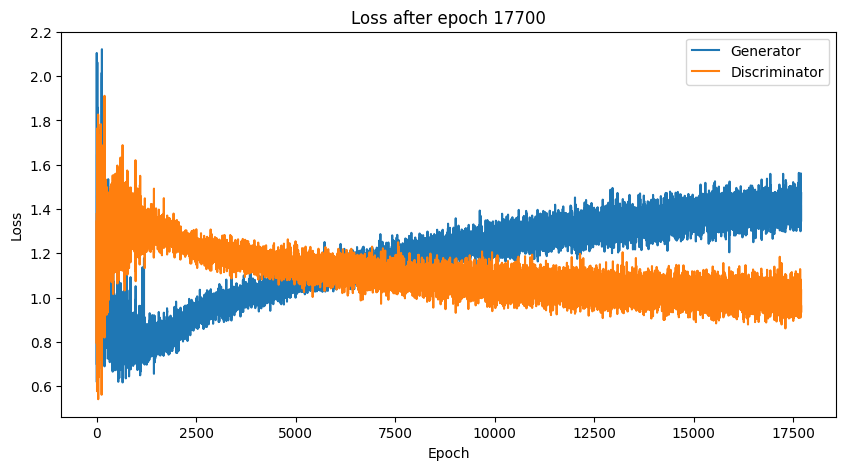

Time for epoch 17700 is 3.832746744155884 sec
Time for epoch 17701 is 0.8618052005767822 sec
Time for epoch 17702 is 0.8634688854217529 sec
Time for epoch 17703 is 0.8658688068389893 sec
Time for epoch 17704 is 0.8685135841369629 sec
Time for epoch 17705 is 0.8812696933746338 sec
Time for epoch 17706 is 0.8715479373931885 sec
Time for epoch 17707 is 0.8831155300140381 sec
Time for epoch 17708 is 0.8761749267578125 sec
Time for epoch 17709 is 0.8749191761016846 sec
Time for epoch 17710 is 0.8813877105712891 sec
Time for epoch 17711 is 0.8784453868865967 sec
Time for epoch 17712 is 0.8797383308410645 sec
Time for epoch 17713 is 0.8770499229431152 sec
Time for epoch 17714 is 0.8857681751251221 sec
Time for epoch 17715 is 0.8812696933746338 sec
Time for epoch 17716 is 0.8806498050689697 sec
Time for epoch 17717 is 0.8771035671234131 sec
Time for epoch 17718 is 0.8840670585632324 sec
Time for epoch 17719 is 0.8778402805328369 sec
Time for epoch 17720 is 0.8846859931945801 sec
Time for epoch

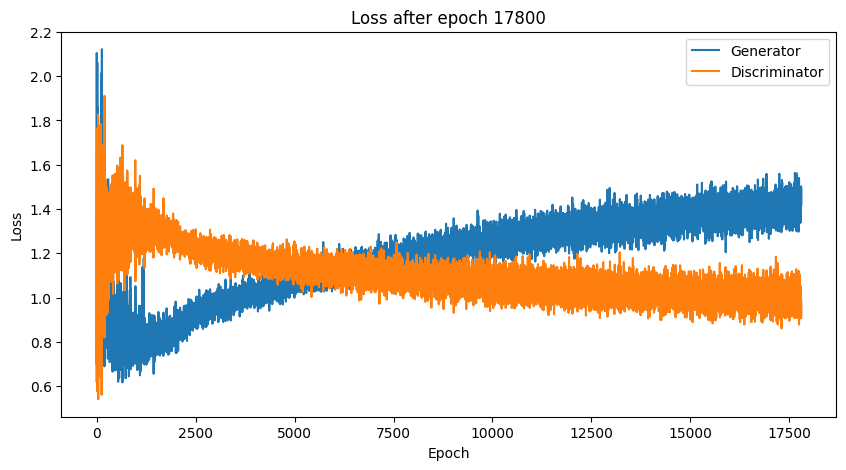

Time for epoch 17800 is 3.6842284202575684 sec
Time for epoch 17801 is 0.8560669422149658 sec
Time for epoch 17802 is 0.8616335391998291 sec
Time for epoch 17803 is 0.8674314022064209 sec
Time for epoch 17804 is 0.864011287689209 sec
Time for epoch 17805 is 0.8720462322235107 sec
Time for epoch 17806 is 0.8748869895935059 sec
Time for epoch 17807 is 0.8776867389678955 sec
Time for epoch 17808 is 0.8769564628601074 sec
Time for epoch 17809 is 0.8817698955535889 sec
Time for epoch 17810 is 0.8723931312561035 sec
Time for epoch 17811 is 0.8731887340545654 sec
Time for epoch 17812 is 0.8843762874603271 sec
Time for epoch 17813 is 0.8812520503997803 sec
Time for epoch 17814 is 0.8778681755065918 sec
Time for epoch 17815 is 0.8793141841888428 sec
Time for epoch 17816 is 0.8813393115997314 sec
Time for epoch 17817 is 0.8798327445983887 sec
Time for epoch 17818 is 0.8806543350219727 sec
Time for epoch 17819 is 0.8850607872009277 sec
Time for epoch 17820 is 0.8835771083831787 sec
Time for epoch

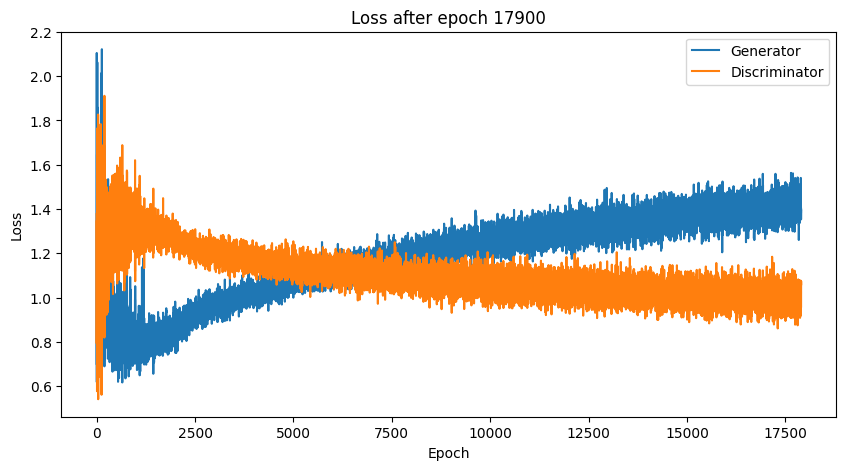

Time for epoch 17900 is 3.8810811042785645 sec
Time for epoch 17901 is 0.8600664138793945 sec
Time for epoch 17902 is 0.8593564033508301 sec
Time for epoch 17903 is 0.8625822067260742 sec
Time for epoch 17904 is 0.8704261779785156 sec
Time for epoch 17905 is 0.8698556423187256 sec
Time for epoch 17906 is 0.8764228820800781 sec
Time for epoch 17907 is 0.8714821338653564 sec
Time for epoch 17908 is 0.8759129047393799 sec
Time for epoch 17909 is 0.873631477355957 sec
Time for epoch 17910 is 0.876410961151123 sec
Time for epoch 17911 is 0.8707172870635986 sec
Time for epoch 17912 is 0.8817453384399414 sec
Time for epoch 17913 is 0.8746249675750732 sec
Time for epoch 17914 is 0.8806066513061523 sec
Time for epoch 17915 is 0.879047155380249 sec
Time for epoch 17916 is 0.8753321170806885 sec
Time for epoch 17917 is 0.8845336437225342 sec
Time for epoch 17918 is 0.8819828033447266 sec
Time for epoch 17919 is 0.8804459571838379 sec
Time for epoch 17920 is 0.8820464611053467 sec
Time for epoch 1

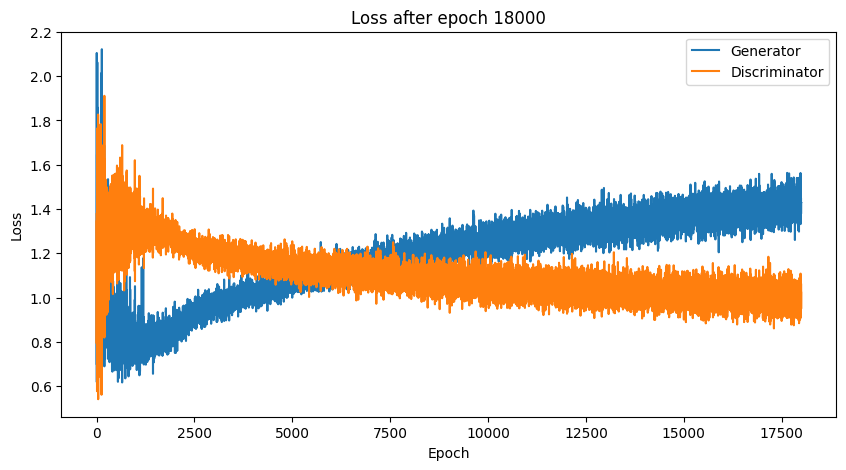

Time for epoch 18000 is 3.889172315597534 sec
Time for epoch 18001 is 0.8631579875946045 sec
Time for epoch 18002 is 0.858717679977417 sec
Time for epoch 18003 is 0.8628418445587158 sec
Time for epoch 18004 is 0.8676435947418213 sec
Time for epoch 18005 is 0.8684563636779785 sec
Time for epoch 18006 is 0.8678128719329834 sec
Time for epoch 18007 is 0.8675656318664551 sec
Time for epoch 18008 is 0.8846428394317627 sec
Time for epoch 18009 is 0.8751037120819092 sec
Time for epoch 18010 is 0.8777058124542236 sec
Time for epoch 18011 is 0.881030797958374 sec
Time for epoch 18012 is 0.880382776260376 sec
Time for epoch 18013 is 0.8792915344238281 sec
Time for epoch 18014 is 0.8790285587310791 sec
Time for epoch 18015 is 0.8818438053131104 sec
Time for epoch 18016 is 0.884718656539917 sec
Time for epoch 18017 is 0.8778471946716309 sec
Time for epoch 18018 is 0.8802731037139893 sec
Time for epoch 18019 is 0.8803362846374512 sec
Time for epoch 18020 is 0.8833487033843994 sec
Time for epoch 180

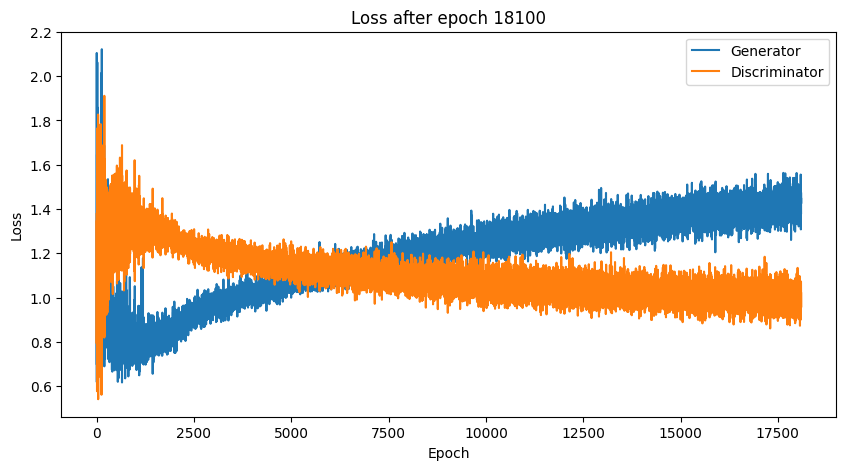

Time for epoch 18100 is 3.896461248397827 sec
Time for epoch 18101 is 0.8618271350860596 sec
Time for epoch 18102 is 0.8607621192932129 sec
Time for epoch 18103 is 0.8667926788330078 sec
Time for epoch 18104 is 0.8653228282928467 sec
Time for epoch 18105 is 0.8681869506835938 sec
Time for epoch 18106 is 0.8734049797058105 sec
Time for epoch 18107 is 0.871143102645874 sec
Time for epoch 18108 is 0.8731203079223633 sec
Time for epoch 18109 is 0.8795552253723145 sec
Time for epoch 18110 is 0.8712289333343506 sec
Time for epoch 18111 is 0.8790359497070312 sec
Time for epoch 18112 is 0.8796367645263672 sec
Time for epoch 18113 is 0.8751358985900879 sec
Time for epoch 18114 is 0.8798542022705078 sec
Time for epoch 18115 is 0.8830163478851318 sec
Time for epoch 18116 is 0.8804709911346436 sec
Time for epoch 18117 is 0.8805897235870361 sec
Time for epoch 18118 is 0.8813278675079346 sec
Time for epoch 18119 is 0.8787100315093994 sec
Time for epoch 18120 is 0.8815972805023193 sec
Time for epoch 

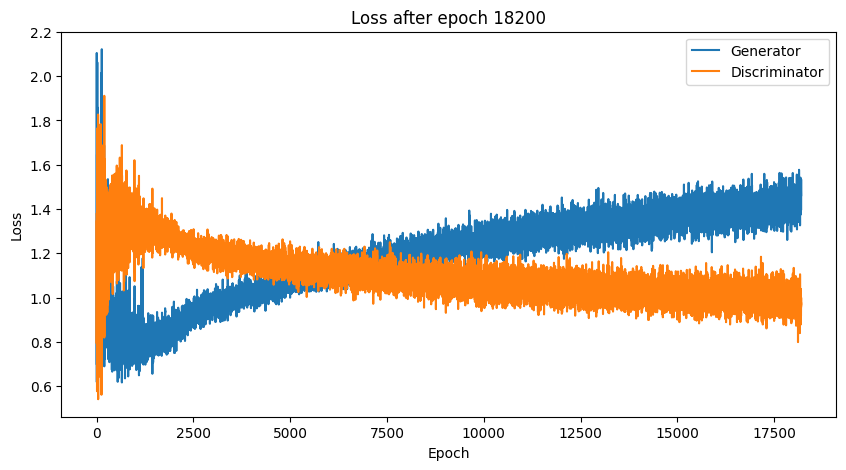

Time for epoch 18200 is 3.8745920658111572 sec
Time for epoch 18201 is 0.8619654178619385 sec
Time for epoch 18202 is 0.8652403354644775 sec
Time for epoch 18203 is 0.8639223575592041 sec
Time for epoch 18204 is 0.8673193454742432 sec
Time for epoch 18205 is 0.8735613822937012 sec
Time for epoch 18206 is 0.8721590042114258 sec
Time for epoch 18207 is 0.8699560165405273 sec
Time for epoch 18208 is 0.8715054988861084 sec
Time for epoch 18209 is 0.8782691955566406 sec
Time for epoch 18210 is 0.8806641101837158 sec
Time for epoch 18211 is 0.8702807426452637 sec
Time for epoch 18212 is 0.8773744106292725 sec
Time for epoch 18213 is 0.880964994430542 sec
Time for epoch 18214 is 0.8781754970550537 sec
Time for epoch 18215 is 0.878631591796875 sec
Time for epoch 18216 is 0.8795914649963379 sec
Time for epoch 18217 is 0.8787753582000732 sec
Time for epoch 18218 is 0.8801450729370117 sec
Time for epoch 18219 is 0.8803718090057373 sec
Time for epoch 18220 is 0.8804190158843994 sec
Time for epoch 

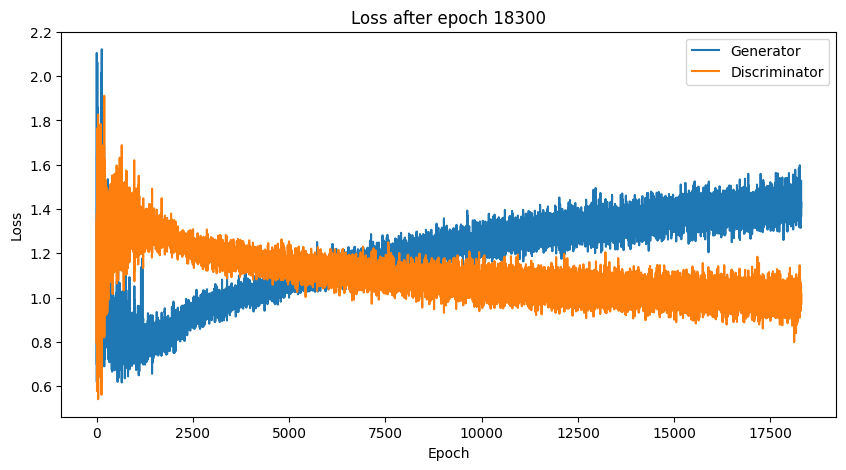

Time for epoch 18300 is 3.904111385345459 sec
Time for epoch 18301 is 0.8691315650939941 sec
Time for epoch 18302 is 0.8630962371826172 sec
Time for epoch 18303 is 0.86029052734375 sec
Time for epoch 18304 is 0.8677396774291992 sec
Time for epoch 18305 is 0.8682446479797363 sec
Time for epoch 18306 is 0.8716378211975098 sec
Time for epoch 18307 is 0.8732585906982422 sec
Time for epoch 18308 is 0.8739089965820312 sec
Time for epoch 18309 is 0.8726277351379395 sec
Time for epoch 18310 is 0.8789024353027344 sec
Time for epoch 18311 is 0.8760478496551514 sec
Time for epoch 18312 is 0.8777096271514893 sec
Time for epoch 18313 is 0.8770627975463867 sec
Time for epoch 18314 is 0.8788557052612305 sec
Time for epoch 18315 is 0.8795771598815918 sec
Time for epoch 18316 is 0.877753496170044 sec
Time for epoch 18317 is 0.8836236000061035 sec
Time for epoch 18318 is 0.88474440574646 sec
Time for epoch 18319 is 0.8833155632019043 sec
Time for epoch 18320 is 0.875413179397583 sec
Time for epoch 18321

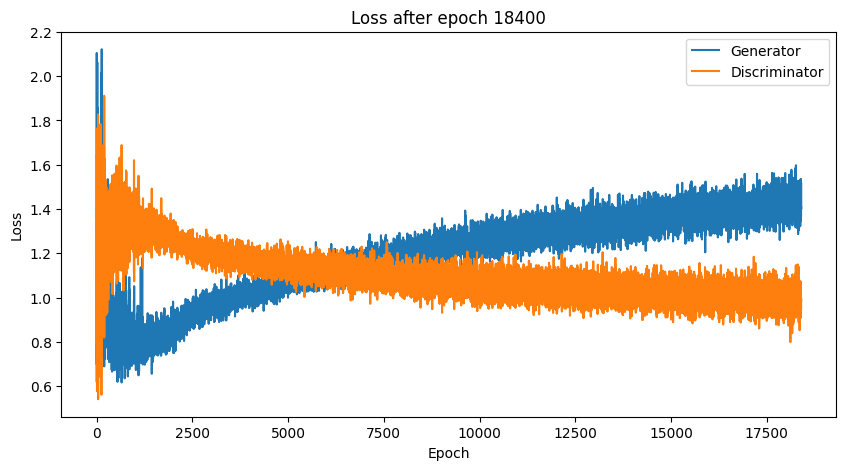

Time for epoch 18400 is 3.916045665740967 sec
Time for epoch 18401 is 0.8532276153564453 sec
Time for epoch 18402 is 0.865187406539917 sec
Time for epoch 18403 is 0.8642961978912354 sec
Time for epoch 18404 is 0.8681387901306152 sec
Time for epoch 18405 is 0.8774333000183105 sec
Time for epoch 18406 is 0.8667178153991699 sec
Time for epoch 18407 is 0.8741285800933838 sec
Time for epoch 18408 is 0.8755896091461182 sec
Time for epoch 18409 is 0.8722259998321533 sec
Time for epoch 18410 is 0.8779611587524414 sec
Time for epoch 18411 is 0.8836648464202881 sec
Time for epoch 18412 is 0.8746261596679688 sec
Time for epoch 18413 is 0.8853676319122314 sec
Time for epoch 18414 is 0.8757116794586182 sec
Time for epoch 18415 is 0.8834323883056641 sec
Time for epoch 18416 is 0.8837566375732422 sec
Time for epoch 18417 is 0.8828434944152832 sec
Time for epoch 18418 is 0.8805594444274902 sec
Time for epoch 18419 is 0.8796596527099609 sec
Time for epoch 18420 is 0.8795969486236572 sec
Time for epoch 

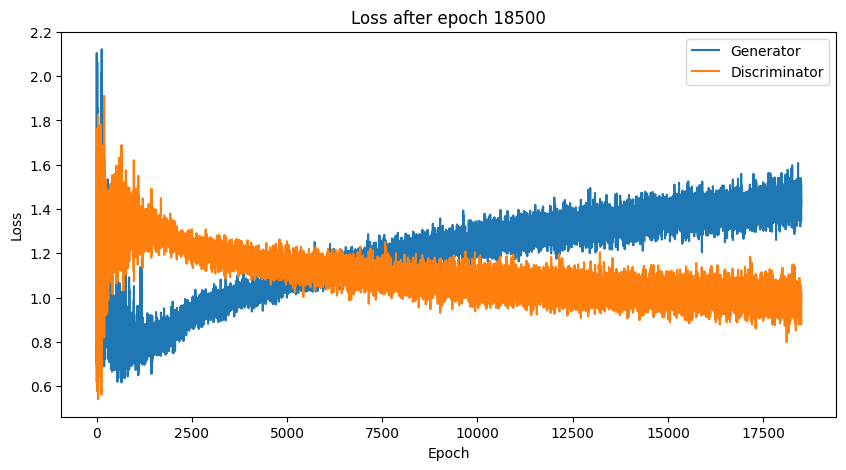

Time for epoch 18500 is 3.8934578895568848 sec
Time for epoch 18501 is 0.8518857955932617 sec
Time for epoch 18502 is 0.8677315711975098 sec
Time for epoch 18503 is 0.8642640113830566 sec
Time for epoch 18504 is 0.8698959350585938 sec
Time for epoch 18505 is 0.8711984157562256 sec
Time for epoch 18506 is 0.873187780380249 sec
Time for epoch 18507 is 0.8671078681945801 sec
Time for epoch 18508 is 0.873579740524292 sec
Time for epoch 18509 is 0.8785688877105713 sec
Time for epoch 18510 is 0.8715932369232178 sec
Time for epoch 18511 is 0.8785562515258789 sec
Time for epoch 18512 is 0.8773202896118164 sec
Time for epoch 18513 is 0.8828952312469482 sec
Time for epoch 18514 is 0.8788762092590332 sec
Time for epoch 18515 is 0.8774693012237549 sec
Time for epoch 18516 is 0.8822691440582275 sec
Time for epoch 18517 is 0.881903886795044 sec
Time for epoch 18518 is 0.8776569366455078 sec
Time for epoch 18519 is 0.8825416564941406 sec
Time for epoch 18520 is 0.8819444179534912 sec
Time for epoch 1

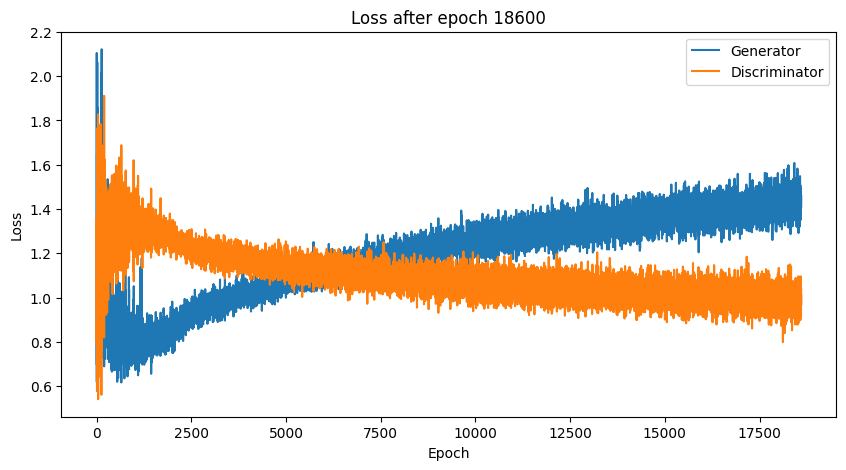

Time for epoch 18600 is 3.9127488136291504 sec
Time for epoch 18601 is 0.860220193862915 sec
Time for epoch 18602 is 0.8618667125701904 sec
Time for epoch 18603 is 0.8648114204406738 sec
Time for epoch 18604 is 0.8672499656677246 sec
Time for epoch 18605 is 0.8687984943389893 sec
Time for epoch 18606 is 0.8703787326812744 sec
Time for epoch 18607 is 0.874006986618042 sec
Time for epoch 18608 is 0.8764200210571289 sec
Time for epoch 18609 is 0.876413106918335 sec
Time for epoch 18610 is 0.8808457851409912 sec
Time for epoch 18611 is 0.8793230056762695 sec
Time for epoch 18612 is 0.8770933151245117 sec
Time for epoch 18613 is 0.8760995864868164 sec
Time for epoch 18614 is 0.8792397975921631 sec
Time for epoch 18615 is 0.8789706230163574 sec
Time for epoch 18616 is 0.8741626739501953 sec
Time for epoch 18617 is 0.8830208778381348 sec
Time for epoch 18618 is 0.8797636032104492 sec
Time for epoch 18619 is 0.8799095153808594 sec
Time for epoch 18620 is 0.8844192028045654 sec
Time for epoch 1

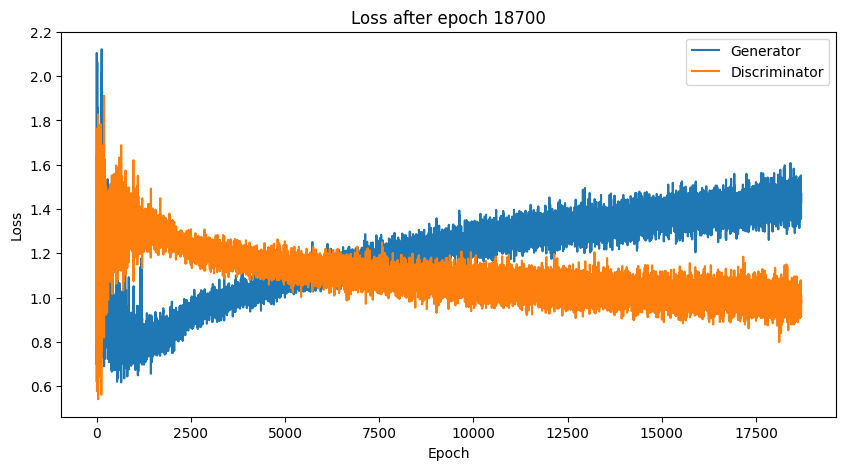

Time for epoch 18700 is 3.8914084434509277 sec
Time for epoch 18701 is 0.8640267848968506 sec
Time for epoch 18702 is 0.8605785369873047 sec
Time for epoch 18703 is 0.8662216663360596 sec
Time for epoch 18704 is 0.8707783222198486 sec
Time for epoch 18705 is 0.8670234680175781 sec
Time for epoch 18706 is 0.8745791912078857 sec
Time for epoch 18707 is 0.8723268508911133 sec
Time for epoch 18708 is 0.8727622032165527 sec
Time for epoch 18709 is 0.8785781860351562 sec
Time for epoch 18710 is 0.8793253898620605 sec
Time for epoch 18711 is 0.8791685104370117 sec
Time for epoch 18712 is 0.8800003528594971 sec
Time for epoch 18713 is 0.8788840770721436 sec
Time for epoch 18714 is 0.8787088394165039 sec
Time for epoch 18715 is 0.8855881690979004 sec
Time for epoch 18716 is 0.8784799575805664 sec
Time for epoch 18717 is 0.8825972080230713 sec
Time for epoch 18718 is 0.8825163841247559 sec
Time for epoch 18719 is 0.8814129829406738 sec
Time for epoch 18720 is 0.8803045749664307 sec
Time for epoc

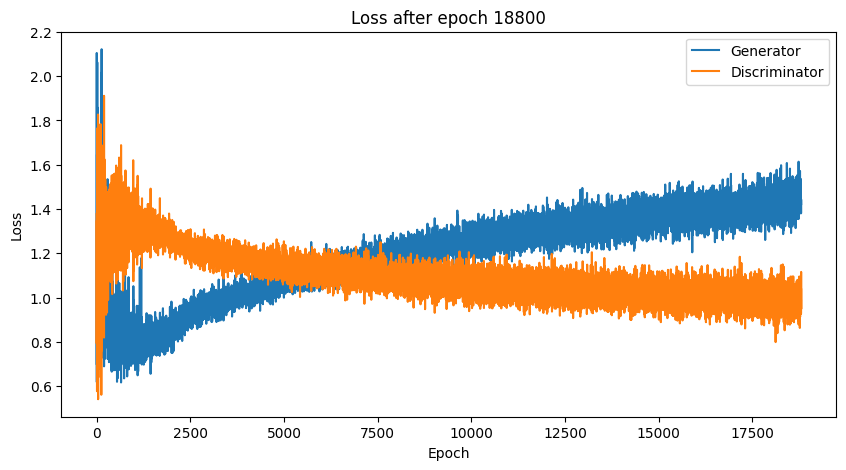

Time for epoch 18800 is 3.7359814643859863 sec
Time for epoch 18801 is 0.8643743991851807 sec
Time for epoch 18802 is 0.8593060970306396 sec
Time for epoch 18803 is 0.8661587238311768 sec
Time for epoch 18804 is 0.875514030456543 sec
Time for epoch 18805 is 0.8790605068206787 sec
Time for epoch 18806 is 0.8694629669189453 sec
Time for epoch 18807 is 0.8747549057006836 sec
Time for epoch 18808 is 0.8752200603485107 sec
Time for epoch 18809 is 0.8770992755889893 sec
Time for epoch 18810 is 0.8764262199401855 sec
Time for epoch 18811 is 0.8733224868774414 sec
Time for epoch 18812 is 0.879939079284668 sec
Time for epoch 18813 is 0.8744392395019531 sec
Time for epoch 18814 is 0.8817148208618164 sec
Time for epoch 18815 is 0.8776614665985107 sec
Time for epoch 18816 is 0.8818182945251465 sec
Time for epoch 18817 is 0.8823995590209961 sec
Time for epoch 18818 is 0.8803980350494385 sec
Time for epoch 18819 is 0.8813152313232422 sec
Time for epoch 18820 is 0.8822095394134521 sec
Time for epoch 

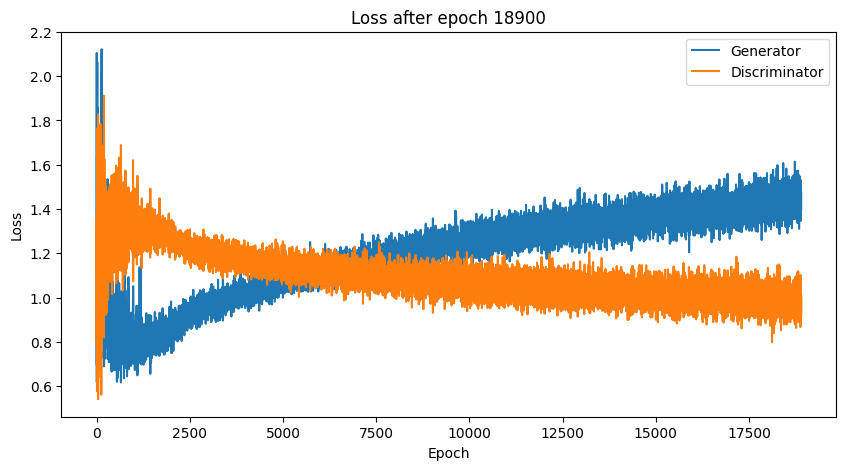

Time for epoch 18900 is 3.8721225261688232 sec
Time for epoch 18901 is 0.8677735328674316 sec
Time for epoch 18902 is 0.8631322383880615 sec
Time for epoch 18903 is 0.8649141788482666 sec
Time for epoch 18904 is 0.8657376766204834 sec
Time for epoch 18905 is 0.8756227493286133 sec
Time for epoch 18906 is 0.8721320629119873 sec
Time for epoch 18907 is 0.8710746765136719 sec
Time for epoch 18908 is 0.8759994506835938 sec
Time for epoch 18909 is 0.8775830268859863 sec
Time for epoch 18910 is 0.8771412372589111 sec
Time for epoch 18911 is 0.8769569396972656 sec
Time for epoch 18912 is 0.880009651184082 sec
Time for epoch 18913 is 0.8791623115539551 sec
Time for epoch 18914 is 0.8817551136016846 sec
Time for epoch 18915 is 0.880312442779541 sec
Time for epoch 18916 is 0.879481315612793 sec
Time for epoch 18917 is 0.8803253173828125 sec
Time for epoch 18918 is 0.8791191577911377 sec
Time for epoch 18919 is 0.882533073425293 sec
Time for epoch 18920 is 0.8805654048919678 sec
Time for epoch 18

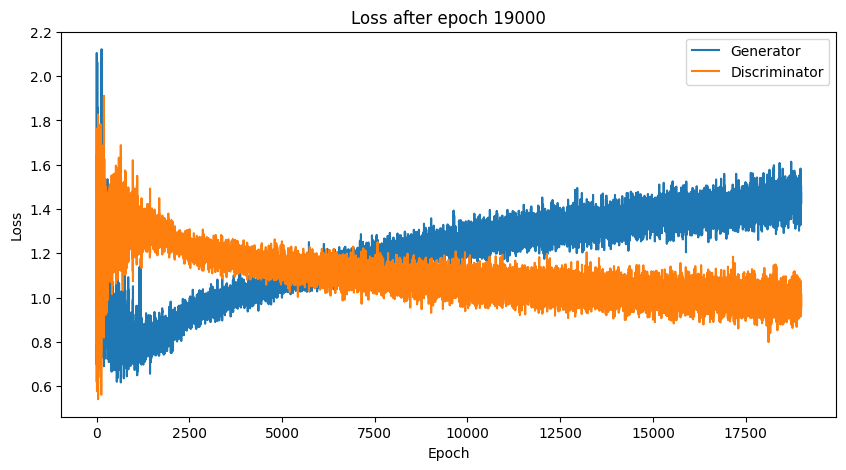

Time for epoch 19000 is 3.876889944076538 sec
Time for epoch 19001 is 0.8663482666015625 sec
Time for epoch 19002 is 0.8606328964233398 sec
Time for epoch 19003 is 0.8692951202392578 sec
Time for epoch 19004 is 0.8722045421600342 sec
Time for epoch 19005 is 0.8740360736846924 sec
Time for epoch 19006 is 0.8724873065948486 sec
Time for epoch 19007 is 0.8734095096588135 sec
Time for epoch 19008 is 0.8738961219787598 sec
Time for epoch 19009 is 0.878652811050415 sec
Time for epoch 19010 is 0.8753974437713623 sec
Time for epoch 19011 is 0.8766443729400635 sec
Time for epoch 19012 is 0.8812522888183594 sec
Time for epoch 19013 is 0.8724007606506348 sec
Time for epoch 19014 is 0.8822133541107178 sec
Time for epoch 19015 is 0.8761961460113525 sec
Time for epoch 19016 is 0.8766231536865234 sec
Time for epoch 19017 is 0.8826303482055664 sec
Time for epoch 19018 is 0.8763892650604248 sec
Time for epoch 19019 is 0.8808751106262207 sec
Time for epoch 19020 is 0.8795392513275146 sec
Time for epoch 

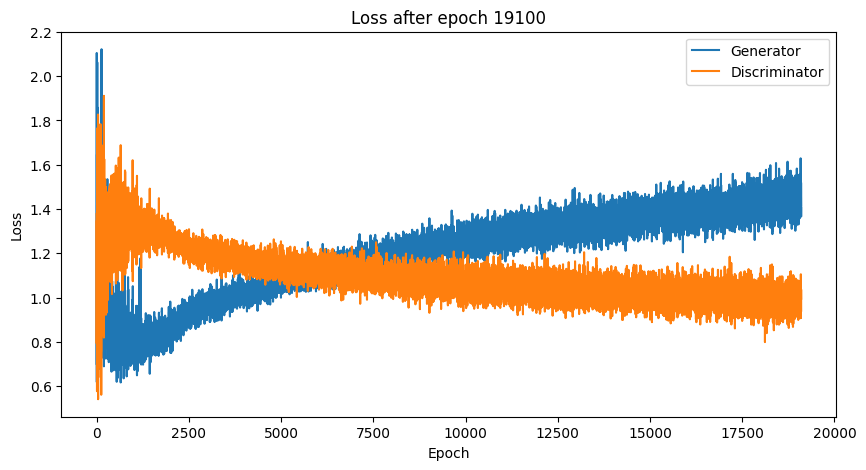

Time for epoch 19100 is 3.930349826812744 sec
Time for epoch 19101 is 0.8614559173583984 sec
Time for epoch 19102 is 0.8570067882537842 sec
Time for epoch 19103 is 0.8664758205413818 sec
Time for epoch 19104 is 0.8672065734863281 sec
Time for epoch 19105 is 0.8729844093322754 sec
Time for epoch 19106 is 0.8699848651885986 sec
Time for epoch 19107 is 0.8730263710021973 sec
Time for epoch 19108 is 0.8742275238037109 sec
Time for epoch 19109 is 0.8733706474304199 sec
Time for epoch 19110 is 0.8778924942016602 sec
Time for epoch 19111 is 0.8796086311340332 sec
Time for epoch 19112 is 0.878021240234375 sec
Time for epoch 19113 is 0.8766636848449707 sec
Time for epoch 19114 is 0.8781032562255859 sec
Time for epoch 19115 is 0.8784201145172119 sec
Time for epoch 19116 is 0.8812046051025391 sec
Time for epoch 19117 is 0.8780722618103027 sec
Time for epoch 19118 is 0.8775064945220947 sec
Time for epoch 19119 is 0.8843820095062256 sec
Time for epoch 19120 is 0.8779358863830566 sec
Time for epoch 

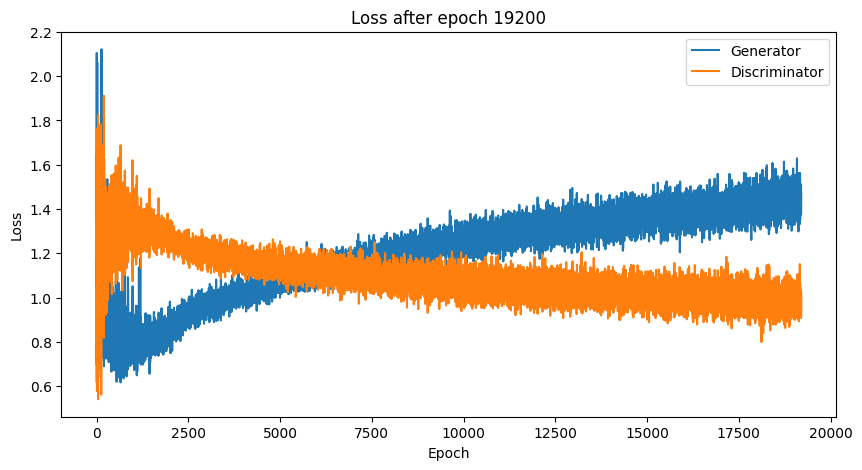

Time for epoch 19200 is 3.943148612976074 sec
Time for epoch 19201 is 0.8701319694519043 sec
Time for epoch 19202 is 0.8615717887878418 sec
Time for epoch 19203 is 0.8656506538391113 sec
Time for epoch 19204 is 0.8681497573852539 sec
Time for epoch 19205 is 0.8694427013397217 sec
Time for epoch 19206 is 0.8726680278778076 sec
Time for epoch 19207 is 0.8783516883850098 sec
Time for epoch 19208 is 0.8710718154907227 sec
Time for epoch 19209 is 0.8740055561065674 sec
Time for epoch 19210 is 0.8775069713592529 sec
Time for epoch 19211 is 0.8807065486907959 sec
Time for epoch 19212 is 0.8788771629333496 sec
Time for epoch 19213 is 0.8792874813079834 sec
Time for epoch 19214 is 0.8735239505767822 sec
Time for epoch 19215 is 0.8810901641845703 sec
Time for epoch 19216 is 0.8765604496002197 sec
Time for epoch 19217 is 0.880312442779541 sec
Time for epoch 19218 is 0.8800435066223145 sec
Time for epoch 19219 is 0.8799469470977783 sec
Time for epoch 19220 is 0.8793258666992188 sec
Time for epoch 

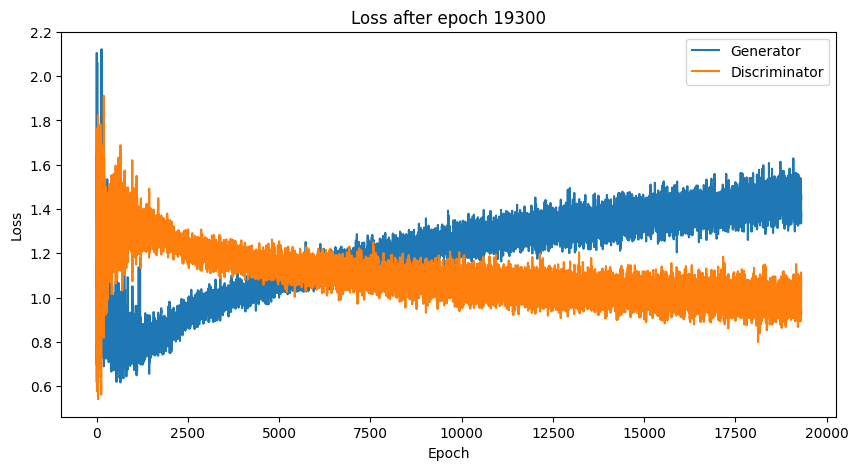

Time for epoch 19300 is 3.934514045715332 sec
Time for epoch 19301 is 0.8593611717224121 sec
Time for epoch 19302 is 0.8641345500946045 sec
Time for epoch 19303 is 0.8659794330596924 sec
Time for epoch 19304 is 0.8683021068572998 sec
Time for epoch 19305 is 0.873713493347168 sec
Time for epoch 19306 is 0.873448371887207 sec
Time for epoch 19307 is 0.8718569278717041 sec
Time for epoch 19308 is 0.8718628883361816 sec
Time for epoch 19309 is 0.8739268779754639 sec
Time for epoch 19310 is 0.8770594596862793 sec
Time for epoch 19311 is 0.8762037754058838 sec
Time for epoch 19312 is 0.8767292499542236 sec
Time for epoch 19313 is 0.8811914920806885 sec
Time for epoch 19314 is 0.8793942928314209 sec
Time for epoch 19315 is 0.8840351104736328 sec
Time for epoch 19316 is 0.8797624111175537 sec
Time for epoch 19317 is 0.8805601596832275 sec
Time for epoch 19318 is 0.8872895240783691 sec
Time for epoch 19319 is 0.8795144557952881 sec
Time for epoch 19320 is 0.8858733177185059 sec
Time for epoch 1

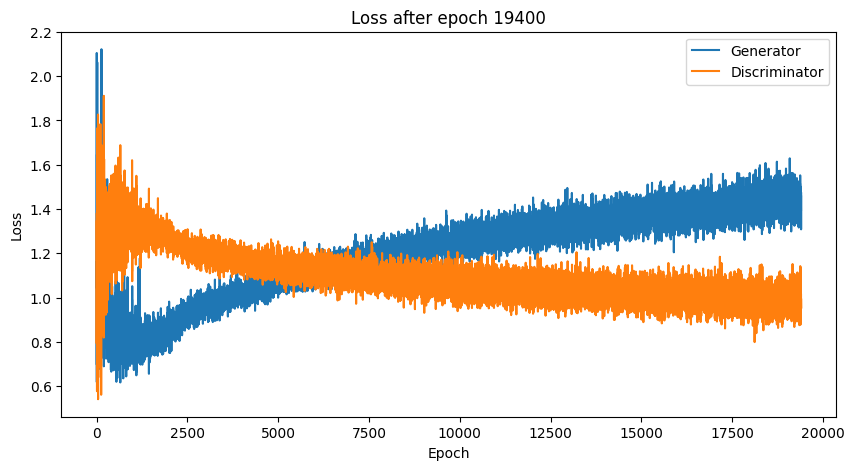

Time for epoch 19400 is 3.9471380710601807 sec
Time for epoch 19401 is 0.8587887287139893 sec
Time for epoch 19402 is 0.8622801303863525 sec
Time for epoch 19403 is 0.8653380870819092 sec
Time for epoch 19404 is 0.8657760620117188 sec
Time for epoch 19405 is 0.872556209564209 sec
Time for epoch 19406 is 0.8752522468566895 sec
Time for epoch 19407 is 0.872295618057251 sec
Time for epoch 19408 is 0.874713659286499 sec
Time for epoch 19409 is 0.8748733997344971 sec
Time for epoch 19410 is 0.8739559650421143 sec
Time for epoch 19411 is 0.8739144802093506 sec
Time for epoch 19412 is 0.8772404193878174 sec
Time for epoch 19413 is 0.8802943229675293 sec
Time for epoch 19414 is 0.8805007934570312 sec
Time for epoch 19415 is 0.8772611618041992 sec
Time for epoch 19416 is 0.878638744354248 sec
Time for epoch 19417 is 0.8779323101043701 sec
Time for epoch 19418 is 0.8825953006744385 sec
Time for epoch 19419 is 0.8802742958068848 sec
Time for epoch 19420 is 0.883751392364502 sec
Time for epoch 194

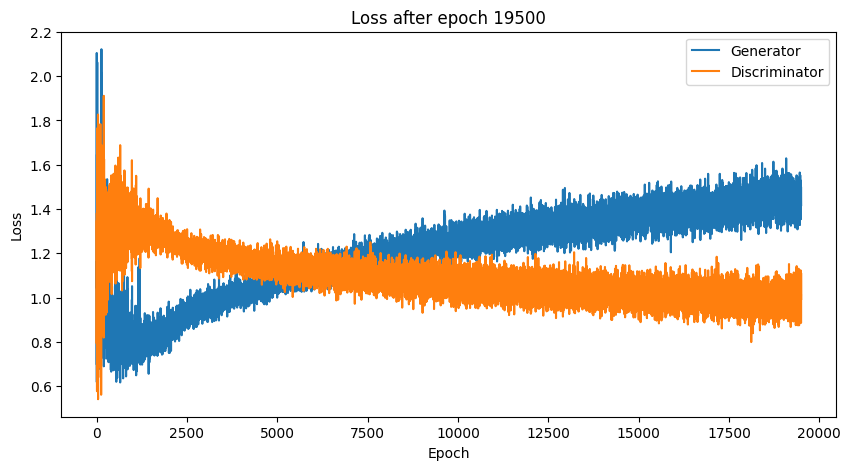

Time for epoch 19500 is 3.965977430343628 sec
Time for epoch 19501 is 0.8504660129547119 sec
Time for epoch 19502 is 0.860081672668457 sec
Time for epoch 19503 is 0.8655755519866943 sec
Time for epoch 19504 is 0.8658881187438965 sec
Time for epoch 19505 is 0.8803112506866455 sec
Time for epoch 19506 is 0.8735527992248535 sec
Time for epoch 19507 is 0.8681254386901855 sec
Time for epoch 19508 is 0.8714909553527832 sec
Time for epoch 19509 is 0.8727009296417236 sec
Time for epoch 19510 is 0.8733320236206055 sec
Time for epoch 19511 is 0.8789825439453125 sec
Time for epoch 19512 is 0.8794503211975098 sec
Time for epoch 19513 is 0.8791723251342773 sec
Time for epoch 19514 is 0.8784604072570801 sec
Time for epoch 19515 is 0.8814001083374023 sec
Time for epoch 19516 is 0.8806266784667969 sec
Time for epoch 19517 is 0.8801045417785645 sec
Time for epoch 19518 is 0.8828146457672119 sec
Time for epoch 19519 is 0.8821954727172852 sec
Time for epoch 19520 is 0.8860907554626465 sec
Time for epoch 

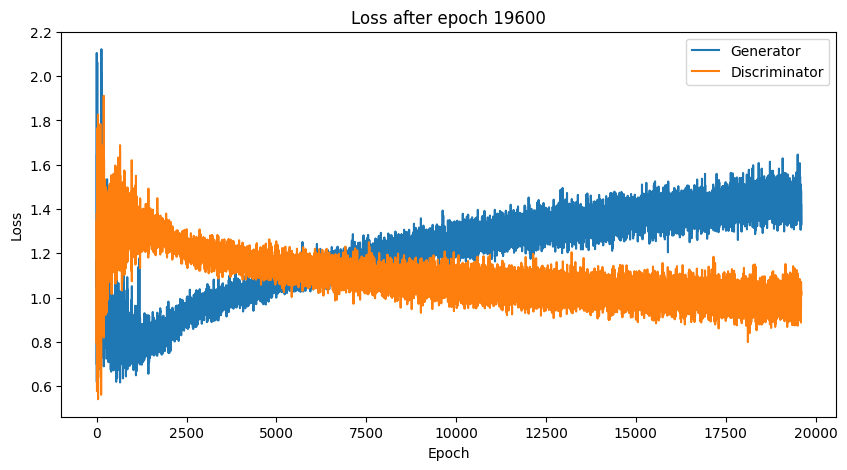

Time for epoch 19600 is 3.8995511531829834 sec
Time for epoch 19601 is 0.8538215160369873 sec
Time for epoch 19602 is 0.8619198799133301 sec
Time for epoch 19603 is 0.867072582244873 sec
Time for epoch 19604 is 0.8699221611022949 sec
Time for epoch 19605 is 0.8712887763977051 sec
Time for epoch 19606 is 0.8711543083190918 sec
Time for epoch 19607 is 0.8775193691253662 sec
Time for epoch 19608 is 0.8705501556396484 sec
Time for epoch 19609 is 0.8744921684265137 sec
Time for epoch 19610 is 0.8773097991943359 sec
Time for epoch 19611 is 0.888601541519165 sec
Time for epoch 19612 is 0.8758811950683594 sec
Time for epoch 19613 is 0.8764128684997559 sec
Time for epoch 19614 is 0.8790900707244873 sec
Time for epoch 19615 is 0.8824350833892822 sec
Time for epoch 19616 is 0.8739476203918457 sec
Time for epoch 19617 is 0.8818614482879639 sec
Time for epoch 19618 is 0.881676197052002 sec
Time for epoch 19619 is 0.8818008899688721 sec
Time for epoch 19620 is 0.8811631202697754 sec
Time for epoch 1

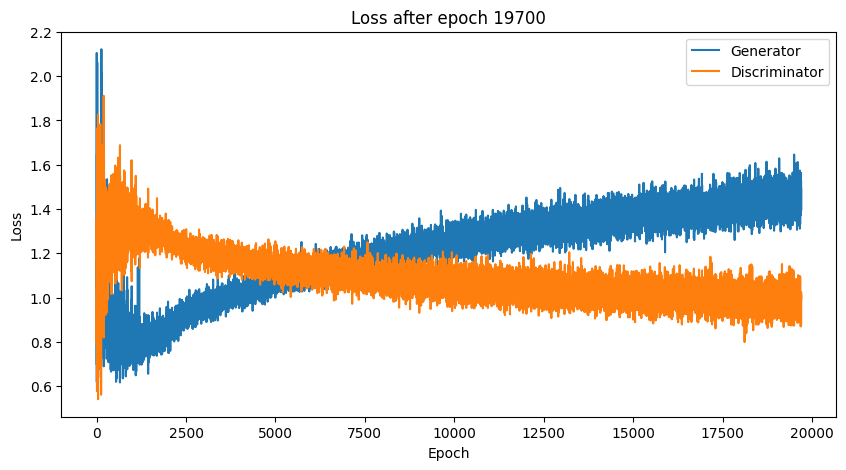

Time for epoch 19700 is 3.9656918048858643 sec
Time for epoch 19701 is 0.8699414730072021 sec
Time for epoch 19702 is 0.8570413589477539 sec
Time for epoch 19703 is 0.8633534908294678 sec
Time for epoch 19704 is 0.871819257736206 sec
Time for epoch 19705 is 0.8671526908874512 sec
Time for epoch 19706 is 0.8701117038726807 sec
Time for epoch 19707 is 0.8734889030456543 sec
Time for epoch 19708 is 0.8705191612243652 sec
Time for epoch 19709 is 0.8766751289367676 sec
Time for epoch 19710 is 0.8786711692810059 sec
Time for epoch 19711 is 0.8780536651611328 sec
Time for epoch 19712 is 0.8793900012969971 sec
Time for epoch 19713 is 0.8788924217224121 sec
Time for epoch 19714 is 0.8769857883453369 sec
Time for epoch 19715 is 0.8785314559936523 sec
Time for epoch 19716 is 0.8801991939544678 sec
Time for epoch 19717 is 0.8795993328094482 sec
Time for epoch 19718 is 0.8822989463806152 sec
Time for epoch 19719 is 0.8778128623962402 sec
Time for epoch 19720 is 0.8829317092895508 sec
Time for epoch

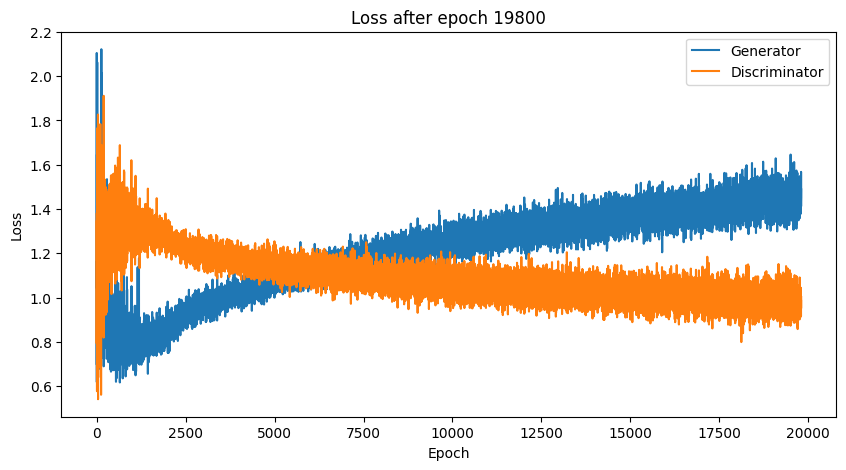

Time for epoch 19800 is 3.9465837478637695 sec
Time for epoch 19801 is 0.8508281707763672 sec
Time for epoch 19802 is 0.8653759956359863 sec
Time for epoch 19803 is 0.866807222366333 sec
Time for epoch 19804 is 0.8763537406921387 sec
Time for epoch 19805 is 0.8659486770629883 sec
Time for epoch 19806 is 0.8732430934906006 sec
Time for epoch 19807 is 0.8773610591888428 sec
Time for epoch 19808 is 0.8725912570953369 sec
Time for epoch 19809 is 0.8788423538208008 sec
Time for epoch 19810 is 0.8755426406860352 sec
Time for epoch 19811 is 0.8779842853546143 sec
Time for epoch 19812 is 0.8796341419219971 sec
Time for epoch 19813 is 0.879490852355957 sec
Time for epoch 19814 is 0.8754017353057861 sec
Time for epoch 19815 is 0.887761116027832 sec
Time for epoch 19816 is 0.8817863464355469 sec
Time for epoch 19817 is 0.8755810260772705 sec
Time for epoch 19818 is 0.8856384754180908 sec
Time for epoch 19819 is 0.8783023357391357 sec
Time for epoch 19820 is 0.883765459060669 sec
Time for epoch 19

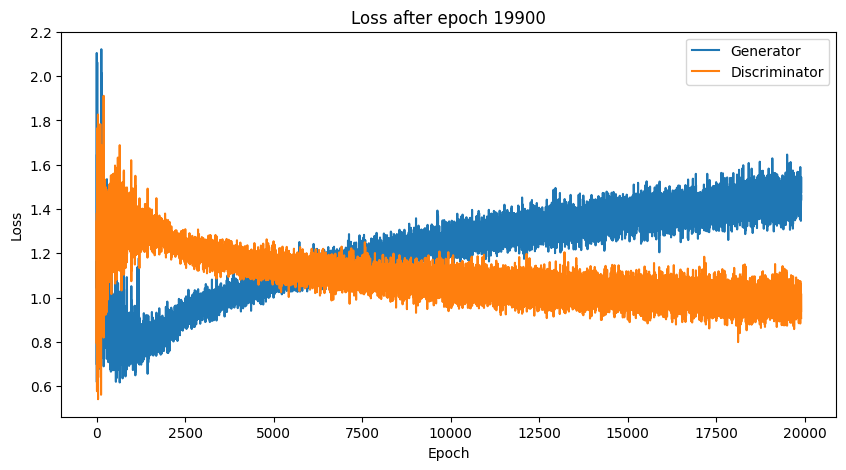

Time for epoch 19900 is 3.9010159969329834 sec
Time for epoch 19901 is 0.8647105693817139 sec
Time for epoch 19902 is 0.8613178730010986 sec
Time for epoch 19903 is 0.8669087886810303 sec
Time for epoch 19904 is 0.8621561527252197 sec
Time for epoch 19905 is 0.8721702098846436 sec
Time for epoch 19906 is 0.8698718547821045 sec
Time for epoch 19907 is 0.8777854442596436 sec
Time for epoch 19908 is 0.8726682662963867 sec
Time for epoch 19909 is 0.8686244487762451 sec
Time for epoch 19910 is 0.8770613670349121 sec
Time for epoch 19911 is 0.8781988620758057 sec
Time for epoch 19912 is 0.8755228519439697 sec
Time for epoch 19913 is 0.8779993057250977 sec
Time for epoch 19914 is 0.879993200302124 sec
Time for epoch 19915 is 0.8835270404815674 sec
Time for epoch 19916 is 0.8769493103027344 sec
Time for epoch 19917 is 0.8811025619506836 sec
Time for epoch 19918 is 0.8817880153656006 sec
Time for epoch 19919 is 0.881819486618042 sec
Time for epoch 19920 is 0.8790485858917236 sec
Time for epoch 

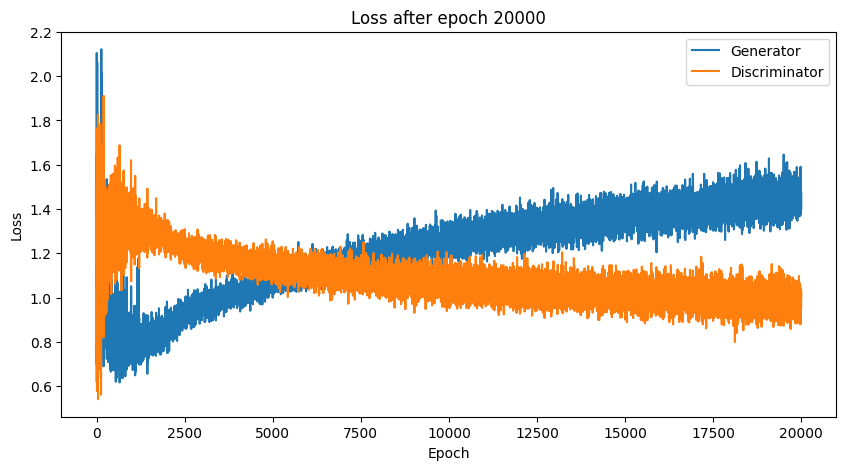

Time for epoch 20000 is 3.8840746879577637 sec
Time for epoch 20001 is 0.8683712482452393 sec
Time for epoch 20002 is 0.858452558517456 sec
Time for epoch 20003 is 0.8659243583679199 sec
Time for epoch 20004 is 0.8690879344940186 sec
Time for epoch 20005 is 0.8677129745483398 sec
Time for epoch 20006 is 0.8848516941070557 sec
Time for epoch 20007 is 0.8732256889343262 sec
Time for epoch 20008 is 0.8759622573852539 sec
Time for epoch 20009 is 0.8738114833831787 sec
Time for epoch 20010 is 0.8781895637512207 sec
Time for epoch 20011 is 0.8741929531097412 sec
Time for epoch 20012 is 0.8764371871948242 sec
Time for epoch 20013 is 0.8773469924926758 sec
Time for epoch 20014 is 0.8797805309295654 sec
Time for epoch 20015 is 0.8794457912445068 sec
Time for epoch 20016 is 0.8760666847229004 sec
Time for epoch 20017 is 0.877295732498169 sec
Time for epoch 20018 is 0.8818454742431641 sec
Time for epoch 20019 is 0.8820540904998779 sec
Time for epoch 20020 is 0.8781447410583496 sec
Time for epoch 

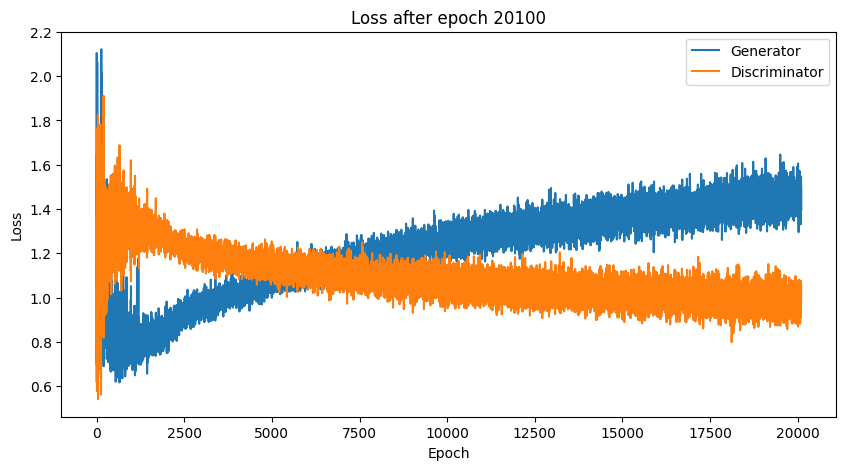

Time for epoch 20100 is 3.9503862857818604 sec
Time for epoch 20101 is 0.8541975021362305 sec
Time for epoch 20102 is 0.8640577793121338 sec
Time for epoch 20103 is 0.8686935901641846 sec
Time for epoch 20104 is 0.8650107383728027 sec
Time for epoch 20105 is 0.8703939914703369 sec
Time for epoch 20106 is 0.8730654716491699 sec
Time for epoch 20107 is 0.8731062412261963 sec
Time for epoch 20108 is 0.8769576549530029 sec
Time for epoch 20109 is 0.8743906021118164 sec
Time for epoch 20110 is 0.8717129230499268 sec
Time for epoch 20111 is 0.8782236576080322 sec
Time for epoch 20112 is 0.8771030902862549 sec
Time for epoch 20113 is 0.8772175312042236 sec
Time for epoch 20114 is 0.8749854564666748 sec
Time for epoch 20115 is 0.8789548873901367 sec
Time for epoch 20116 is 0.8815908432006836 sec
Time for epoch 20117 is 0.8758080005645752 sec
Time for epoch 20118 is 0.8867969512939453 sec
Time for epoch 20119 is 0.8772575855255127 sec
Time for epoch 20120 is 0.8833112716674805 sec
Time for epoc

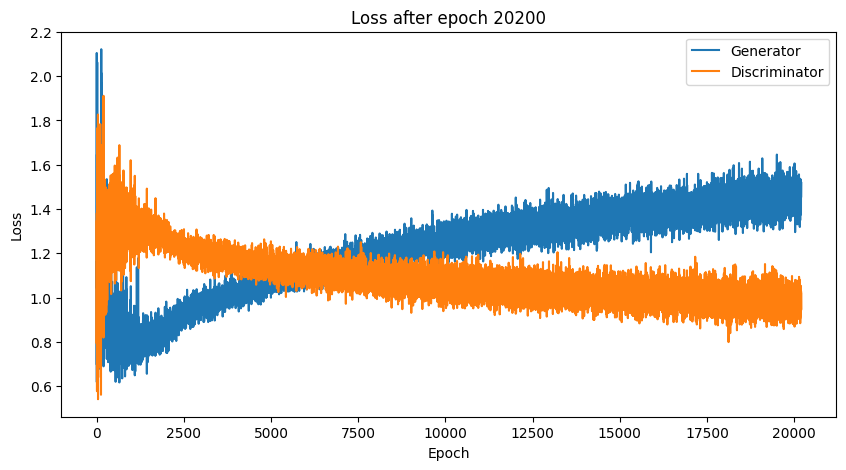

Time for epoch 20200 is 3.952880859375 sec
Time for epoch 20201 is 0.8455545902252197 sec
Time for epoch 20202 is 0.8622467517852783 sec
Time for epoch 20203 is 0.863579511642456 sec
Time for epoch 20204 is 0.868619441986084 sec
Time for epoch 20205 is 0.8746340274810791 sec
Time for epoch 20206 is 0.8698868751525879 sec
Time for epoch 20207 is 0.8714594841003418 sec
Time for epoch 20208 is 0.8650517463684082 sec
Time for epoch 20209 is 0.8771514892578125 sec
Time for epoch 20210 is 0.8700544834136963 sec
Time for epoch 20211 is 0.8786022663116455 sec
Time for epoch 20212 is 0.8778471946716309 sec
Time for epoch 20213 is 0.8777287006378174 sec
Time for epoch 20214 is 0.878014087677002 sec
Time for epoch 20215 is 0.8791725635528564 sec
Time for epoch 20216 is 0.8786344528198242 sec
Time for epoch 20217 is 0.8860723972320557 sec
Time for epoch 20218 is 0.8779032230377197 sec
Time for epoch 20219 is 0.8800275325775146 sec
Time for epoch 20220 is 0.8791217803955078 sec
Time for epoch 20221

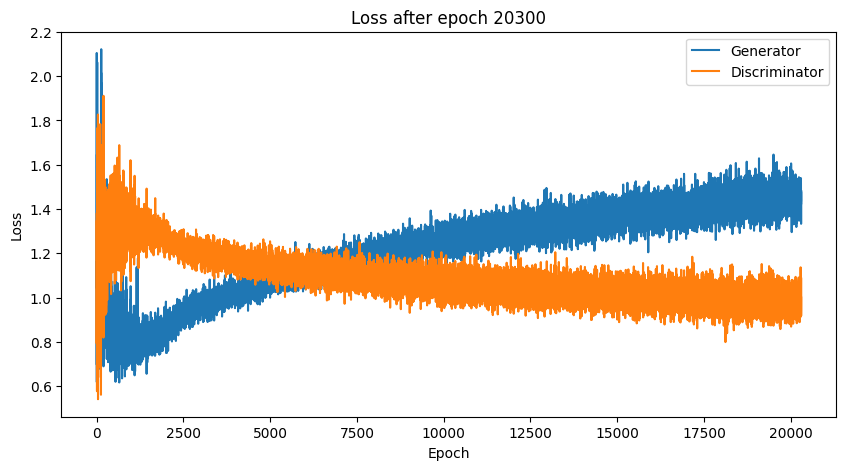

Time for epoch 20300 is 3.93479323387146 sec
Time for epoch 20301 is 0.8618819713592529 sec
Time for epoch 20302 is 0.8622519969940186 sec
Time for epoch 20303 is 0.8686692714691162 sec
Time for epoch 20304 is 0.8675117492675781 sec
Time for epoch 20305 is 0.8706445693969727 sec
Time for epoch 20306 is 0.8738470077514648 sec
Time for epoch 20307 is 0.8766982555389404 sec
Time for epoch 20308 is 0.8715357780456543 sec
Time for epoch 20309 is 0.8790552616119385 sec
Time for epoch 20310 is 0.8746426105499268 sec
Time for epoch 20311 is 0.8725783824920654 sec
Time for epoch 20312 is 0.8769485950469971 sec
Time for epoch 20313 is 0.8761742115020752 sec
Time for epoch 20314 is 0.8824079036712646 sec
Time for epoch 20315 is 0.8760256767272949 sec
Time for epoch 20316 is 0.883101224899292 sec
Time for epoch 20317 is 0.8834130764007568 sec
Time for epoch 20318 is 0.8791055679321289 sec
Time for epoch 20319 is 0.8813669681549072 sec
Time for epoch 20320 is 0.8771915435791016 sec
Time for epoch 2

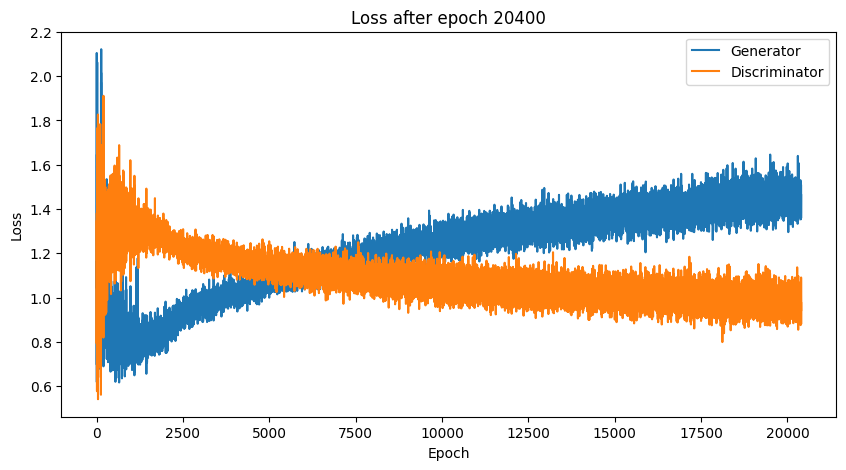

Time for epoch 20400 is 3.9219915866851807 sec
Time for epoch 20401 is 0.8586180210113525 sec
Time for epoch 20402 is 0.8709886074066162 sec
Time for epoch 20403 is 0.867506742477417 sec
Time for epoch 20404 is 0.8626561164855957 sec
Time for epoch 20405 is 0.8708715438842773 sec
Time for epoch 20406 is 0.8726162910461426 sec
Time for epoch 20407 is 0.8775601387023926 sec
Time for epoch 20408 is 0.8709683418273926 sec
Time for epoch 20409 is 0.8747529983520508 sec
Time for epoch 20410 is 1.265096664428711 sec
Time for epoch 20411 is 0.8586263656616211 sec
Time for epoch 20412 is 0.8710629940032959 sec
Time for epoch 20413 is 0.8749127388000488 sec
Time for epoch 20414 is 0.8785247802734375 sec
Time for epoch 20415 is 0.8776707649230957 sec
Time for epoch 20416 is 0.8737196922302246 sec
Time for epoch 20417 is 0.8825664520263672 sec
Time for epoch 20418 is 0.8813364505767822 sec
Time for epoch 20419 is 0.8818120956420898 sec
Time for epoch 20420 is 0.8809418678283691 sec
Time for epoch 

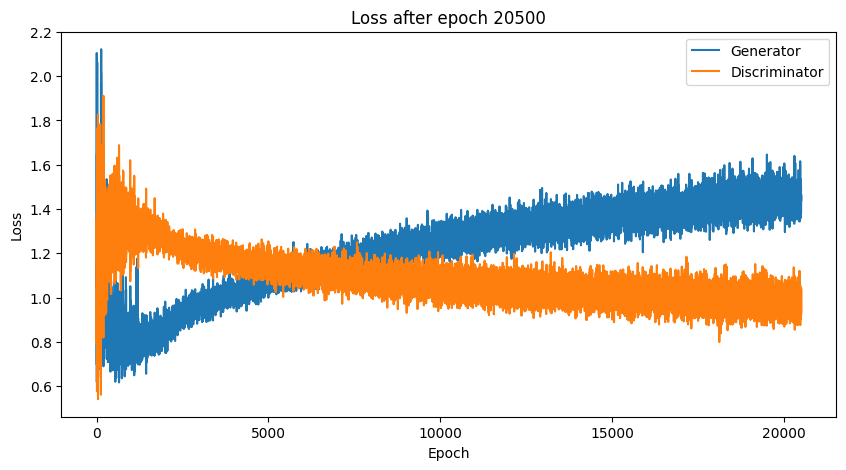

Time for epoch 20500 is 3.95866322517395 sec
Time for epoch 20501 is 0.8548517227172852 sec
Time for epoch 20502 is 0.8611772060394287 sec
Time for epoch 20503 is 0.8650779724121094 sec
Time for epoch 20504 is 0.8679513931274414 sec
Time for epoch 20505 is 0.8715112209320068 sec
Time for epoch 20506 is 0.8722708225250244 sec
Time for epoch 20507 is 0.8704001903533936 sec
Time for epoch 20508 is 0.8758366107940674 sec
Time for epoch 20509 is 0.8702747821807861 sec
Time for epoch 20510 is 0.8725483417510986 sec
Time for epoch 20511 is 0.8803277015686035 sec
Time for epoch 20512 is 0.8833754062652588 sec
Time for epoch 20513 is 0.8773412704467773 sec
Time for epoch 20514 is 0.8791635036468506 sec
Time for epoch 20515 is 0.8808629512786865 sec
Time for epoch 20516 is 0.8800933361053467 sec
Time for epoch 20517 is 0.8751862049102783 sec
Time for epoch 20518 is 0.885162353515625 sec
Time for epoch 20519 is 0.8854520320892334 sec
Time for epoch 20520 is 0.8772737979888916 sec
Time for epoch 2

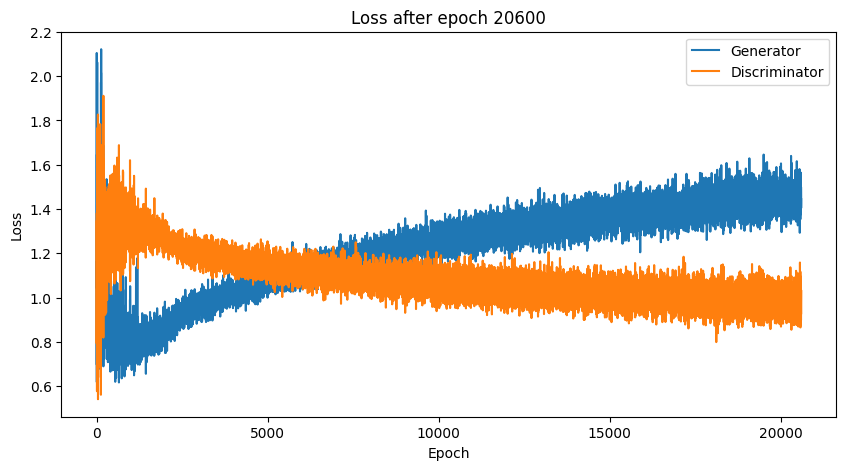

Time for epoch 20600 is 3.9847848415374756 sec
Time for epoch 20601 is 0.8500163555145264 sec
Time for epoch 20602 is 0.8609700202941895 sec
Time for epoch 20603 is 0.8623108863830566 sec
Time for epoch 20604 is 0.8676440715789795 sec
Time for epoch 20605 is 0.8705594539642334 sec
Time for epoch 20606 is 0.8740723133087158 sec
Time for epoch 20607 is 0.8686625957489014 sec
Time for epoch 20608 is 0.875798225402832 sec
Time for epoch 20609 is 0.8763115406036377 sec
Time for epoch 20610 is 0.8697497844696045 sec
Time for epoch 20611 is 0.8782038688659668 sec
Time for epoch 20612 is 0.8782920837402344 sec
Time for epoch 20613 is 0.877871036529541 sec
Time for epoch 20614 is 0.8761985301971436 sec
Time for epoch 20615 is 0.8796923160552979 sec
Time for epoch 20616 is 0.8742382526397705 sec
Time for epoch 20617 is 0.8837594985961914 sec
Time for epoch 20618 is 0.8819389343261719 sec
Time for epoch 20619 is 0.8829944133758545 sec
Time for epoch 20620 is 0.880424976348877 sec
Time for epoch 2

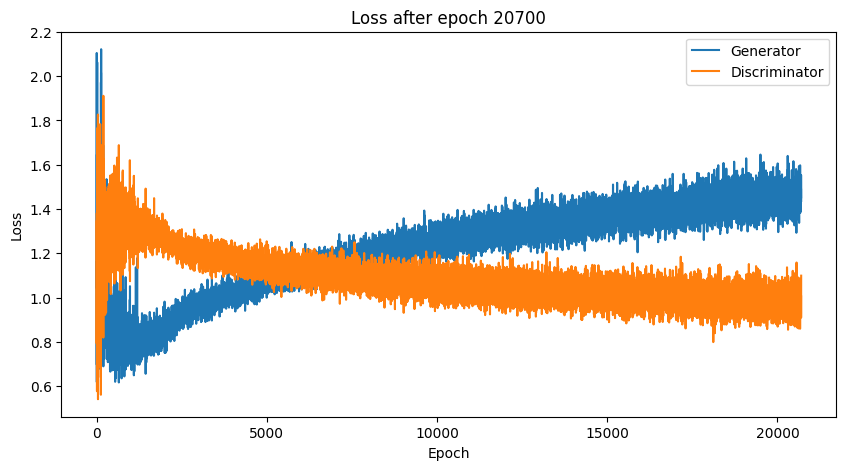

Time for epoch 20700 is 3.936906576156616 sec
Time for epoch 20701 is 0.8544793128967285 sec
Time for epoch 20702 is 0.8667914867401123 sec
Time for epoch 20703 is 0.8644382953643799 sec
Time for epoch 20704 is 0.8623898029327393 sec
Time for epoch 20705 is 0.869584321975708 sec
Time for epoch 20706 is 0.8710818290710449 sec
Time for epoch 20707 is 0.8719346523284912 sec
Time for epoch 20708 is 0.8714644908905029 sec
Time for epoch 20709 is 0.876420259475708 sec
Time for epoch 20710 is 0.8750543594360352 sec
Time for epoch 20711 is 0.8774402141571045 sec
Time for epoch 20712 is 0.8755016326904297 sec
Time for epoch 20713 is 0.8772256374359131 sec
Time for epoch 20714 is 0.8769125938415527 sec
Time for epoch 20715 is 0.8785176277160645 sec
Time for epoch 20716 is 0.8800270557403564 sec
Time for epoch 20717 is 0.8757617473602295 sec
Time for epoch 20718 is 0.8801617622375488 sec
Time for epoch 20719 is 0.8822658061981201 sec
Time for epoch 20720 is 0.8782625198364258 sec
Time for epoch 2

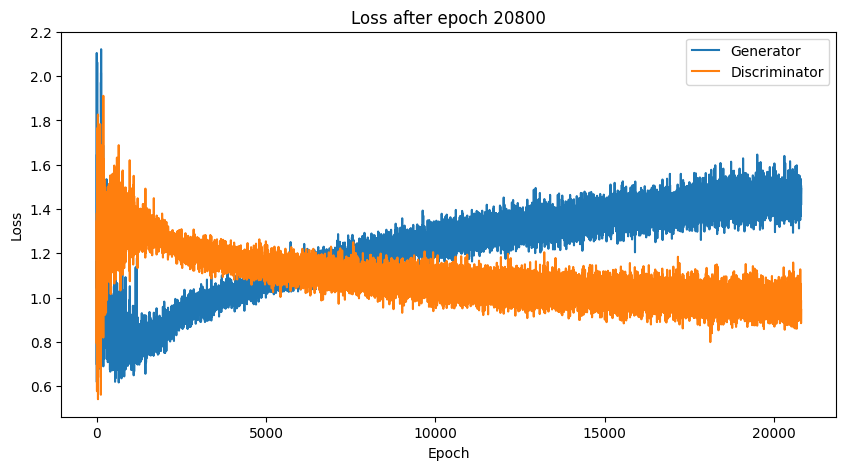

Time for epoch 20800 is 3.8901875019073486 sec
Time for epoch 20801 is 0.8643448352813721 sec
Time for epoch 20802 is 0.8628120422363281 sec
Time for epoch 20803 is 0.8638331890106201 sec
Time for epoch 20804 is 0.8712482452392578 sec
Time for epoch 20805 is 0.8644289970397949 sec
Time for epoch 20806 is 0.8697097301483154 sec
Time for epoch 20807 is 0.8759379386901855 sec
Time for epoch 20808 is 0.8724422454833984 sec
Time for epoch 20809 is 0.8761003017425537 sec
Time for epoch 20810 is 0.8734164237976074 sec
Time for epoch 20811 is 0.8768982887268066 sec
Time for epoch 20812 is 0.8771774768829346 sec
Time for epoch 20813 is 0.8733947277069092 sec
Time for epoch 20814 is 0.8781471252441406 sec
Time for epoch 20815 is 0.8784959316253662 sec
Time for epoch 20816 is 0.8818554878234863 sec
Time for epoch 20817 is 0.8788230419158936 sec
Time for epoch 20818 is 0.880143404006958 sec
Time for epoch 20819 is 0.8822891712188721 sec
Time for epoch 20820 is 0.8776018619537354 sec
Time for epoch

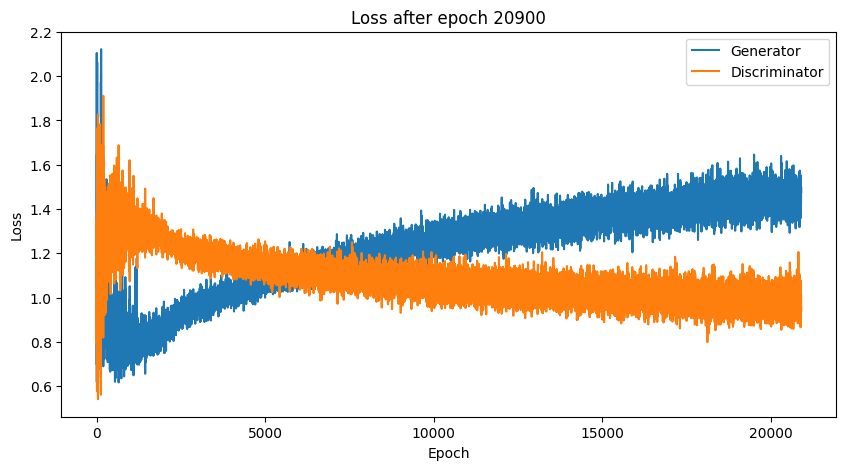

Time for epoch 20900 is 3.9549498558044434 sec
Time for epoch 20901 is 0.8636343479156494 sec
Time for epoch 20902 is 0.8602335453033447 sec
Time for epoch 20903 is 0.8625717163085938 sec
Time for epoch 20904 is 0.8677642345428467 sec
Time for epoch 20905 is 0.8724751472473145 sec
Time for epoch 20906 is 0.8709383010864258 sec
Time for epoch 20907 is 0.8701162338256836 sec
Time for epoch 20908 is 0.874565839767456 sec
Time for epoch 20909 is 0.8738024234771729 sec
Time for epoch 20910 is 0.874995231628418 sec
Time for epoch 20911 is 0.8760182857513428 sec
Time for epoch 20912 is 0.8787457942962646 sec
Time for epoch 20913 is 0.8753764629364014 sec
Time for epoch 20914 is 0.8757784366607666 sec
Time for epoch 20915 is 0.8814918994903564 sec
Time for epoch 20916 is 0.8794267177581787 sec
Time for epoch 20917 is 0.8833532333374023 sec
Time for epoch 20918 is 0.8806567192077637 sec
Time for epoch 20919 is 0.885918140411377 sec
Time for epoch 20920 is 0.8859503269195557 sec
Time for epoch 2

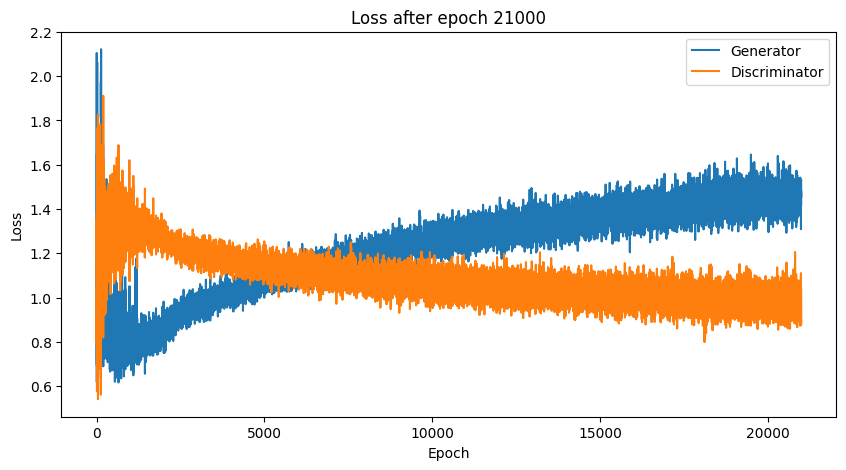

Time for epoch 21000 is 3.9666779041290283 sec
Time for epoch 21001 is 0.860327959060669 sec
Time for epoch 21002 is 0.8630132675170898 sec
Time for epoch 21003 is 0.8632099628448486 sec
Time for epoch 21004 is 0.8641355037689209 sec
Time for epoch 21005 is 0.8708159923553467 sec
Time for epoch 21006 is 0.8711721897125244 sec
Time for epoch 21007 is 0.8748226165771484 sec
Time for epoch 21008 is 0.8686003684997559 sec
Time for epoch 21009 is 0.87815260887146 sec
Time for epoch 21010 is 0.8750660419464111 sec
Time for epoch 21011 is 0.8787076473236084 sec
Time for epoch 21012 is 0.8785991668701172 sec
Time for epoch 21013 is 0.8759827613830566 sec
Time for epoch 21014 is 0.8773760795593262 sec
Time for epoch 21015 is 0.8783788681030273 sec
Time for epoch 21016 is 0.8801224231719971 sec
Time for epoch 21017 is 0.8814406394958496 sec
Time for epoch 21018 is 0.8796858787536621 sec
Time for epoch 21019 is 0.8774864673614502 sec
Time for epoch 21020 is 0.8846762180328369 sec
Time for epoch 2

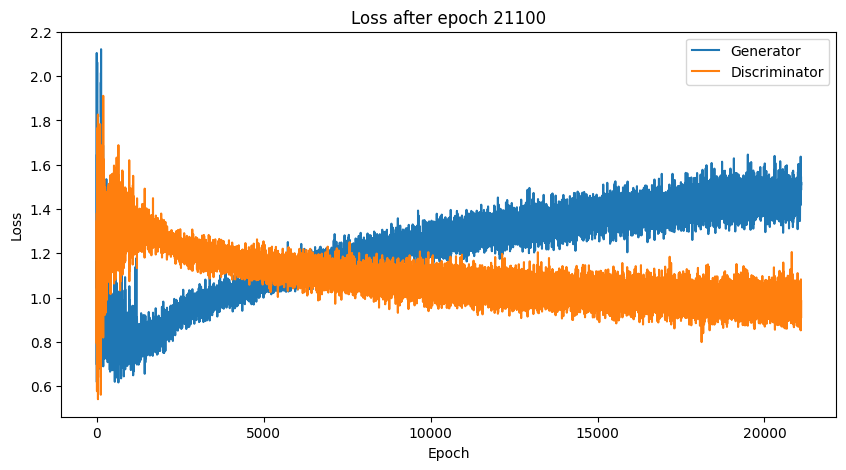

Time for epoch 21100 is 3.9510834217071533 sec
Time for epoch 21101 is 0.8612673282623291 sec
Time for epoch 21102 is 0.8657839298248291 sec
Time for epoch 21103 is 0.8639383316040039 sec
Time for epoch 21104 is 0.8711097240447998 sec
Time for epoch 21105 is 0.8705487251281738 sec
Time for epoch 21106 is 0.8750085830688477 sec
Time for epoch 21107 is 0.8664894104003906 sec
Time for epoch 21108 is 0.8784894943237305 sec
Time for epoch 21109 is 0.8739304542541504 sec
Time for epoch 21110 is 0.8742406368255615 sec
Time for epoch 21111 is 0.8799726963043213 sec
Time for epoch 21112 is 0.8827106952667236 sec
Time for epoch 21113 is 0.8754541873931885 sec
Time for epoch 21114 is 0.8800821304321289 sec
Time for epoch 21115 is 0.8796408176422119 sec
Time for epoch 21116 is 0.8776960372924805 sec
Time for epoch 21117 is 0.8782470226287842 sec
Time for epoch 21118 is 0.8821430206298828 sec
Time for epoch 21119 is 0.8784749507904053 sec
Time for epoch 21120 is 0.8794686794281006 sec
Time for epoc

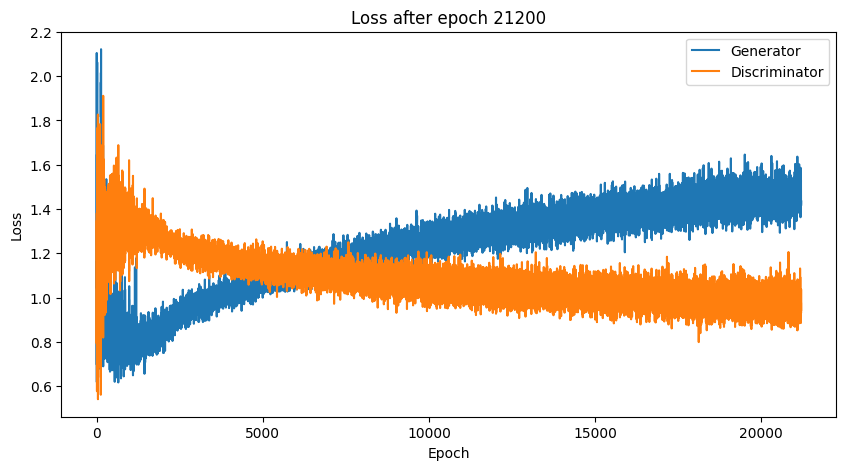

Time for epoch 21200 is 3.9760899543762207 sec
Time for epoch 21201 is 0.8554959297180176 sec
Time for epoch 21202 is 0.8677704334259033 sec
Time for epoch 21203 is 0.8611869812011719 sec
Time for epoch 21204 is 0.8686809539794922 sec
Time for epoch 21205 is 0.8694148063659668 sec
Time for epoch 21206 is 0.8723552227020264 sec
Time for epoch 21207 is 0.8729279041290283 sec
Time for epoch 21208 is 0.871769905090332 sec
Time for epoch 21209 is 0.8735740184783936 sec
Time for epoch 21210 is 0.8792505264282227 sec
Time for epoch 21211 is 0.8744213581085205 sec
Time for epoch 21212 is 0.875516414642334 sec
Time for epoch 21213 is 0.8776891231536865 sec
Time for epoch 21214 is 0.8748669624328613 sec
Time for epoch 21215 is 0.8799839019775391 sec
Time for epoch 21216 is 0.8827559947967529 sec
Time for epoch 21217 is 0.8804216384887695 sec
Time for epoch 21218 is 0.8780038356781006 sec
Time for epoch 21219 is 0.8783924579620361 sec
Time for epoch 21220 is 0.8804008960723877 sec
Time for epoch 

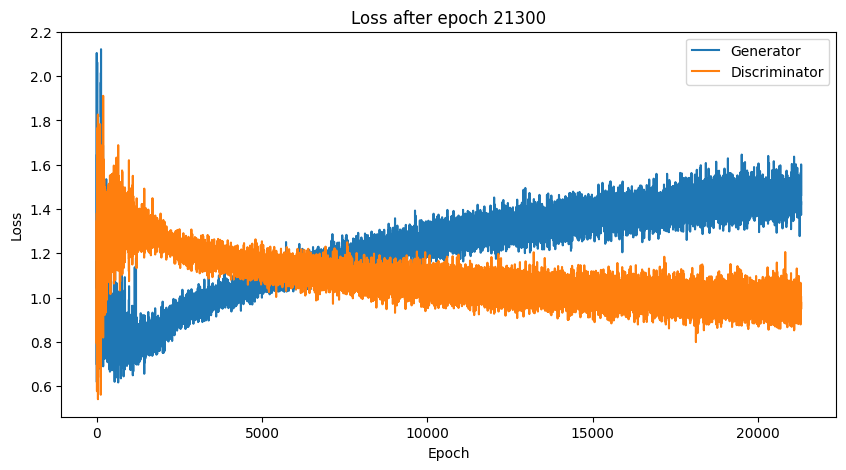

Time for epoch 21300 is 3.9670605659484863 sec
Time for epoch 21301 is 0.8540380001068115 sec
Time for epoch 21302 is 0.8641014099121094 sec
Time for epoch 21303 is 0.8668527603149414 sec
Time for epoch 21304 is 0.8624274730682373 sec
Time for epoch 21305 is 0.871304988861084 sec
Time for epoch 21306 is 0.8759891986846924 sec
Time for epoch 21307 is 0.8734121322631836 sec
Time for epoch 21308 is 0.8687400817871094 sec
Time for epoch 21309 is 0.8776230812072754 sec
Time for epoch 21310 is 0.8744609355926514 sec
Time for epoch 21311 is 0.8776347637176514 sec
Time for epoch 21312 is 0.8769106864929199 sec
Time for epoch 21313 is 0.8789572715759277 sec
Time for epoch 21314 is 0.8806376457214355 sec
Time for epoch 21315 is 0.8820390701293945 sec
Time for epoch 21316 is 0.877349853515625 sec
Time for epoch 21317 is 0.8789749145507812 sec
Time for epoch 21318 is 0.8822519779205322 sec
Time for epoch 21319 is 0.8781449794769287 sec
Time for epoch 21320 is 0.8815789222717285 sec
Time for epoch 

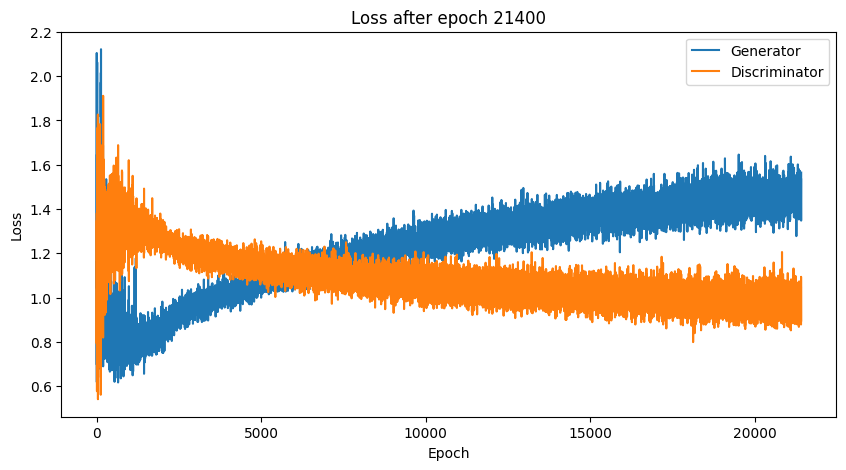

Time for epoch 21400 is 3.9496066570281982 sec
Time for epoch 21401 is 0.8544678688049316 sec
Time for epoch 21402 is 0.8629944324493408 sec
Time for epoch 21403 is 0.8628933429718018 sec
Time for epoch 21404 is 0.8653526306152344 sec
Time for epoch 21405 is 0.8683245182037354 sec
Time for epoch 21406 is 0.8745489120483398 sec
Time for epoch 21407 is 0.8683836460113525 sec
Time for epoch 21408 is 0.8733067512512207 sec
Time for epoch 21409 is 0.8781135082244873 sec
Time for epoch 21410 is 0.87093186378479 sec
Time for epoch 21411 is 0.8775856494903564 sec
Time for epoch 21412 is 0.8783767223358154 sec
Time for epoch 21413 is 0.880683183670044 sec
Time for epoch 21414 is 0.8818647861480713 sec
Time for epoch 21415 is 0.8785161972045898 sec
Time for epoch 21416 is 0.8810498714447021 sec
Time for epoch 21417 is 0.8792896270751953 sec
Time for epoch 21418 is 0.8797738552093506 sec
Time for epoch 21419 is 0.8821909427642822 sec
Time for epoch 21420 is 0.8810341358184814 sec
Time for epoch 2

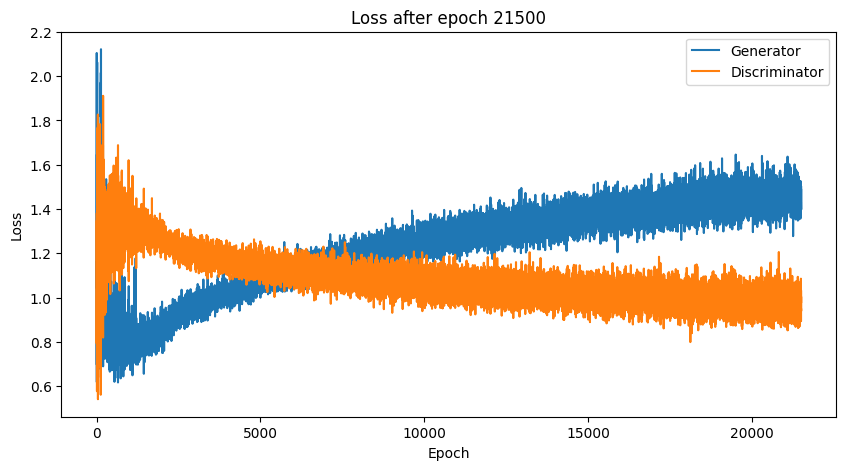

Time for epoch 21500 is 3.972052812576294 sec
Time for epoch 21501 is 0.8765304088592529 sec
Time for epoch 21502 is 0.8603560924530029 sec
Time for epoch 21503 is 0.86678147315979 sec
Time for epoch 21504 is 0.8649797439575195 sec
Time for epoch 21505 is 0.872617244720459 sec
Time for epoch 21506 is 0.8715097904205322 sec
Time for epoch 21507 is 0.8705995082855225 sec
Time for epoch 21508 is 0.8807961940765381 sec
Time for epoch 21509 is 0.8765225410461426 sec
Time for epoch 21510 is 0.8720121383666992 sec
Time for epoch 21511 is 0.8762593269348145 sec
Time for epoch 21512 is 0.8782544136047363 sec
Time for epoch 21513 is 0.880868673324585 sec
Time for epoch 21514 is 0.8774535655975342 sec
Time for epoch 21515 is 0.876227855682373 sec
Time for epoch 21516 is 0.8834178447723389 sec
Time for epoch 21517 is 0.8781225681304932 sec
Time for epoch 21518 is 0.8780367374420166 sec
Time for epoch 21519 is 0.8835070133209229 sec
Time for epoch 21520 is 0.880441427230835 sec
Time for epoch 21521

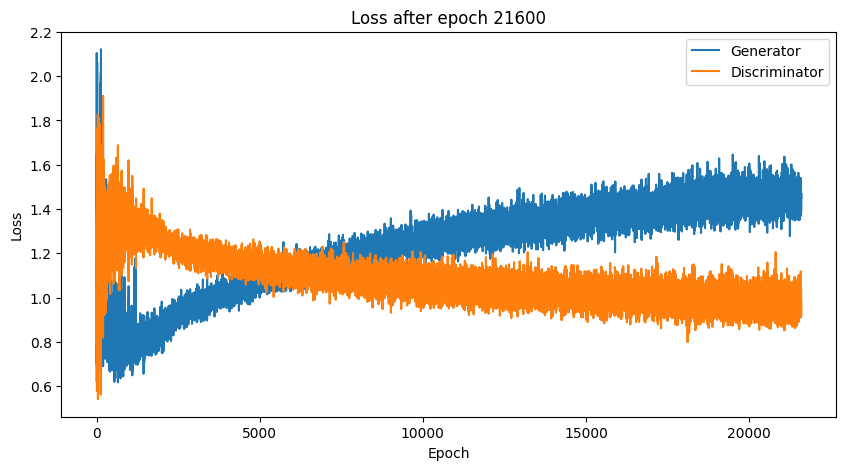

Time for epoch 21600 is 4.008057355880737 sec
Time for epoch 21601 is 0.8656125068664551 sec
Time for epoch 21602 is 0.8591759204864502 sec
Time for epoch 21603 is 0.8680651187896729 sec
Time for epoch 21604 is 0.8650200366973877 sec
Time for epoch 21605 is 0.8647184371948242 sec
Time for epoch 21606 is 0.870908260345459 sec
Time for epoch 21607 is 0.8742797374725342 sec
Time for epoch 21608 is 0.8710484504699707 sec
Time for epoch 21609 is 0.8745222091674805 sec
Time for epoch 21610 is 0.8741300106048584 sec
Time for epoch 21611 is 0.8752062320709229 sec
Time for epoch 21612 is 0.8752388954162598 sec
Time for epoch 21613 is 0.8851735591888428 sec
Time for epoch 21614 is 0.8764441013336182 sec
Time for epoch 21615 is 0.8758270740509033 sec
Time for epoch 21616 is 0.8800547122955322 sec
Time for epoch 21617 is 0.8807425498962402 sec
Time for epoch 21618 is 0.8819513320922852 sec
Time for epoch 21619 is 0.8871500492095947 sec
Time for epoch 21620 is 0.8778541088104248 sec
Time for epoch 

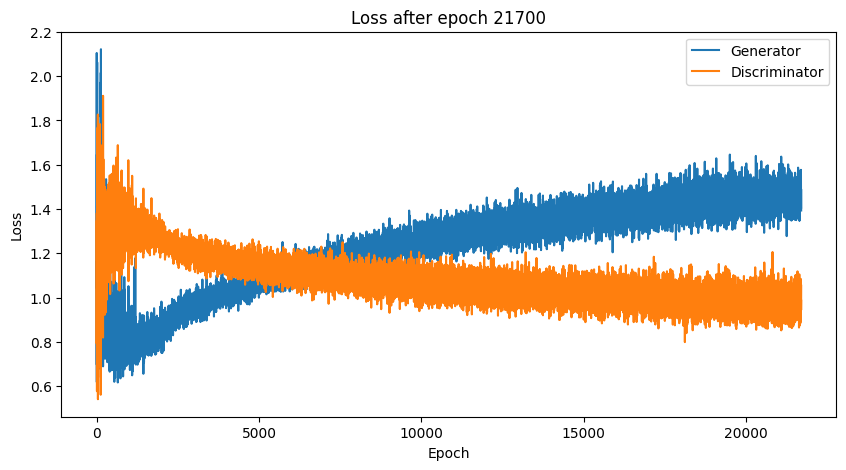

Time for epoch 21700 is 3.9777679443359375 sec
Time for epoch 21701 is 0.8548223972320557 sec
Time for epoch 21702 is 0.8609511852264404 sec
Time for epoch 21703 is 0.8656361103057861 sec
Time for epoch 21704 is 0.8683385848999023 sec
Time for epoch 21705 is 0.871598482131958 sec
Time for epoch 21706 is 0.8672869205474854 sec
Time for epoch 21707 is 0.8753376007080078 sec
Time for epoch 21708 is 0.875227689743042 sec
Time for epoch 21709 is 0.8727414608001709 sec
Time for epoch 21710 is 0.8775804042816162 sec
Time for epoch 21711 is 0.8716621398925781 sec
Time for epoch 21712 is 0.879033088684082 sec
Time for epoch 21713 is 0.881253719329834 sec
Time for epoch 21714 is 0.8895902633666992 sec
Time for epoch 21715 is 0.8760805130004883 sec
Time for epoch 21716 is 0.8776705265045166 sec
Time for epoch 21717 is 0.8779425621032715 sec
Time for epoch 21718 is 0.8801999092102051 sec
Time for epoch 21719 is 0.8863215446472168 sec
Time for epoch 21720 is 0.88010573387146 sec
Time for epoch 2172

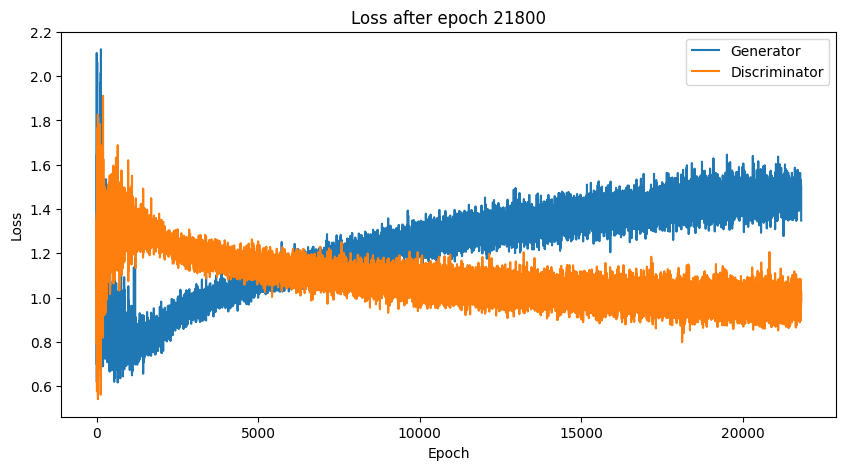

Time for epoch 21800 is 4.000132083892822 sec
Time for epoch 21801 is 0.854780912399292 sec
Time for epoch 21802 is 0.8645181655883789 sec
Time for epoch 21803 is 0.8674709796905518 sec
Time for epoch 21804 is 0.866574764251709 sec
Time for epoch 21805 is 0.873415470123291 sec
Time for epoch 21806 is 0.8704812526702881 sec
Time for epoch 21807 is 0.8660275936126709 sec
Time for epoch 21808 is 0.8736929893493652 sec
Time for epoch 21809 is 0.8746974468231201 sec
Time for epoch 21810 is 0.8729722499847412 sec
Time for epoch 21811 is 0.8768482208251953 sec
Time for epoch 21812 is 0.8766944408416748 sec
Time for epoch 21813 is 0.8749346733093262 sec
Time for epoch 21814 is 0.878551721572876 sec
Time for epoch 21815 is 0.8776373863220215 sec
Time for epoch 21816 is 0.8807387351989746 sec
Time for epoch 21817 is 0.8794004917144775 sec
Time for epoch 21818 is 0.880927324295044 sec
Time for epoch 21819 is 0.88262939453125 sec
Time for epoch 21820 is 0.8831110000610352 sec
Time for epoch 21821 

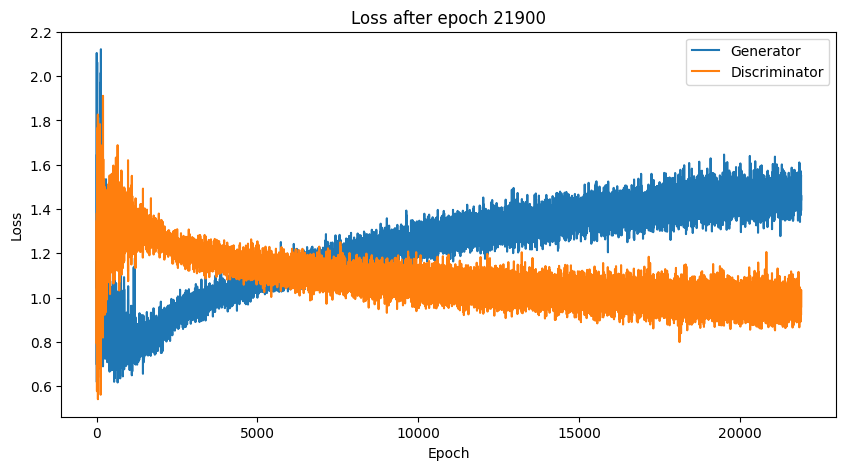

Time for epoch 21900 is 3.967359781265259 sec
Time for epoch 21901 is 0.8599419593811035 sec
Time for epoch 21902 is 0.861149787902832 sec
Time for epoch 21903 is 0.8637857437133789 sec
Time for epoch 21904 is 0.8702352046966553 sec
Time for epoch 21905 is 0.8679471015930176 sec
Time for epoch 21906 is 0.8769769668579102 sec
Time for epoch 21907 is 0.8677198886871338 sec
Time for epoch 21908 is 0.8826785087585449 sec
Time for epoch 21909 is 0.8722550868988037 sec
Time for epoch 21910 is 0.8752322196960449 sec
Time for epoch 21911 is 0.8741006851196289 sec
Time for epoch 21912 is 0.8803491592407227 sec
Time for epoch 21913 is 0.8763813972473145 sec
Time for epoch 21914 is 0.8763258457183838 sec
Time for epoch 21915 is 0.8754186630249023 sec
Time for epoch 21916 is 0.8799078464508057 sec
Time for epoch 21917 is 0.876286506652832 sec
Time for epoch 21918 is 0.8814976215362549 sec
Time for epoch 21919 is 0.8779342174530029 sec
Time for epoch 21920 is 0.8833036422729492 sec
Time for epoch 2

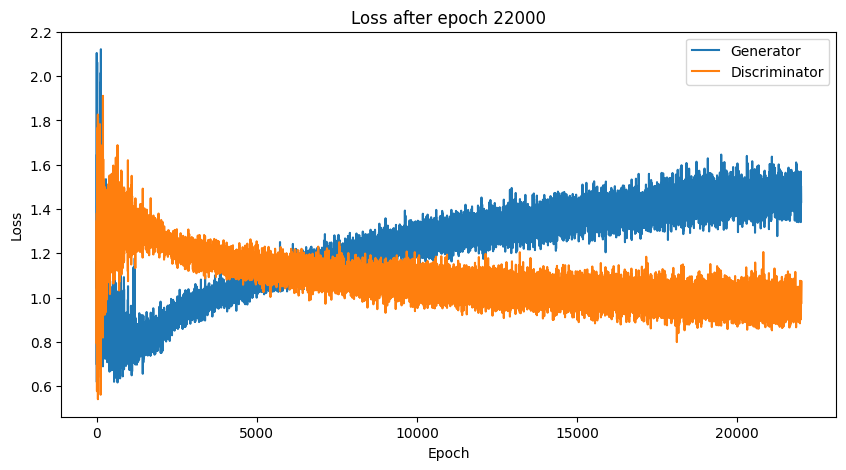

Time for epoch 22000 is 3.941051483154297 sec
Time for epoch 22001 is 0.8666336536407471 sec
Time for epoch 22002 is 0.8607747554779053 sec
Time for epoch 22003 is 0.866722822189331 sec
Time for epoch 22004 is 0.8716230392456055 sec
Time for epoch 22005 is 0.8661737442016602 sec
Time for epoch 22006 is 0.8722782135009766 sec
Time for epoch 22007 is 0.8713955879211426 sec
Time for epoch 22008 is 0.8752768039703369 sec
Time for epoch 22009 is 0.8750619888305664 sec
Time for epoch 22010 is 0.8767011165618896 sec
Time for epoch 22011 is 0.876706600189209 sec
Time for epoch 22012 is 0.8782832622528076 sec
Time for epoch 22013 is 0.8789455890655518 sec
Time for epoch 22014 is 0.8781354427337646 sec
Time for epoch 22015 is 0.8778705596923828 sec
Time for epoch 22016 is 0.8818514347076416 sec
Time for epoch 22017 is 0.8792757987976074 sec
Time for epoch 22018 is 0.8801884651184082 sec
Time for epoch 22019 is 0.8840224742889404 sec
Time for epoch 22020 is 0.878563642501831 sec
Time for epoch 22

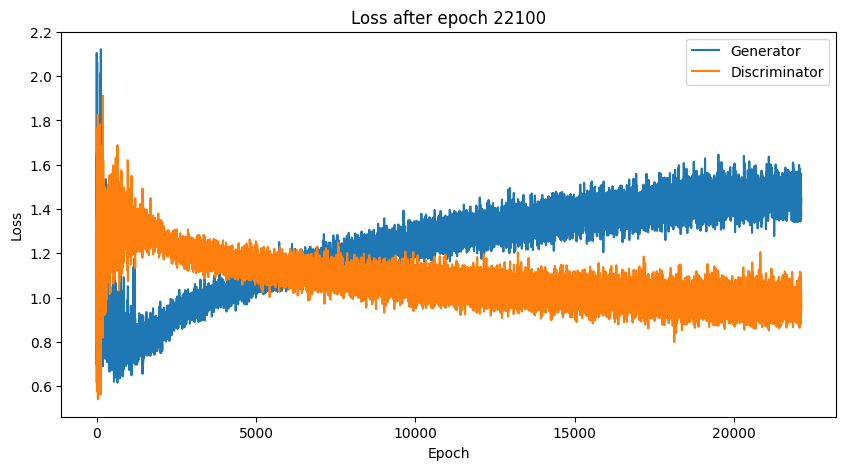

Time for epoch 22100 is 3.9662976264953613 sec
Time for epoch 22101 is 0.8518064022064209 sec
Time for epoch 22102 is 0.8651518821716309 sec
Time for epoch 22103 is 0.8633015155792236 sec
Time for epoch 22104 is 0.8638763427734375 sec
Time for epoch 22105 is 0.8677551746368408 sec
Time for epoch 22106 is 0.873281717300415 sec
Time for epoch 22107 is 0.8694145679473877 sec
Time for epoch 22108 is 0.8753056526184082 sec
Time for epoch 22109 is 0.871931791305542 sec
Time for epoch 22110 is 0.878713846206665 sec
Time for epoch 22111 is 0.8714158535003662 sec
Time for epoch 22112 is 0.8779797554016113 sec
Time for epoch 22113 is 0.878002405166626 sec
Time for epoch 22114 is 0.8803999423980713 sec
Time for epoch 22115 is 0.8824074268341064 sec
Time for epoch 22116 is 0.8765625953674316 sec
Time for epoch 22117 is 0.8846349716186523 sec
Time for epoch 22118 is 0.8820102214813232 sec
Time for epoch 22119 is 0.8849170207977295 sec
Time for epoch 22120 is 0.8817036151885986 sec
Time for epoch 22

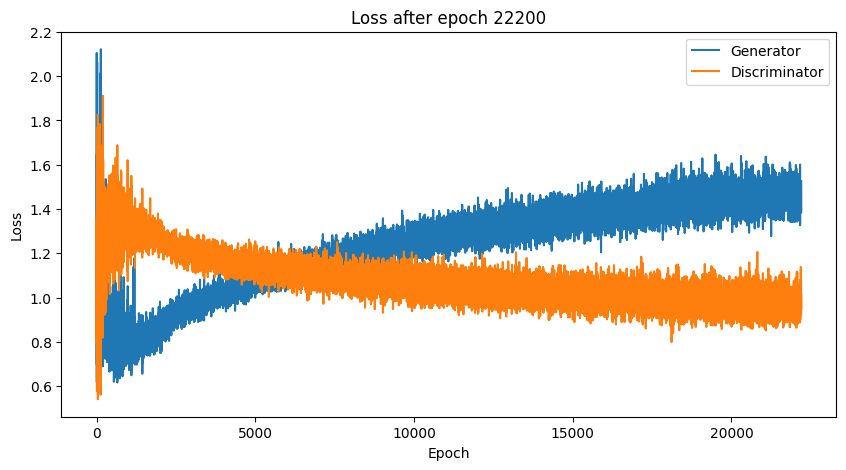

Time for epoch 22200 is 3.97416353225708 sec
Time for epoch 22201 is 0.868175745010376 sec
Time for epoch 22202 is 0.869748592376709 sec
Time for epoch 22203 is 0.8612649440765381 sec
Time for epoch 22204 is 0.8654944896697998 sec
Time for epoch 22205 is 0.8714196681976318 sec
Time for epoch 22206 is 0.8749761581420898 sec
Time for epoch 22207 is 0.8733172416687012 sec
Time for epoch 22208 is 0.8717169761657715 sec
Time for epoch 22209 is 0.875579833984375 sec
Time for epoch 22210 is 0.8795630931854248 sec
Time for epoch 22211 is 0.8779861927032471 sec
Time for epoch 22212 is 0.8790183067321777 sec
Time for epoch 22213 is 0.8721914291381836 sec
Time for epoch 22214 is 0.8804922103881836 sec
Time for epoch 22215 is 0.8798122406005859 sec
Time for epoch 22216 is 0.8802139759063721 sec
Time for epoch 22217 is 0.8789644241333008 sec
Time for epoch 22218 is 0.8799362182617188 sec
Time for epoch 22219 is 0.8835103511810303 sec
Time for epoch 22220 is 0.8803610801696777 sec
Time for epoch 222

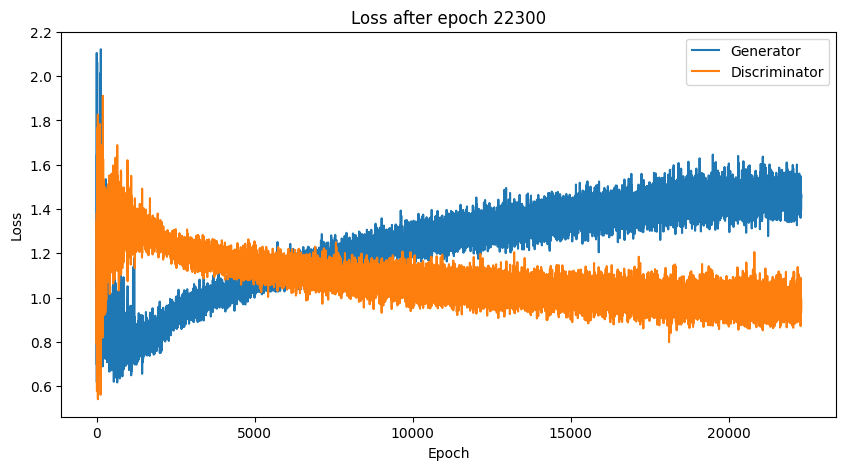

Time for epoch 22300 is 3.978759765625 sec
Time for epoch 22301 is 0.8662102222442627 sec
Time for epoch 22302 is 0.8570475578308105 sec
Time for epoch 22303 is 0.8662915229797363 sec
Time for epoch 22304 is 0.8680593967437744 sec
Time for epoch 22305 is 0.8705341815948486 sec
Time for epoch 22306 is 0.8705930709838867 sec
Time for epoch 22307 is 0.8733749389648438 sec
Time for epoch 22308 is 0.8738110065460205 sec
Time for epoch 22309 is 0.8726747035980225 sec
Time for epoch 22310 is 0.8776319026947021 sec
Time for epoch 22311 is 0.8770804405212402 sec
Time for epoch 22312 is 0.878464937210083 sec
Time for epoch 22313 is 0.8789792060852051 sec
Time for epoch 22314 is 0.8733234405517578 sec
Time for epoch 22315 is 0.8760802745819092 sec
Time for epoch 22316 is 0.8738791942596436 sec
Time for epoch 22317 is 0.8808605670928955 sec
Time for epoch 22318 is 0.8823084831237793 sec
Time for epoch 22319 is 0.8849451541900635 sec
Time for epoch 22320 is 0.8802189826965332 sec
Time for epoch 223

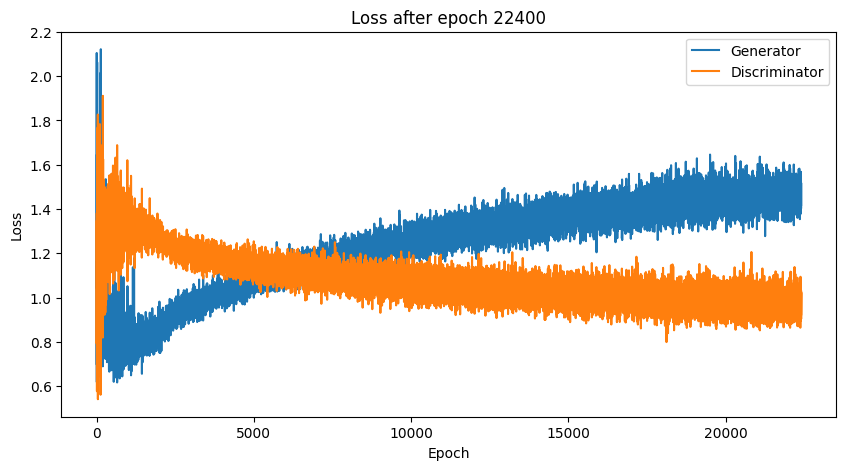

Time for epoch 22400 is 3.977910280227661 sec
Time for epoch 22401 is 0.8676114082336426 sec
Time for epoch 22402 is 0.8587791919708252 sec
Time for epoch 22403 is 0.8635797500610352 sec
Time for epoch 22404 is 0.8681962490081787 sec
Time for epoch 22405 is 0.8656613826751709 sec
Time for epoch 22406 is 0.8711235523223877 sec
Time for epoch 22407 is 0.8743350505828857 sec
Time for epoch 22408 is 0.8735768795013428 sec
Time for epoch 22409 is 0.8735275268554688 sec
Time for epoch 22410 is 0.8790433406829834 sec
Time for epoch 22411 is 0.8737754821777344 sec
Time for epoch 22412 is 0.8756930828094482 sec
Time for epoch 22413 is 0.8761405944824219 sec
Time for epoch 22414 is 0.8791663646697998 sec
Time for epoch 22415 is 0.8783605098724365 sec
Time for epoch 22416 is 0.8799316883087158 sec
Time for epoch 22417 is 0.8753814697265625 sec
Time for epoch 22418 is 0.8806381225585938 sec
Time for epoch 22419 is 0.8785233497619629 sec
Time for epoch 22420 is 0.8817031383514404 sec
Time for epoch

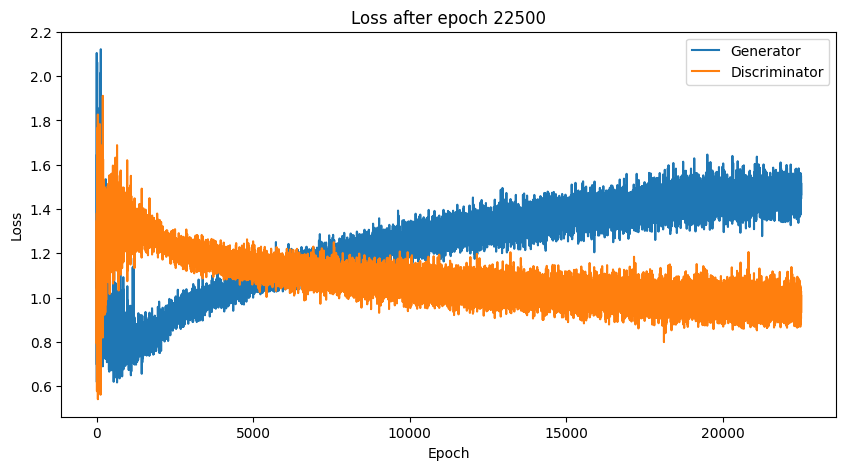

Time for epoch 22500 is 3.9796011447906494 sec
Time for epoch 22501 is 0.8424239158630371 sec
Time for epoch 22502 is 0.8601949214935303 sec
Time for epoch 22503 is 0.8656332492828369 sec
Time for epoch 22504 is 0.867560863494873 sec
Time for epoch 22505 is 0.8728723526000977 sec
Time for epoch 22506 is 0.87009596824646 sec
Time for epoch 22507 is 0.8768994808197021 sec
Time for epoch 22508 is 0.8738458156585693 sec
Time for epoch 22509 is 0.8731973171234131 sec
Time for epoch 22510 is 0.8735766410827637 sec
Time for epoch 22511 is 0.8796648979187012 sec
Time for epoch 22512 is 0.8816041946411133 sec
Time for epoch 22513 is 0.8779797554016113 sec
Time for epoch 22514 is 0.8760032653808594 sec
Time for epoch 22515 is 0.880551815032959 sec
Time for epoch 22516 is 0.884303092956543 sec
Time for epoch 22517 is 0.8803553581237793 sec
Time for epoch 22518 is 0.8782742023468018 sec
Time for epoch 22519 is 0.8773055076599121 sec
Time for epoch 22520 is 0.8817157745361328 sec
Time for epoch 225

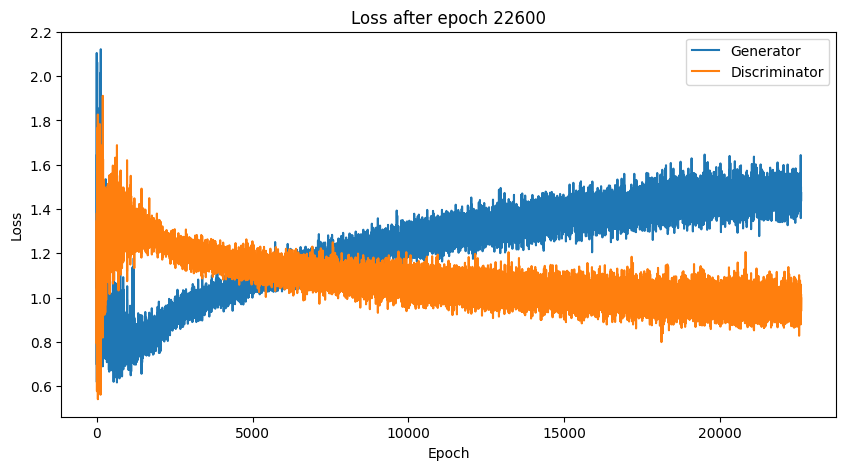

Time for epoch 22600 is 3.9992685317993164 sec
Time for epoch 22601 is 0.8640329837799072 sec
Time for epoch 22602 is 0.8624844551086426 sec
Time for epoch 22603 is 0.8618676662445068 sec
Time for epoch 22604 is 0.8650078773498535 sec
Time for epoch 22605 is 0.8729369640350342 sec
Time for epoch 22606 is 0.8661863803863525 sec
Time for epoch 22607 is 0.8789792060852051 sec
Time for epoch 22608 is 0.8715674877166748 sec
Time for epoch 22609 is 0.8686482906341553 sec
Time for epoch 22610 is 0.8834793567657471 sec
Time for epoch 22611 is 0.8766202926635742 sec
Time for epoch 22612 is 0.8779881000518799 sec
Time for epoch 22613 is 0.8824949264526367 sec
Time for epoch 22614 is 0.8764731884002686 sec
Time for epoch 22615 is 0.8792481422424316 sec
Time for epoch 22616 is 0.8786618709564209 sec
Time for epoch 22617 is 0.8825998306274414 sec
Time for epoch 22618 is 0.8829989433288574 sec
Time for epoch 22619 is 0.8805584907531738 sec
Time for epoch 22620 is 0.8794710636138916 sec
Time for epoc

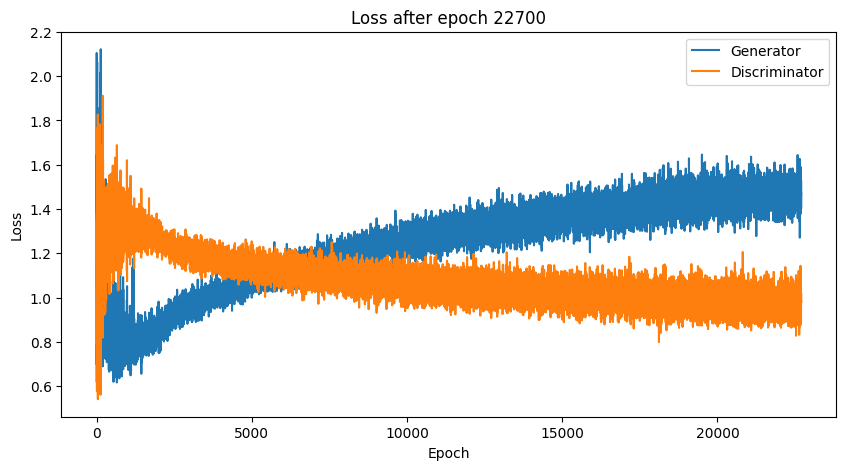

Time for epoch 22700 is 3.975677013397217 sec
Time for epoch 22701 is 0.8678467273712158 sec
Time for epoch 22702 is 0.865248441696167 sec
Time for epoch 22703 is 0.8641221523284912 sec
Time for epoch 22704 is 0.8665876388549805 sec
Time for epoch 22705 is 0.8720953464508057 sec
Time for epoch 22706 is 0.8698174953460693 sec
Time for epoch 22707 is 0.8730089664459229 sec
Time for epoch 22708 is 0.8721568584442139 sec
Time for epoch 22709 is 0.8746411800384521 sec
Time for epoch 22710 is 0.874028205871582 sec
Time for epoch 22711 is 0.8735847473144531 sec
Time for epoch 22712 is 0.8768336772918701 sec
Time for epoch 22713 is 0.8811159133911133 sec
Time for epoch 22714 is 0.8725886344909668 sec
Time for epoch 22715 is 0.877479076385498 sec
Time for epoch 22716 is 0.8767292499542236 sec
Time for epoch 22717 is 0.8779878616333008 sec
Time for epoch 22718 is 0.883190393447876 sec
Time for epoch 22719 is 0.8824136257171631 sec
Time for epoch 22720 is 0.874596357345581 sec
Time for epoch 2272

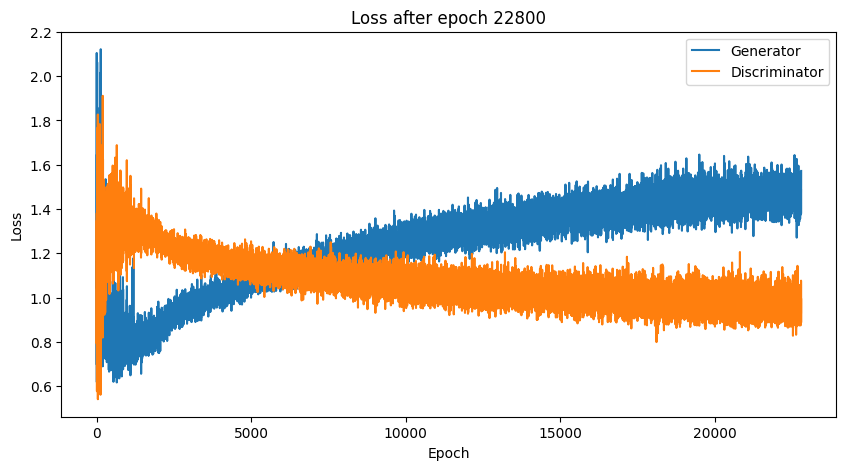

Time for epoch 22800 is 3.9922215938568115 sec
Time for epoch 22801 is 0.8646430969238281 sec
Time for epoch 22802 is 0.8614287376403809 sec
Time for epoch 22803 is 0.8645703792572021 sec
Time for epoch 22804 is 0.8659472465515137 sec
Time for epoch 22805 is 0.8665111064910889 sec
Time for epoch 22806 is 0.873579740524292 sec
Time for epoch 22807 is 0.8709456920623779 sec
Time for epoch 22808 is 0.8760015964508057 sec
Time for epoch 22809 is 0.8735744953155518 sec
Time for epoch 22810 is 0.8753395080566406 sec
Time for epoch 22811 is 0.8746817111968994 sec
Time for epoch 22812 is 0.8784105777740479 sec
Time for epoch 22813 is 0.8808028697967529 sec
Time for epoch 22814 is 0.8813190460205078 sec
Time for epoch 22815 is 0.8780367374420166 sec
Time for epoch 22816 is 0.87967848777771 sec
Time for epoch 22817 is 0.8791134357452393 sec
Time for epoch 22818 is 0.8751177787780762 sec
Time for epoch 22819 is 0.8823401927947998 sec
Time for epoch 22820 is 0.8847830295562744 sec
Time for epoch 2

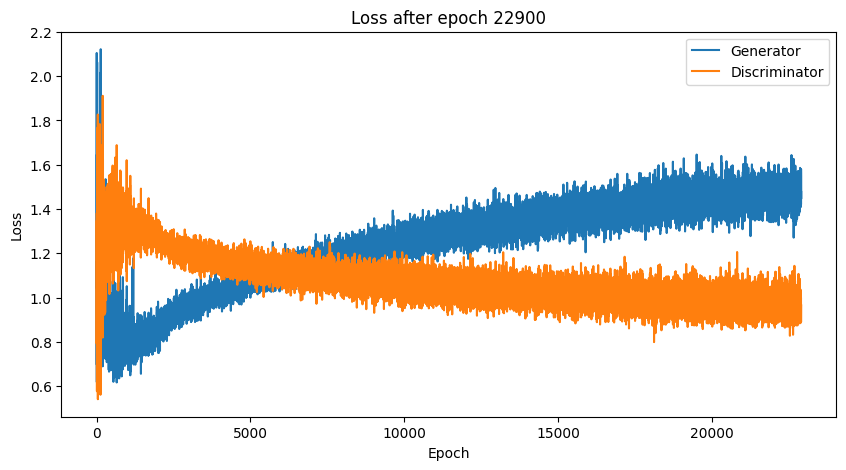

Time for epoch 22900 is 3.995060443878174 sec
Time for epoch 22901 is 0.8598341941833496 sec
Time for epoch 22902 is 0.8612229824066162 sec
Time for epoch 22903 is 0.8694183826446533 sec
Time for epoch 22904 is 0.8640055656433105 sec
Time for epoch 22905 is 0.865260124206543 sec
Time for epoch 22906 is 0.8690299987792969 sec
Time for epoch 22907 is 0.87109375 sec
Time for epoch 22908 is 0.8696126937866211 sec
Time for epoch 22909 is 0.8750905990600586 sec
Time for epoch 22910 is 0.8776249885559082 sec
Time for epoch 22911 is 0.8790884017944336 sec
Time for epoch 22912 is 0.8722829818725586 sec
Time for epoch 22913 is 0.879932165145874 sec
Time for epoch 22914 is 0.8771131038665771 sec
Time for epoch 22915 is 0.8825039863586426 sec
Time for epoch 22916 is 0.8809890747070312 sec
Time for epoch 22917 is 0.8767416477203369 sec
Time for epoch 22918 is 0.8823025226593018 sec
Time for epoch 22919 is 0.8801188468933105 sec
Time for epoch 22920 is 0.8826568126678467 sec
Time for epoch 22921 is 

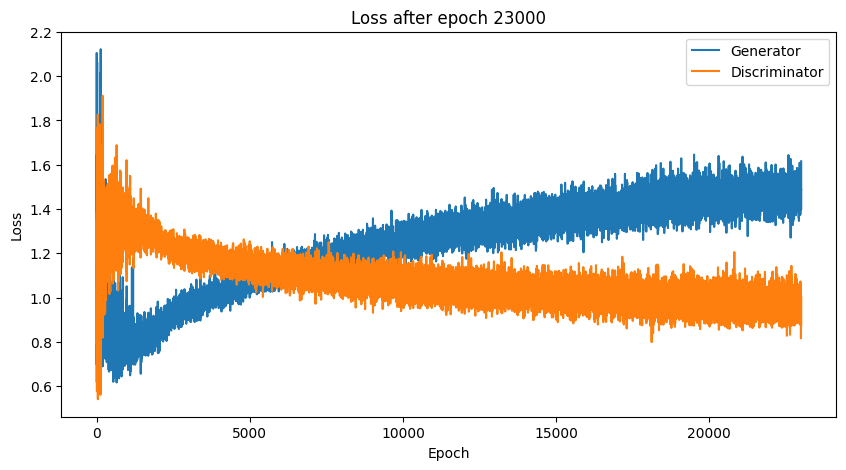

Time for epoch 23000 is 4.053083658218384 sec
Time for epoch 23001 is 0.848407506942749 sec
Time for epoch 23002 is 0.8635237216949463 sec
Time for epoch 23003 is 0.8652966022491455 sec
Time for epoch 23004 is 0.8657991886138916 sec
Time for epoch 23005 is 0.8717331886291504 sec
Time for epoch 23006 is 0.87473464012146 sec
Time for epoch 23007 is 0.8754992485046387 sec
Time for epoch 23008 is 0.8695828914642334 sec
Time for epoch 23009 is 0.8753876686096191 sec
Time for epoch 23010 is 0.8765950202941895 sec
Time for epoch 23011 is 0.8814098834991455 sec
Time for epoch 23012 is 0.8781778812408447 sec
Time for epoch 23013 is 0.8748793601989746 sec
Time for epoch 23014 is 0.8806893825531006 sec
Time for epoch 23015 is 0.8816959857940674 sec
Time for epoch 23016 is 0.8798930644989014 sec
Time for epoch 23017 is 0.8781275749206543 sec
Time for epoch 23018 is 0.8859641551971436 sec
Time for epoch 23019 is 0.8810126781463623 sec
Time for epoch 23020 is 0.8836374282836914 sec
Time for epoch 23

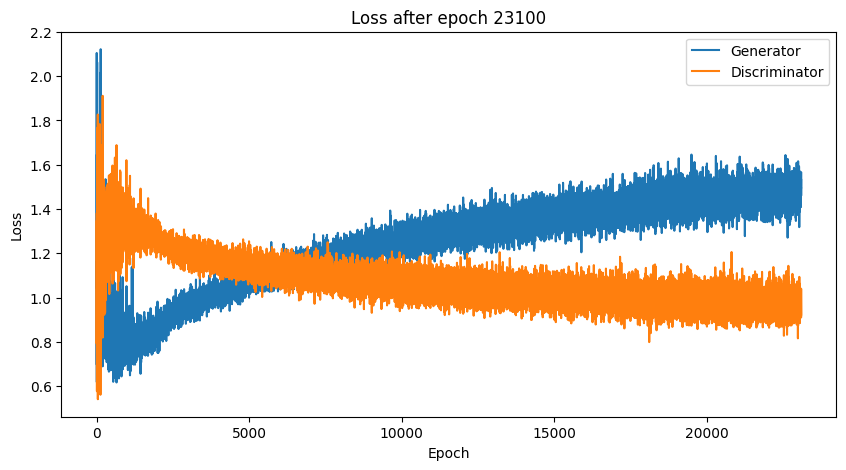

Time for epoch 23100 is 3.997959613800049 sec
Time for epoch 23101 is 0.8685877323150635 sec
Time for epoch 23102 is 0.8666603565216064 sec
Time for epoch 23103 is 0.8628714084625244 sec
Time for epoch 23104 is 0.8695449829101562 sec
Time for epoch 23105 is 0.8656435012817383 sec
Time for epoch 23106 is 0.8713893890380859 sec
Time for epoch 23107 is 0.8707902431488037 sec
Time for epoch 23108 is 0.8729069232940674 sec
Time for epoch 23109 is 0.86936354637146 sec
Time for epoch 23110 is 0.8724677562713623 sec
Time for epoch 23111 is 0.8726320266723633 sec
Time for epoch 23112 is 0.8751585483551025 sec
Time for epoch 23113 is 0.8786325454711914 sec
Time for epoch 23114 is 0.8761937618255615 sec
Time for epoch 23115 is 0.8814675807952881 sec
Time for epoch 23116 is 0.880542516708374 sec
Time for epoch 23117 is 0.8831937313079834 sec
Time for epoch 23118 is 0.872260332107544 sec
Time for epoch 23119 is 0.8886845111846924 sec
Time for epoch 23120 is 0.8853464126586914 sec
Time for epoch 231

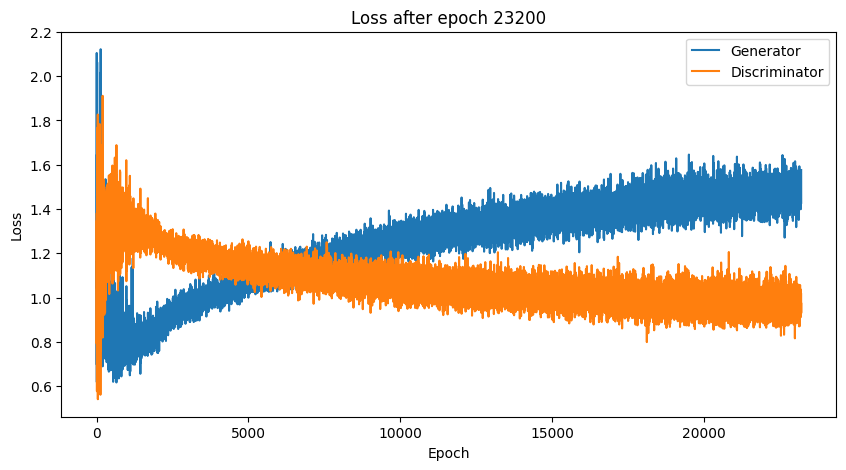

Time for epoch 23200 is 3.982067823410034 sec
Time for epoch 23201 is 0.8667809963226318 sec
Time for epoch 23202 is 0.8570783138275146 sec
Time for epoch 23203 is 0.863567590713501 sec
Time for epoch 23204 is 0.8679828643798828 sec
Time for epoch 23205 is 0.8659753799438477 sec
Time for epoch 23206 is 0.8707189559936523 sec
Time for epoch 23207 is 0.8724896907806396 sec
Time for epoch 23208 is 0.8675932884216309 sec
Time for epoch 23209 is 0.8803918361663818 sec
Time for epoch 23210 is 0.8767068386077881 sec
Time for epoch 23211 is 0.8732926845550537 sec
Time for epoch 23212 is 0.8725166320800781 sec
Time for epoch 23213 is 0.8775568008422852 sec
Time for epoch 23214 is 0.8778407573699951 sec
Time for epoch 23215 is 0.8840634822845459 sec
Time for epoch 23216 is 0.878706693649292 sec
Time for epoch 23217 is 0.8772861957550049 sec
Time for epoch 23218 is 0.8834483623504639 sec
Time for epoch 23219 is 0.8790097236633301 sec
Time for epoch 23220 is 0.8786013126373291 sec
Time for epoch 2

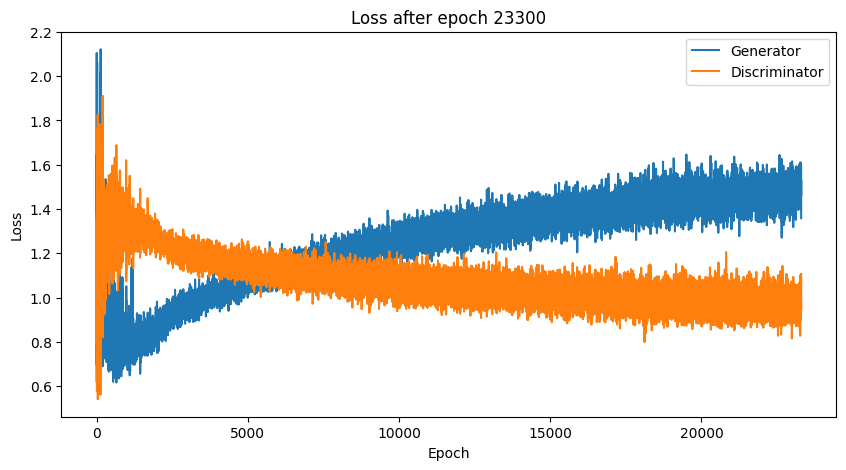

Time for epoch 23300 is 4.01103949546814 sec
Time for epoch 23301 is 0.8683657646179199 sec
Time for epoch 23302 is 0.8563916683197021 sec
Time for epoch 23303 is 0.8666229248046875 sec
Time for epoch 23304 is 0.8680379390716553 sec
Time for epoch 23305 is 0.8688461780548096 sec
Time for epoch 23306 is 0.8686065673828125 sec
Time for epoch 23307 is 0.8737618923187256 sec
Time for epoch 23308 is 0.874516487121582 sec
Time for epoch 23309 is 0.8826861381530762 sec
Time for epoch 23310 is 0.8776988983154297 sec
Time for epoch 23311 is 0.8728334903717041 sec
Time for epoch 23312 is 0.881239652633667 sec
Time for epoch 23313 is 0.8748383522033691 sec
Time for epoch 23314 is 0.8752069473266602 sec
Time for epoch 23315 is 0.8811519145965576 sec
Time for epoch 23316 is 0.8759925365447998 sec
Time for epoch 23317 is 0.8823432922363281 sec
Time for epoch 23318 is 0.882988452911377 sec
Time for epoch 23319 is 0.8813481330871582 sec
Time for epoch 23320 is 0.8786747455596924 sec
Time for epoch 233

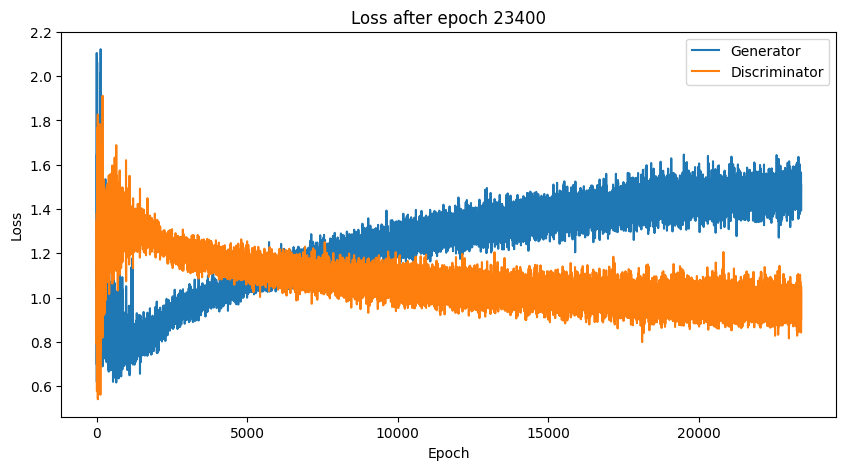

Time for epoch 23400 is 4.021341562271118 sec
Time for epoch 23401 is 0.8661017417907715 sec
Time for epoch 23402 is 0.8601336479187012 sec
Time for epoch 23403 is 0.8660459518432617 sec
Time for epoch 23404 is 0.8641459941864014 sec
Time for epoch 23405 is 0.8668973445892334 sec
Time for epoch 23406 is 0.8776521682739258 sec
Time for epoch 23407 is 0.8701345920562744 sec
Time for epoch 23408 is 0.8729782104492188 sec
Time for epoch 23409 is 0.8740136623382568 sec
Time for epoch 23410 is 0.8738236427307129 sec
Time for epoch 23411 is 0.8755526542663574 sec
Time for epoch 23412 is 0.8781979084014893 sec
Time for epoch 23413 is 0.874305248260498 sec
Time for epoch 23414 is 0.8797914981842041 sec
Time for epoch 23415 is 0.8760850429534912 sec
Time for epoch 23416 is 0.882232666015625 sec
Time for epoch 23417 is 0.8804421424865723 sec
Time for epoch 23418 is 0.8774259090423584 sec
Time for epoch 23419 is 0.8849029541015625 sec
Time for epoch 23420 is 0.874187707901001 sec
Time for epoch 23

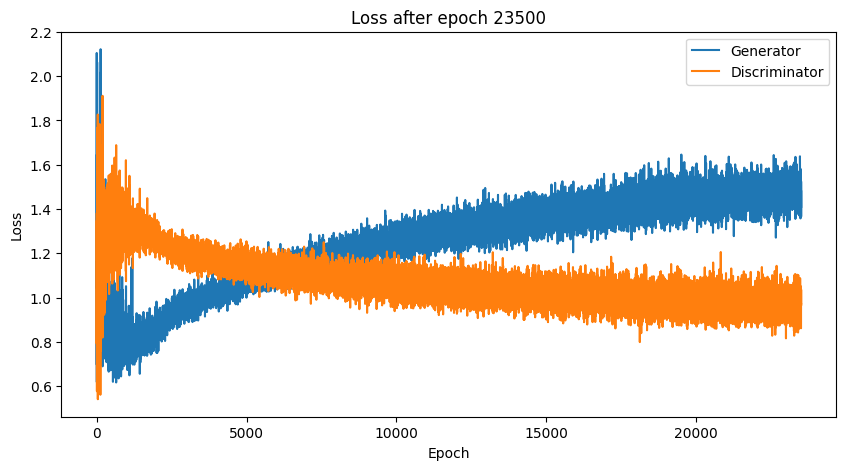

Time for epoch 23500 is 4.000609636306763 sec
Time for epoch 23501 is 0.8619134426116943 sec
Time for epoch 23502 is 0.8614377975463867 sec
Time for epoch 23503 is 0.8670575618743896 sec
Time for epoch 23504 is 0.8630812168121338 sec
Time for epoch 23505 is 0.8662834167480469 sec
Time for epoch 23506 is 0.8724827766418457 sec
Time for epoch 23507 is 0.8711879253387451 sec
Time for epoch 23508 is 0.87300705909729 sec
Time for epoch 23509 is 0.8731825351715088 sec
Time for epoch 23510 is 0.8766188621520996 sec
Time for epoch 23511 is 0.8728542327880859 sec
Time for epoch 23512 is 0.8776345252990723 sec
Time for epoch 23513 is 0.8814663887023926 sec
Time for epoch 23514 is 0.876422643661499 sec
Time for epoch 23515 is 0.877633810043335 sec
Time for epoch 23516 is 0.88199782371521 sec
Time for epoch 23517 is 0.8768482208251953 sec
Time for epoch 23518 is 0.8850686550140381 sec
Time for epoch 23519 is 0.8846466541290283 sec
Time for epoch 23520 is 0.8773982524871826 sec
Time for epoch 23521

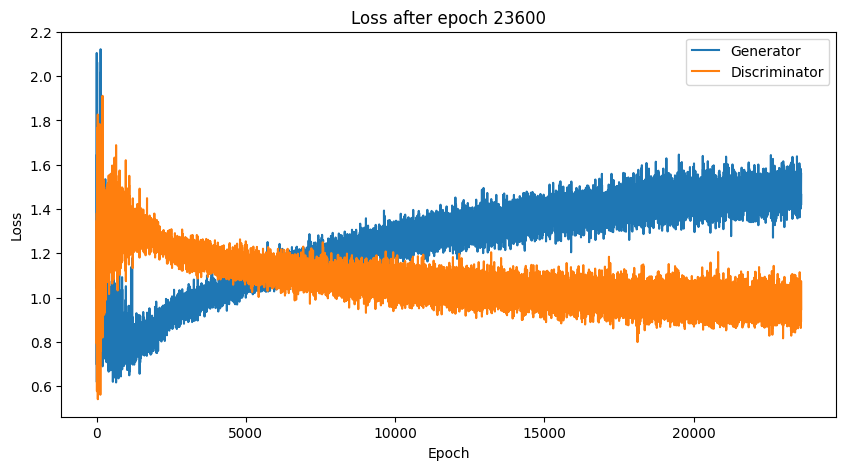

Time for epoch 23600 is 3.994553327560425 sec
Time for epoch 23601 is 0.8646090030670166 sec
Time for epoch 23602 is 0.8595147132873535 sec
Time for epoch 23603 is 0.866086483001709 sec
Time for epoch 23604 is 0.8684079647064209 sec
Time for epoch 23605 is 0.863405704498291 sec
Time for epoch 23606 is 0.8739621639251709 sec
Time for epoch 23607 is 0.872128963470459 sec
Time for epoch 23608 is 0.8724761009216309 sec
Time for epoch 23609 is 0.8744373321533203 sec
Time for epoch 23610 is 0.8724575042724609 sec
Time for epoch 23611 is 0.8775367736816406 sec
Time for epoch 23612 is 0.8774805068969727 sec
Time for epoch 23613 is 0.8780498504638672 sec
Time for epoch 23614 is 0.8786225318908691 sec
Time for epoch 23615 is 0.8819375038146973 sec
Time for epoch 23616 is 0.8782646656036377 sec
Time for epoch 23617 is 0.8806469440460205 sec
Time for epoch 23618 is 0.8788297176361084 sec
Time for epoch 23619 is 0.8791961669921875 sec
Time for epoch 23620 is 0.8821060657501221 sec
Time for epoch 23

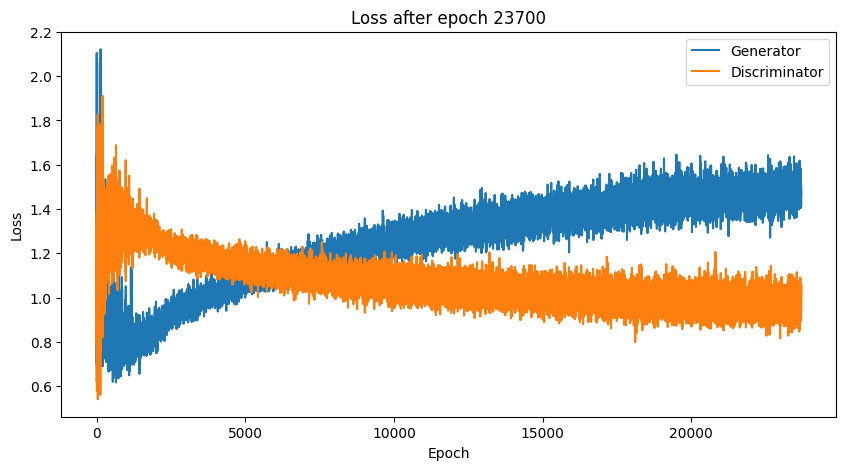

Time for epoch 23700 is 4.011451482772827 sec
Time for epoch 23701 is 0.8536405563354492 sec
Time for epoch 23702 is 0.86759352684021 sec
Time for epoch 23703 is 0.8610365390777588 sec
Time for epoch 23704 is 0.8655765056610107 sec
Time for epoch 23705 is 0.8715846538543701 sec
Time for epoch 23706 is 0.8736257553100586 sec
Time for epoch 23707 is 0.8739891052246094 sec
Time for epoch 23708 is 0.8740484714508057 sec
Time for epoch 23709 is 0.8759045600891113 sec
Time for epoch 23710 is 0.87156081199646 sec
Time for epoch 23711 is 0.8805453777313232 sec
Time for epoch 23712 is 0.877516508102417 sec
Time for epoch 23713 is 0.8793318271636963 sec
Time for epoch 23714 is 0.8772852420806885 sec
Time for epoch 23715 is 0.8796343803405762 sec
Time for epoch 23716 is 0.8792939186096191 sec
Time for epoch 23717 is 0.881005048751831 sec
Time for epoch 23718 is 0.8795874118804932 sec
Time for epoch 23719 is 0.8775105476379395 sec
Time for epoch 23720 is 0.8782975673675537 sec
Time for epoch 23721

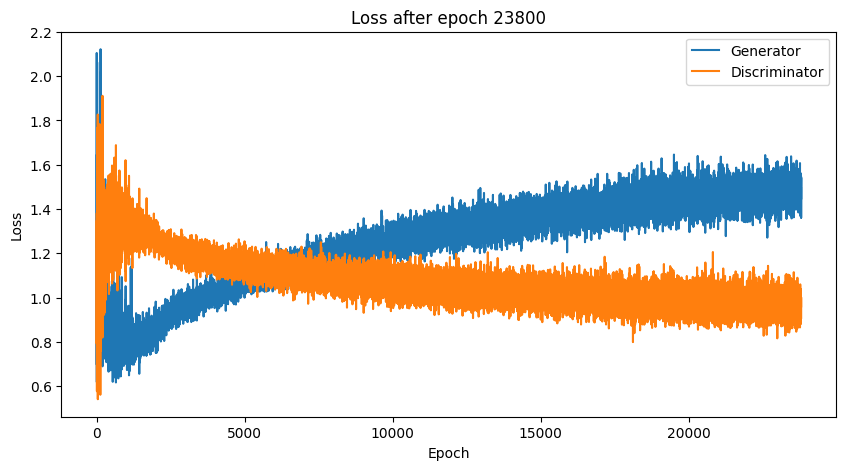

Time for epoch 23800 is 4.014847040176392 sec
Time for epoch 23801 is 0.8558535575866699 sec
Time for epoch 23802 is 0.8601541519165039 sec
Time for epoch 23803 is 0.8656749725341797 sec
Time for epoch 23804 is 0.8653960227966309 sec
Time for epoch 23805 is 0.8696541786193848 sec
Time for epoch 23806 is 0.8714754581451416 sec
Time for epoch 23807 is 0.8703722953796387 sec
Time for epoch 23808 is 0.8709843158721924 sec
Time for epoch 23809 is 0.8740851879119873 sec
Time for epoch 23810 is 0.873302698135376 sec
Time for epoch 23811 is 0.8738503456115723 sec
Time for epoch 23812 is 0.8779904842376709 sec
Time for epoch 23813 is 0.8761539459228516 sec
Time for epoch 23814 is 0.8772521018981934 sec
Time for epoch 23815 is 0.8766477108001709 sec
Time for epoch 23816 is 0.8766577243804932 sec
Time for epoch 23817 is 0.880939245223999 sec
Time for epoch 23818 is 0.8795340061187744 sec
Time for epoch 23819 is 0.882272481918335 sec
Time for epoch 23820 is 0.8842918872833252 sec
Time for epoch 23

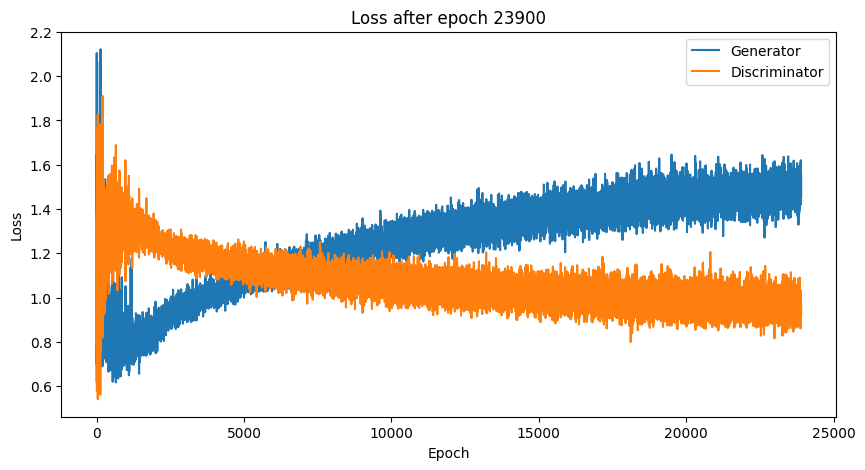

Time for epoch 23900 is 4.0167505741119385 sec
Time for epoch 23901 is 0.8601994514465332 sec
Time for epoch 23902 is 0.8570165634155273 sec
Time for epoch 23903 is 0.8650417327880859 sec
Time for epoch 23904 is 0.8663973808288574 sec
Time for epoch 23905 is 0.8720583915710449 sec
Time for epoch 23906 is 0.8698122501373291 sec
Time for epoch 23907 is 0.8706536293029785 sec
Time for epoch 23908 is 0.8700709342956543 sec
Time for epoch 23909 is 0.8769421577453613 sec
Time for epoch 23910 is 0.877814531326294 sec
Time for epoch 23911 is 0.8751199245452881 sec
Time for epoch 23912 is 0.8725509643554688 sec
Time for epoch 23913 is 0.879324197769165 sec
Time for epoch 23914 is 0.8780379295349121 sec
Time for epoch 23915 is 0.8778564929962158 sec
Time for epoch 23916 is 0.8754274845123291 sec
Time for epoch 23917 is 0.8833224773406982 sec
Time for epoch 23918 is 0.8778648376464844 sec
Time for epoch 23919 is 0.8839046955108643 sec
Time for epoch 23920 is 0.8830687999725342 sec
Time for epoch 

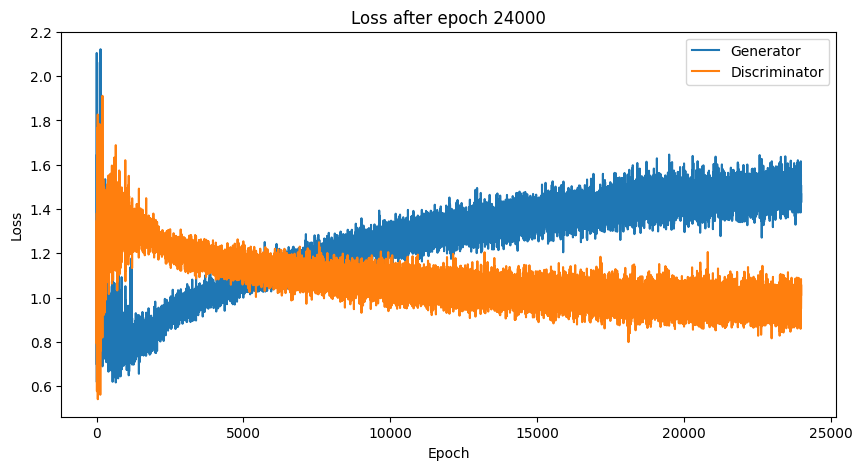

Time for epoch 24000 is 3.981966018676758 sec
Time for epoch 24001 is 0.8554692268371582 sec
Time for epoch 24002 is 0.8662197589874268 sec
Time for epoch 24003 is 0.8655157089233398 sec
Time for epoch 24004 is 0.8649611473083496 sec
Time for epoch 24005 is 0.8661346435546875 sec
Time for epoch 24006 is 0.8737413883209229 sec
Time for epoch 24007 is 0.8749034404754639 sec
Time for epoch 24008 is 0.8703064918518066 sec
Time for epoch 24009 is 0.8729729652404785 sec
Time for epoch 24010 is 0.8724305629730225 sec
Time for epoch 24011 is 0.8785934448242188 sec
Time for epoch 24012 is 0.8762576580047607 sec
Time for epoch 24013 is 0.8800296783447266 sec
Time for epoch 24014 is 0.8761599063873291 sec
Time for epoch 24015 is 0.8744368553161621 sec
Time for epoch 24016 is 0.8770015239715576 sec
Time for epoch 24017 is 0.8828167915344238 sec
Time for epoch 24018 is 0.8815019130706787 sec
Time for epoch 24019 is 0.8792634010314941 sec
Time for epoch 24020 is 0.8796412944793701 sec
Time for epoch

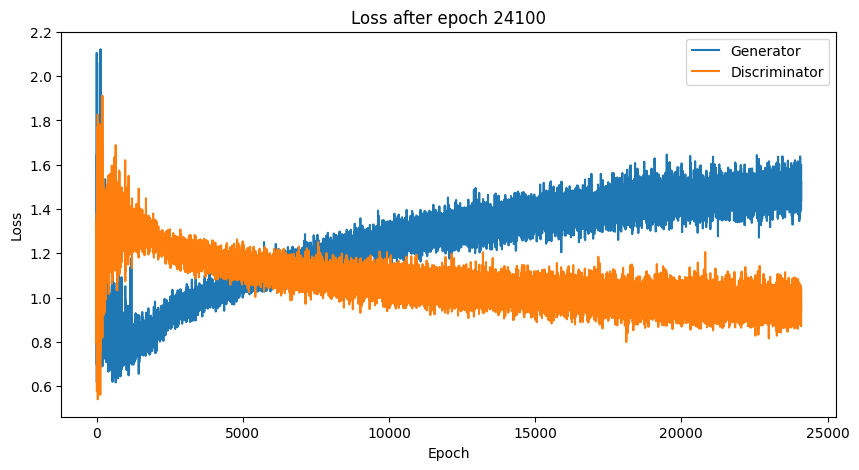

Time for epoch 24100 is 3.999664545059204 sec
Time for epoch 24101 is 0.8571970462799072 sec
Time for epoch 24102 is 0.8620815277099609 sec
Time for epoch 24103 is 0.8658084869384766 sec
Time for epoch 24104 is 0.8697192668914795 sec
Time for epoch 24105 is 0.8715474605560303 sec
Time for epoch 24106 is 0.8674914836883545 sec
Time for epoch 24107 is 0.8737742900848389 sec
Time for epoch 24108 is 0.8704750537872314 sec
Time for epoch 24109 is 0.8758361339569092 sec
Time for epoch 24110 is 0.8752312660217285 sec
Time for epoch 24111 is 0.8793835639953613 sec
Time for epoch 24112 is 0.8740396499633789 sec
Time for epoch 24113 is 0.8767709732055664 sec
Time for epoch 24114 is 0.8836328983306885 sec
Time for epoch 24115 is 0.8779418468475342 sec
Time for epoch 24116 is 0.8818974494934082 sec
Time for epoch 24117 is 0.8798353672027588 sec
Time for epoch 24118 is 0.8830475807189941 sec
Time for epoch 24119 is 0.8838036060333252 sec
Time for epoch 24120 is 0.8796432018280029 sec
Time for epoch

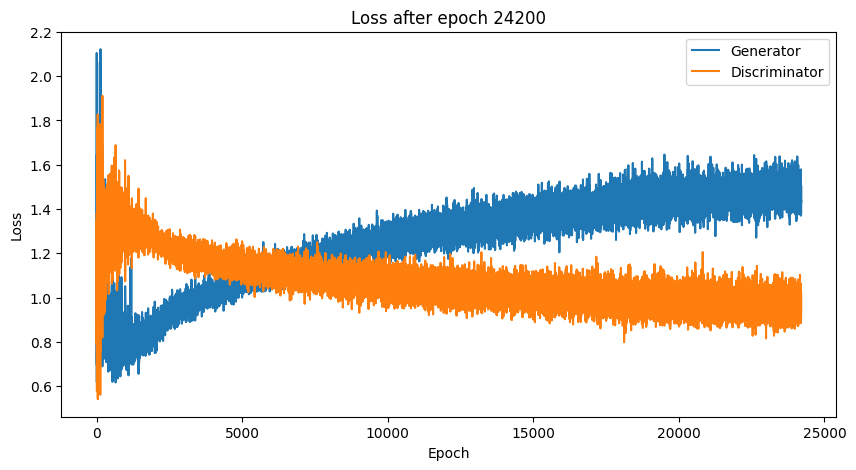

Time for epoch 24200 is 4.000694513320923 sec
Time for epoch 24201 is 0.8620123863220215 sec
Time for epoch 24202 is 0.8572402000427246 sec
Time for epoch 24203 is 0.8645596504211426 sec
Time for epoch 24204 is 0.8674557209014893 sec
Time for epoch 24205 is 0.8653755187988281 sec
Time for epoch 24206 is 0.87093186378479 sec
Time for epoch 24207 is 0.8730809688568115 sec
Time for epoch 24208 is 0.8724241256713867 sec
Time for epoch 24209 is 0.8708109855651855 sec
Time for epoch 24210 is 0.8805363178253174 sec
Time for epoch 24211 is 0.86578369140625 sec
Time for epoch 24212 is 0.878746509552002 sec
Time for epoch 24213 is 0.8760216236114502 sec
Time for epoch 24214 is 0.8764283657073975 sec
Time for epoch 24215 is 0.8790688514709473 sec
Time for epoch 24216 is 0.8739256858825684 sec
Time for epoch 24217 is 0.8793418407440186 sec
Time for epoch 24218 is 0.8787546157836914 sec
Time for epoch 24219 is 0.8787672519683838 sec
Time for epoch 24220 is 0.8843505382537842 sec
Time for epoch 2422

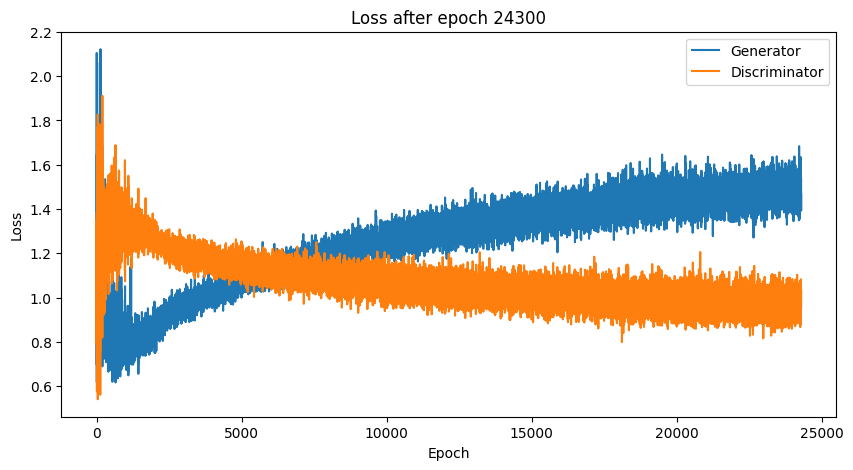

Time for epoch 24300 is 4.01850438117981 sec
Time for epoch 24301 is 0.8610219955444336 sec
Time for epoch 24302 is 0.8627197742462158 sec
Time for epoch 24303 is 0.863882303237915 sec
Time for epoch 24304 is 0.8671646118164062 sec
Time for epoch 24305 is 0.8715710639953613 sec
Time for epoch 24306 is 0.8658297061920166 sec
Time for epoch 24307 is 0.8708040714263916 sec
Time for epoch 24308 is 0.8758542537689209 sec
Time for epoch 24309 is 0.8740921020507812 sec
Time for epoch 24310 is 0.8771510124206543 sec
Time for epoch 24311 is 0.8711633682250977 sec
Time for epoch 24312 is 0.8766396045684814 sec
Time for epoch 24313 is 0.8793809413909912 sec
Time for epoch 24314 is 0.8758397102355957 sec
Time for epoch 24315 is 0.8783154487609863 sec
Time for epoch 24316 is 0.8780887126922607 sec
Time for epoch 24317 is 0.8850691318511963 sec
Time for epoch 24318 is 0.8808267116546631 sec
Time for epoch 24319 is 0.875953197479248 sec
Time for epoch 24320 is 0.8831298351287842 sec
Time for epoch 24

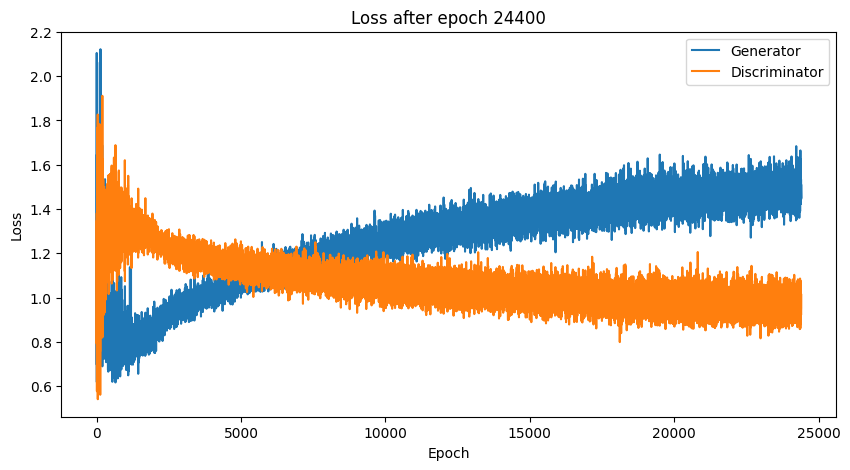

Time for epoch 24400 is 4.028264760971069 sec
Time for epoch 24401 is 0.8593721389770508 sec
Time for epoch 24402 is 0.860886812210083 sec
Time for epoch 24403 is 0.8668105602264404 sec
Time for epoch 24404 is 0.8688242435455322 sec
Time for epoch 24405 is 0.8642048835754395 sec
Time for epoch 24406 is 0.8695113658905029 sec
Time for epoch 24407 is 0.8721938133239746 sec
Time for epoch 24408 is 0.8718843460083008 sec
Time for epoch 24409 is 0.8732759952545166 sec
Time for epoch 24410 is 0.8787662982940674 sec
Time for epoch 24411 is 0.8767378330230713 sec
Time for epoch 24412 is 0.8721728324890137 sec
Time for epoch 24413 is 0.8755004405975342 sec
Time for epoch 24414 is 0.8805625438690186 sec
Time for epoch 24415 is 0.877016544342041 sec
Time for epoch 24416 is 0.8768360614776611 sec
Time for epoch 24417 is 0.8783235549926758 sec
Time for epoch 24418 is 0.8792617321014404 sec
Time for epoch 24419 is 0.88043212890625 sec
Time for epoch 24420 is 0.879817008972168 sec
Time for epoch 2442

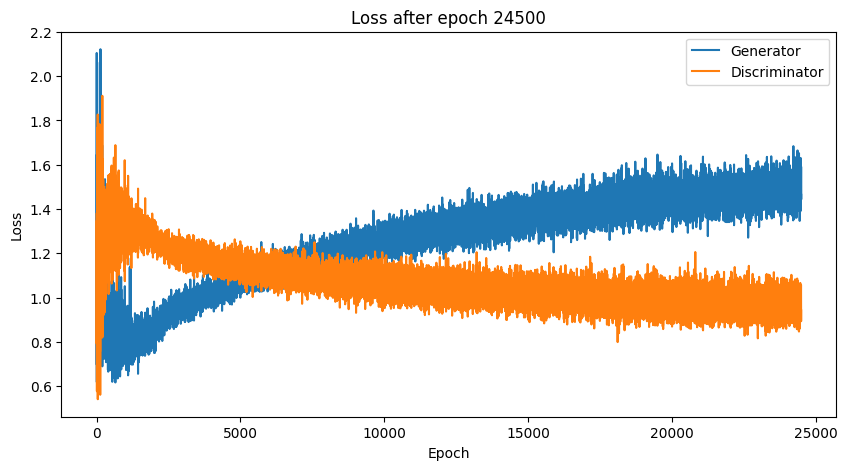

Time for epoch 24500 is 4.045863389968872 sec
Time for epoch 24501 is 0.8589515686035156 sec
Time for epoch 24502 is 0.8534619808197021 sec
Time for epoch 24503 is 0.8688619136810303 sec
Time for epoch 24504 is 0.86549973487854 sec
Time for epoch 24505 is 0.8667268753051758 sec
Time for epoch 24506 is 0.8753619194030762 sec
Time for epoch 24507 is 0.8689241409301758 sec
Time for epoch 24508 is 0.8767809867858887 sec
Time for epoch 24509 is 0.8743917942047119 sec
Time for epoch 24510 is 0.871018648147583 sec
Time for epoch 24511 is 0.8743703365325928 sec
Time for epoch 24512 is 0.8767662048339844 sec
Time for epoch 24513 is 0.8801608085632324 sec
Time for epoch 24514 is 0.8707361221313477 sec
Time for epoch 24515 is 0.8769698143005371 sec
Time for epoch 24516 is 0.8807218074798584 sec
Time for epoch 24517 is 0.878587007522583 sec
Time for epoch 24518 is 0.8831403255462646 sec
Time for epoch 24519 is 0.878248929977417 sec
Time for epoch 24520 is 0.8819839954376221 sec
Time for epoch 2452

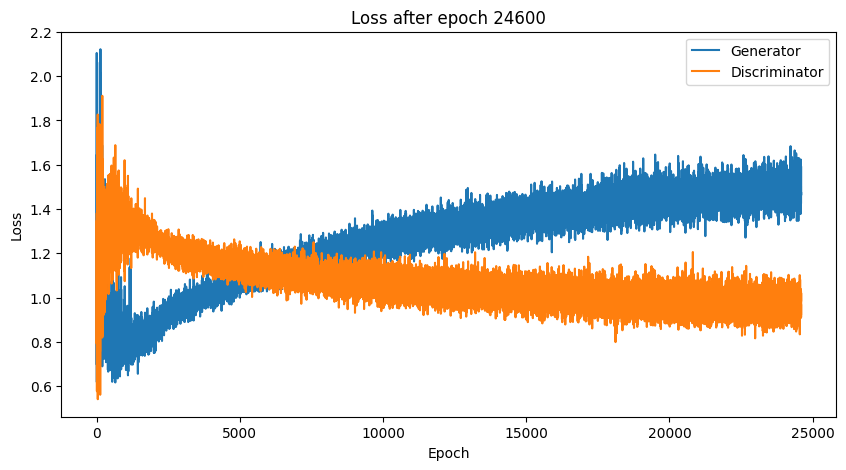

Time for epoch 24600 is 4.04715895652771 sec
Time for epoch 24601 is 0.8619427680969238 sec
Time for epoch 24602 is 0.859215497970581 sec
Time for epoch 24603 is 0.8613104820251465 sec
Time for epoch 24604 is 0.8717401027679443 sec
Time for epoch 24605 is 0.8662588596343994 sec
Time for epoch 24606 is 0.8690047264099121 sec
Time for epoch 24607 is 0.8738265037536621 sec
Time for epoch 24608 is 0.86895751953125 sec
Time for epoch 24609 is 0.8768062591552734 sec
Time for epoch 24610 is 0.8792374134063721 sec
Time for epoch 24611 is 0.8716628551483154 sec
Time for epoch 24612 is 0.8785815238952637 sec
Time for epoch 24613 is 0.8748230934143066 sec
Time for epoch 24614 is 0.8750472068786621 sec
Time for epoch 24615 is 0.8736369609832764 sec
Time for epoch 24616 is 0.8812861442565918 sec
Time for epoch 24617 is 0.8764891624450684 sec
Time for epoch 24618 is 0.8853905200958252 sec
Time for epoch 24619 is 0.8801379203796387 sec
Time for epoch 24620 is 0.8800528049468994 sec
Time for epoch 246

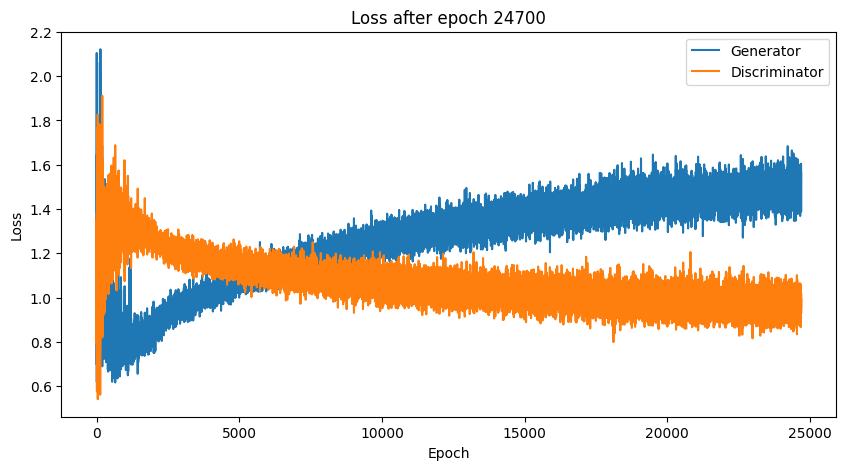

Time for epoch 24700 is 4.013689994812012 sec
Time for epoch 24701 is 0.8650186061859131 sec
Time for epoch 24702 is 0.8619112968444824 sec
Time for epoch 24703 is 0.8641514778137207 sec
Time for epoch 24704 is 0.8664519786834717 sec
Time for epoch 24705 is 0.867250919342041 sec
Time for epoch 24706 is 0.8833565711975098 sec
Time for epoch 24707 is 0.867851972579956 sec
Time for epoch 24708 is 0.8759889602661133 sec
Time for epoch 24709 is 0.8725428581237793 sec
Time for epoch 24710 is 0.8751211166381836 sec
Time for epoch 24711 is 0.8728179931640625 sec
Time for epoch 24712 is 0.8718147277832031 sec
Time for epoch 24713 is 0.876889705657959 sec
Time for epoch 24714 is 0.8808565139770508 sec
Time for epoch 24715 is 0.8795156478881836 sec
Time for epoch 24716 is 0.8859355449676514 sec
Time for epoch 24717 is 0.8735761642456055 sec
Time for epoch 24718 is 0.8838438987731934 sec
Time for epoch 24719 is 0.8811373710632324 sec
Time for epoch 24720 is 0.8790614604949951 sec
Time for epoch 24

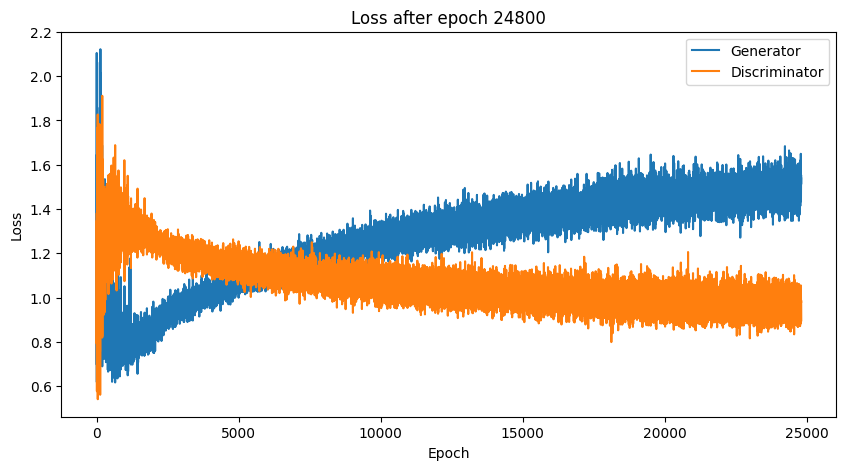

Time for epoch 24800 is 4.04443097114563 sec
Time for epoch 24801 is 0.8555731773376465 sec
Time for epoch 24802 is 0.859135627746582 sec
Time for epoch 24803 is 0.8656291961669922 sec
Time for epoch 24804 is 0.8707122802734375 sec
Time for epoch 24805 is 0.864159345626831 sec
Time for epoch 24806 is 0.8814949989318848 sec
Time for epoch 24807 is 0.8717865943908691 sec
Time for epoch 24808 is 0.8702151775360107 sec
Time for epoch 24809 is 0.8745377063751221 sec
Time for epoch 24810 is 0.8761656284332275 sec
Time for epoch 24811 is 0.8747625350952148 sec
Time for epoch 24812 is 0.8763535022735596 sec
Time for epoch 24813 is 0.8765766620635986 sec
Time for epoch 24814 is 0.8808972835540771 sec
Time for epoch 24815 is 0.8781960010528564 sec
Time for epoch 24816 is 0.8812534809112549 sec
Time for epoch 24817 is 0.8812212944030762 sec
Time for epoch 24818 is 0.8852336406707764 sec
Time for epoch 24819 is 0.8752145767211914 sec
Time for epoch 24820 is 0.8810954093933105 sec
Time for epoch 24

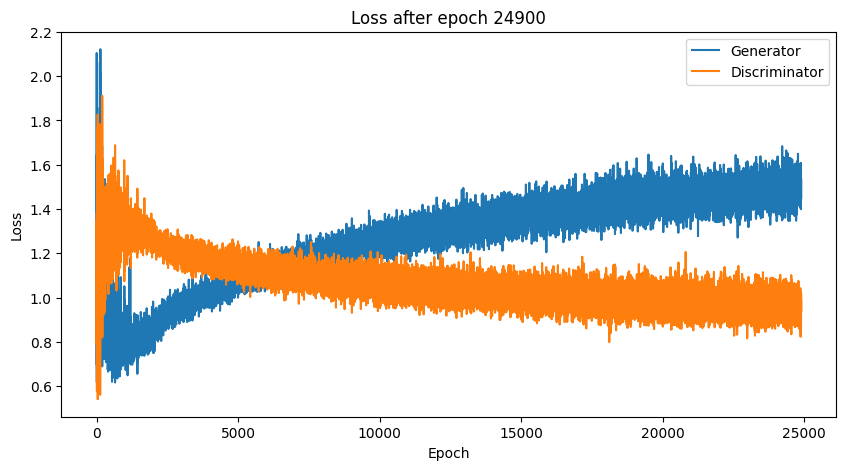

Time for epoch 24900 is 4.061164855957031 sec
Time for epoch 24901 is 0.8706023693084717 sec
Time for epoch 24902 is 0.854107141494751 sec
Time for epoch 24903 is 0.8615491390228271 sec
Time for epoch 24904 is 0.8636877536773682 sec
Time for epoch 24905 is 0.8700013160705566 sec
Time for epoch 24906 is 0.8678460121154785 sec
Time for epoch 24907 is 0.8713779449462891 sec
Time for epoch 24908 is 0.8707115650177002 sec
Time for epoch 24909 is 0.8755691051483154 sec
Time for epoch 24910 is 0.8720145225524902 sec
Time for epoch 24911 is 0.875377893447876 sec
Time for epoch 24912 is 0.8731865882873535 sec
Time for epoch 24913 is 0.8771448135375977 sec
Time for epoch 24914 is 0.8791203498840332 sec
Time for epoch 24915 is 0.8754720687866211 sec
Time for epoch 24916 is 0.8797478675842285 sec
Time for epoch 24917 is 0.8811333179473877 sec
Time for epoch 24918 is 0.878251314163208 sec
Time for epoch 24919 is 0.8830890655517578 sec
Time for epoch 24920 is 0.8784027099609375 sec
Time for epoch 24

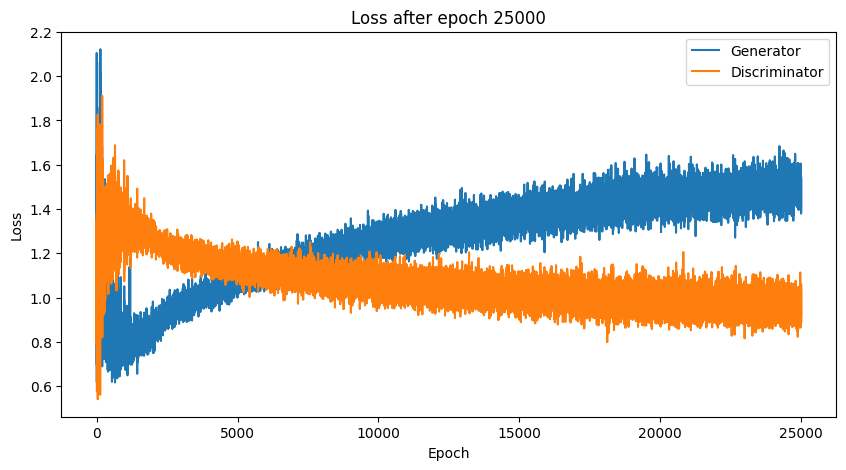

Time for epoch 25000 is 4.065384149551392 sec
Time for epoch 25001 is 0.8601248264312744 sec
Time for epoch 25002 is 0.8588058948516846 sec
Time for epoch 25003 is 0.8673253059387207 sec
Time for epoch 25004 is 0.8623669147491455 sec
Time for epoch 25005 is 0.8672382831573486 sec
Time for epoch 25006 is 0.8739035129547119 sec
Time for epoch 25007 is 0.8729441165924072 sec
Time for epoch 25008 is 0.8701698780059814 sec
Time for epoch 25009 is 0.8761694431304932 sec
Time for epoch 25010 is 0.872563362121582 sec
Time for epoch 25011 is 0.8757178783416748 sec
Time for epoch 25012 is 0.878227949142456 sec
Time for epoch 25013 is 0.8786847591400146 sec
Time for epoch 25014 is 0.8788561820983887 sec
Time for epoch 25015 is 0.8749828338623047 sec
Time for epoch 25016 is 0.8755450248718262 sec
Time for epoch 25017 is 0.8808505535125732 sec
Time for epoch 25018 is 0.8822121620178223 sec
Time for epoch 25019 is 0.8785145282745361 sec
Time for epoch 25020 is 0.8814432621002197 sec
Time for epoch 2

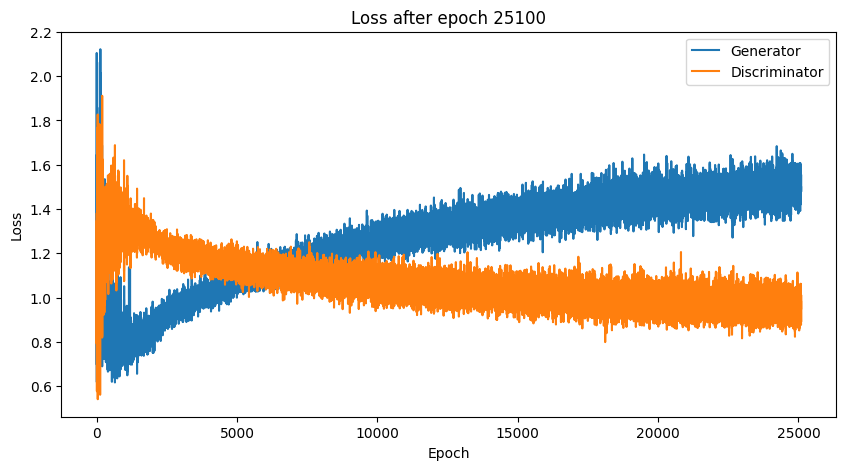

Time for epoch 25100 is 4.0736963748931885 sec
Time for epoch 25101 is 0.8502483367919922 sec
Time for epoch 25102 is 0.8599987030029297 sec
Time for epoch 25103 is 0.8655762672424316 sec
Time for epoch 25104 is 0.8645203113555908 sec
Time for epoch 25105 is 0.8688654899597168 sec
Time for epoch 25106 is 0.8715901374816895 sec
Time for epoch 25107 is 0.8720035552978516 sec
Time for epoch 25108 is 0.8736526966094971 sec
Time for epoch 25109 is 0.8707394599914551 sec
Time for epoch 25110 is 0.8740851879119873 sec
Time for epoch 25111 is 0.8751919269561768 sec
Time for epoch 25112 is 0.8738212585449219 sec
Time for epoch 25113 is 0.8846311569213867 sec
Time for epoch 25114 is 0.8785707950592041 sec
Time for epoch 25115 is 0.8767039775848389 sec
Time for epoch 25116 is 0.8776309490203857 sec
Time for epoch 25117 is 0.8782303333282471 sec
Time for epoch 25118 is 0.8761773109436035 sec
Time for epoch 25119 is 0.878122091293335 sec
Time for epoch 25120 is 0.876539945602417 sec
Time for epoch 

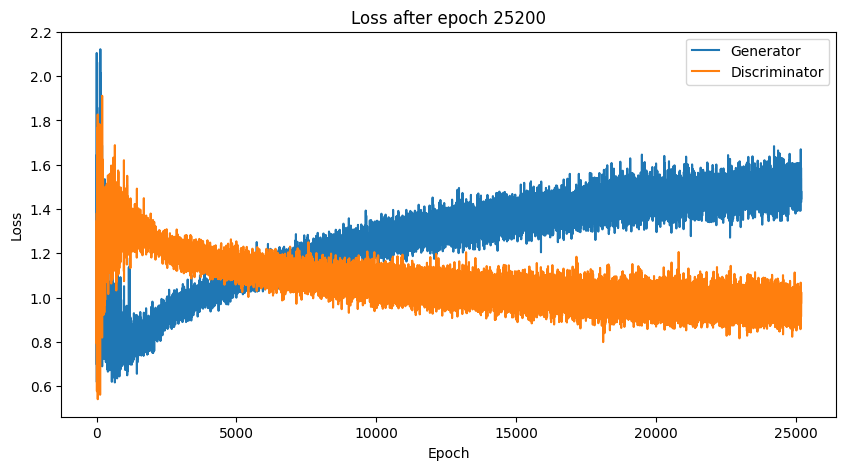

Time for epoch 25200 is 4.114425897598267 sec
Time for epoch 25201 is 0.8613920211791992 sec
Time for epoch 25202 is 0.8594615459442139 sec
Time for epoch 25203 is 0.862595796585083 sec
Time for epoch 25204 is 0.8659117221832275 sec
Time for epoch 25205 is 0.8650023937225342 sec
Time for epoch 25206 is 0.8720536231994629 sec
Time for epoch 25207 is 0.8703560829162598 sec
Time for epoch 25208 is 0.8714416027069092 sec
Time for epoch 25209 is 0.875037431716919 sec
Time for epoch 25210 is 0.875878095626831 sec
Time for epoch 25211 is 0.8745031356811523 sec
Time for epoch 25212 is 0.874420166015625 sec
Time for epoch 25213 is 0.8769757747650146 sec
Time for epoch 25214 is 0.8764834403991699 sec
Time for epoch 25215 is 0.8761844635009766 sec
Time for epoch 25216 is 0.8784348964691162 sec
Time for epoch 25217 is 0.8773229122161865 sec
Time for epoch 25218 is 0.8793139457702637 sec
Time for epoch 25219 is 0.8802154064178467 sec
Time for epoch 25220 is 0.8798296451568604 sec
Time for epoch 252

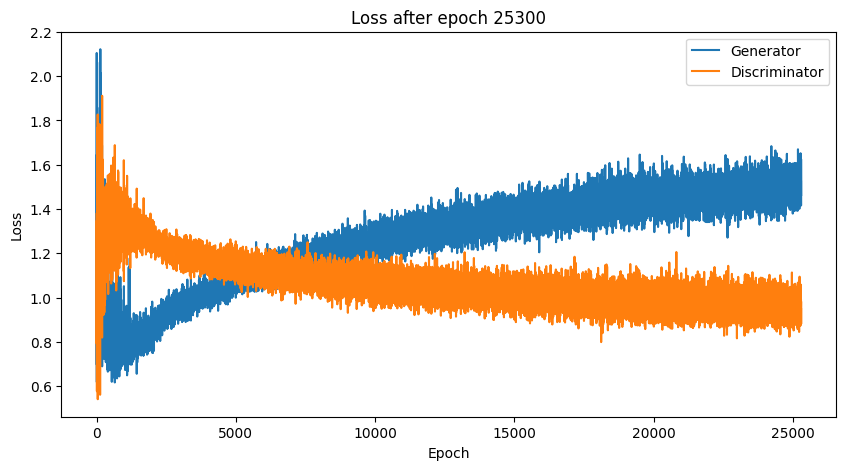

Time for epoch 25300 is 4.047215938568115 sec
Time for epoch 25301 is 0.8620820045471191 sec
Time for epoch 25302 is 0.8598639965057373 sec
Time for epoch 25303 is 0.8650908470153809 sec
Time for epoch 25304 is 0.868793249130249 sec
Time for epoch 25305 is 0.8674299716949463 sec
Time for epoch 25306 is 0.8688907623291016 sec
Time for epoch 25307 is 0.8703608512878418 sec
Time for epoch 25308 is 0.875389814376831 sec
Time for epoch 25309 is 0.8717377185821533 sec
Time for epoch 25310 is 0.8771097660064697 sec
Time for epoch 25311 is 0.8746781349182129 sec
Time for epoch 25312 is 0.8781442642211914 sec
Time for epoch 25313 is 0.8741071224212646 sec
Time for epoch 25314 is 0.8741707801818848 sec
Time for epoch 25315 is 0.8790130615234375 sec
Time for epoch 25316 is 0.8760685920715332 sec
Time for epoch 25317 is 0.8855676651000977 sec
Time for epoch 25318 is 0.8764212131500244 sec
Time for epoch 25319 is 0.8807883262634277 sec
Time for epoch 25320 is 0.8804411888122559 sec
Time for epoch 2

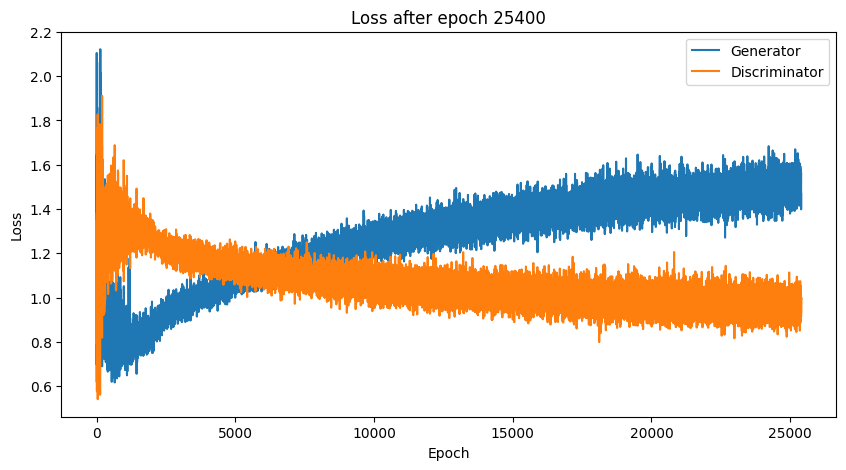

Time for epoch 25400 is 4.0540452003479 sec
Time for epoch 25401 is 0.8587381839752197 sec
Time for epoch 25402 is 0.8558697700500488 sec
Time for epoch 25403 is 0.863288164138794 sec
Time for epoch 25404 is 0.8678383827209473 sec
Time for epoch 25405 is 0.8661601543426514 sec
Time for epoch 25406 is 0.872631311416626 sec
Time for epoch 25407 is 0.8670918941497803 sec
Time for epoch 25408 is 0.8755133152008057 sec
Time for epoch 25409 is 0.8735368251800537 sec
Time for epoch 25410 is 0.876572847366333 sec
Time for epoch 25411 is 0.8739032745361328 sec
Time for epoch 25412 is 0.8742902278900146 sec
Time for epoch 25413 is 0.8739409446716309 sec
Time for epoch 25414 is 0.8758218288421631 sec
Time for epoch 25415 is 0.8771235942840576 sec
Time for epoch 25416 is 0.8779025077819824 sec
Time for epoch 25417 is 0.8779218196868896 sec
Time for epoch 25418 is 0.8804948329925537 sec
Time for epoch 25419 is 0.879035234451294 sec
Time for epoch 25420 is 0.8886709213256836 sec
Time for epoch 25421

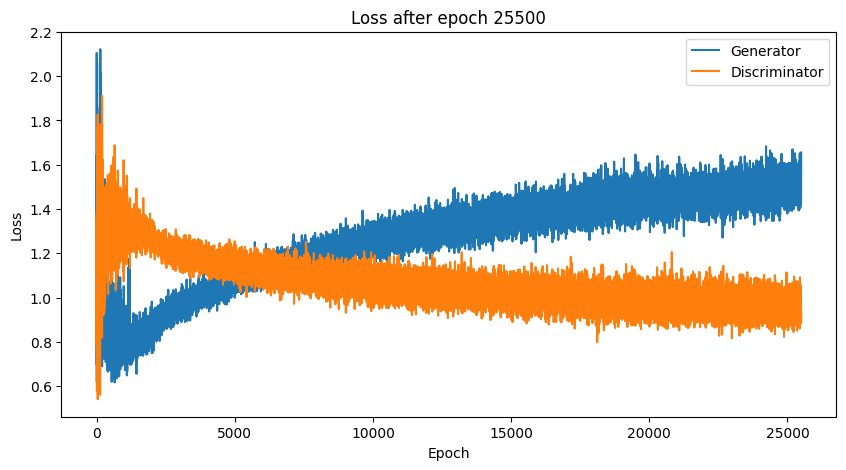

Time for epoch 25500 is 4.029564380645752 sec
Time for epoch 25501 is 0.853752613067627 sec
Time for epoch 25502 is 0.8604385852813721 sec
Time for epoch 25503 is 0.8651182651519775 sec
Time for epoch 25504 is 0.8668618202209473 sec
Time for epoch 25505 is 0.8714284896850586 sec
Time for epoch 25506 is 0.8690218925476074 sec
Time for epoch 25507 is 0.8750922679901123 sec
Time for epoch 25508 is 0.8760161399841309 sec
Time for epoch 25509 is 0.8747513294219971 sec
Time for epoch 25510 is 0.8737602233886719 sec
Time for epoch 25511 is 0.8769323825836182 sec
Time for epoch 25512 is 0.8764066696166992 sec
Time for epoch 25513 is 0.8741374015808105 sec
Time for epoch 25514 is 0.8787631988525391 sec
Time for epoch 25515 is 0.8776884078979492 sec
Time for epoch 25516 is 0.8827178478240967 sec
Time for epoch 25517 is 0.8754580020904541 sec
Time for epoch 25518 is 0.8775026798248291 sec
Time for epoch 25519 is 0.8810780048370361 sec
Time for epoch 25520 is 0.8785147666931152 sec
Time for epoch 

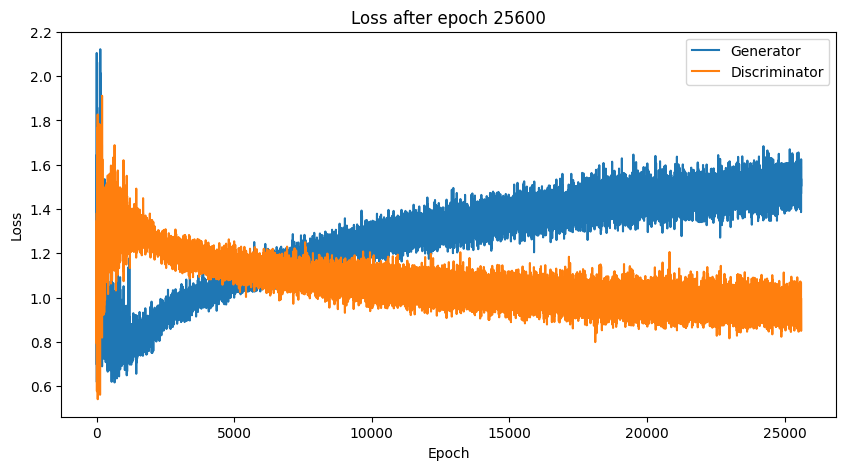

Time for epoch 25600 is 4.103073596954346 sec
Time for epoch 25601 is 0.8479318618774414 sec
Time for epoch 25602 is 0.8690237998962402 sec
Time for epoch 25603 is 0.8654327392578125 sec
Time for epoch 25604 is 0.8631594181060791 sec
Time for epoch 25605 is 0.867365837097168 sec
Time for epoch 25606 is 0.8736836910247803 sec
Time for epoch 25607 is 0.8693346977233887 sec
Time for epoch 25608 is 0.8743247985839844 sec
Time for epoch 25609 is 0.8797783851623535 sec
Time for epoch 25610 is 0.8758392333984375 sec
Time for epoch 25611 is 0.8689529895782471 sec
Time for epoch 25612 is 0.881619930267334 sec
Time for epoch 25613 is 0.8759374618530273 sec
Time for epoch 25614 is 0.8783049583435059 sec
Time for epoch 25615 is 0.8784444332122803 sec
Time for epoch 25616 is 0.8744199275970459 sec
Time for epoch 25617 is 0.8787734508514404 sec
Time for epoch 25618 is 0.8809370994567871 sec
Time for epoch 25619 is 0.8789045810699463 sec
Time for epoch 25620 is 0.8813002109527588 sec
Time for epoch 2

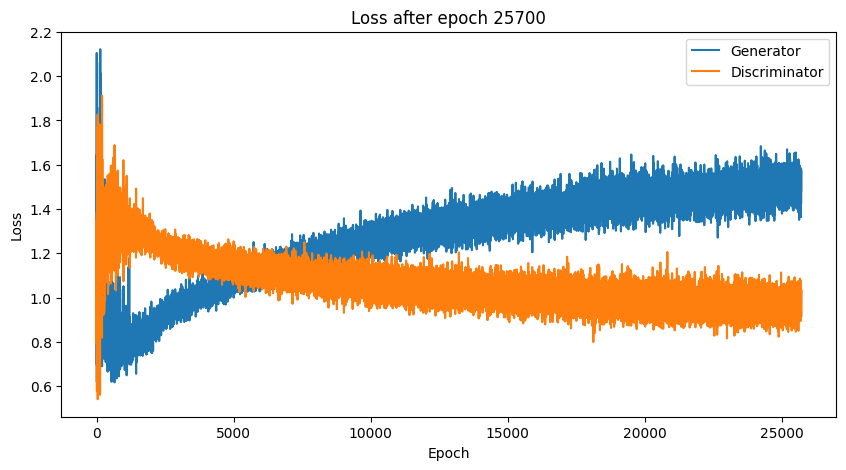

Time for epoch 25700 is 4.048566818237305 sec
Time for epoch 25701 is 0.8614649772644043 sec
Time for epoch 25702 is 0.861577033996582 sec
Time for epoch 25703 is 0.8627374172210693 sec
Time for epoch 25704 is 0.8674798011779785 sec
Time for epoch 25705 is 0.8686127662658691 sec
Time for epoch 25706 is 0.8700263500213623 sec
Time for epoch 25707 is 0.8738183975219727 sec
Time for epoch 25708 is 0.8696365356445312 sec
Time for epoch 25709 is 0.8741917610168457 sec
Time for epoch 25710 is 0.8744590282440186 sec
Time for epoch 25711 is 0.8763813972473145 sec
Time for epoch 25712 is 0.8805623054504395 sec
Time for epoch 25713 is 0.883634090423584 sec
Time for epoch 25714 is 0.8730530738830566 sec
Time for epoch 25715 is 0.8774771690368652 sec
Time for epoch 25716 is 0.8795685768127441 sec
Time for epoch 25717 is 0.8791141510009766 sec
Time for epoch 25718 is 0.8806066513061523 sec
Time for epoch 25719 is 0.8783268928527832 sec
Time for epoch 25720 is 0.8781993389129639 sec
Time for epoch 2

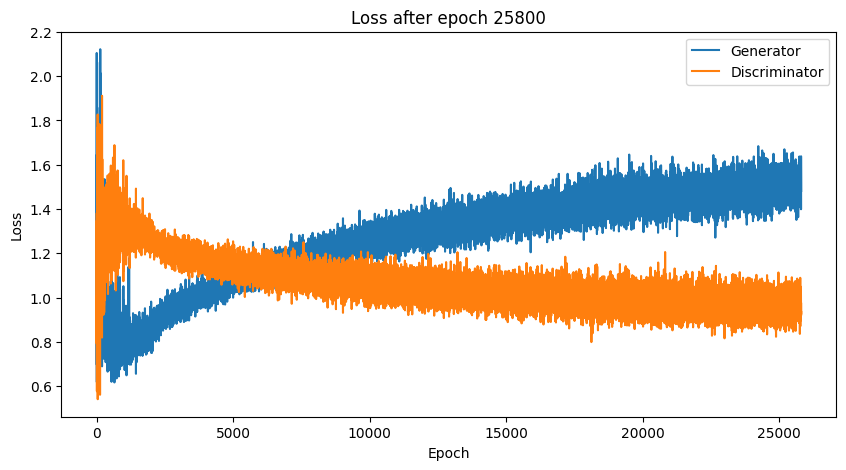

Time for epoch 25800 is 4.040224313735962 sec
Time for epoch 25801 is 0.8679327964782715 sec
Time for epoch 25802 is 0.8567280769348145 sec
Time for epoch 25803 is 0.8670899868011475 sec
Time for epoch 25804 is 0.8673067092895508 sec
Time for epoch 25805 is 0.8625719547271729 sec
Time for epoch 25806 is 0.8719758987426758 sec
Time for epoch 25807 is 0.8706812858581543 sec
Time for epoch 25808 is 0.8693110942840576 sec
Time for epoch 25809 is 0.875084638595581 sec
Time for epoch 25810 is 0.8752470016479492 sec
Time for epoch 25811 is 0.874323844909668 sec
Time for epoch 25812 is 0.8801577091217041 sec
Time for epoch 25813 is 0.8753087520599365 sec
Time for epoch 25814 is 0.8753232955932617 sec
Time for epoch 25815 is 0.8797957897186279 sec
Time for epoch 25816 is 0.879798412322998 sec
Time for epoch 25817 is 0.876617431640625 sec
Time for epoch 25818 is 0.8759007453918457 sec
Time for epoch 25819 is 0.8790085315704346 sec
Time for epoch 25820 is 0.884331226348877 sec
Time for epoch 2582

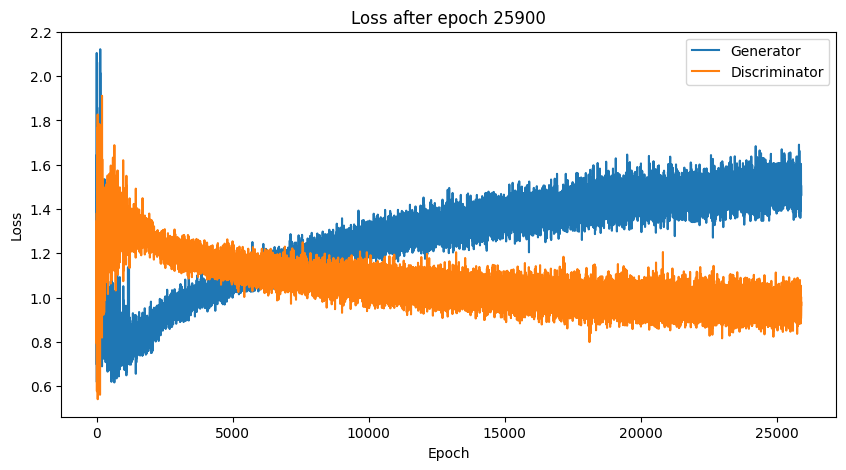

Time for epoch 25900 is 4.051872730255127 sec
Time for epoch 25901 is 0.8688263893127441 sec
Time for epoch 25902 is 0.859093427658081 sec
Time for epoch 25903 is 0.8649718761444092 sec
Time for epoch 25904 is 0.8660156726837158 sec
Time for epoch 25905 is 0.8660826683044434 sec
Time for epoch 25906 is 0.8726465702056885 sec
Time for epoch 25907 is 0.8686869144439697 sec
Time for epoch 25908 is 0.8713991641998291 sec
Time for epoch 25909 is 0.8766214847564697 sec
Time for epoch 25910 is 0.8771016597747803 sec
Time for epoch 25911 is 0.8747920989990234 sec
Time for epoch 25912 is 0.8762369155883789 sec
Time for epoch 25913 is 0.8758544921875 sec
Time for epoch 25914 is 0.8748927116394043 sec
Time for epoch 25915 is 0.8779451847076416 sec
Time for epoch 25916 is 0.882073163986206 sec
Time for epoch 25917 is 0.8784499168395996 sec
Time for epoch 25918 is 0.8798296451568604 sec
Time for epoch 25919 is 0.8837132453918457 sec
Time for epoch 25920 is 0.8824167251586914 sec
Time for epoch 2592

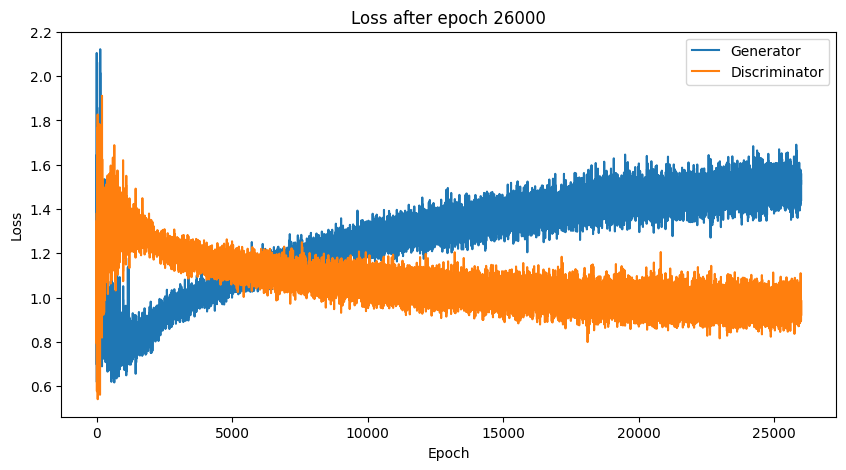

Time for epoch 26000 is 4.075060606002808 sec
Time for epoch 26001 is 0.862635612487793 sec
Time for epoch 26002 is 0.8603384494781494 sec
Time for epoch 26003 is 0.8582937717437744 sec
Time for epoch 26004 is 0.8660950660705566 sec
Time for epoch 26005 is 0.8722820281982422 sec
Time for epoch 26006 is 0.8688488006591797 sec
Time for epoch 26007 is 0.8717947006225586 sec
Time for epoch 26008 is 0.8700053691864014 sec
Time for epoch 26009 is 0.8735561370849609 sec
Time for epoch 26010 is 0.8728797435760498 sec
Time for epoch 26011 is 0.8721082210540771 sec
Time for epoch 26012 is 0.8798298835754395 sec
Time for epoch 26013 is 0.8758432865142822 sec
Time for epoch 26014 is 0.8789331912994385 sec
Time for epoch 26015 is 0.87888503074646 sec
Time for epoch 26016 is 0.8753767013549805 sec
Time for epoch 26017 is 0.8817508220672607 sec
Time for epoch 26018 is 0.8785440921783447 sec
Time for epoch 26019 is 0.8801219463348389 sec
Time for epoch 26020 is 0.8828282356262207 sec
Time for epoch 26

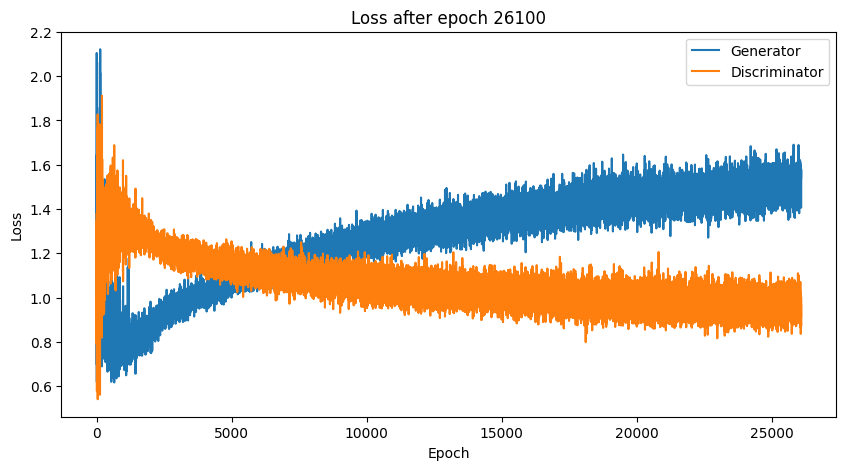

Time for epoch 26100 is 4.029266834259033 sec
Time for epoch 26101 is 0.8555581569671631 sec
Time for epoch 26102 is 0.8629148006439209 sec
Time for epoch 26103 is 0.8639044761657715 sec
Time for epoch 26104 is 0.8717291355133057 sec
Time for epoch 26105 is 0.86663818359375 sec
Time for epoch 26106 is 0.8686227798461914 sec
Time for epoch 26107 is 0.8718118667602539 sec
Time for epoch 26108 is 0.8686838150024414 sec
Time for epoch 26109 is 0.8805882930755615 sec
Time for epoch 26110 is 0.8693482875823975 sec
Time for epoch 26111 is 0.8826072216033936 sec
Time for epoch 26112 is 0.8719692230224609 sec
Time for epoch 26113 is 0.876603364944458 sec
Time for epoch 26114 is 0.8755667209625244 sec
Time for epoch 26115 is 0.8770761489868164 sec
Time for epoch 26116 is 0.8757758140563965 sec
Time for epoch 26117 is 0.8789279460906982 sec
Time for epoch 26118 is 0.8791966438293457 sec
Time for epoch 26119 is 0.8786776065826416 sec
Time for epoch 26120 is 0.8818931579589844 sec
Time for epoch 26

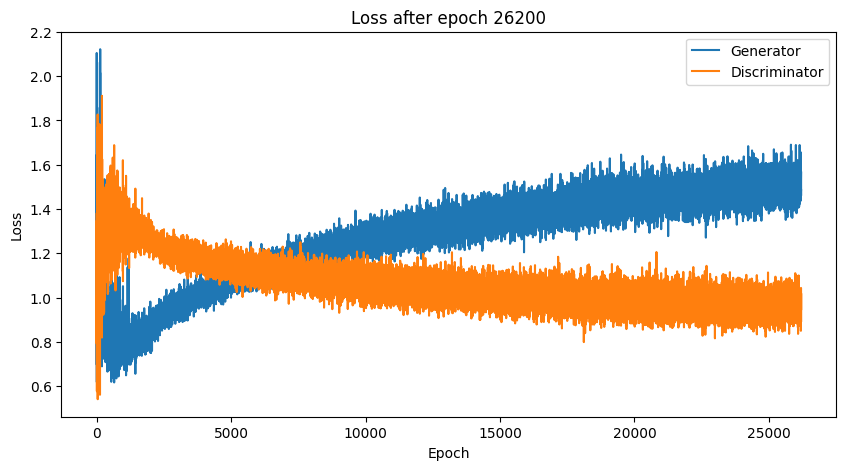

Time for epoch 26200 is 4.071544647216797 sec
Time for epoch 26201 is 0.8613476753234863 sec
Time for epoch 26202 is 0.8600542545318604 sec
Time for epoch 26203 is 0.8658812046051025 sec
Time for epoch 26204 is 0.8659169673919678 sec
Time for epoch 26205 is 0.8679351806640625 sec
Time for epoch 26206 is 0.8699789047241211 sec
Time for epoch 26207 is 0.8700706958770752 sec
Time for epoch 26208 is 0.8725137710571289 sec
Time for epoch 26209 is 0.873199462890625 sec
Time for epoch 26210 is 0.8806445598602295 sec
Time for epoch 26211 is 0.8735496997833252 sec
Time for epoch 26212 is 0.8755230903625488 sec
Time for epoch 26213 is 0.8753559589385986 sec
Time for epoch 26214 is 0.8775084018707275 sec
Time for epoch 26215 is 0.8842673301696777 sec
Time for epoch 26216 is 0.8736147880554199 sec
Time for epoch 26217 is 0.8837974071502686 sec
Time for epoch 26218 is 0.8797018527984619 sec
Time for epoch 26219 is 0.8791897296905518 sec
Time for epoch 26220 is 0.88077712059021 sec
Time for epoch 26

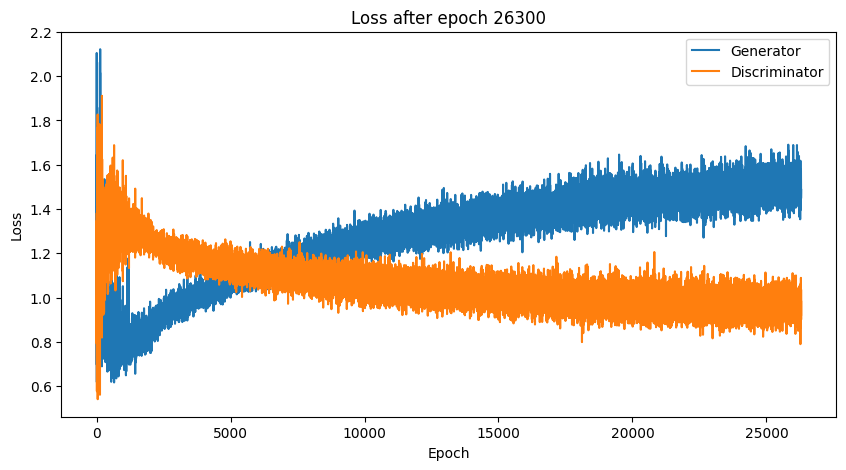

Time for epoch 26300 is 4.237991809844971 sec
Time for epoch 26301 is 0.8625707626342773 sec
Time for epoch 26302 is 0.857865571975708 sec
Time for epoch 26303 is 0.8641543388366699 sec
Time for epoch 26304 is 0.8677892684936523 sec
Time for epoch 26305 is 0.8632771968841553 sec
Time for epoch 26306 is 0.8685011863708496 sec
Time for epoch 26307 is 0.8707065582275391 sec
Time for epoch 26308 is 0.8676831722259521 sec
Time for epoch 26309 is 0.8751187324523926 sec
Time for epoch 26310 is 0.8757805824279785 sec
Time for epoch 26311 is 0.8747048377990723 sec
Time for epoch 26312 is 0.8738532066345215 sec
Time for epoch 26313 is 0.8770186901092529 sec
Time for epoch 26314 is 0.8773956298828125 sec
Time for epoch 26315 is 0.8780663013458252 sec
Time for epoch 26316 is 0.8771395683288574 sec
Time for epoch 26317 is 0.8810184001922607 sec
Time for epoch 26318 is 0.8794522285461426 sec
Time for epoch 26319 is 0.8788003921508789 sec
Time for epoch 26320 is 0.8830721378326416 sec
Time for epoch 

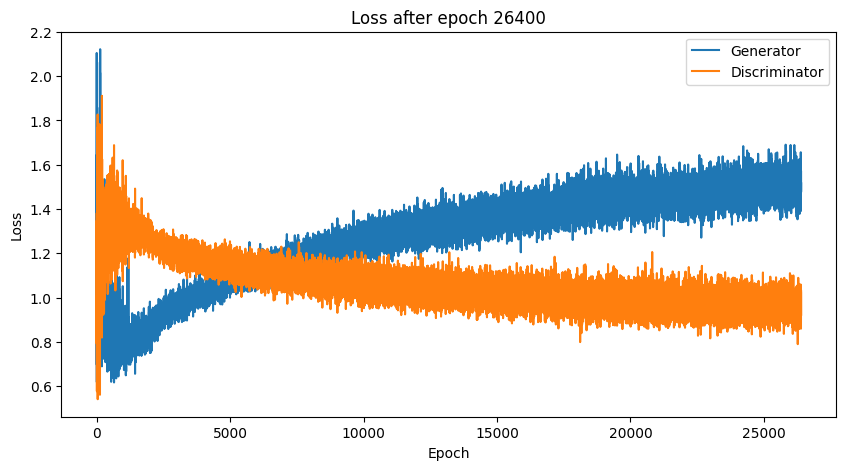

Time for epoch 26400 is 4.049577474594116 sec
Time for epoch 26401 is 0.8610355854034424 sec
Time for epoch 26402 is 0.8601467609405518 sec
Time for epoch 26403 is 0.8697233200073242 sec
Time for epoch 26404 is 0.8602538108825684 sec
Time for epoch 26405 is 0.8664312362670898 sec
Time for epoch 26406 is 0.8687632083892822 sec
Time for epoch 26407 is 0.8740122318267822 sec
Time for epoch 26408 is 0.8693461418151855 sec
Time for epoch 26409 is 0.8734643459320068 sec
Time for epoch 26410 is 0.8784992694854736 sec
Time for epoch 26411 is 0.8699679374694824 sec
Time for epoch 26412 is 0.876173734664917 sec
Time for epoch 26413 is 0.8763964176177979 sec
Time for epoch 26414 is 0.8764972686767578 sec
Time for epoch 26415 is 0.8759386539459229 sec
Time for epoch 26416 is 0.8766682147979736 sec
Time for epoch 26417 is 0.8788473606109619 sec
Time for epoch 26418 is 0.8810558319091797 sec
Time for epoch 26419 is 0.8778445720672607 sec
Time for epoch 26420 is 0.8831958770751953 sec
Time for epoch 

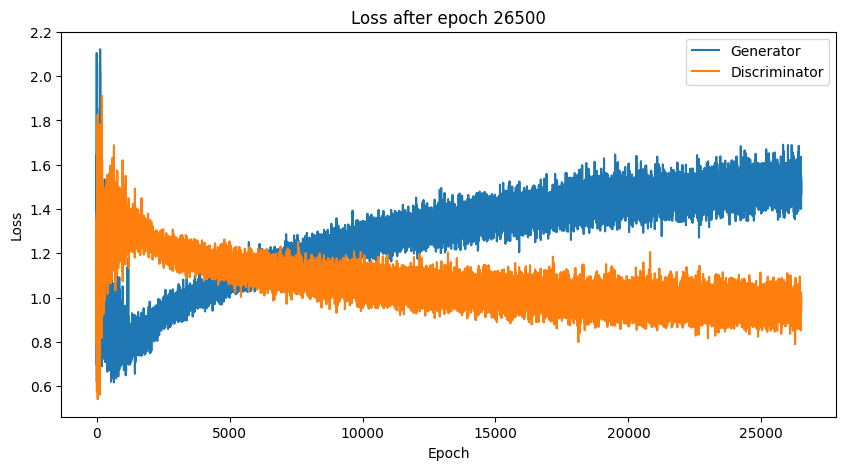

Time for epoch 26500 is 4.076957941055298 sec
Time for epoch 26501 is 0.8585262298583984 sec
Time for epoch 26502 is 0.85691237449646 sec
Time for epoch 26503 is 0.8682646751403809 sec
Time for epoch 26504 is 0.863943338394165 sec
Time for epoch 26505 is 0.8681390285491943 sec
Time for epoch 26506 is 0.8718764781951904 sec
Time for epoch 26507 is 0.8725743293762207 sec
Time for epoch 26508 is 0.8701715469360352 sec
Time for epoch 26509 is 0.8813979625701904 sec
Time for epoch 26510 is 0.8684875965118408 sec
Time for epoch 26511 is 0.8731000423431396 sec
Time for epoch 26512 is 0.8790521621704102 sec
Time for epoch 26513 is 0.8772003650665283 sec
Time for epoch 26514 is 0.8735976219177246 sec
Time for epoch 26515 is 0.8799111843109131 sec
Time for epoch 26516 is 0.8793172836303711 sec
Time for epoch 26517 is 0.8855915069580078 sec
Time for epoch 26518 is 0.8783750534057617 sec
Time for epoch 26519 is 0.8808557987213135 sec
Time for epoch 26520 is 0.884321928024292 sec
Time for epoch 265

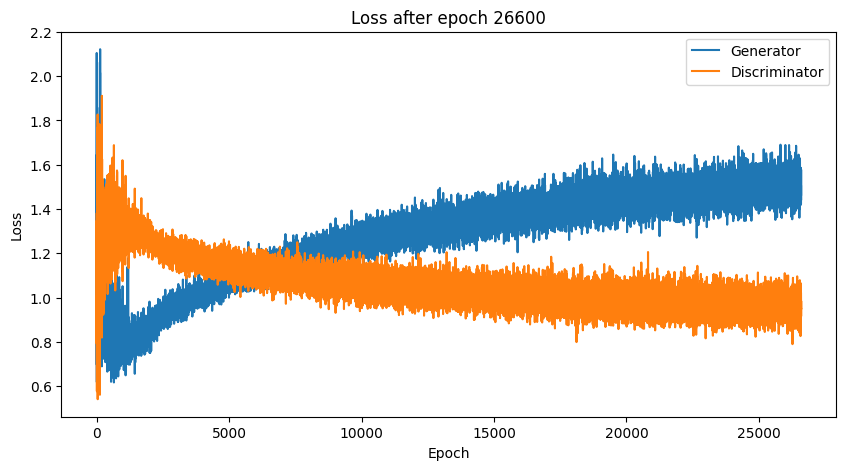

Time for epoch 26600 is 4.1502463817596436 sec
Time for epoch 26601 is 0.8686807155609131 sec
Time for epoch 26602 is 0.8592588901519775 sec
Time for epoch 26603 is 0.8670022487640381 sec
Time for epoch 26604 is 0.8628301620483398 sec
Time for epoch 26605 is 0.868121862411499 sec
Time for epoch 26606 is 0.8720190525054932 sec
Time for epoch 26607 is 0.8749532699584961 sec
Time for epoch 26608 is 0.8708667755126953 sec
Time for epoch 26609 is 0.8780961036682129 sec
Time for epoch 26610 is 0.8782906532287598 sec
Time for epoch 26611 is 0.8762564659118652 sec
Time for epoch 26612 is 0.8716006278991699 sec
Time for epoch 26613 is 0.8771319389343262 sec
Time for epoch 26614 is 0.8774611949920654 sec
Time for epoch 26615 is 0.8766553401947021 sec
Time for epoch 26616 is 0.8816871643066406 sec
Time for epoch 26617 is 0.8762969970703125 sec
Time for epoch 26618 is 0.8758511543273926 sec
Time for epoch 26619 is 0.8784661293029785 sec
Time for epoch 26620 is 0.8828537464141846 sec
Time for epoch

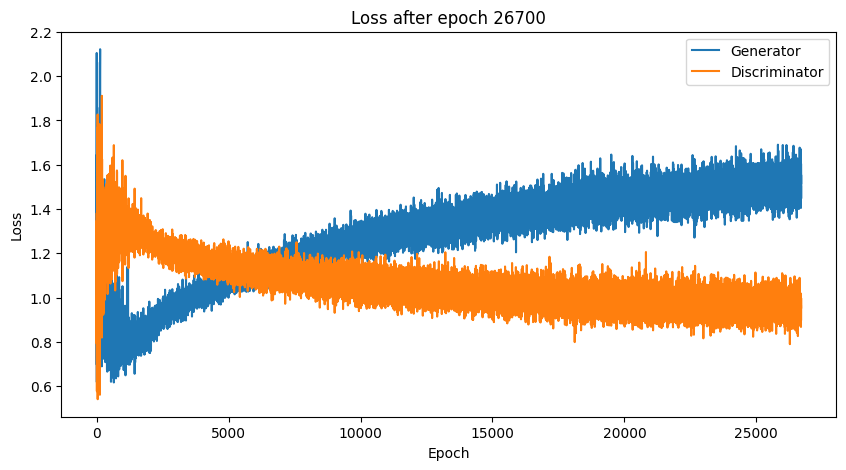

Time for epoch 26700 is 4.099786996841431 sec
Time for epoch 26701 is 0.8545386791229248 sec
Time for epoch 26702 is 0.8579521179199219 sec
Time for epoch 26703 is 0.8649806976318359 sec
Time for epoch 26704 is 0.8638565540313721 sec
Time for epoch 26705 is 0.8699734210968018 sec
Time for epoch 26706 is 0.8727202415466309 sec
Time for epoch 26707 is 0.8711450099945068 sec
Time for epoch 26708 is 0.8676910400390625 sec
Time for epoch 26709 is 0.8744854927062988 sec
Time for epoch 26710 is 0.8748576641082764 sec
Time for epoch 26711 is 0.8780026435852051 sec
Time for epoch 26712 is 0.8709816932678223 sec
Time for epoch 26713 is 0.8759236335754395 sec
Time for epoch 26714 is 0.8776147365570068 sec
Time for epoch 26715 is 0.8731348514556885 sec
Time for epoch 26716 is 0.886568546295166 sec
Time for epoch 26717 is 0.8817403316497803 sec
Time for epoch 26718 is 0.8809685707092285 sec
Time for epoch 26719 is 0.8818886280059814 sec
Time for epoch 26720 is 0.8783879280090332 sec
Time for epoch 

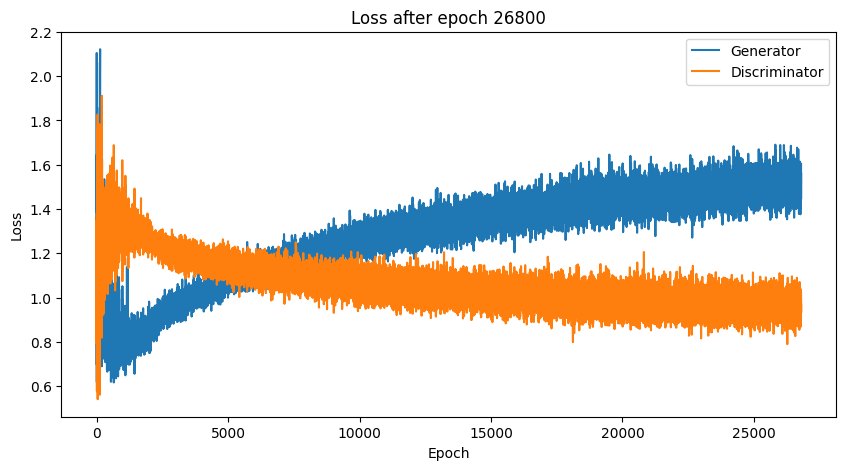

Time for epoch 26800 is 4.041688680648804 sec
Time for epoch 26801 is 0.8553991317749023 sec
Time for epoch 26802 is 0.8603916168212891 sec
Time for epoch 26803 is 0.8653619289398193 sec
Time for epoch 26804 is 0.8648569583892822 sec
Time for epoch 26805 is 0.8715803623199463 sec
Time for epoch 26806 is 0.8698980808258057 sec
Time for epoch 26807 is 0.8765039443969727 sec
Time for epoch 26808 is 0.8770132064819336 sec
Time for epoch 26809 is 0.872826099395752 sec
Time for epoch 26810 is 0.8754308223724365 sec
Time for epoch 26811 is 0.8735277652740479 sec
Time for epoch 26812 is 0.8776335716247559 sec
Time for epoch 26813 is 0.8781464099884033 sec
Time for epoch 26814 is 0.8763763904571533 sec
Time for epoch 26815 is 0.8733775615692139 sec
Time for epoch 26816 is 0.8806891441345215 sec
Time for epoch 26817 is 0.8793861865997314 sec
Time for epoch 26818 is 0.8790767192840576 sec
Time for epoch 26819 is 0.8799862861633301 sec
Time for epoch 26820 is 0.8809053897857666 sec
Time for epoch 

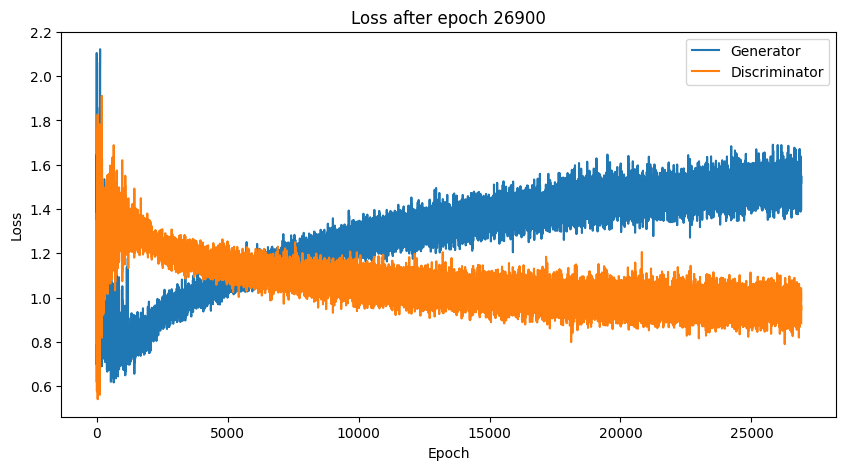

Time for epoch 26900 is 4.092228412628174 sec
Time for epoch 26901 is 0.8476006984710693 sec
Time for epoch 26902 is 0.8574090003967285 sec
Time for epoch 26903 is 0.8642551898956299 sec
Time for epoch 26904 is 0.8663351535797119 sec
Time for epoch 26905 is 0.8663113117218018 sec
Time for epoch 26906 is 0.8720111846923828 sec
Time for epoch 26907 is 0.8672690391540527 sec
Time for epoch 26908 is 0.8759324550628662 sec
Time for epoch 26909 is 0.8745286464691162 sec
Time for epoch 26910 is 0.8731319904327393 sec
Time for epoch 26911 is 0.8763773441314697 sec
Time for epoch 26912 is 0.8793160915374756 sec
Time for epoch 26913 is 0.8754270076751709 sec
Time for epoch 26914 is 0.8789818286895752 sec
Time for epoch 26915 is 0.8794167041778564 sec
Time for epoch 26916 is 0.8743374347686768 sec
Time for epoch 26917 is 0.8802928924560547 sec
Time for epoch 26918 is 0.8748931884765625 sec
Time for epoch 26919 is 0.8814191818237305 sec
Time for epoch 26920 is 0.8755764961242676 sec
Time for epoch

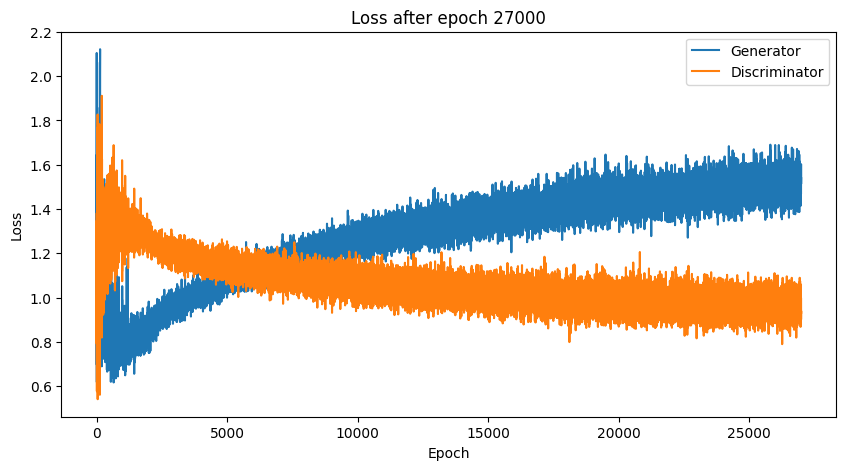

Time for epoch 27000 is 4.061175584793091 sec
Time for epoch 27001 is 0.8641173839569092 sec
Time for epoch 27002 is 0.8619709014892578 sec
Time for epoch 27003 is 0.86895751953125 sec
Time for epoch 27004 is 0.8635785579681396 sec
Time for epoch 27005 is 0.8663675785064697 sec
Time for epoch 27006 is 0.8752810955047607 sec
Time for epoch 27007 is 0.8735127449035645 sec
Time for epoch 27008 is 0.8723397254943848 sec
Time for epoch 27009 is 0.8722615242004395 sec
Time for epoch 27010 is 0.8719415664672852 sec
Time for epoch 27011 is 0.8777999877929688 sec
Time for epoch 27012 is 0.8729901313781738 sec
Time for epoch 27013 is 0.875652551651001 sec
Time for epoch 27014 is 0.8747413158416748 sec
Time for epoch 27015 is 0.8787126541137695 sec
Time for epoch 27016 is 0.8790295124053955 sec
Time for epoch 27017 is 0.8787961006164551 sec
Time for epoch 27018 is 0.88232421875 sec
Time for epoch 27019 is 0.8803761005401611 sec
Time for epoch 27020 is 0.8823232650756836 sec
Time for epoch 27021 i

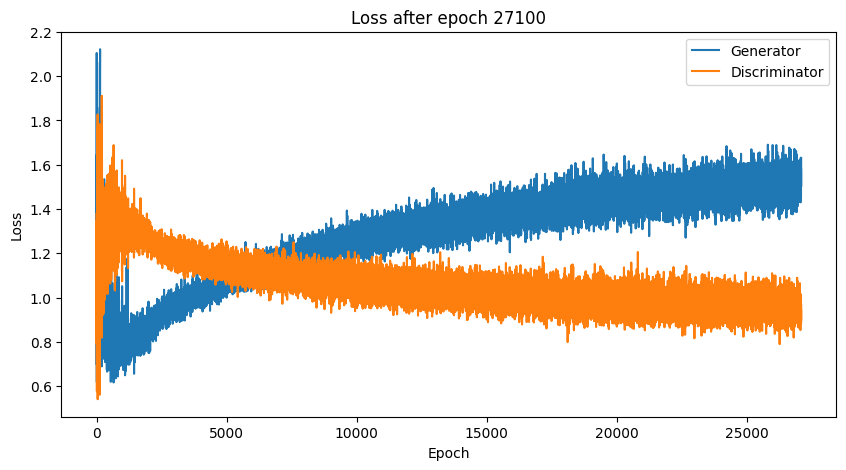

Time for epoch 27100 is 4.168445348739624 sec
Time for epoch 27101 is 0.8588414192199707 sec
Time for epoch 27102 is 0.8561711311340332 sec
Time for epoch 27103 is 0.8655858039855957 sec
Time for epoch 27104 is 0.8657016754150391 sec
Time for epoch 27105 is 0.8688292503356934 sec
Time for epoch 27106 is 0.8731515407562256 sec
Time for epoch 27107 is 0.8704712390899658 sec
Time for epoch 27108 is 0.8756752014160156 sec
Time for epoch 27109 is 0.8743500709533691 sec
Time for epoch 27110 is 0.8732612133026123 sec
Time for epoch 27111 is 0.8758871555328369 sec
Time for epoch 27112 is 0.8721063137054443 sec
Time for epoch 27113 is 0.8733673095703125 sec
Time for epoch 27114 is 0.8760278224945068 sec
Time for epoch 27115 is 0.8797445297241211 sec
Time for epoch 27116 is 0.8788340091705322 sec
Time for epoch 27117 is 0.8794317245483398 sec
Time for epoch 27118 is 0.8760218620300293 sec
Time for epoch 27119 is 0.8805088996887207 sec
Time for epoch 27120 is 0.875636100769043 sec
Time for epoch 

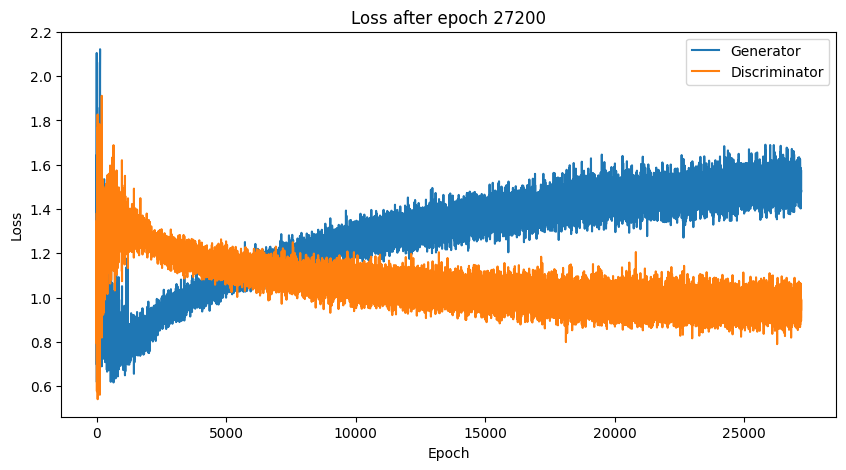

Time for epoch 27200 is 4.095005035400391 sec
Time for epoch 27201 is 0.8483994007110596 sec
Time for epoch 27202 is 0.8640356063842773 sec
Time for epoch 27203 is 0.8596761226654053 sec
Time for epoch 27204 is 0.8645107746124268 sec
Time for epoch 27205 is 0.8693149089813232 sec
Time for epoch 27206 is 0.8709793090820312 sec
Time for epoch 27207 is 0.8711357116699219 sec
Time for epoch 27208 is 0.8739039897918701 sec
Time for epoch 27209 is 0.874915599822998 sec
Time for epoch 27210 is 0.8760876655578613 sec
Time for epoch 27211 is 0.8756353855133057 sec
Time for epoch 27212 is 0.8758363723754883 sec
Time for epoch 27213 is 0.8792445659637451 sec
Time for epoch 27214 is 0.8798246383666992 sec
Time for epoch 27215 is 0.8750059604644775 sec
Time for epoch 27216 is 0.8794238567352295 sec
Time for epoch 27217 is 0.8748292922973633 sec
Time for epoch 27218 is 0.8769826889038086 sec
Time for epoch 27219 is 0.8806688785552979 sec
Time for epoch 27220 is 0.8815021514892578 sec
Time for epoch 

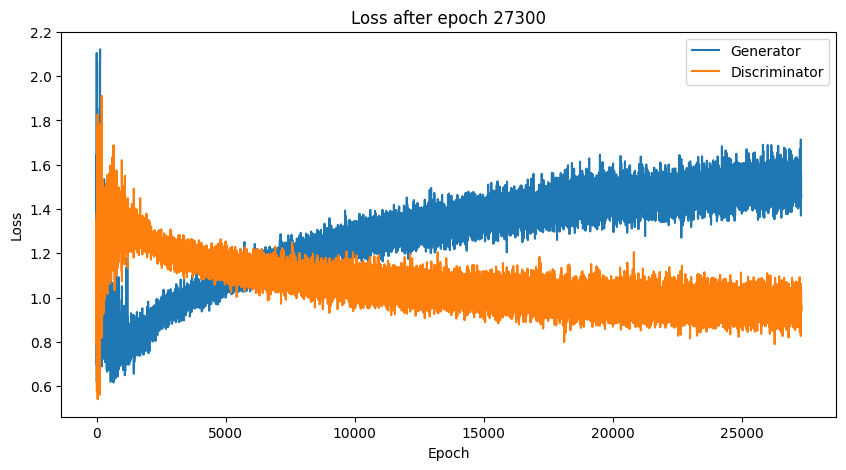

Time for epoch 27300 is 4.09794020652771 sec
Time for epoch 27301 is 0.8590545654296875 sec
Time for epoch 27302 is 0.8581893444061279 sec
Time for epoch 27303 is 0.8620450496673584 sec
Time for epoch 27304 is 0.8668792247772217 sec
Time for epoch 27305 is 0.8634140491485596 sec
Time for epoch 27306 is 0.8740360736846924 sec
Time for epoch 27307 is 0.8713815212249756 sec
Time for epoch 27308 is 0.8724052906036377 sec
Time for epoch 27309 is 0.8780934810638428 sec
Time for epoch 27310 is 0.8743278980255127 sec
Time for epoch 27311 is 0.8720066547393799 sec
Time for epoch 27312 is 0.885035514831543 sec
Time for epoch 27313 is 0.874218225479126 sec
Time for epoch 27314 is 0.8735949993133545 sec
Time for epoch 27315 is 0.8814799785614014 sec
Time for epoch 27316 is 0.8747806549072266 sec
Time for epoch 27317 is 0.8809411525726318 sec
Time for epoch 27318 is 0.8804745674133301 sec
Time for epoch 27319 is 0.8794491291046143 sec
Time for epoch 27320 is 0.8790450096130371 sec
Time for epoch 27

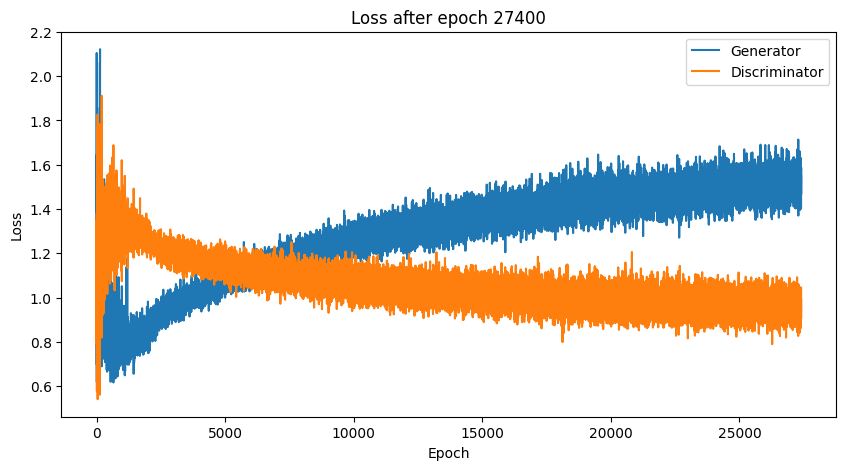

Time for epoch 27400 is 4.056537866592407 sec
Time for epoch 27401 is 0.8563470840454102 sec
Time for epoch 27402 is 0.8569691181182861 sec
Time for epoch 27403 is 0.8642933368682861 sec
Time for epoch 27404 is 0.8684446811676025 sec
Time for epoch 27405 is 0.8687713146209717 sec
Time for epoch 27406 is 0.8708419799804688 sec
Time for epoch 27407 is 0.8679342269897461 sec
Time for epoch 27408 is 0.880652666091919 sec
Time for epoch 27409 is 0.8732442855834961 sec
Time for epoch 27410 is 0.8718481063842773 sec
Time for epoch 27411 is 0.8723206520080566 sec
Time for epoch 27412 is 0.8739564418792725 sec
Time for epoch 27413 is 0.8763208389282227 sec
Time for epoch 27414 is 0.8764009475708008 sec
Time for epoch 27415 is 0.877838134765625 sec
Time for epoch 27416 is 0.8778047561645508 sec
Time for epoch 27417 is 0.8804497718811035 sec
Time for epoch 27418 is 0.874629020690918 sec
Time for epoch 27419 is 0.8799595832824707 sec
Time for epoch 27420 is 0.8848419189453125 sec
Time for epoch 27

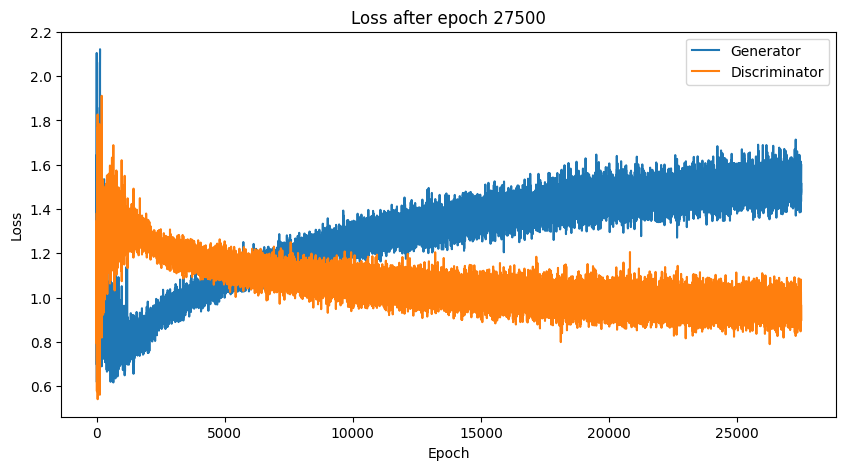

Time for epoch 27500 is 4.063944578170776 sec
Time for epoch 27501 is 0.8548157215118408 sec
Time for epoch 27502 is 0.8614206314086914 sec
Time for epoch 27503 is 0.8652980327606201 sec
Time for epoch 27504 is 0.8655998706817627 sec
Time for epoch 27505 is 0.8719503879547119 sec
Time for epoch 27506 is 0.8742039203643799 sec
Time for epoch 27507 is 0.868685245513916 sec
Time for epoch 27508 is 0.8768162727355957 sec
Time for epoch 27509 is 0.8737990856170654 sec
Time for epoch 27510 is 0.8763909339904785 sec
Time for epoch 27511 is 0.8748955726623535 sec
Time for epoch 27512 is 0.8759889602661133 sec
Time for epoch 27513 is 0.8769662380218506 sec
Time for epoch 27514 is 0.8808510303497314 sec
Time for epoch 27515 is 0.8810203075408936 sec
Time for epoch 27516 is 0.8751249313354492 sec
Time for epoch 27517 is 0.879328727722168 sec
Time for epoch 27518 is 0.878089189529419 sec
Time for epoch 27519 is 0.8821775913238525 sec
Time for epoch 27520 is 0.8796563148498535 sec
Time for epoch 27

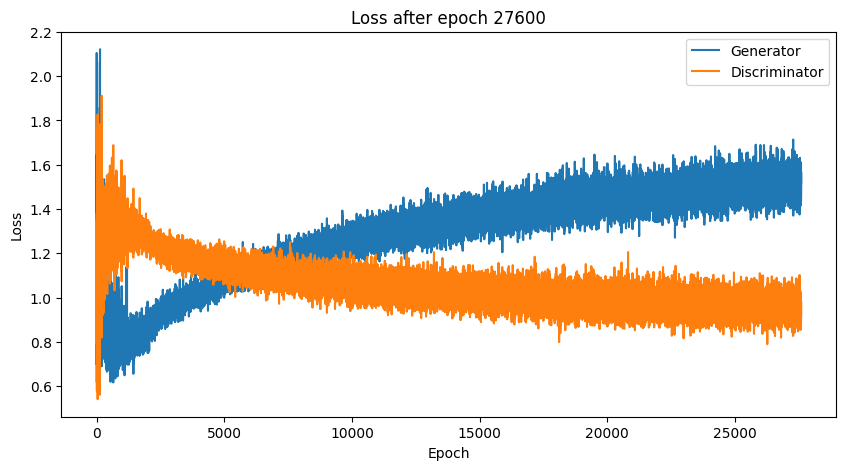

Time for epoch 27600 is 4.108047246932983 sec
Time for epoch 27601 is 0.8664734363555908 sec
Time for epoch 27602 is 0.8561711311340332 sec
Time for epoch 27603 is 0.8636798858642578 sec
Time for epoch 27604 is 0.8676891326904297 sec
Time for epoch 27605 is 0.862764835357666 sec
Time for epoch 27606 is 0.8679842948913574 sec
Time for epoch 27607 is 0.871767520904541 sec
Time for epoch 27608 is 0.8746368885040283 sec
Time for epoch 27609 is 0.875687837600708 sec
Time for epoch 27610 is 0.8686115741729736 sec
Time for epoch 27611 is 0.8762297630310059 sec
Time for epoch 27612 is 0.8760285377502441 sec
Time for epoch 27613 is 0.8753407001495361 sec
Time for epoch 27614 is 0.8781900405883789 sec
Time for epoch 27615 is 0.8755557537078857 sec
Time for epoch 27616 is 0.8801259994506836 sec
Time for epoch 27617 is 0.8799538612365723 sec
Time for epoch 27618 is 0.8791835308074951 sec
Time for epoch 27619 is 0.8779642581939697 sec
Time for epoch 27620 is 0.8851368427276611 sec
Time for epoch 27

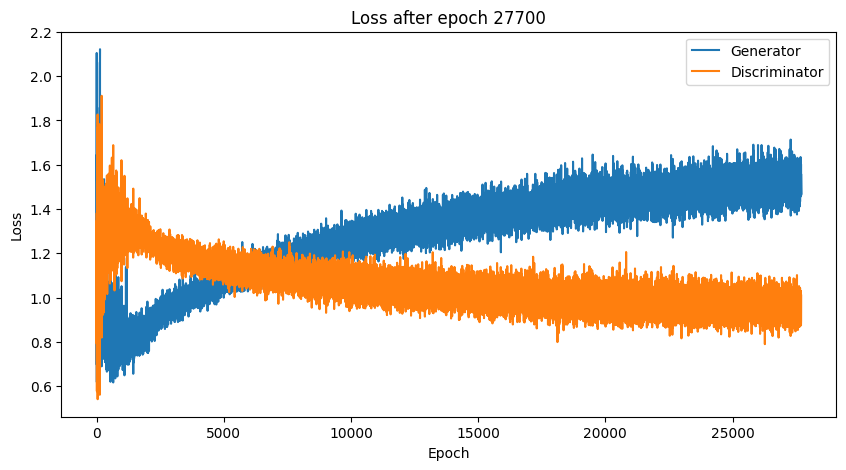

Time for epoch 27700 is 4.1036906242370605 sec
Time for epoch 27701 is 0.8629307746887207 sec
Time for epoch 27702 is 0.8638272285461426 sec
Time for epoch 27703 is 0.8600573539733887 sec
Time for epoch 27704 is 0.8647201061248779 sec
Time for epoch 27705 is 0.8714532852172852 sec
Time for epoch 27706 is 0.8674767017364502 sec
Time for epoch 27707 is 0.8711867332458496 sec
Time for epoch 27708 is 0.870208740234375 sec
Time for epoch 27709 is 0.8798198699951172 sec
Time for epoch 27710 is 0.876300573348999 sec
Time for epoch 27711 is 0.8738486766815186 sec
Time for epoch 27712 is 0.8748733997344971 sec
Time for epoch 27713 is 0.8776483535766602 sec
Time for epoch 27714 is 0.876300573348999 sec
Time for epoch 27715 is 0.8827662467956543 sec
Time for epoch 27716 is 0.874422550201416 sec
Time for epoch 27717 is 0.8816101551055908 sec
Time for epoch 27718 is 0.8779416084289551 sec
Time for epoch 27719 is 0.8790841102600098 sec
Time for epoch 27720 is 0.8799359798431396 sec
Time for epoch 27

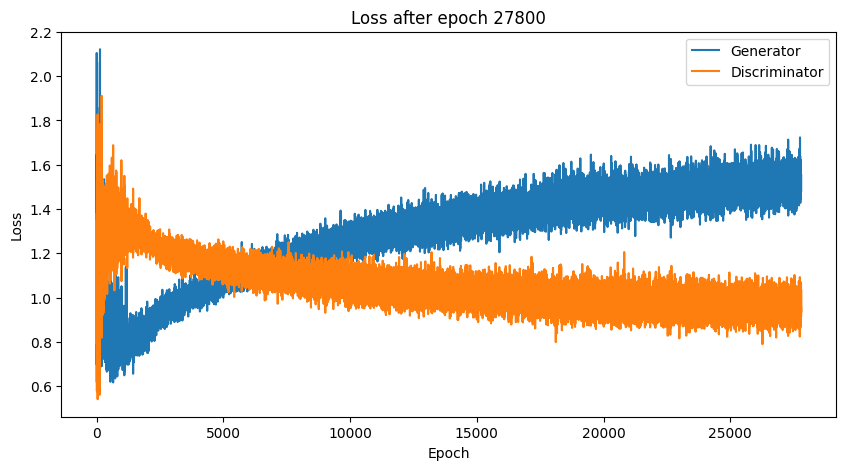

Time for epoch 27800 is 4.103427171707153 sec
Time for epoch 27801 is 0.8548414707183838 sec
Time for epoch 27802 is 0.8588285446166992 sec
Time for epoch 27803 is 0.8631839752197266 sec
Time for epoch 27804 is 0.870011568069458 sec
Time for epoch 27805 is 0.865067720413208 sec
Time for epoch 27806 is 0.8730762004852295 sec
Time for epoch 27807 is 0.8682386875152588 sec
Time for epoch 27808 is 0.8800547122955322 sec
Time for epoch 27809 is 0.8718781471252441 sec
Time for epoch 27810 is 0.877955436706543 sec
Time for epoch 27811 is 0.8756730556488037 sec
Time for epoch 27812 is 0.8754513263702393 sec
Time for epoch 27813 is 0.8782021999359131 sec
Time for epoch 27814 is 0.8730525970458984 sec
Time for epoch 27815 is 0.8764939308166504 sec
Time for epoch 27816 is 0.883467435836792 sec
Time for epoch 27817 is 0.8725147247314453 sec
Time for epoch 27818 is 0.8795514106750488 sec
Time for epoch 27819 is 0.8806164264678955 sec
Time for epoch 27820 is 0.880906343460083 sec
Time for epoch 2782

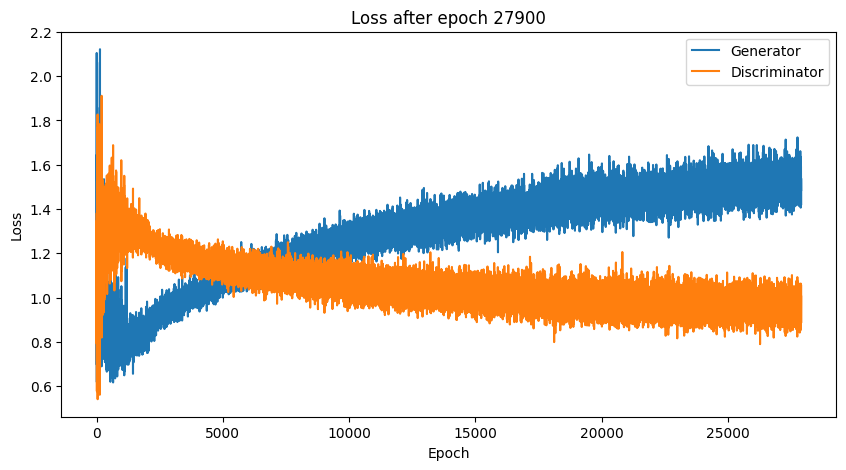

Time for epoch 27900 is 4.115782260894775 sec
Time for epoch 27901 is 0.8749029636383057 sec
Time for epoch 27902 is 0.8563864231109619 sec
Time for epoch 27903 is 0.8641760349273682 sec
Time for epoch 27904 is 0.8633415699005127 sec
Time for epoch 27905 is 0.8692293167114258 sec
Time for epoch 27906 is 0.8680315017700195 sec
Time for epoch 27907 is 0.871666669845581 sec
Time for epoch 27908 is 0.8734302520751953 sec
Time for epoch 27909 is 0.8698351383209229 sec
Time for epoch 27910 is 0.8790731430053711 sec
Time for epoch 27911 is 0.8716247081756592 sec
Time for epoch 27912 is 0.8762543201446533 sec
Time for epoch 27913 is 0.8747963905334473 sec
Time for epoch 27914 is 0.8781630992889404 sec
Time for epoch 27915 is 0.8790175914764404 sec
Time for epoch 27916 is 0.881068229675293 sec
Time for epoch 27917 is 0.8763387203216553 sec
Time for epoch 27918 is 0.8759891986846924 sec
Time for epoch 27919 is 0.881622314453125 sec
Time for epoch 27920 is 0.8816089630126953 sec
Time for epoch 27

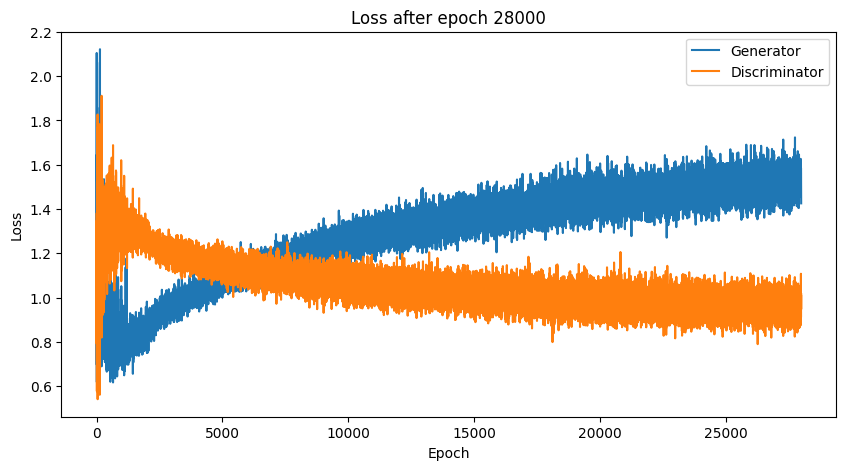

Time for epoch 28000 is 4.097855567932129 sec
Time for epoch 28001 is 0.859013557434082 sec
Time for epoch 28002 is 0.858283281326294 sec
Time for epoch 28003 is 0.8609771728515625 sec
Time for epoch 28004 is 0.8733458518981934 sec
Time for epoch 28005 is 0.8671507835388184 sec
Time for epoch 28006 is 0.8732116222381592 sec
Time for epoch 28007 is 0.8792119026184082 sec
Time for epoch 28008 is 0.8719918727874756 sec
Time for epoch 28009 is 0.8727970123291016 sec
Time for epoch 28010 is 0.8764898777008057 sec
Time for epoch 28011 is 0.8726949691772461 sec
Time for epoch 28012 is 0.8755059242248535 sec
Time for epoch 28013 is 0.8766739368438721 sec
Time for epoch 28014 is 0.8765459060668945 sec
Time for epoch 28015 is 0.8773293495178223 sec
Time for epoch 28016 is 0.8806774616241455 sec
Time for epoch 28017 is 0.879431962966919 sec
Time for epoch 28018 is 0.8789844512939453 sec
Time for epoch 28019 is 0.8824598789215088 sec
Time for epoch 28020 is 0.8804693222045898 sec
Time for epoch 28

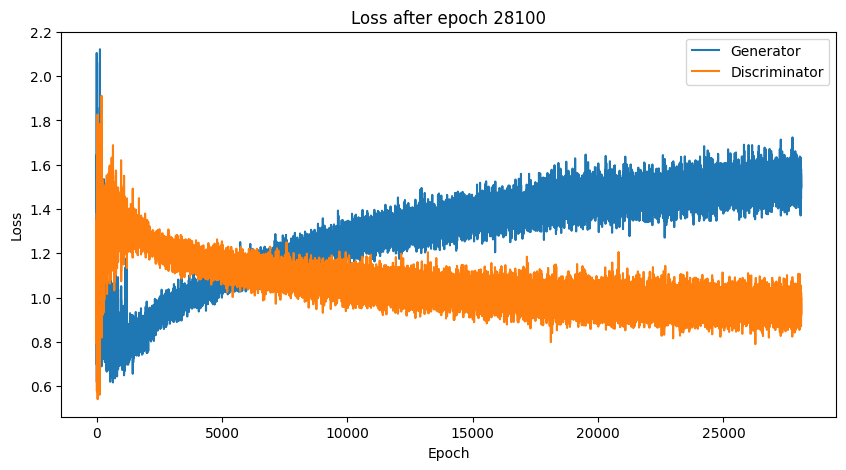

Time for epoch 28100 is 4.061468601226807 sec
Time for epoch 28101 is 0.8631155490875244 sec
Time for epoch 28102 is 0.8652012348175049 sec
Time for epoch 28103 is 0.868537425994873 sec
Time for epoch 28104 is 0.8620843887329102 sec
Time for epoch 28105 is 0.87247633934021 sec
Time for epoch 28106 is 0.8692238330841064 sec
Time for epoch 28107 is 0.8713953495025635 sec
Time for epoch 28108 is 0.8735775947570801 sec
Time for epoch 28109 is 0.8722057342529297 sec
Time for epoch 28110 is 0.8741436004638672 sec
Time for epoch 28111 is 0.8735666275024414 sec
Time for epoch 28112 is 0.8799033164978027 sec
Time for epoch 28113 is 0.8743982315063477 sec
Time for epoch 28114 is 0.8815186023712158 sec
Time for epoch 28115 is 0.8813445568084717 sec
Time for epoch 28116 is 0.8794534206390381 sec
Time for epoch 28117 is 0.8771898746490479 sec
Time for epoch 28118 is 0.8794956207275391 sec
Time for epoch 28119 is 0.8774502277374268 sec
Time for epoch 28120 is 0.8777217864990234 sec
Time for epoch 28

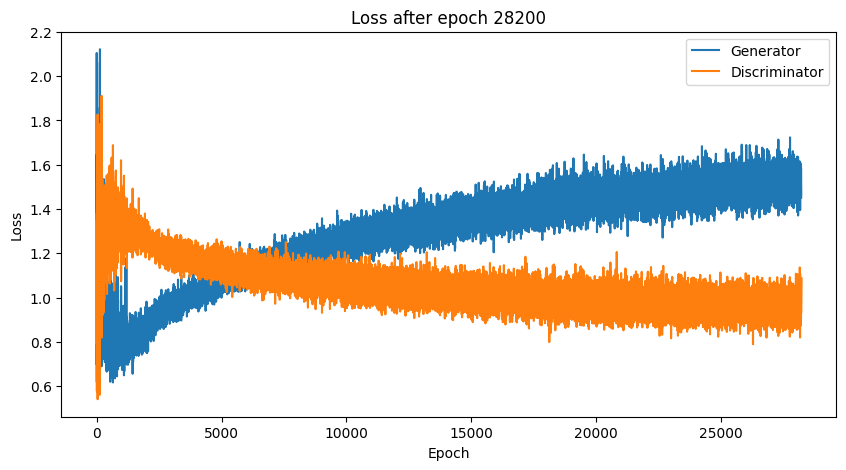

Time for epoch 28200 is 4.070052623748779 sec
Time for epoch 28201 is 0.8522155284881592 sec
Time for epoch 28202 is 0.859896183013916 sec
Time for epoch 28203 is 0.8631327152252197 sec
Time for epoch 28204 is 0.8681836128234863 sec
Time for epoch 28205 is 0.8673429489135742 sec
Time for epoch 28206 is 0.8702676296234131 sec
Time for epoch 28207 is 0.8689072132110596 sec
Time for epoch 28208 is 0.8748795986175537 sec
Time for epoch 28209 is 0.8719284534454346 sec
Time for epoch 28210 is 0.8746693134307861 sec
Time for epoch 28211 is 0.8771803379058838 sec
Time for epoch 28212 is 0.8758487701416016 sec
Time for epoch 28213 is 0.8738255500793457 sec
Time for epoch 28214 is 0.8789248466491699 sec
Time for epoch 28215 is 0.8791017532348633 sec
Time for epoch 28216 is 0.8760788440704346 sec
Time for epoch 28217 is 0.8793590068817139 sec
Time for epoch 28218 is 0.878190279006958 sec
Time for epoch 28219 is 0.8788340091705322 sec
Time for epoch 28220 is 0.8838355541229248 sec
Time for epoch 2

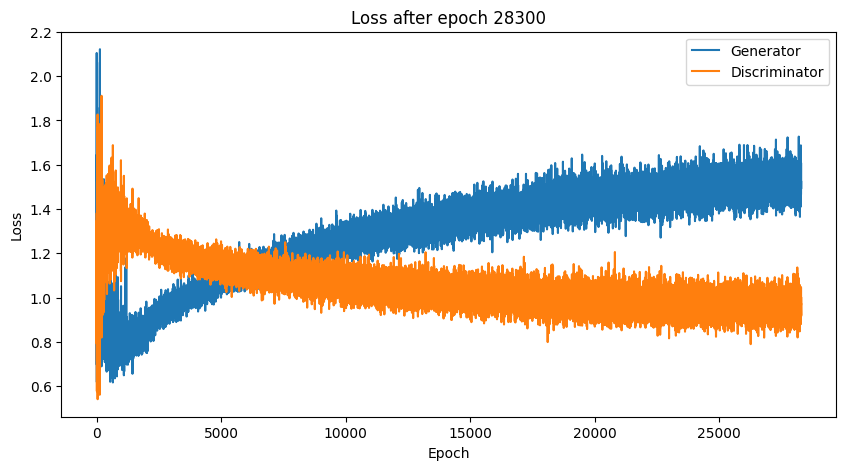

Time for epoch 28300 is 4.090492486953735 sec
Time for epoch 28301 is 0.8557074069976807 sec
Time for epoch 28302 is 0.8636181354522705 sec
Time for epoch 28303 is 0.8639364242553711 sec
Time for epoch 28304 is 0.8649086952209473 sec
Time for epoch 28305 is 0.8735001087188721 sec
Time for epoch 28306 is 0.8717117309570312 sec
Time for epoch 28307 is 0.8703227043151855 sec
Time for epoch 28308 is 0.8696181774139404 sec
Time for epoch 28309 is 0.8746616840362549 sec
Time for epoch 28310 is 0.874863862991333 sec
Time for epoch 28311 is 0.8765110969543457 sec
Time for epoch 28312 is 0.8736121654510498 sec
Time for epoch 28313 is 0.8785028457641602 sec
Time for epoch 28314 is 0.8815708160400391 sec
Time for epoch 28315 is 0.884765625 sec
Time for epoch 28316 is 0.8762969970703125 sec
Time for epoch 28317 is 0.8806352615356445 sec
Time for epoch 28318 is 0.8797082901000977 sec
Time for epoch 28319 is 0.8803942203521729 sec
Time for epoch 28320 is 0.8799314498901367 sec
Time for epoch 28321 i

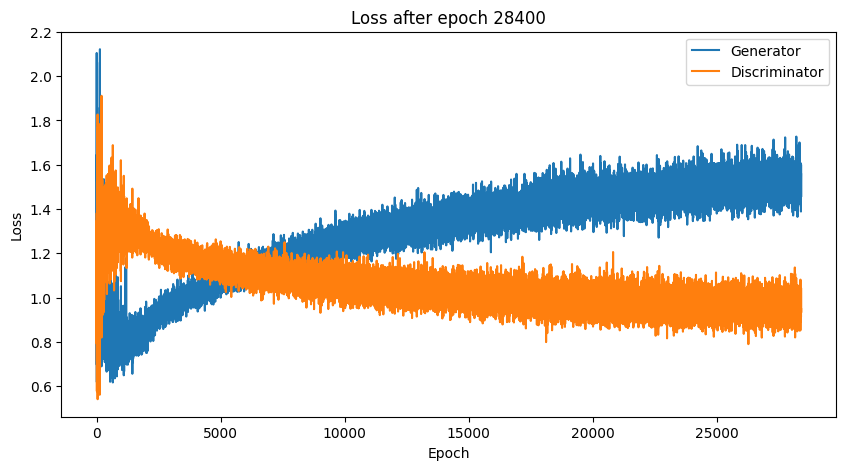

Time for epoch 28400 is 4.102726936340332 sec
Time for epoch 28401 is 0.8606061935424805 sec
Time for epoch 28402 is 0.8649342060089111 sec
Time for epoch 28403 is 0.8648386001586914 sec
Time for epoch 28404 is 0.8640391826629639 sec
Time for epoch 28405 is 0.869347095489502 sec
Time for epoch 28406 is 0.871525764465332 sec
Time for epoch 28407 is 0.8760905265808105 sec
Time for epoch 28408 is 0.8765270709991455 sec
Time for epoch 28409 is 0.8781094551086426 sec
Time for epoch 28410 is 0.8781583309173584 sec
Time for epoch 28411 is 0.879948616027832 sec
Time for epoch 28412 is 0.8790042400360107 sec
Time for epoch 28413 is 0.8799469470977783 sec
Time for epoch 28414 is 0.87557053565979 sec
Time for epoch 28415 is 0.8744702339172363 sec
Time for epoch 28416 is 0.8792977333068848 sec
Time for epoch 28417 is 0.8798527717590332 sec
Time for epoch 28418 is 0.8800888061523438 sec
Time for epoch 28419 is 0.8775122165679932 sec
Time for epoch 28420 is 0.8872449398040771 sec
Time for epoch 2842

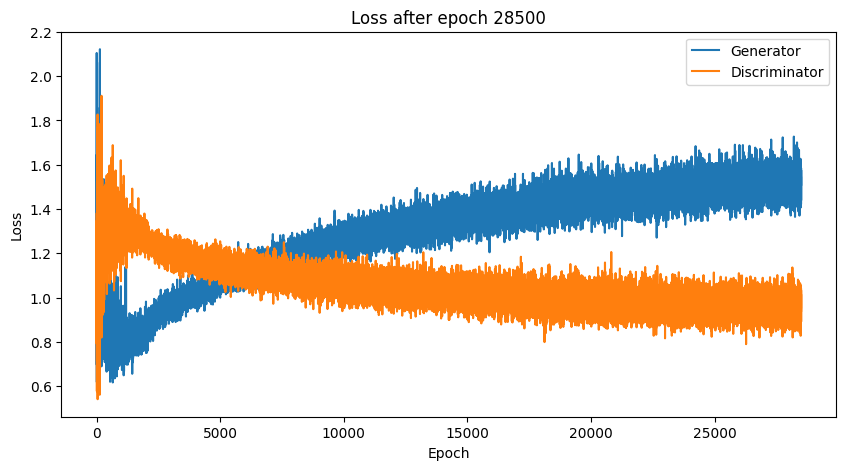

Time for epoch 28500 is 4.12005615234375 sec
Time for epoch 28501 is 0.8644194602966309 sec
Time for epoch 28502 is 0.8625450134277344 sec
Time for epoch 28503 is 0.8641154766082764 sec
Time for epoch 28504 is 0.8675000667572021 sec
Time for epoch 28505 is 0.8676340579986572 sec
Time for epoch 28506 is 0.8691630363464355 sec
Time for epoch 28507 is 0.8725893497467041 sec
Time for epoch 28508 is 0.8722741603851318 sec
Time for epoch 28509 is 0.8730072975158691 sec
Time for epoch 28510 is 0.8735849857330322 sec
Time for epoch 28511 is 0.8823585510253906 sec
Time for epoch 28512 is 0.8717174530029297 sec
Time for epoch 28513 is 0.8740861415863037 sec
Time for epoch 28514 is 0.8756558895111084 sec
Time for epoch 28515 is 0.8828141689300537 sec
Time for epoch 28516 is 0.8811683654785156 sec
Time for epoch 28517 is 0.8754944801330566 sec
Time for epoch 28518 is 0.8802869319915771 sec
Time for epoch 28519 is 0.8763225078582764 sec
Time for epoch 28520 is 0.8796062469482422 sec
Time for epoch 

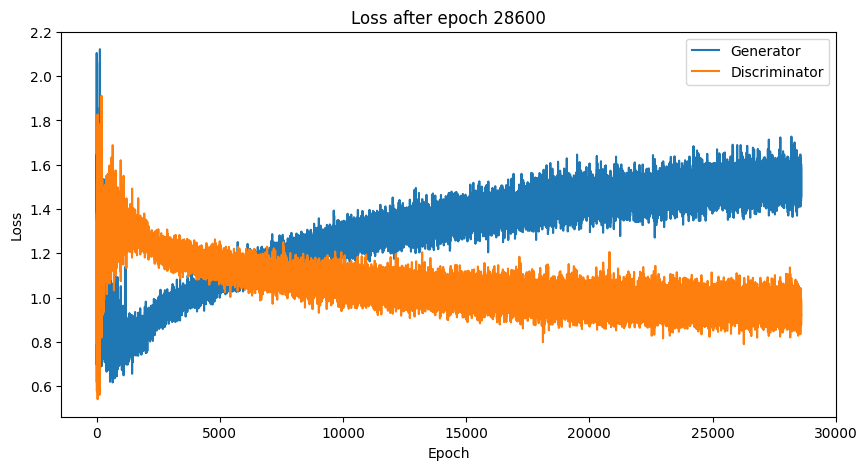

Time for epoch 28600 is 4.133222579956055 sec
Time for epoch 28601 is 0.853320837020874 sec
Time for epoch 28602 is 0.8569676876068115 sec
Time for epoch 28603 is 0.8622148036956787 sec
Time for epoch 28604 is 0.8635678291320801 sec
Time for epoch 28605 is 0.8707427978515625 sec
Time for epoch 28606 is 0.8727753162384033 sec
Time for epoch 28607 is 0.8683533668518066 sec
Time for epoch 28608 is 0.8728408813476562 sec
Time for epoch 28609 is 0.8679888248443604 sec
Time for epoch 28610 is 0.8748655319213867 sec
Time for epoch 28611 is 0.8728606700897217 sec
Time for epoch 28612 is 0.8744215965270996 sec
Time for epoch 28613 is 0.8731870651245117 sec
Time for epoch 28614 is 0.8761889934539795 sec
Time for epoch 28615 is 0.8814172744750977 sec
Time for epoch 28616 is 0.8748219013214111 sec
Time for epoch 28617 is 0.8800303936004639 sec
Time for epoch 28618 is 0.8813817501068115 sec
Time for epoch 28619 is 0.8795721530914307 sec
Time for epoch 28620 is 0.8851752281188965 sec
Time for epoch 

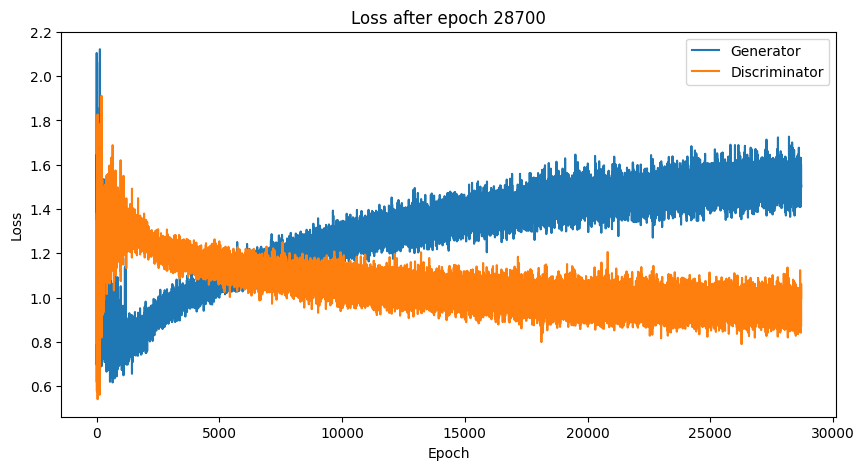

Time for epoch 28700 is 4.403144359588623 sec
Time for epoch 28701 is 0.8448894023895264 sec
Time for epoch 28702 is 0.8588366508483887 sec
Time for epoch 28703 is 0.8636946678161621 sec
Time for epoch 28704 is 0.8669013977050781 sec
Time for epoch 28705 is 0.8654353618621826 sec
Time for epoch 28706 is 0.8728816509246826 sec
Time for epoch 28707 is 0.8657591342926025 sec
Time for epoch 28708 is 0.8711686134338379 sec
Time for epoch 28709 is 0.8733887672424316 sec
Time for epoch 28710 is 0.8745346069335938 sec
Time for epoch 28711 is 0.873112678527832 sec
Time for epoch 28712 is 0.8788373470306396 sec
Time for epoch 28713 is 0.87619948387146 sec
Time for epoch 28714 is 0.873521089553833 sec
Time for epoch 28715 is 0.8781893253326416 sec
Time for epoch 28716 is 0.8793342113494873 sec
Time for epoch 28717 is 0.8771035671234131 sec
Time for epoch 28718 is 0.8769619464874268 sec
Time for epoch 28719 is 0.8822557926177979 sec
Time for epoch 28720 is 0.8779582977294922 sec
Time for epoch 287

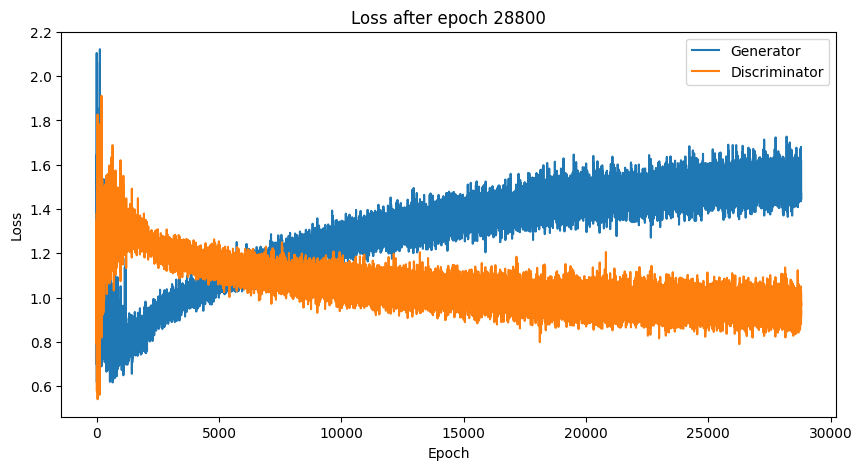

Time for epoch 28800 is 4.086619138717651 sec
Time for epoch 28801 is 0.8425631523132324 sec
Time for epoch 28802 is 0.8635776042938232 sec
Time for epoch 28803 is 0.8629722595214844 sec
Time for epoch 28804 is 0.8661494255065918 sec
Time for epoch 28805 is 0.8723373413085938 sec
Time for epoch 28806 is 0.8690109252929688 sec
Time for epoch 28807 is 0.8788354396820068 sec
Time for epoch 28808 is 0.8694517612457275 sec
Time for epoch 28809 is 0.8725197315216064 sec
Time for epoch 28810 is 0.8713076114654541 sec
Time for epoch 28811 is 0.8801040649414062 sec
Time for epoch 28812 is 0.8749914169311523 sec
Time for epoch 28813 is 0.8778629302978516 sec
Time for epoch 28814 is 0.8796522617340088 sec
Time for epoch 28815 is 0.8781983852386475 sec
Time for epoch 28816 is 0.8743088245391846 sec
Time for epoch 28817 is 0.8820047378540039 sec
Time for epoch 28818 is 0.8775899410247803 sec
Time for epoch 28819 is 0.884192943572998 sec
Time for epoch 28820 is 0.8808984756469727 sec
Time for epoch 

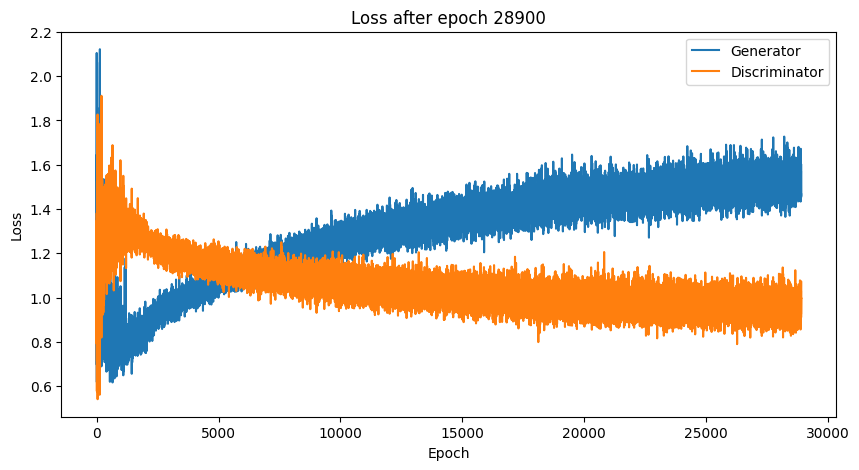

Time for epoch 28900 is 4.096924066543579 sec
Time for epoch 28901 is 0.8603413105010986 sec
Time for epoch 28902 is 0.8572242259979248 sec
Time for epoch 28903 is 0.8679802417755127 sec
Time for epoch 28904 is 0.867957592010498 sec
Time for epoch 28905 is 0.8639380931854248 sec
Time for epoch 28906 is 0.8707966804504395 sec
Time for epoch 28907 is 0.873260498046875 sec
Time for epoch 28908 is 0.8708951473236084 sec
Time for epoch 28909 is 0.8705825805664062 sec
Time for epoch 28910 is 0.8745055198669434 sec
Time for epoch 28911 is 0.8740317821502686 sec
Time for epoch 28912 is 0.8769028186798096 sec
Time for epoch 28913 is 0.8784523010253906 sec
Time for epoch 28914 is 0.8786242008209229 sec
Time for epoch 28915 is 0.8764288425445557 sec
Time for epoch 28916 is 0.879309892654419 sec
Time for epoch 28917 is 0.8784854412078857 sec
Time for epoch 28918 is 0.8773982524871826 sec
Time for epoch 28919 is 0.8793599605560303 sec
Time for epoch 28920 is 0.879767656326294 sec
Time for epoch 289

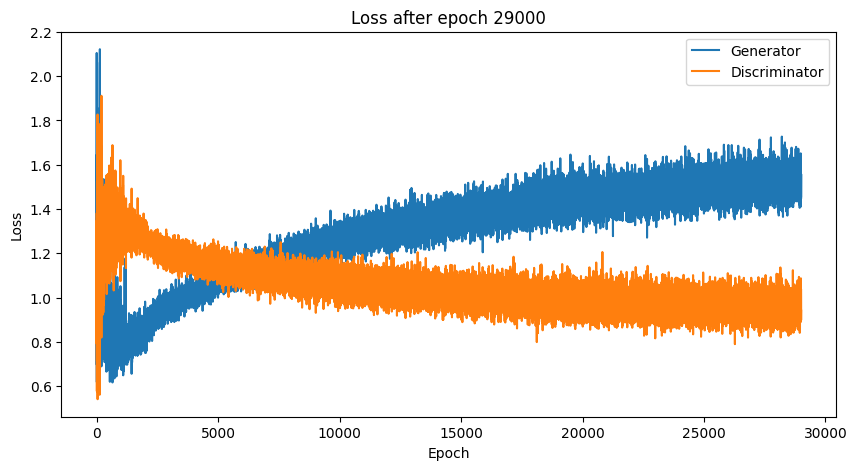

Time for epoch 29000 is 4.1188085079193115 sec
Time for epoch 29001 is 0.8699572086334229 sec
Time for epoch 29002 is 0.8590214252471924 sec
Time for epoch 29003 is 0.8623640537261963 sec
Time for epoch 29004 is 0.8673684597015381 sec
Time for epoch 29005 is 0.8692295551300049 sec
Time for epoch 29006 is 0.8628618717193604 sec
Time for epoch 29007 is 0.8689301013946533 sec
Time for epoch 29008 is 0.873934268951416 sec
Time for epoch 29009 is 0.8708012104034424 sec
Time for epoch 29010 is 0.8708062171936035 sec
Time for epoch 29011 is 0.8787169456481934 sec
Time for epoch 29012 is 0.8732876777648926 sec
Time for epoch 29013 is 0.8760433197021484 sec
Time for epoch 29014 is 0.8786919116973877 sec
Time for epoch 29015 is 0.8791613578796387 sec
Time for epoch 29016 is 0.8789782524108887 sec
Time for epoch 29017 is 0.8776483535766602 sec
Time for epoch 29018 is 0.8786592483520508 sec
Time for epoch 29019 is 0.8802387714385986 sec
Time for epoch 29020 is 0.8824987411499023 sec
Time for epoch

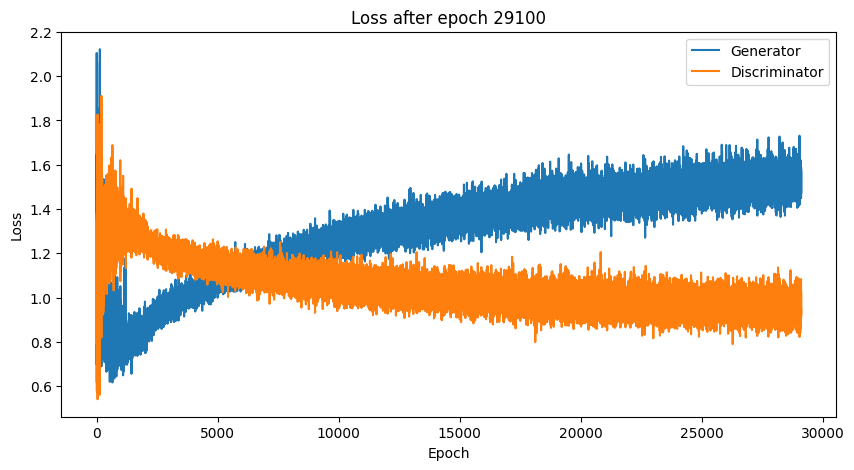

Time for epoch 29100 is 4.120170831680298 sec
Time for epoch 29101 is 0.8556437492370605 sec
Time for epoch 29102 is 0.8585116863250732 sec
Time for epoch 29103 is 0.865339994430542 sec
Time for epoch 29104 is 0.8705368041992188 sec
Time for epoch 29105 is 0.8655319213867188 sec
Time for epoch 29106 is 0.8748888969421387 sec
Time for epoch 29107 is 0.867884635925293 sec
Time for epoch 29108 is 0.8742241859436035 sec
Time for epoch 29109 is 0.8768737316131592 sec
Time for epoch 29110 is 0.8795726299285889 sec
Time for epoch 29111 is 0.8755309581756592 sec
Time for epoch 29112 is 0.8740146160125732 sec
Time for epoch 29113 is 0.8781218528747559 sec
Time for epoch 29114 is 0.8784744739532471 sec
Time for epoch 29115 is 0.8721489906311035 sec
Time for epoch 29116 is 0.8777177333831787 sec
Time for epoch 29117 is 0.884394645690918 sec
Time for epoch 29118 is 0.8837540149688721 sec
Time for epoch 29119 is 0.8767287731170654 sec
Time for epoch 29120 is 0.8832447528839111 sec
Time for epoch 29

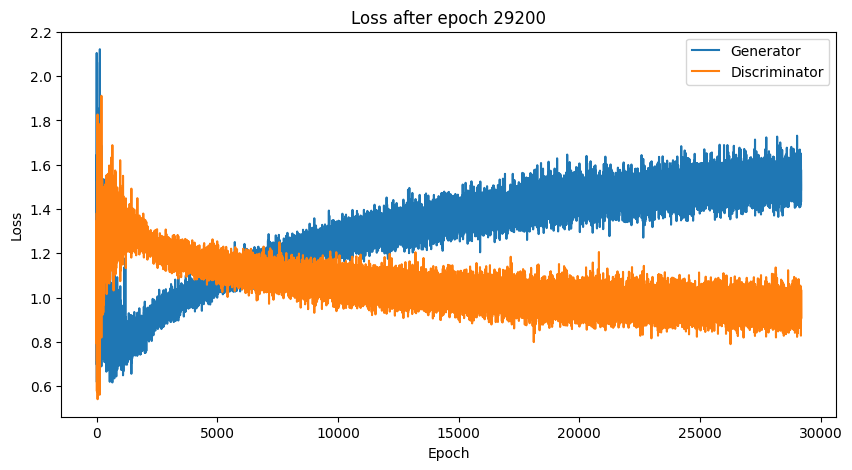

Time for epoch 29200 is 4.143911123275757 sec
Time for epoch 29201 is 0.8666245937347412 sec
Time for epoch 29202 is 0.8575773239135742 sec
Time for epoch 29203 is 0.8661971092224121 sec
Time for epoch 29204 is 0.8685369491577148 sec
Time for epoch 29205 is 0.8643898963928223 sec
Time for epoch 29206 is 0.8744232654571533 sec
Time for epoch 29207 is 0.8733274936676025 sec
Time for epoch 29208 is 0.8745379447937012 sec
Time for epoch 29209 is 0.8759877681732178 sec
Time for epoch 29210 is 0.8743658065795898 sec
Time for epoch 29211 is 0.8726050853729248 sec
Time for epoch 29212 is 0.8720543384552002 sec
Time for epoch 29213 is 0.8750205039978027 sec
Time for epoch 29214 is 0.877896785736084 sec
Time for epoch 29215 is 0.8785531520843506 sec
Time for epoch 29216 is 0.8780918121337891 sec
Time for epoch 29217 is 0.8802244663238525 sec
Time for epoch 29218 is 0.8769714832305908 sec
Time for epoch 29219 is 0.882328987121582 sec
Time for epoch 29220 is 0.8801465034484863 sec
Time for epoch 2

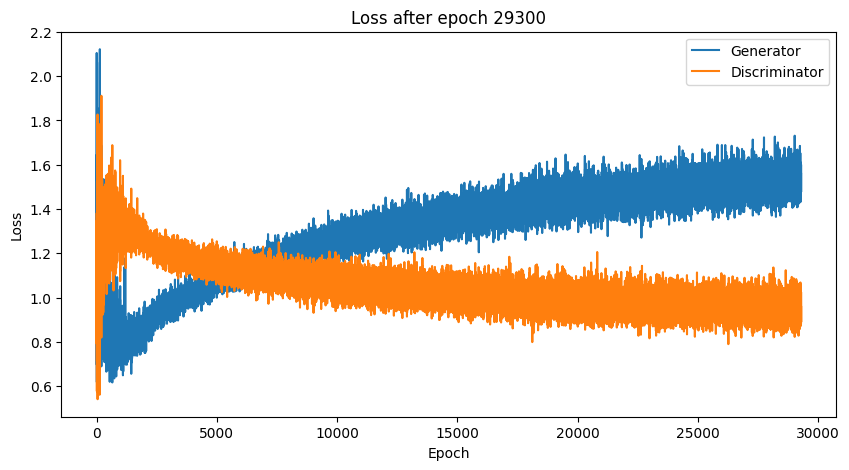

Time for epoch 29300 is 4.345556020736694 sec
Time for epoch 29301 is 0.8500494956970215 sec
Time for epoch 29302 is 0.8639323711395264 sec
Time for epoch 29303 is 0.8646926879882812 sec
Time for epoch 29304 is 0.8614187240600586 sec
Time for epoch 29305 is 0.8699431419372559 sec
Time for epoch 29306 is 0.8698930740356445 sec
Time for epoch 29307 is 0.8700532913208008 sec
Time for epoch 29308 is 0.8713808059692383 sec
Time for epoch 29309 is 0.8725619316101074 sec
Time for epoch 29310 is 0.8717825412750244 sec
Time for epoch 29311 is 0.870194673538208 sec
Time for epoch 29312 is 0.8815743923187256 sec
Time for epoch 29313 is 0.8783063888549805 sec
Time for epoch 29314 is 0.8741555213928223 sec
Time for epoch 29315 is 0.8776497840881348 sec
Time for epoch 29316 is 0.8743462562561035 sec
Time for epoch 29317 is 0.8807485103607178 sec
Time for epoch 29318 is 0.8784892559051514 sec
Time for epoch 29319 is 0.8792033195495605 sec
Time for epoch 29320 is 0.8906385898590088 sec
Time for epoch 

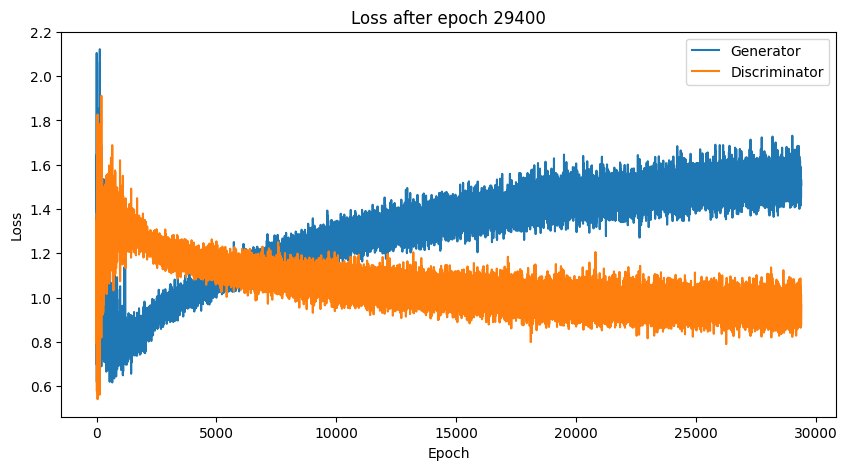

Time for epoch 29400 is 4.156907796859741 sec
Time for epoch 29401 is 0.858748197555542 sec
Time for epoch 29402 is 0.8598172664642334 sec
Time for epoch 29403 is 0.864985466003418 sec
Time for epoch 29404 is 0.8667147159576416 sec
Time for epoch 29405 is 0.8675835132598877 sec
Time for epoch 29406 is 0.8699705600738525 sec
Time for epoch 29407 is 0.8789060115814209 sec
Time for epoch 29408 is 0.8689835071563721 sec
Time for epoch 29409 is 0.8724875450134277 sec
Time for epoch 29410 is 0.8732657432556152 sec
Time for epoch 29411 is 0.8797609806060791 sec
Time for epoch 29412 is 0.8742566108703613 sec
Time for epoch 29413 is 0.875417947769165 sec
Time for epoch 29414 is 0.8787567615509033 sec
Time for epoch 29415 is 0.8783979415893555 sec
Time for epoch 29416 is 0.8828709125518799 sec
Time for epoch 29417 is 0.8770546913146973 sec
Time for epoch 29418 is 0.8783414363861084 sec
Time for epoch 29419 is 0.8776035308837891 sec
Time for epoch 29420 is 0.8836915493011475 sec
Time for epoch 29

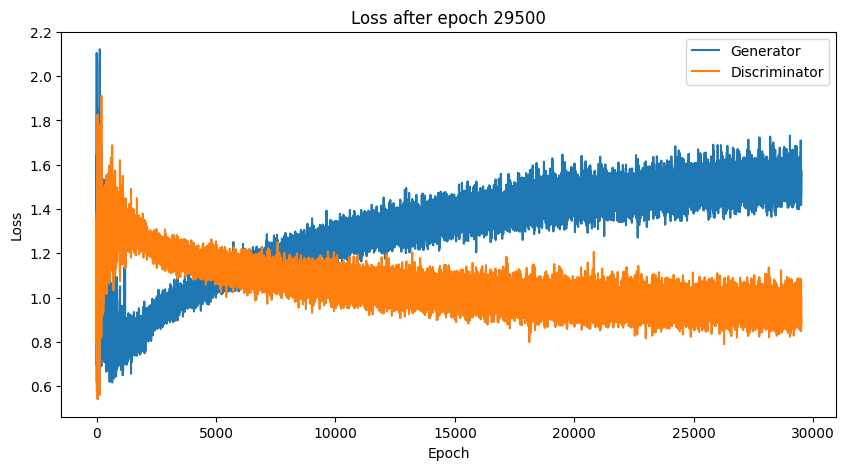

Time for epoch 29500 is 4.181535720825195 sec
Time for epoch 29501 is 0.848360538482666 sec
Time for epoch 29502 is 0.857712984085083 sec
Time for epoch 29503 is 0.8648908138275146 sec
Time for epoch 29504 is 0.8660025596618652 sec
Time for epoch 29505 is 0.8666121959686279 sec
Time for epoch 29506 is 0.8698108196258545 sec
Time for epoch 29507 is 0.872434139251709 sec
Time for epoch 29508 is 0.8727970123291016 sec
Time for epoch 29509 is 0.8720817565917969 sec
Time for epoch 29510 is 0.875899076461792 sec
Time for epoch 29511 is 0.8748490810394287 sec
Time for epoch 29512 is 0.878258466720581 sec
Time for epoch 29513 is 0.8740518093109131 sec
Time for epoch 29514 is 0.8791396617889404 sec
Time for epoch 29515 is 0.8774371147155762 sec
Time for epoch 29516 is 0.88010573387146 sec
Time for epoch 29517 is 0.8777258396148682 sec
Time for epoch 29518 is 0.8836052417755127 sec
Time for epoch 29519 is 0.8801157474517822 sec
Time for epoch 29520 is 0.8814694881439209 sec
Time for epoch 29521 

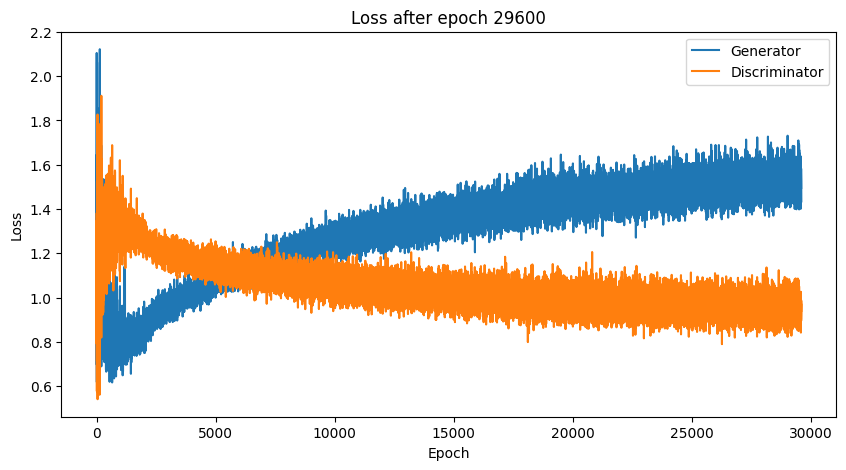

Time for epoch 29600 is 4.12816047668457 sec
Time for epoch 29601 is 0.851398229598999 sec
Time for epoch 29602 is 0.8595676422119141 sec
Time for epoch 29603 is 0.8647630214691162 sec
Time for epoch 29604 is 0.8682053089141846 sec
Time for epoch 29605 is 0.869368314743042 sec
Time for epoch 29606 is 0.8718869686126709 sec
Time for epoch 29607 is 0.8697631359100342 sec
Time for epoch 29608 is 0.8711042404174805 sec
Time for epoch 29609 is 0.8748371601104736 sec
Time for epoch 29610 is 0.8745272159576416 sec
Time for epoch 29611 is 0.8739335536956787 sec
Time for epoch 29612 is 0.8783071041107178 sec
Time for epoch 29613 is 0.874950647354126 sec
Time for epoch 29614 is 0.8793942928314209 sec
Time for epoch 29615 is 0.8792774677276611 sec
Time for epoch 29616 is 0.8800773620605469 sec
Time for epoch 29617 is 0.8752849102020264 sec
Time for epoch 29618 is 0.8811352252960205 sec
Time for epoch 29619 is 0.8815972805023193 sec
Time for epoch 29620 is 0.8807876110076904 sec
Time for epoch 296

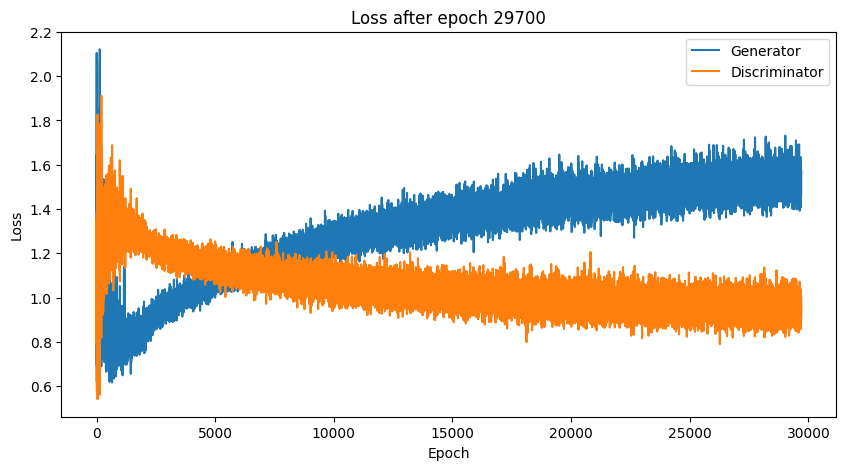

Time for epoch 29700 is 4.198437929153442 sec
Time for epoch 29701 is 0.8486015796661377 sec
Time for epoch 29702 is 0.8623795509338379 sec
Time for epoch 29703 is 0.8702108860015869 sec
Time for epoch 29704 is 0.8638739585876465 sec
Time for epoch 29705 is 0.8672068119049072 sec
Time for epoch 29706 is 0.8718307018280029 sec
Time for epoch 29707 is 0.8722541332244873 sec
Time for epoch 29708 is 0.8784782886505127 sec
Time for epoch 29709 is 0.8729832172393799 sec
Time for epoch 29710 is 0.8799340724945068 sec
Time for epoch 29711 is 0.870511531829834 sec
Time for epoch 29712 is 0.8755767345428467 sec
Time for epoch 29713 is 0.8848598003387451 sec
Time for epoch 29714 is 0.8806619644165039 sec
Time for epoch 29715 is 0.8819403648376465 sec
Time for epoch 29716 is 0.8802392482757568 sec
Time for epoch 29717 is 0.8777980804443359 sec
Time for epoch 29718 is 0.8878166675567627 sec
Time for epoch 29719 is 0.8766491413116455 sec
Time for epoch 29720 is 0.8799331188201904 sec
Time for epoch 

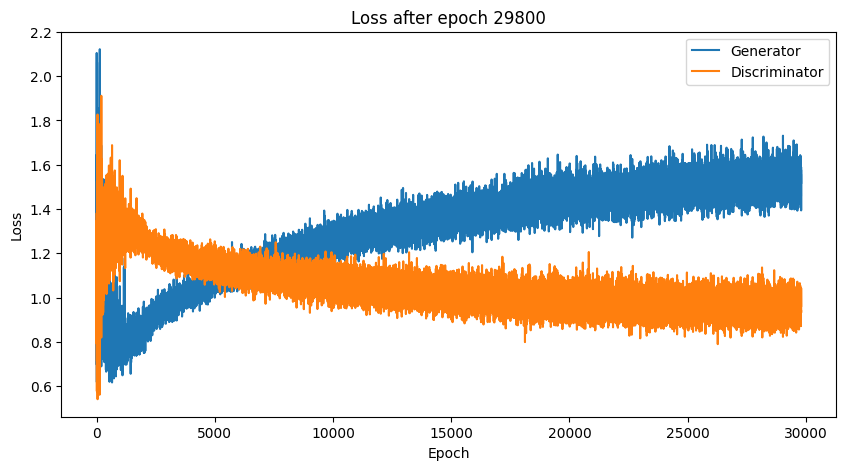

Time for epoch 29800 is 4.154228687286377 sec
Time for epoch 29801 is 0.8527543544769287 sec
Time for epoch 29802 is 0.8691926002502441 sec
Time for epoch 29803 is 0.8631126880645752 sec
Time for epoch 29804 is 0.8645241260528564 sec
Time for epoch 29805 is 0.8648474216461182 sec
Time for epoch 29806 is 0.8721697330474854 sec
Time for epoch 29807 is 0.8712499141693115 sec
Time for epoch 29808 is 0.8736531734466553 sec
Time for epoch 29809 is 0.8693699836730957 sec
Time for epoch 29810 is 0.8756413459777832 sec
Time for epoch 29811 is 0.8750665187835693 sec
Time for epoch 29812 is 0.8758528232574463 sec
Time for epoch 29813 is 0.8776340484619141 sec
Time for epoch 29814 is 0.8759737014770508 sec
Time for epoch 29815 is 0.8779463768005371 sec
Time for epoch 29816 is 0.8789560794830322 sec
Time for epoch 29817 is 0.8800716400146484 sec
Time for epoch 29818 is 0.8785641193389893 sec
Time for epoch 29819 is 0.8763840198516846 sec
Time for epoch 29820 is 0.8882827758789062 sec
Time for epoch

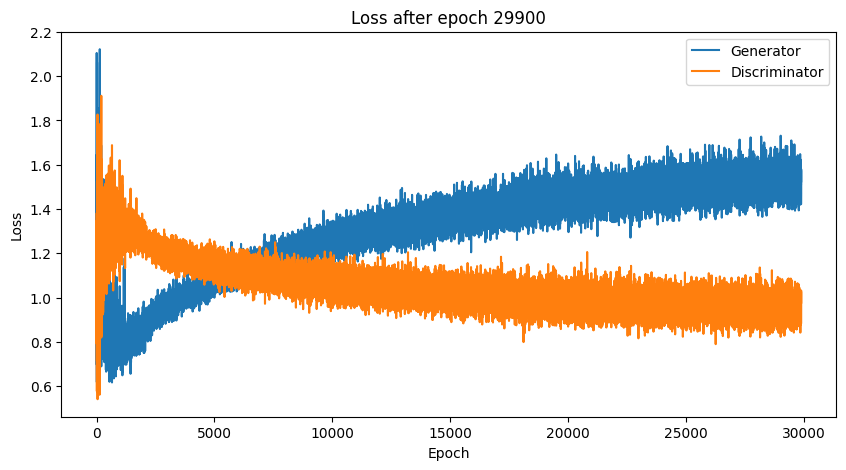

Time for epoch 29900 is 4.232434988021851 sec
Time for epoch 29901 is 0.8513522148132324 sec
Time for epoch 29902 is 0.8600001335144043 sec
Time for epoch 29903 is 0.8617115020751953 sec
Time for epoch 29904 is 0.8668005466461182 sec
Time for epoch 29905 is 0.8701462745666504 sec
Time for epoch 29906 is 0.8739895820617676 sec
Time for epoch 29907 is 0.8715925216674805 sec
Time for epoch 29908 is 1.0532047748565674 sec
Time for epoch 29909 is 0.8729248046875 sec
Time for epoch 29910 is 0.8791952133178711 sec
Time for epoch 29911 is 0.8743219375610352 sec
Time for epoch 29912 is 0.8774657249450684 sec
Time for epoch 29913 is 0.879457950592041 sec
Time for epoch 29914 is 0.8753030300140381 sec
Time for epoch 29915 is 0.8781659603118896 sec
Time for epoch 29916 is 0.8840391635894775 sec
Time for epoch 29917 is 0.8814444541931152 sec
Time for epoch 29918 is 0.8818027973175049 sec
Time for epoch 29919 is 0.8776085376739502 sec
Time for epoch 29920 is 0.8791751861572266 sec
Time for epoch 299

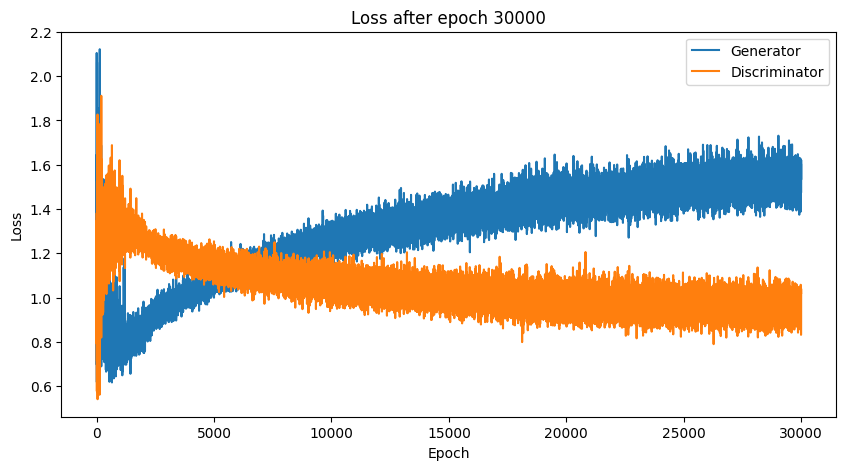

Time for epoch 30000 is 4.176063776016235 sec
Time for epoch 30001 is 0.8473875522613525 sec
Time for epoch 30002 is 0.8599226474761963 sec
Time for epoch 30003 is 0.8666572570800781 sec
Time for epoch 30004 is 0.8704915046691895 sec
Time for epoch 30005 is 0.8674569129943848 sec
Time for epoch 30006 is 0.8718650341033936 sec
Time for epoch 30007 is 0.8809449672698975 sec
Time for epoch 30008 is 0.8684227466583252 sec
Time for epoch 30009 is 0.8772366046905518 sec
Time for epoch 30010 is 0.8763730525970459 sec
Time for epoch 30011 is 0.8760232925415039 sec
Time for epoch 30012 is 0.8737454414367676 sec
Time for epoch 30013 is 0.8806204795837402 sec
Time for epoch 30014 is 0.8749454021453857 sec
Time for epoch 30015 is 0.8784542083740234 sec
Time for epoch 30016 is 0.8807227611541748 sec
Time for epoch 30017 is 0.8838365077972412 sec
Time for epoch 30018 is 0.8766348361968994 sec
Time for epoch 30019 is 0.8830254077911377 sec
Time for epoch 30020 is 0.882512092590332 sec
Time for epoch 

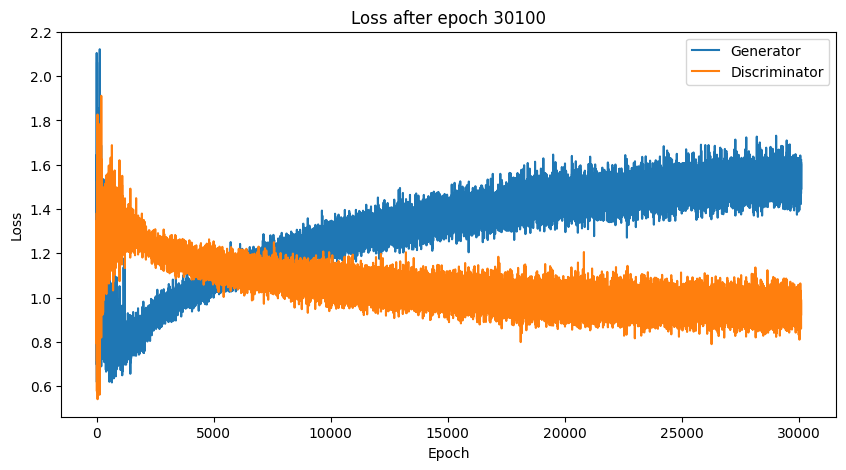

Time for epoch 30100 is 4.145987510681152 sec
Time for epoch 30101 is 0.8674142360687256 sec
Time for epoch 30102 is 0.8598530292510986 sec
Time for epoch 30103 is 0.8657968044281006 sec
Time for epoch 30104 is 0.8662471771240234 sec
Time for epoch 30105 is 0.867213249206543 sec
Time for epoch 30106 is 0.8688735961914062 sec
Time for epoch 30107 is 0.875382661819458 sec
Time for epoch 30108 is 0.873340368270874 sec
Time for epoch 30109 is 0.8752670288085938 sec
Time for epoch 30110 is 0.8691861629486084 sec
Time for epoch 30111 is 0.8753037452697754 sec
Time for epoch 30112 is 0.8776035308837891 sec
Time for epoch 30113 is 0.8775815963745117 sec
Time for epoch 30114 is 0.8767096996307373 sec
Time for epoch 30115 is 0.8779177665710449 sec
Time for epoch 30116 is 0.8781604766845703 sec
Time for epoch 30117 is 0.8774623870849609 sec
Time for epoch 30118 is 0.8841543197631836 sec
Time for epoch 30119 is 0.8805975914001465 sec
Time for epoch 30120 is 0.879986047744751 sec
Time for epoch 301

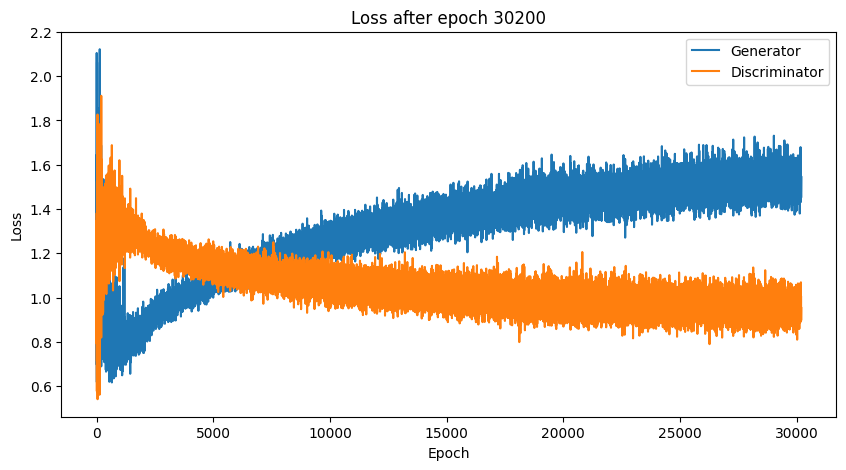

Time for epoch 30200 is 4.155383348464966 sec
Time for epoch 30201 is 0.8675124645233154 sec
Time for epoch 30202 is 0.8598544597625732 sec
Time for epoch 30203 is 0.8646163940429688 sec
Time for epoch 30204 is 0.8671221733093262 sec
Time for epoch 30205 is 0.8680667877197266 sec
Time for epoch 30206 is 0.8692026138305664 sec
Time for epoch 30207 is 0.8691539764404297 sec
Time for epoch 30208 is 0.8734109401702881 sec
Time for epoch 30209 is 0.8707067966461182 sec
Time for epoch 30210 is 0.8809270858764648 sec
Time for epoch 30211 is 0.8774492740631104 sec
Time for epoch 30212 is 0.8708930015563965 sec
Time for epoch 30213 is 0.8774459362030029 sec
Time for epoch 30214 is 0.8791935443878174 sec
Time for epoch 30215 is 0.8764941692352295 sec
Time for epoch 30216 is 0.8768444061279297 sec
Time for epoch 30217 is 0.8815984725952148 sec
Time for epoch 30218 is 0.8743908405303955 sec
Time for epoch 30219 is 0.8844668865203857 sec
Time for epoch 30220 is 0.8758111000061035 sec
Time for epoch

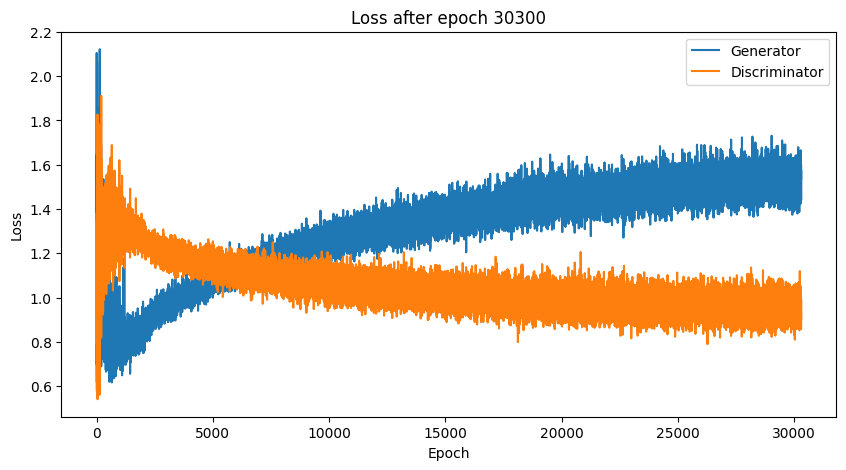

Time for epoch 30300 is 4.144127607345581 sec
Time for epoch 30301 is 0.853600263595581 sec
Time for epoch 30302 is 0.8577511310577393 sec
Time for epoch 30303 is 0.8669042587280273 sec
Time for epoch 30304 is 0.8620283603668213 sec
Time for epoch 30305 is 0.8642802238464355 sec
Time for epoch 30306 is 0.8715417385101318 sec
Time for epoch 30307 is 0.8743927478790283 sec
Time for epoch 30308 is 0.8705954551696777 sec
Time for epoch 30309 is 0.8696634769439697 sec
Time for epoch 30310 is 0.8741841316223145 sec
Time for epoch 30311 is 0.877730131149292 sec
Time for epoch 30312 is 0.8707845211029053 sec
Time for epoch 30313 is 0.8740410804748535 sec
Time for epoch 30314 is 0.8832798004150391 sec
Time for epoch 30315 is 0.8744075298309326 sec
Time for epoch 30316 is 0.8786351680755615 sec
Time for epoch 30317 is 0.878490686416626 sec
Time for epoch 30318 is 0.884479284286499 sec
Time for epoch 30319 is 0.882495641708374 sec
Time for epoch 30320 is 0.8777873516082764 sec
Time for epoch 3032

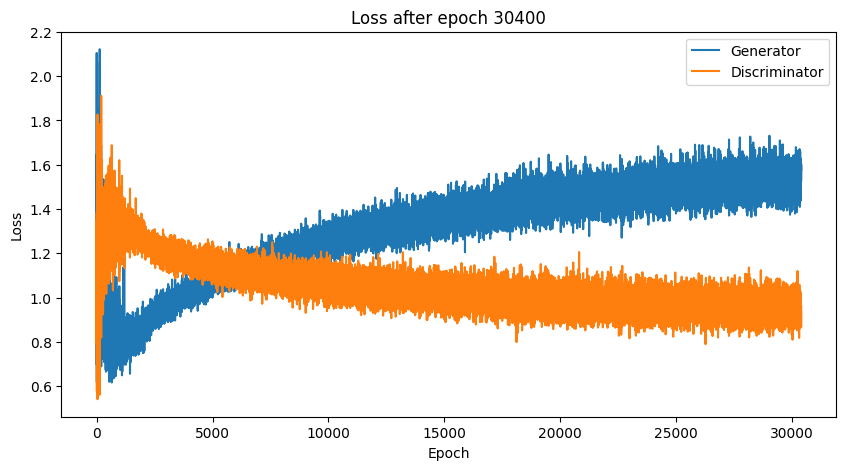

Time for epoch 30400 is 4.126379013061523 sec
Time for epoch 30401 is 0.866931676864624 sec
Time for epoch 30402 is 0.8564748764038086 sec
Time for epoch 30403 is 0.8664765357971191 sec
Time for epoch 30404 is 0.8643231391906738 sec
Time for epoch 30405 is 0.8633651733398438 sec
Time for epoch 30406 is 0.8723115921020508 sec
Time for epoch 30407 is 0.8709428310394287 sec
Time for epoch 30408 is 0.8770217895507812 sec
Time for epoch 30409 is 0.870213508605957 sec
Time for epoch 30410 is 0.8764879703521729 sec
Time for epoch 30411 is 0.876793384552002 sec
Time for epoch 30412 is 0.8712232112884521 sec
Time for epoch 30413 is 0.8783125877380371 sec
Time for epoch 30414 is 0.8779075145721436 sec
Time for epoch 30415 is 0.8787529468536377 sec
Time for epoch 30416 is 0.8785197734832764 sec
Time for epoch 30417 is 0.8817863464355469 sec
Time for epoch 30418 is 0.8806095123291016 sec
Time for epoch 30419 is 0.8816075325012207 sec
Time for epoch 30420 is 0.8809666633605957 sec
Time for epoch 30

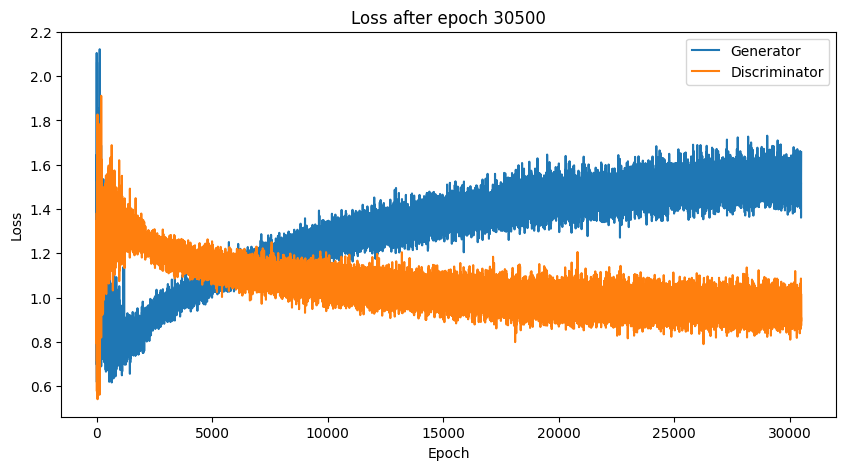

Time for epoch 30500 is 4.32239294052124 sec
Time for epoch 30501 is 0.8543989658355713 sec
Time for epoch 30502 is 0.8661220073699951 sec
Time for epoch 30503 is 0.8675425052642822 sec
Time for epoch 30504 is 0.8656251430511475 sec
Time for epoch 30505 is 0.8681008815765381 sec
Time for epoch 30506 is 0.8734078407287598 sec
Time for epoch 30507 is 0.8712196350097656 sec
Time for epoch 30508 is 0.8748435974121094 sec
Time for epoch 30509 is 0.8692905902862549 sec
Time for epoch 30510 is 0.8728179931640625 sec
Time for epoch 30511 is 0.8765716552734375 sec
Time for epoch 30512 is 0.8767683506011963 sec
Time for epoch 30513 is 0.879342794418335 sec
Time for epoch 30514 is 0.8772571086883545 sec
Time for epoch 30515 is 0.8780579566955566 sec
Time for epoch 30516 is 0.8760740756988525 sec
Time for epoch 30517 is 0.8762645721435547 sec
Time for epoch 30518 is 0.8748698234558105 sec
Time for epoch 30519 is 0.880119800567627 sec
Time for epoch 30520 is 0.8835530281066895 sec
Time for epoch 30

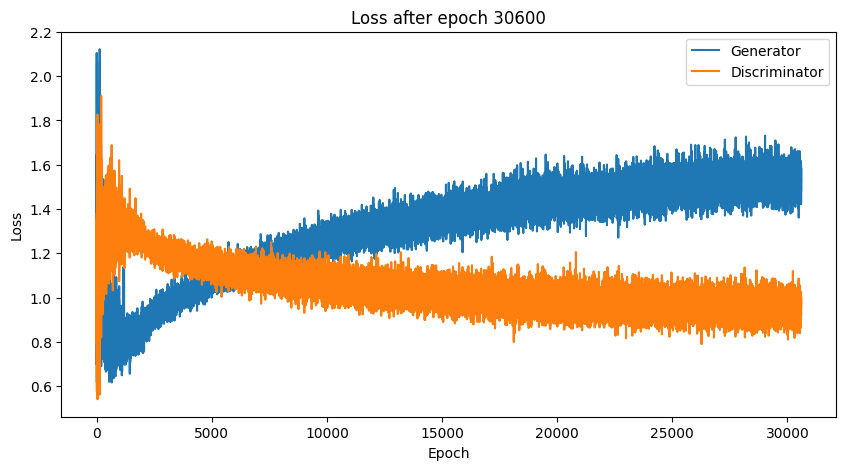

Time for epoch 30600 is 4.161496877670288 sec
Time for epoch 30601 is 0.8607292175292969 sec
Time for epoch 30602 is 0.8560528755187988 sec
Time for epoch 30603 is 0.8689587116241455 sec
Time for epoch 30604 is 0.8662538528442383 sec
Time for epoch 30605 is 0.87642502784729 sec
Time for epoch 30606 is 0.8670032024383545 sec
Time for epoch 30607 is 0.8729691505432129 sec
Time for epoch 30608 is 0.8806486129760742 sec
Time for epoch 30609 is 0.8720607757568359 sec
Time for epoch 30610 is 0.8745765686035156 sec
Time for epoch 30611 is 0.8754251003265381 sec
Time for epoch 30612 is 0.8763880729675293 sec
Time for epoch 30613 is 0.8775410652160645 sec
Time for epoch 30614 is 0.8726770877838135 sec
Time for epoch 30615 is 0.8800537586212158 sec
Time for epoch 30616 is 0.8731691837310791 sec
Time for epoch 30617 is 0.8799471855163574 sec
Time for epoch 30618 is 0.882643461227417 sec
Time for epoch 30619 is 0.8790979385375977 sec
Time for epoch 30620 is 0.8808717727661133 sec
Time for epoch 30

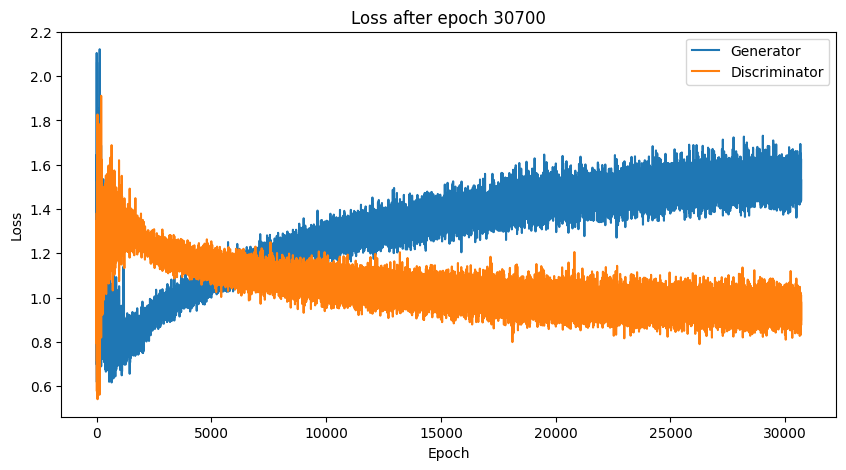

Time for epoch 30700 is 4.136949300765991 sec
Time for epoch 30701 is 0.8596999645233154 sec
Time for epoch 30702 is 0.858781099319458 sec
Time for epoch 30703 is 0.8644506931304932 sec
Time for epoch 30704 is 0.8639819622039795 sec
Time for epoch 30705 is 0.8735318183898926 sec
Time for epoch 30706 is 0.8689799308776855 sec
Time for epoch 30707 is 0.8729677200317383 sec
Time for epoch 30708 is 0.8755567073822021 sec
Time for epoch 30709 is 0.8721368312835693 sec
Time for epoch 30710 is 0.8781101703643799 sec
Time for epoch 30711 is 0.877460241317749 sec
Time for epoch 30712 is 0.8768143653869629 sec
Time for epoch 30713 is 0.8794858455657959 sec
Time for epoch 30714 is 0.877310037612915 sec
Time for epoch 30715 is 0.8780920505523682 sec
Time for epoch 30716 is 0.8836925029754639 sec
Time for epoch 30717 is 0.8783884048461914 sec
Time for epoch 30718 is 0.8745486736297607 sec
Time for epoch 30719 is 0.8829309940338135 sec
Time for epoch 30720 is 0.8801984786987305 sec
Time for epoch 30

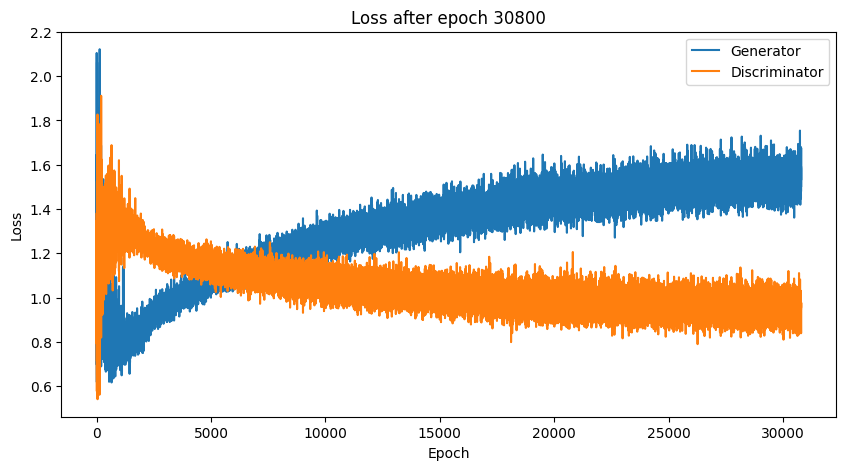

Time for epoch 30800 is 4.170275449752808 sec
Time for epoch 30801 is 0.8610868453979492 sec
Time for epoch 30802 is 0.8598136901855469 sec
Time for epoch 30803 is 0.864501953125 sec
Time for epoch 30804 is 0.8715713024139404 sec
Time for epoch 30805 is 0.8607656955718994 sec
Time for epoch 30806 is 0.8700289726257324 sec
Time for epoch 30807 is 0.8717403411865234 sec
Time for epoch 30808 is 0.8752787113189697 sec
Time for epoch 30809 is 0.8735074996948242 sec
Time for epoch 30810 is 0.8785896301269531 sec
Time for epoch 30811 is 0.8774244785308838 sec
Time for epoch 30812 is 0.8725376129150391 sec
Time for epoch 30813 is 0.8789863586425781 sec
Time for epoch 30814 is 0.8816401958465576 sec
Time for epoch 30815 is 0.8722279071807861 sec
Time for epoch 30816 is 0.8786160945892334 sec
Time for epoch 30817 is 0.8796229362487793 sec
Time for epoch 30818 is 0.8816437721252441 sec
Time for epoch 30819 is 0.8762226104736328 sec
Time for epoch 30820 is 0.8829662799835205 sec
Time for epoch 308

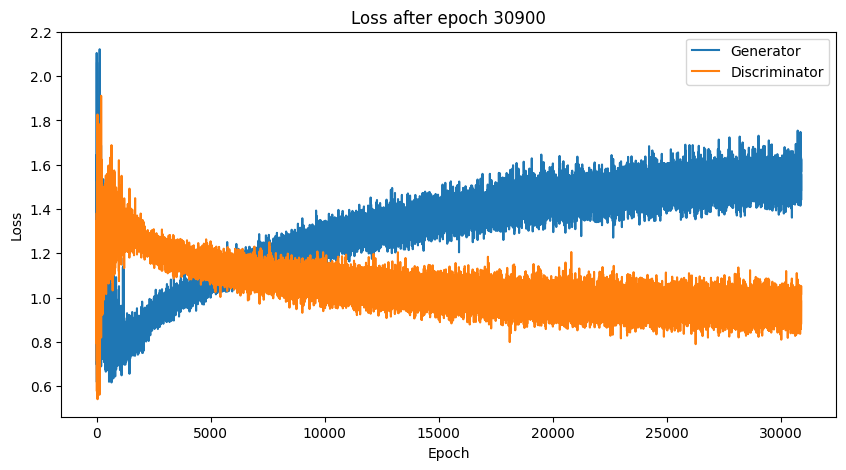

Time for epoch 30900 is 4.361447095870972 sec
Time for epoch 30901 is 0.865379810333252 sec
Time for epoch 30902 is 0.8551046848297119 sec
Time for epoch 30903 is 0.8642396926879883 sec
Time for epoch 30904 is 0.8641805648803711 sec
Time for epoch 30905 is 0.8715600967407227 sec
Time for epoch 30906 is 0.869102954864502 sec
Time for epoch 30907 is 0.8698415756225586 sec
Time for epoch 30908 is 0.8708984851837158 sec
Time for epoch 30909 is 0.8724830150604248 sec
Time for epoch 30910 is 0.873610258102417 sec
Time for epoch 30911 is 0.8750100135803223 sec
Time for epoch 30912 is 0.8711555004119873 sec
Time for epoch 30913 is 0.87400221824646 sec
Time for epoch 30914 is 0.875657320022583 sec
Time for epoch 30915 is 0.8762047290802002 sec
Time for epoch 30916 is 0.8784151077270508 sec
Time for epoch 30917 is 0.8776354789733887 sec
Time for epoch 30918 is 0.8776450157165527 sec
Time for epoch 30919 is 0.87774658203125 sec
Time for epoch 30920 is 0.886056661605835 sec
Time for epoch 30921 is

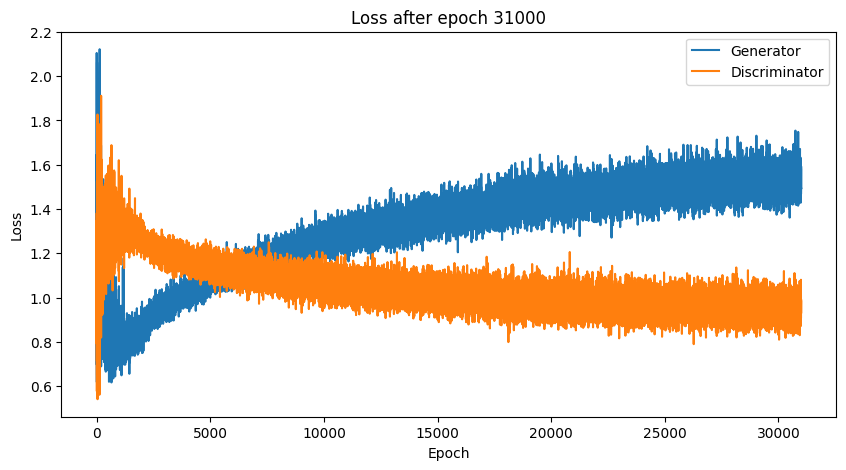

Time for epoch 31000 is 4.150789976119995 sec
Time for epoch 31001 is 0.849876880645752 sec
Time for epoch 31002 is 0.8574974536895752 sec
Time for epoch 31003 is 0.8633270263671875 sec
Time for epoch 31004 is 0.864818811416626 sec
Time for epoch 31005 is 0.870396614074707 sec
Time for epoch 31006 is 0.8686470985412598 sec
Time for epoch 31007 is 0.8758771419525146 sec
Time for epoch 31008 is 0.8737571239471436 sec
Time for epoch 31009 is 0.8716797828674316 sec
Time for epoch 31010 is 0.8694982528686523 sec
Time for epoch 31011 is 0.8747072219848633 sec
Time for epoch 31012 is 0.8789665699005127 sec
Time for epoch 31013 is 0.8758251667022705 sec
Time for epoch 31014 is 0.8794353008270264 sec
Time for epoch 31015 is 0.8798253536224365 sec
Time for epoch 31016 is 0.8774592876434326 sec
Time for epoch 31017 is 0.8775179386138916 sec
Time for epoch 31018 is 0.8805875778198242 sec
Time for epoch 31019 is 0.8804142475128174 sec
Time for epoch 31020 is 0.8812260627746582 sec
Time for epoch 31

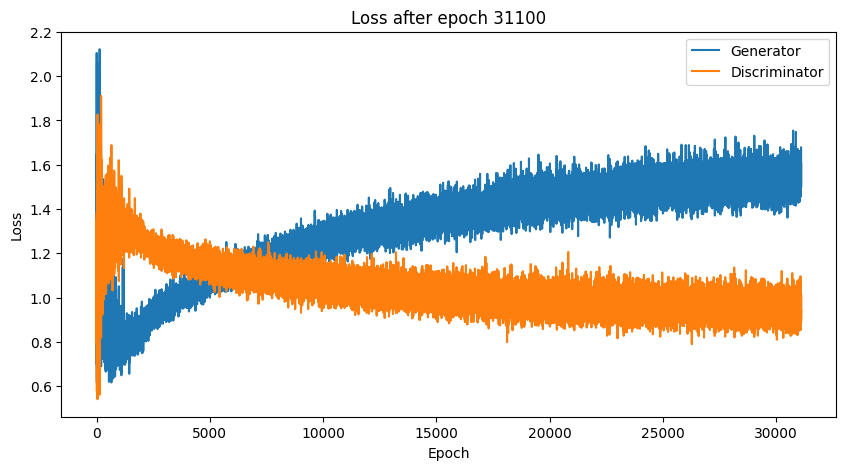

Time for epoch 31100 is 4.212559938430786 sec
Time for epoch 31101 is 0.8590350151062012 sec
Time for epoch 31102 is 0.8569746017456055 sec
Time for epoch 31103 is 0.8638434410095215 sec
Time for epoch 31104 is 0.8650572299957275 sec
Time for epoch 31105 is 0.8730294704437256 sec
Time for epoch 31106 is 0.8695559501647949 sec
Time for epoch 31107 is 0.8750889301300049 sec
Time for epoch 31108 is 0.8744423389434814 sec
Time for epoch 31109 is 0.8781466484069824 sec
Time for epoch 31110 is 0.8756487369537354 sec
Time for epoch 31111 is 0.8751208782196045 sec
Time for epoch 31112 is 0.875328779220581 sec
Time for epoch 31113 is 0.8777604103088379 sec
Time for epoch 31114 is 0.8739619255065918 sec
Time for epoch 31115 is 0.8810622692108154 sec
Time for epoch 31116 is 0.8801414966583252 sec
Time for epoch 31117 is 0.8833363056182861 sec
Time for epoch 31118 is 0.882209300994873 sec
Time for epoch 31119 is 0.8764760494232178 sec
Time for epoch 31120 is 0.875197172164917 sec
Time for epoch 31

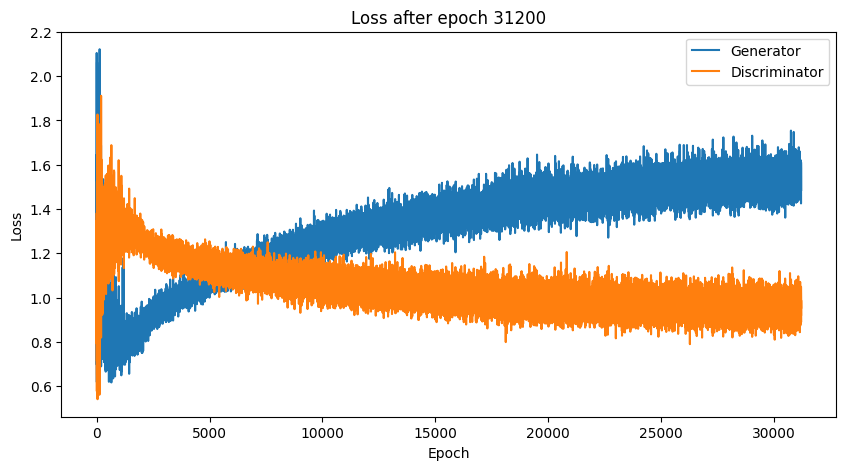

Time for epoch 31200 is 4.193446397781372 sec
Time for epoch 31201 is 0.8535494804382324 sec
Time for epoch 31202 is 0.8621246814727783 sec
Time for epoch 31203 is 0.8622417449951172 sec
Time for epoch 31204 is 0.8643801212310791 sec
Time for epoch 31205 is 0.866595983505249 sec
Time for epoch 31206 is 0.8720159530639648 sec
Time for epoch 31207 is 0.8709995746612549 sec
Time for epoch 31208 is 0.8733880519866943 sec
Time for epoch 31209 is 0.8746359348297119 sec
Time for epoch 31210 is 0.870384693145752 sec
Time for epoch 31211 is 0.8788084983825684 sec
Time for epoch 31212 is 0.8784506320953369 sec
Time for epoch 31213 is 0.8741233348846436 sec
Time for epoch 31214 is 0.879878044128418 sec
Time for epoch 31215 is 0.8762378692626953 sec
Time for epoch 31216 is 0.8789896965026855 sec
Time for epoch 31217 is 0.8799974918365479 sec
Time for epoch 31218 is 0.8795840740203857 sec
Time for epoch 31219 is 0.8786001205444336 sec
Time for epoch 31220 is 0.8820841312408447 sec
Time for epoch 31

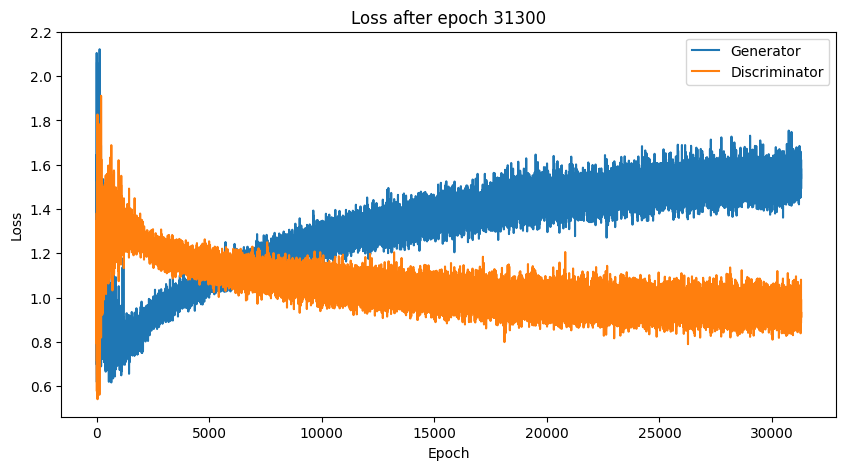

Time for epoch 31300 is 4.172311305999756 sec
Time for epoch 31301 is 0.8586409091949463 sec
Time for epoch 31302 is 0.8589267730712891 sec
Time for epoch 31303 is 0.8641893863677979 sec
Time for epoch 31304 is 0.8657588958740234 sec
Time for epoch 31305 is 0.8677833080291748 sec
Time for epoch 31306 is 0.8693625926971436 sec
Time for epoch 31307 is 0.8677527904510498 sec
Time for epoch 31308 is 0.8743512630462646 sec
Time for epoch 31309 is 0.8749940395355225 sec
Time for epoch 31310 is 0.8731744289398193 sec
Time for epoch 31311 is 0.8761208057403564 sec
Time for epoch 31312 is 0.8752889633178711 sec
Time for epoch 31313 is 0.8757097721099854 sec
Time for epoch 31314 is 0.8767428398132324 sec
Time for epoch 31315 is 0.8793027400970459 sec
Time for epoch 31316 is 0.8803212642669678 sec
Time for epoch 31317 is 0.8824765682220459 sec
Time for epoch 31318 is 0.8714203834533691 sec
Time for epoch 31319 is 0.8801751136779785 sec
Time for epoch 31320 is 0.8829467296600342 sec
Time for epoch

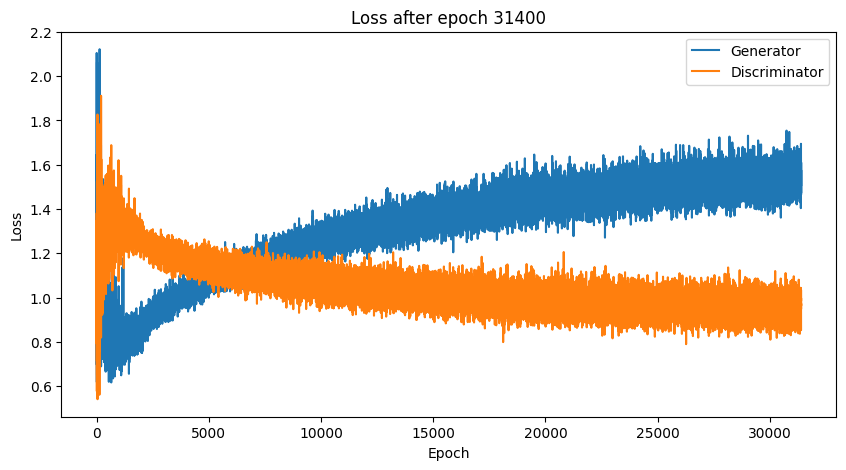

Time for epoch 31400 is 4.348135948181152 sec
Time for epoch 31401 is 0.8631622791290283 sec
Time for epoch 31402 is 0.8546304702758789 sec
Time for epoch 31403 is 0.8626198768615723 sec
Time for epoch 31404 is 0.8606090545654297 sec
Time for epoch 31405 is 0.8716297149658203 sec
Time for epoch 31406 is 0.8677916526794434 sec
Time for epoch 31407 is 0.8722922801971436 sec
Time for epoch 31408 is 0.8713674545288086 sec
Time for epoch 31409 is 0.8727548122406006 sec
Time for epoch 31410 is 0.8744583129882812 sec
Time for epoch 31411 is 0.873502254486084 sec
Time for epoch 31412 is 0.8704378604888916 sec
Time for epoch 31413 is 0.8754327297210693 sec
Time for epoch 31414 is 0.8745646476745605 sec
Time for epoch 31415 is 0.8762338161468506 sec
Time for epoch 31416 is 0.8773472309112549 sec
Time for epoch 31417 is 0.8832674026489258 sec
Time for epoch 31418 is 0.8791441917419434 sec
Time for epoch 31419 is 0.8773539066314697 sec
Time for epoch 31420 is 0.8797473907470703 sec
Time for epoch 

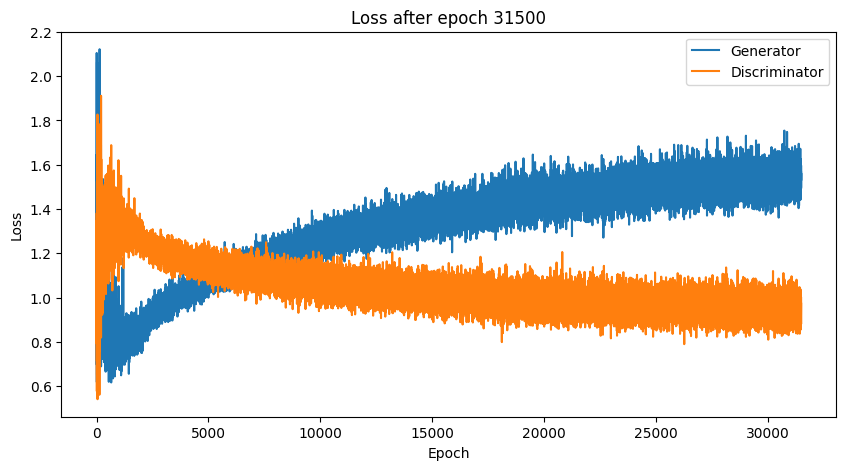

Time for epoch 31500 is 4.168210983276367 sec
Time for epoch 31501 is 0.8650624752044678 sec
Time for epoch 31502 is 0.8643245697021484 sec
Time for epoch 31503 is 0.8630411624908447 sec
Time for epoch 31504 is 0.8679139614105225 sec
Time for epoch 31505 is 0.8619797229766846 sec
Time for epoch 31506 is 0.8729507923126221 sec
Time for epoch 31507 is 0.8707435131072998 sec
Time for epoch 31508 is 0.873755931854248 sec
Time for epoch 31509 is 0.8742501735687256 sec
Time for epoch 31510 is 0.8782734870910645 sec
Time for epoch 31511 is 0.8717730045318604 sec
Time for epoch 31512 is 0.8825993537902832 sec
Time for epoch 31513 is 0.8751821517944336 sec
Time for epoch 31514 is 0.8791697025299072 sec
Time for epoch 31515 is 0.8818533420562744 sec
Time for epoch 31516 is 0.8777415752410889 sec
Time for epoch 31517 is 0.8783340454101562 sec
Time for epoch 31518 is 0.8775370121002197 sec
Time for epoch 31519 is 0.8806202411651611 sec
Time for epoch 31520 is 0.881080150604248 sec
Time for epoch 3

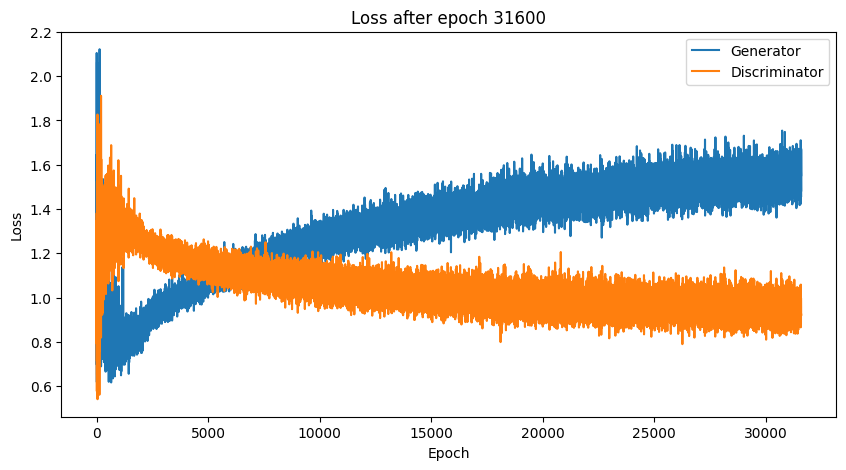

Time for epoch 31600 is 4.176451206207275 sec
Time for epoch 31601 is 0.8546226024627686 sec
Time for epoch 31602 is 0.8619735240936279 sec
Time for epoch 31603 is 0.8653748035430908 sec
Time for epoch 31604 is 0.8663525581359863 sec
Time for epoch 31605 is 0.8702709674835205 sec
Time for epoch 31606 is 0.8660707473754883 sec
Time for epoch 31607 is 0.8728387355804443 sec
Time for epoch 31608 is 0.8720479011535645 sec
Time for epoch 31609 is 0.8717861175537109 sec
Time for epoch 31610 is 0.875356912612915 sec
Time for epoch 31611 is 0.8758225440979004 sec
Time for epoch 31612 is 0.8751230239868164 sec
Time for epoch 31613 is 0.8768153190612793 sec
Time for epoch 31614 is 0.8771817684173584 sec
Time for epoch 31615 is 0.8822600841522217 sec
Time for epoch 31616 is 0.8794004917144775 sec
Time for epoch 31617 is 0.8800063133239746 sec
Time for epoch 31618 is 0.8812754154205322 sec
Time for epoch 31619 is 0.8808369636535645 sec
Time for epoch 31620 is 0.8771746158599854 sec
Time for epoch 

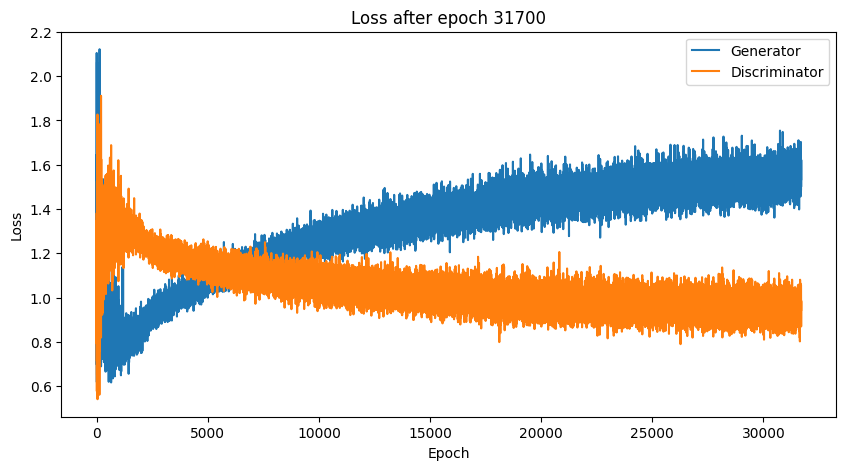

Time for epoch 31700 is 4.198017835617065 sec
Time for epoch 31701 is 0.8525772094726562 sec
Time for epoch 31702 is 0.8617846965789795 sec
Time for epoch 31703 is 0.863243818283081 sec
Time for epoch 31704 is 0.8694961071014404 sec
Time for epoch 31705 is 0.8660330772399902 sec
Time for epoch 31706 is 0.8687210083007812 sec
Time for epoch 31707 is 0.8740019798278809 sec
Time for epoch 31708 is 0.8695197105407715 sec
Time for epoch 31709 is 0.8740966320037842 sec
Time for epoch 31710 is 0.8756945133209229 sec
Time for epoch 31711 is 0.878232479095459 sec
Time for epoch 31712 is 0.8745713233947754 sec
Time for epoch 31713 is 0.8752450942993164 sec
Time for epoch 31714 is 0.878751277923584 sec
Time for epoch 31715 is 0.8767304420471191 sec
Time for epoch 31716 is 0.877579927444458 sec
Time for epoch 31717 is 0.8819355964660645 sec
Time for epoch 31718 is 0.890446662902832 sec
Time for epoch 31719 is 0.8796532154083252 sec
Time for epoch 31720 is 0.8799605369567871 sec
Time for epoch 3172

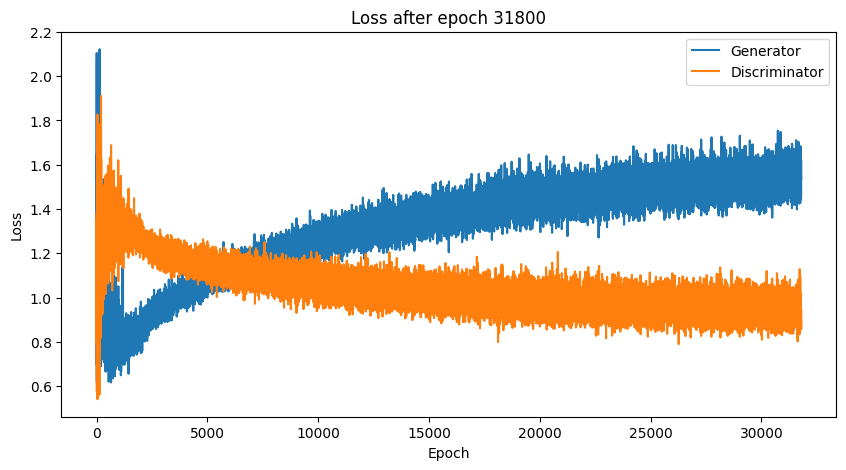

Time for epoch 31800 is 4.372708082199097 sec
Time for epoch 31801 is 0.8513898849487305 sec
Time for epoch 31802 is 0.8617081642150879 sec
Time for epoch 31803 is 0.8649225234985352 sec
Time for epoch 31804 is 0.8671038150787354 sec
Time for epoch 31805 is 0.8682334423065186 sec
Time for epoch 31806 is 0.8683042526245117 sec
Time for epoch 31807 is 0.8681342601776123 sec
Time for epoch 31808 is 0.8736510276794434 sec
Time for epoch 31809 is 0.8709301948547363 sec
Time for epoch 31810 is 0.8748717308044434 sec
Time for epoch 31811 is 0.8771295547485352 sec
Time for epoch 31812 is 0.8764007091522217 sec
Time for epoch 31813 is 0.8819401264190674 sec
Time for epoch 31814 is 0.880934476852417 sec
Time for epoch 31815 is 0.8725099563598633 sec
Time for epoch 31816 is 0.8805971145629883 sec
Time for epoch 31817 is 0.8757889270782471 sec
Time for epoch 31818 is 0.8788697719573975 sec
Time for epoch 31819 is 0.8782832622528076 sec
Time for epoch 31820 is 0.8805837631225586 sec
Time for epoch 

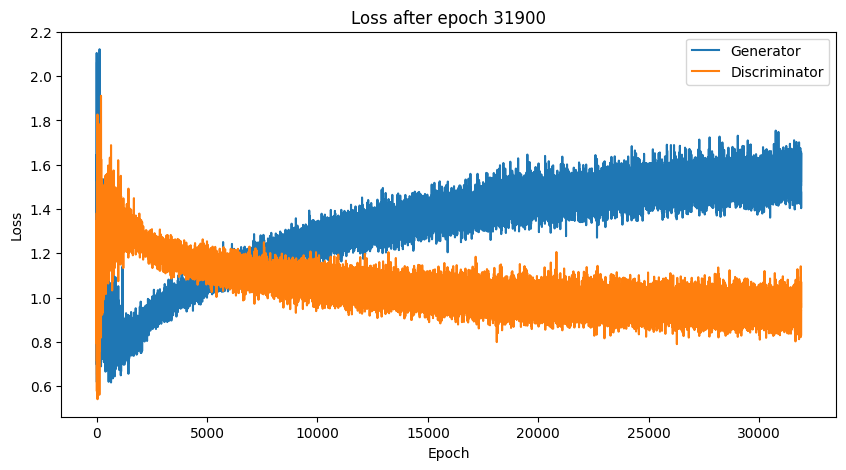

Time for epoch 31900 is 4.17148494720459 sec
Time for epoch 31901 is 0.8682489395141602 sec
Time for epoch 31902 is 0.8570165634155273 sec
Time for epoch 31903 is 0.865391731262207 sec
Time for epoch 31904 is 0.8677570819854736 sec
Time for epoch 31905 is 0.8683130741119385 sec
Time for epoch 31906 is 0.8705613613128662 sec
Time for epoch 31907 is 0.8724496364593506 sec
Time for epoch 31908 is 0.8713457584381104 sec
Time for epoch 31909 is 0.8709969520568848 sec
Time for epoch 31910 is 0.8744699954986572 sec
Time for epoch 31911 is 0.878645658493042 sec
Time for epoch 31912 is 0.8723413944244385 sec
Time for epoch 31913 is 0.8764312267303467 sec
Time for epoch 31914 is 0.8783164024353027 sec
Time for epoch 31915 is 0.8793253898620605 sec
Time for epoch 31916 is 0.8802523612976074 sec
Time for epoch 31917 is 0.8792188167572021 sec
Time for epoch 31918 is 0.8809511661529541 sec
Time for epoch 31919 is 0.8796572685241699 sec
Time for epoch 31920 is 0.8831689357757568 sec
Time for epoch 31

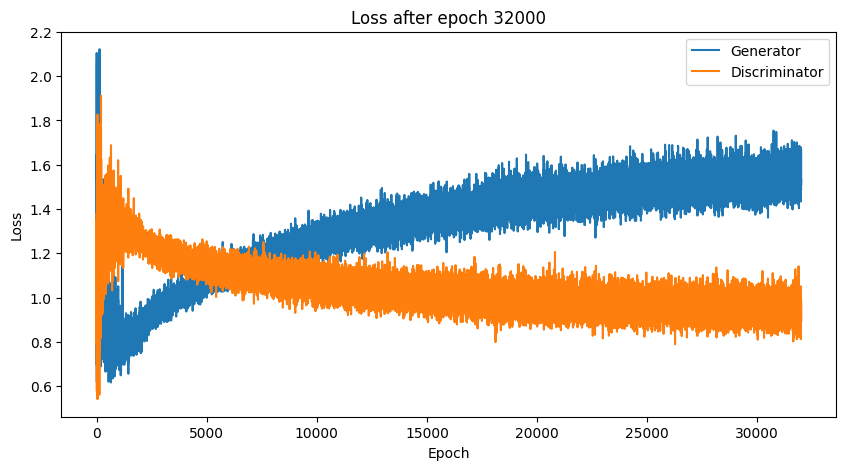

Time for epoch 32000 is 4.205304384231567 sec
Time for epoch 32001 is 0.8494584560394287 sec
Time for epoch 32002 is 0.8598968982696533 sec
Time for epoch 32003 is 0.8627922534942627 sec
Time for epoch 32004 is 0.8667397499084473 sec
Time for epoch 32005 is 0.8708605766296387 sec
Time for epoch 32006 is 0.8667683601379395 sec
Time for epoch 32007 is 0.873206377029419 sec
Time for epoch 32008 is 0.872812032699585 sec
Time for epoch 32009 is 0.8741612434387207 sec
Time for epoch 32010 is 0.8707165718078613 sec
Time for epoch 32011 is 0.8736484050750732 sec
Time for epoch 32012 is 0.8731608390808105 sec
Time for epoch 32013 is 0.8818438053131104 sec
Time for epoch 32014 is 0.8796350955963135 sec
Time for epoch 32015 is 0.8831546306610107 sec
Time for epoch 32016 is 0.877312421798706 sec
Time for epoch 32017 is 0.8798284530639648 sec
Time for epoch 32018 is 0.8830409049987793 sec
Time for epoch 32019 is 0.8817052841186523 sec
Time for epoch 32020 is 0.8831174373626709 sec
Time for epoch 32

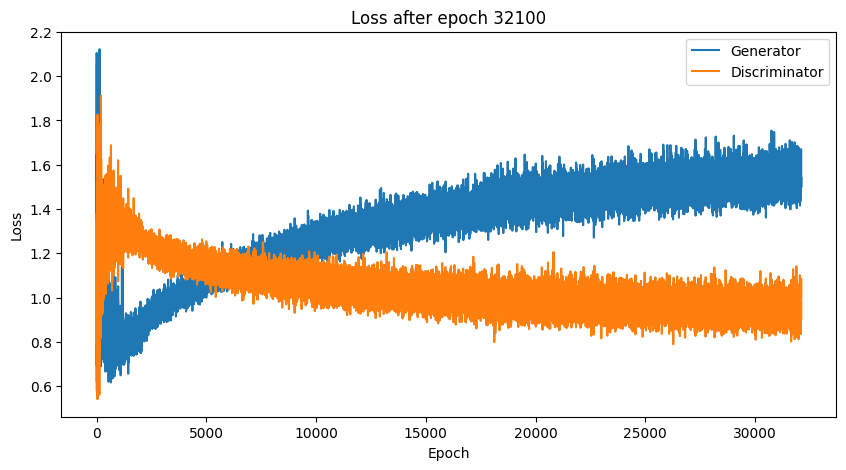

Time for epoch 32100 is 4.188983678817749 sec
Time for epoch 32101 is 0.8475675582885742 sec
Time for epoch 32102 is 0.8645370006561279 sec
Time for epoch 32103 is 0.860558271408081 sec
Time for epoch 32104 is 0.8649482727050781 sec
Time for epoch 32105 is 0.8672373294830322 sec
Time for epoch 32106 is 0.8730809688568115 sec
Time for epoch 32107 is 0.8730363845825195 sec
Time for epoch 32108 is 0.8710410594940186 sec
Time for epoch 32109 is 0.8817555904388428 sec
Time for epoch 32110 is 0.8742315769195557 sec
Time for epoch 32111 is 0.8785552978515625 sec
Time for epoch 32112 is 0.8734757900238037 sec
Time for epoch 32113 is 0.8834342956542969 sec
Time for epoch 32114 is 0.875044584274292 sec
Time for epoch 32115 is 0.8826000690460205 sec
Time for epoch 32116 is 0.8780643939971924 sec
Time for epoch 32117 is 0.8811919689178467 sec
Time for epoch 32118 is 0.8802933692932129 sec
Time for epoch 32119 is 0.8825511932373047 sec
Time for epoch 32120 is 0.8795802593231201 sec
Time for epoch 3

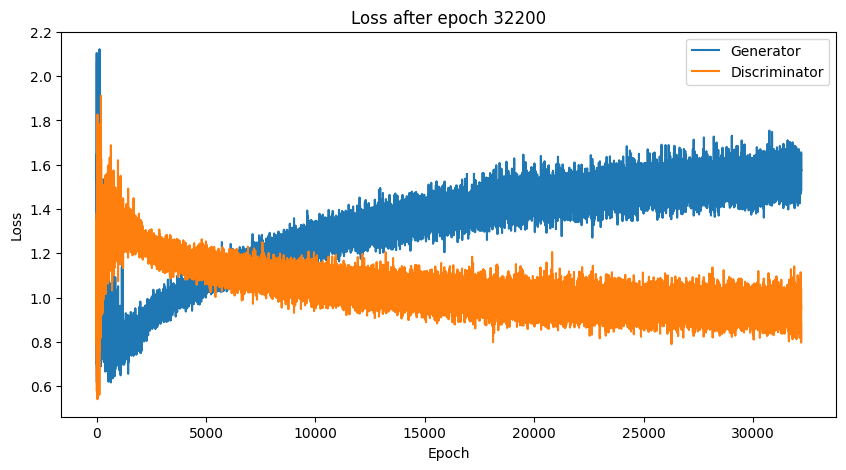

Time for epoch 32200 is 4.348007917404175 sec
Time for epoch 32201 is 0.8590152263641357 sec
Time for epoch 32202 is 0.8537094593048096 sec
Time for epoch 32203 is 0.8590438365936279 sec
Time for epoch 32204 is 0.8625166416168213 sec
Time for epoch 32205 is 0.8658735752105713 sec
Time for epoch 32206 is 0.8690123558044434 sec
Time for epoch 32207 is 0.8703463077545166 sec
Time for epoch 32208 is 0.8750500679016113 sec
Time for epoch 32209 is 0.8739657402038574 sec
Time for epoch 32210 is 0.8741300106048584 sec
Time for epoch 32211 is 0.877631664276123 sec
Time for epoch 32212 is 0.8709316253662109 sec
Time for epoch 32213 is 0.8758289813995361 sec
Time for epoch 32214 is 0.8804693222045898 sec
Time for epoch 32215 is 0.8833966255187988 sec
Time for epoch 32216 is 0.876981258392334 sec
Time for epoch 32217 is 0.8832037448883057 sec
Time for epoch 32218 is 0.876563310623169 sec
Time for epoch 32219 is 0.8794760704040527 sec
Time for epoch 32220 is 0.8839702606201172 sec
Time for epoch 32

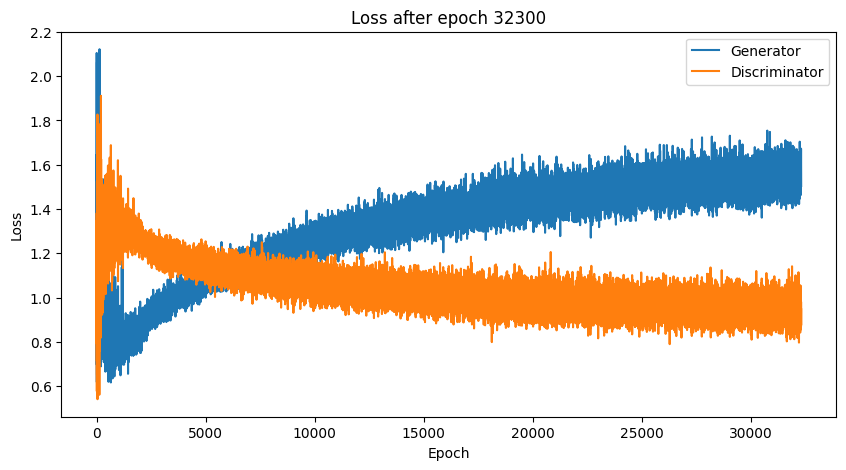

Time for epoch 32300 is 4.180332183837891 sec
Time for epoch 32301 is 0.8634099960327148 sec
Time for epoch 32302 is 0.862602949142456 sec
Time for epoch 32303 is 0.8661479949951172 sec
Time for epoch 32304 is 0.8672311305999756 sec
Time for epoch 32305 is 0.8687090873718262 sec
Time for epoch 32306 is 0.8725059032440186 sec
Time for epoch 32307 is 0.870530366897583 sec
Time for epoch 32308 is 0.8757257461547852 sec
Time for epoch 32309 is 0.8697774410247803 sec
Time for epoch 32310 is 0.878591775894165 sec
Time for epoch 32311 is 0.8798372745513916 sec
Time for epoch 32312 is 0.8763816356658936 sec
Time for epoch 32313 is 0.8799171447753906 sec
Time for epoch 32314 is 0.8792269229888916 sec
Time for epoch 32315 is 0.8754374980926514 sec
Time for epoch 32316 is 0.8800215721130371 sec
Time for epoch 32317 is 0.8802585601806641 sec
Time for epoch 32318 is 0.8827691078186035 sec
Time for epoch 32319 is 0.8836987018585205 sec
Time for epoch 32320 is 0.8753468990325928 sec
Time for epoch 32

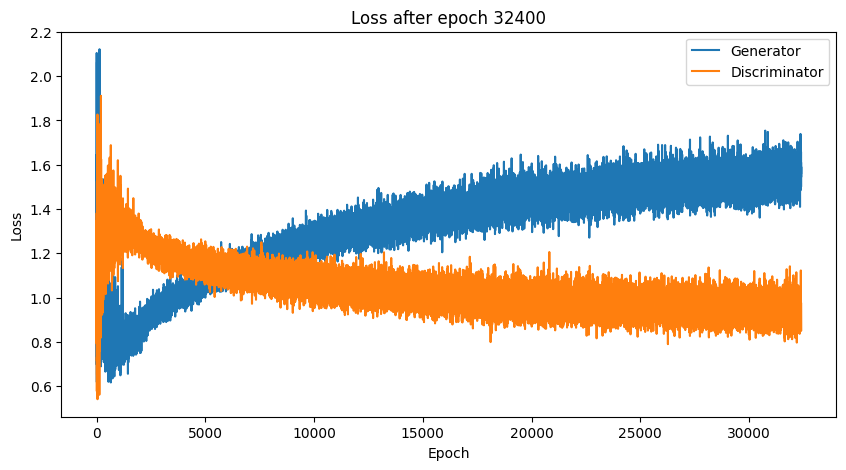

Time for epoch 32400 is 4.240318298339844 sec
Time for epoch 32401 is 0.857450008392334 sec
Time for epoch 32402 is 0.8622593879699707 sec
Time for epoch 32403 is 0.8657119274139404 sec
Time for epoch 32404 is 0.8616433143615723 sec
Time for epoch 32405 is 0.8692901134490967 sec
Time for epoch 32406 is 0.8706021308898926 sec
Time for epoch 32407 is 0.8682646751403809 sec
Time for epoch 32408 is 0.8753883838653564 sec
Time for epoch 32409 is 0.8754198551177979 sec
Time for epoch 32410 is 0.8719077110290527 sec
Time for epoch 32411 is 0.887122392654419 sec
Time for epoch 32412 is 0.8760156631469727 sec
Time for epoch 32413 is 0.875300407409668 sec
Time for epoch 32414 is 0.8808178901672363 sec
Time for epoch 32415 is 0.880683183670044 sec
Time for epoch 32416 is 0.8791487216949463 sec
Time for epoch 32417 is 0.879582405090332 sec
Time for epoch 32418 is 0.882972002029419 sec
Time for epoch 32419 is 0.8802387714385986 sec
Time for epoch 32420 is 0.8797111511230469 sec
Time for epoch 32421

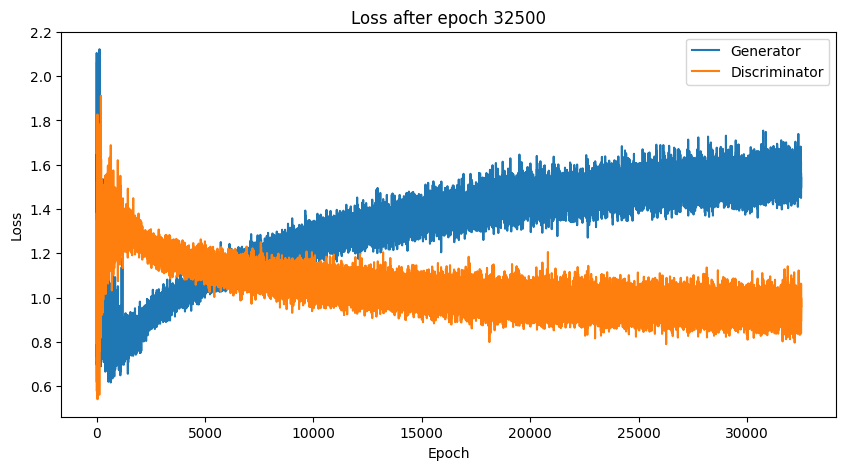

Time for epoch 32500 is 4.182409286499023 sec
Time for epoch 32501 is 0.8476667404174805 sec
Time for epoch 32502 is 0.8619868755340576 sec
Time for epoch 32503 is 0.8627393245697021 sec
Time for epoch 32504 is 0.8655917644500732 sec
Time for epoch 32505 is 0.8672854900360107 sec
Time for epoch 32506 is 0.8686203956604004 sec
Time for epoch 32507 is 0.876847505569458 sec
Time for epoch 32508 is 0.8728511333465576 sec
Time for epoch 32509 is 0.8737242221832275 sec
Time for epoch 32510 is 0.877302885055542 sec
Time for epoch 32511 is 0.8764104843139648 sec
Time for epoch 32512 is 0.8754856586456299 sec
Time for epoch 32513 is 0.882056474685669 sec
Time for epoch 32514 is 0.878401517868042 sec
Time for epoch 32515 is 0.8767728805541992 sec
Time for epoch 32516 is 0.8764863014221191 sec
Time for epoch 32517 is 0.8815407752990723 sec
Time for epoch 32518 is 0.8799004554748535 sec
Time for epoch 32519 is 0.8838708400726318 sec
Time for epoch 32520 is 0.8791749477386475 sec
Time for epoch 325

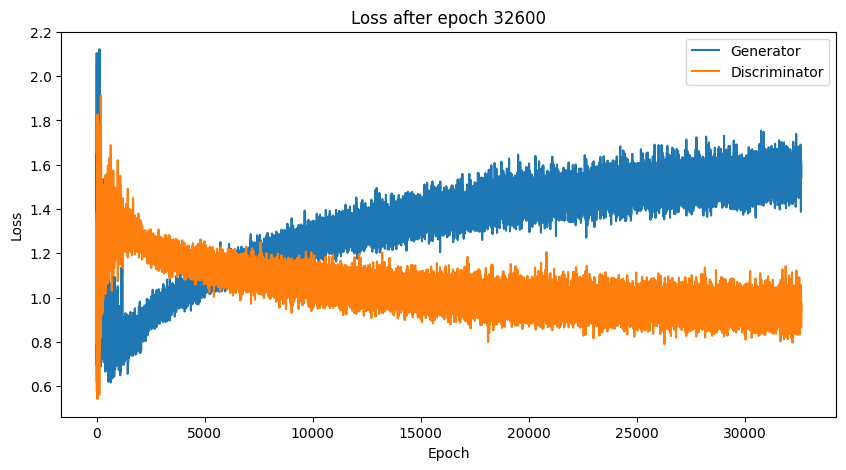

Time for epoch 32600 is 4.398653268814087 sec
Time for epoch 32601 is 0.8655614852905273 sec
Time for epoch 32602 is 0.8578596115112305 sec
Time for epoch 32603 is 0.8609356880187988 sec
Time for epoch 32604 is 0.8660829067230225 sec
Time for epoch 32605 is 0.864708423614502 sec
Time for epoch 32606 is 0.8664495944976807 sec
Time for epoch 32607 is 0.8701825141906738 sec
Time for epoch 32608 is 0.8713395595550537 sec
Time for epoch 32609 is 0.8743526935577393 sec
Time for epoch 32610 is 0.8686866760253906 sec
Time for epoch 32611 is 0.875537633895874 sec
Time for epoch 32612 is 0.8761208057403564 sec
Time for epoch 32613 is 0.874047040939331 sec
Time for epoch 32614 is 0.879847526550293 sec
Time for epoch 32615 is 0.8748292922973633 sec
Time for epoch 32616 is 0.8803761005401611 sec
Time for epoch 32617 is 0.8735699653625488 sec
Time for epoch 32618 is 0.8814263343811035 sec
Time for epoch 32619 is 0.8875393867492676 sec
Time for epoch 32620 is 0.8781130313873291 sec
Time for epoch 326

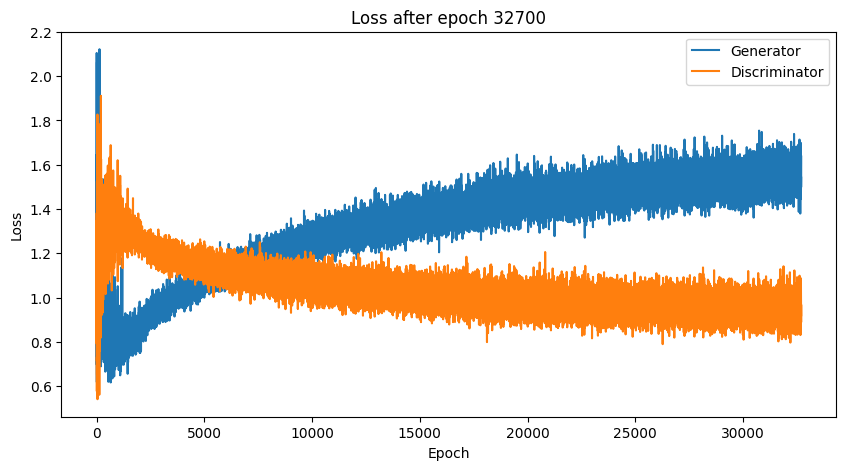

Time for epoch 32700 is 4.232716083526611 sec
Time for epoch 32701 is 0.8687343597412109 sec
Time for epoch 32702 is 0.8599200248718262 sec
Time for epoch 32703 is 0.8634989261627197 sec
Time for epoch 32704 is 0.8658568859100342 sec
Time for epoch 32705 is 0.8680238723754883 sec
Time for epoch 32706 is 0.8696088790893555 sec
Time for epoch 32707 is 0.8725652694702148 sec
Time for epoch 32708 is 0.8723382949829102 sec
Time for epoch 32709 is 0.8731350898742676 sec
Time for epoch 32710 is 0.8726716041564941 sec
Time for epoch 32711 is 0.874014139175415 sec
Time for epoch 32712 is 0.8733851909637451 sec
Time for epoch 32713 is 0.8762726783752441 sec
Time for epoch 32714 is 0.8795838356018066 sec
Time for epoch 32715 is 0.8829782009124756 sec
Time for epoch 32716 is 0.8777494430541992 sec
Time for epoch 32717 is 0.8757743835449219 sec
Time for epoch 32718 is 0.8785855770111084 sec
Time for epoch 32719 is 0.8802666664123535 sec
Time for epoch 32720 is 0.8790407180786133 sec
Time for epoch 

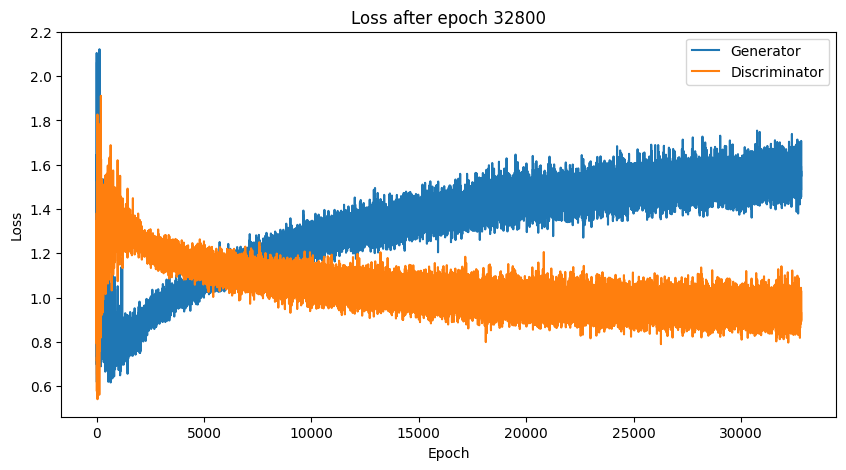

Time for epoch 32800 is 4.2194671630859375 sec
Time for epoch 32801 is 0.8655407428741455 sec
Time for epoch 32802 is 0.8584985733032227 sec
Time for epoch 32803 is 0.8661103248596191 sec
Time for epoch 32804 is 0.8657393455505371 sec
Time for epoch 32805 is 0.8693819046020508 sec
Time for epoch 32806 is 0.8718154430389404 sec
Time for epoch 32807 is 0.8761413097381592 sec
Time for epoch 32808 is 0.8729023933410645 sec
Time for epoch 32809 is 0.8753395080566406 sec
Time for epoch 32810 is 0.8775532245635986 sec
Time for epoch 32811 is 0.8746328353881836 sec
Time for epoch 32812 is 0.8781006336212158 sec
Time for epoch 32813 is 0.8756277561187744 sec
Time for epoch 32814 is 0.8787171840667725 sec
Time for epoch 32815 is 0.8808033466339111 sec
Time for epoch 32816 is 0.8808815479278564 sec
Time for epoch 32817 is 0.87943434715271 sec
Time for epoch 32818 is 0.8788928985595703 sec
Time for epoch 32819 is 0.8819143772125244 sec
Time for epoch 32820 is 0.8778948783874512 sec
Time for epoch 

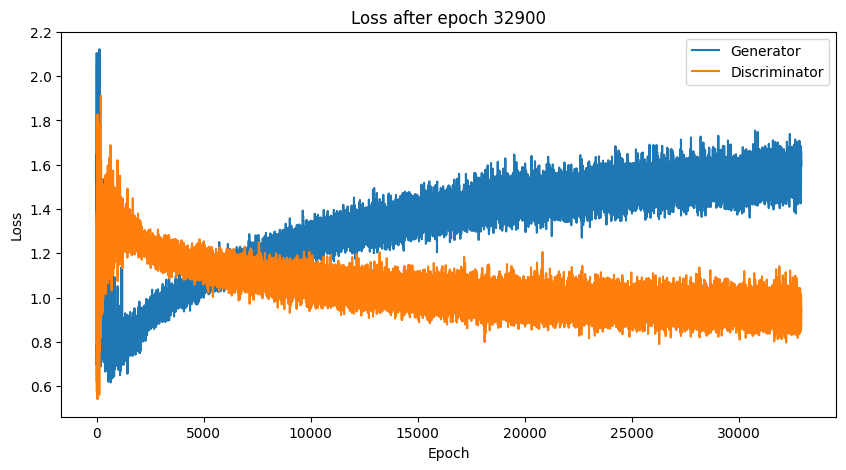

Time for epoch 32900 is 4.4189863204956055 sec
Time for epoch 32901 is 0.8488960266113281 sec
Time for epoch 32902 is 0.862736701965332 sec
Time for epoch 32903 is 0.8651645183563232 sec
Time for epoch 32904 is 0.8627676963806152 sec
Time for epoch 32905 is 0.8697006702423096 sec
Time for epoch 32906 is 0.8726191520690918 sec
Time for epoch 32907 is 0.8709046840667725 sec
Time for epoch 32908 is 0.8762164115905762 sec
Time for epoch 32909 is 0.8699910640716553 sec
Time for epoch 32910 is 0.8722753524780273 sec
Time for epoch 32911 is 0.8783462047576904 sec
Time for epoch 32912 is 0.8752837181091309 sec
Time for epoch 32913 is 0.8757452964782715 sec
Time for epoch 32914 is 0.8766753673553467 sec
Time for epoch 32915 is 0.8786320686340332 sec
Time for epoch 32916 is 0.8801109790802002 sec
Time for epoch 32917 is 0.8783519268035889 sec
Time for epoch 32918 is 0.8819406032562256 sec
Time for epoch 32919 is 0.883242130279541 sec
Time for epoch 32920 is 0.8841290473937988 sec
Time for epoch 

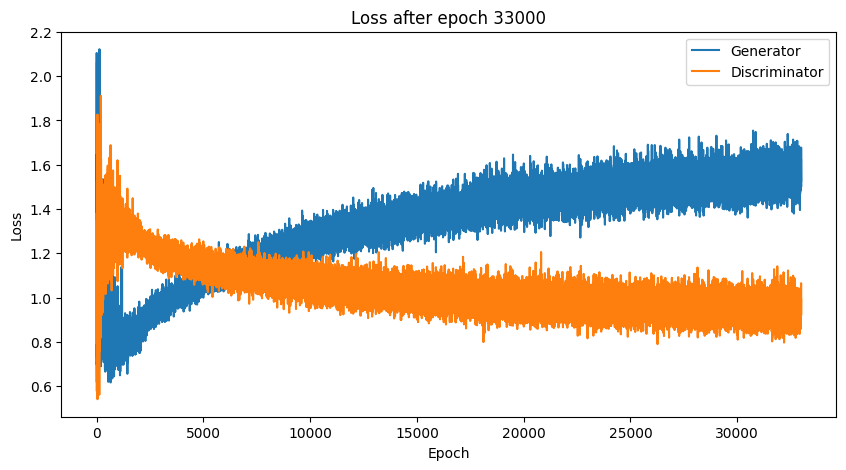

Time for epoch 33000 is 4.190014600753784 sec
Time for epoch 33001 is 0.8693993091583252 sec
Time for epoch 33002 is 0.859929084777832 sec
Time for epoch 33003 is 0.8678536415100098 sec
Time for epoch 33004 is 0.8650617599487305 sec
Time for epoch 33005 is 0.8705496788024902 sec
Time for epoch 33006 is 0.8630034923553467 sec
Time for epoch 33007 is 0.8775920867919922 sec
Time for epoch 33008 is 0.8718822002410889 sec
Time for epoch 33009 is 0.8737974166870117 sec
Time for epoch 33010 is 0.8720061779022217 sec
Time for epoch 33011 is 0.8795461654663086 sec
Time for epoch 33012 is 0.8755331039428711 sec
Time for epoch 33013 is 0.8772709369659424 sec
Time for epoch 33014 is 0.875598669052124 sec
Time for epoch 33015 is 0.8735840320587158 sec
Time for epoch 33016 is 0.876013994216919 sec
Time for epoch 33017 is 0.8819451332092285 sec
Time for epoch 33018 is 0.8746285438537598 sec
Time for epoch 33019 is 0.8838822841644287 sec
Time for epoch 33020 is 0.8815631866455078 sec
Time for epoch 33

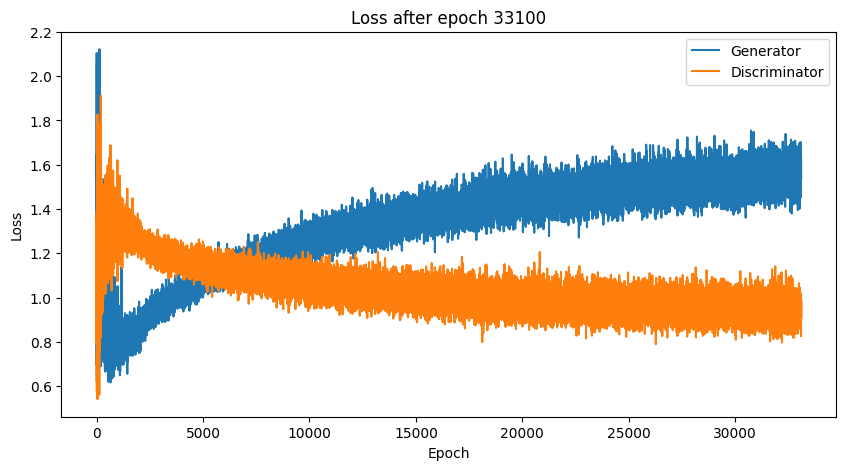

Time for epoch 33100 is 4.245117664337158 sec
Time for epoch 33101 is 0.8563251495361328 sec
Time for epoch 33102 is 0.8675143718719482 sec
Time for epoch 33103 is 0.8637571334838867 sec
Time for epoch 33104 is 0.8649258613586426 sec
Time for epoch 33105 is 0.8700919151306152 sec
Time for epoch 33106 is 0.876619815826416 sec
Time for epoch 33107 is 0.8705284595489502 sec
Time for epoch 33108 is 0.8715202808380127 sec
Time for epoch 33109 is 0.8736653327941895 sec
Time for epoch 33110 is 0.8745608329772949 sec
Time for epoch 33111 is 0.8831262588500977 sec
Time for epoch 33112 is 0.8783078193664551 sec
Time for epoch 33113 is 0.8723056316375732 sec
Time for epoch 33114 is 0.8781516551971436 sec
Time for epoch 33115 is 0.8767213821411133 sec
Time for epoch 33116 is 0.8849532604217529 sec
Time for epoch 33117 is 0.8751926422119141 sec
Time for epoch 33118 is 0.8779489994049072 sec
Time for epoch 33119 is 0.8867828845977783 sec
Time for epoch 33120 is 0.8799848556518555 sec
Time for epoch 

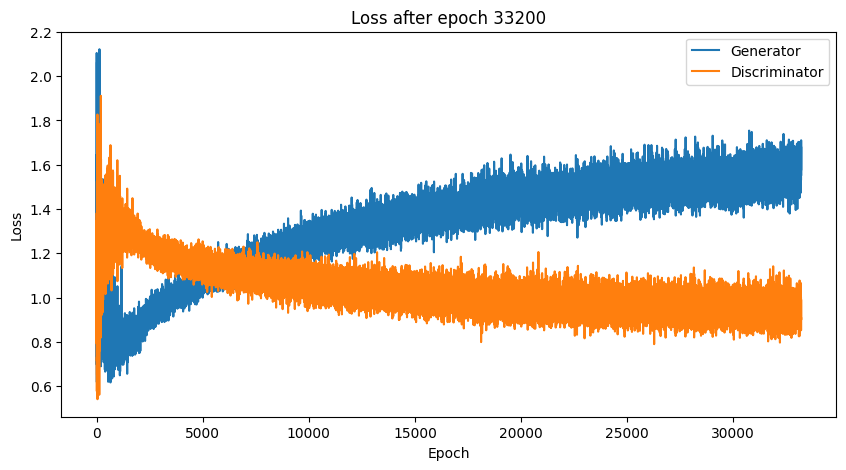

Time for epoch 33200 is 4.232245445251465 sec
Time for epoch 33201 is 0.855353832244873 sec
Time for epoch 33202 is 0.8604278564453125 sec
Time for epoch 33203 is 0.8672995567321777 sec
Time for epoch 33204 is 0.8655068874359131 sec
Time for epoch 33205 is 0.8739540576934814 sec
Time for epoch 33206 is 0.8658196926116943 sec
Time for epoch 33207 is 0.872657060623169 sec
Time for epoch 33208 is 0.8776378631591797 sec
Time for epoch 33209 is 0.8704051971435547 sec
Time for epoch 33210 is 0.8834445476531982 sec
Time for epoch 33211 is 0.8725440502166748 sec
Time for epoch 33212 is 0.880685567855835 sec
Time for epoch 33213 is 0.8796510696411133 sec
Time for epoch 33214 is 0.8759720325469971 sec
Time for epoch 33215 is 0.8827016353607178 sec
Time for epoch 33216 is 0.8767564296722412 sec
Time for epoch 33217 is 0.8795933723449707 sec
Time for epoch 33218 is 0.8825955390930176 sec
Time for epoch 33219 is 0.8799779415130615 sec
Time for epoch 33220 is 0.8805773258209229 sec
Time for epoch 33

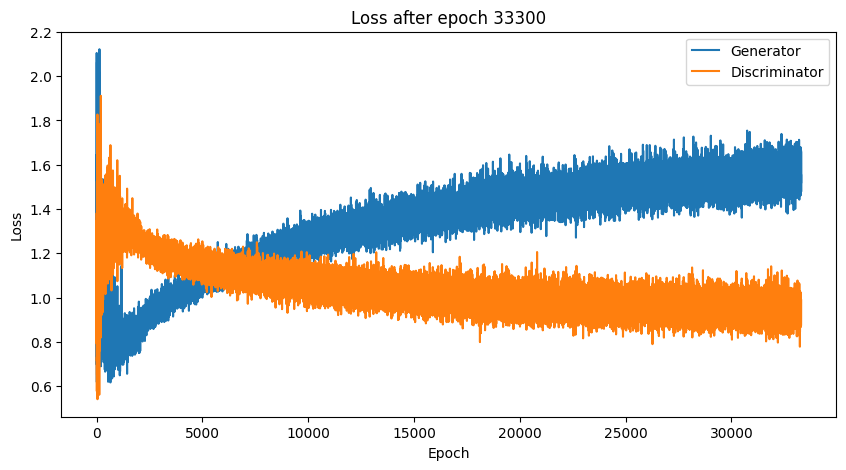

Time for epoch 33300 is 4.39030647277832 sec
Time for epoch 33301 is 0.8611891269683838 sec
Time for epoch 33302 is 0.8597366809844971 sec
Time for epoch 33303 is 0.8650991916656494 sec
Time for epoch 33304 is 0.8697288036346436 sec
Time for epoch 33305 is 0.8686189651489258 sec
Time for epoch 33306 is 0.8687126636505127 sec
Time for epoch 33307 is 0.8714430332183838 sec
Time for epoch 33308 is 0.8736374378204346 sec
Time for epoch 33309 is 0.8748230934143066 sec
Time for epoch 33310 is 0.8784058094024658 sec
Time for epoch 33311 is 0.8734946250915527 sec
Time for epoch 33312 is 0.8796374797821045 sec
Time for epoch 33313 is 0.8816604614257812 sec
Time for epoch 33314 is 0.8777399063110352 sec
Time for epoch 33315 is 0.878807783126831 sec
Time for epoch 33316 is 0.8781228065490723 sec
Time for epoch 33317 is 0.8792281150817871 sec
Time for epoch 33318 is 0.8775217533111572 sec
Time for epoch 33319 is 0.8802337646484375 sec
Time for epoch 33320 is 0.8783457279205322 sec
Time for epoch 3

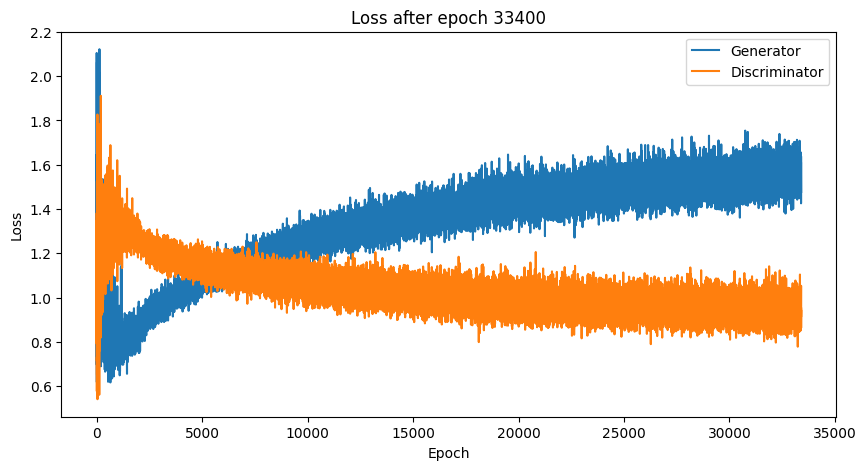

Time for epoch 33400 is 4.186110973358154 sec
Time for epoch 33401 is 0.857154130935669 sec
Time for epoch 33402 is 0.868865966796875 sec
Time for epoch 33403 is 0.8661417961120605 sec
Time for epoch 33404 is 0.8619015216827393 sec
Time for epoch 33405 is 0.8692028522491455 sec
Time for epoch 33406 is 0.872750997543335 sec
Time for epoch 33407 is 0.8714854717254639 sec
Time for epoch 33408 is 0.8749823570251465 sec
Time for epoch 33409 is 0.8750379085540771 sec
Time for epoch 33410 is 0.8751406669616699 sec
Time for epoch 33411 is 0.8771483898162842 sec
Time for epoch 33412 is 0.8707413673400879 sec
Time for epoch 33413 is 0.8799197673797607 sec
Time for epoch 33414 is 0.8723254203796387 sec
Time for epoch 33415 is 0.8797552585601807 sec
Time for epoch 33416 is 0.880997896194458 sec
Time for epoch 33417 is 0.8765864372253418 sec
Time for epoch 33418 is 0.88114333152771 sec
Time for epoch 33419 is 0.8785562515258789 sec
Time for epoch 33420 is 0.8831770420074463 sec
Time for epoch 33421

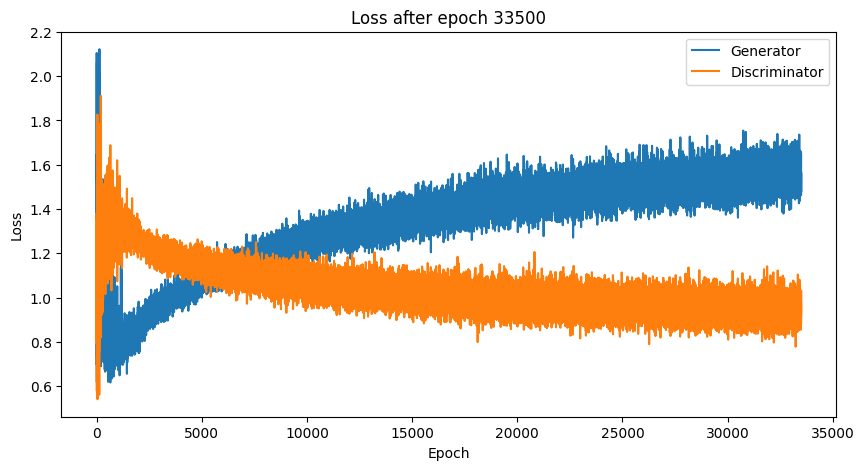

Time for epoch 33500 is 4.233598232269287 sec
Time for epoch 33501 is 0.8517646789550781 sec
Time for epoch 33502 is 0.8606328964233398 sec
Time for epoch 33503 is 0.8644294738769531 sec
Time for epoch 33504 is 0.863255500793457 sec
Time for epoch 33505 is 0.87158203125 sec
Time for epoch 33506 is 0.8677847385406494 sec
Time for epoch 33507 is 0.8727273941040039 sec
Time for epoch 33508 is 0.8784549236297607 sec
Time for epoch 33509 is 0.8759348392486572 sec
Time for epoch 33510 is 0.8712937831878662 sec
Time for epoch 33511 is 0.8742282390594482 sec
Time for epoch 33512 is 0.8793718814849854 sec
Time for epoch 33513 is 0.8785676956176758 sec
Time for epoch 33514 is 0.8772335052490234 sec
Time for epoch 33515 is 0.8765242099761963 sec
Time for epoch 33516 is 0.8816430568695068 sec
Time for epoch 33517 is 0.8816728591918945 sec
Time for epoch 33518 is 0.8830585479736328 sec
Time for epoch 33519 is 0.8815126419067383 sec
Time for epoch 33520 is 0.8805060386657715 sec
Time for epoch 33521

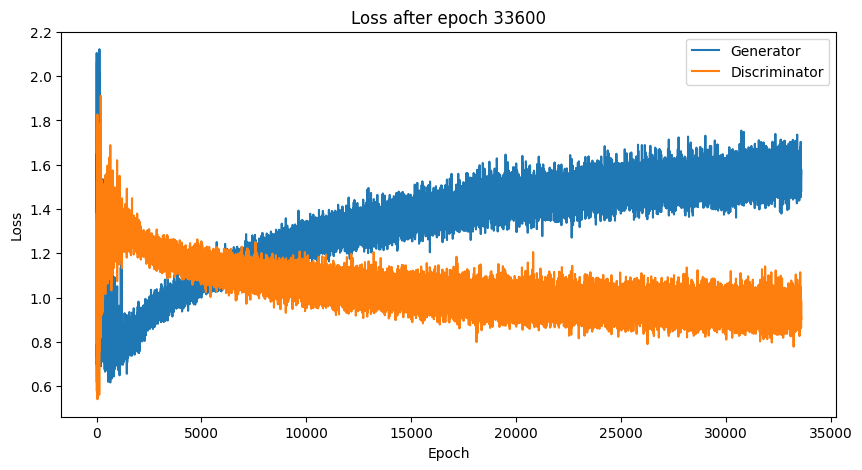

Time for epoch 33600 is 4.193081378936768 sec
Time for epoch 33601 is 0.8624176979064941 sec
Time for epoch 33602 is 0.8561503887176514 sec
Time for epoch 33603 is 0.8619229793548584 sec
Time for epoch 33604 is 0.8710174560546875 sec
Time for epoch 33605 is 0.8652667999267578 sec
Time for epoch 33606 is 0.8764111995697021 sec
Time for epoch 33607 is 0.8728926181793213 sec
Time for epoch 33608 is 0.8774974346160889 sec
Time for epoch 33609 is 0.8723433017730713 sec
Time for epoch 33610 is 0.8743100166320801 sec
Time for epoch 33611 is 0.8769755363464355 sec
Time for epoch 33612 is 0.8744184970855713 sec
Time for epoch 33613 is 0.8775980472564697 sec
Time for epoch 33614 is 0.8761904239654541 sec
Time for epoch 33615 is 0.8780820369720459 sec
Time for epoch 33616 is 0.8804666996002197 sec
Time for epoch 33617 is 0.8807544708251953 sec
Time for epoch 33618 is 0.877117395401001 sec
Time for epoch 33619 is 0.8809325695037842 sec
Time for epoch 33620 is 0.8837752342224121 sec
Time for epoch 

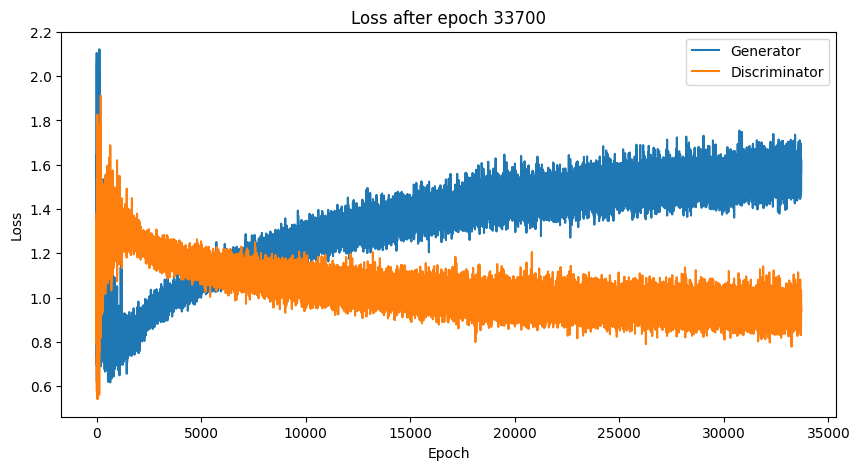

Time for epoch 33700 is 4.433580160140991 sec
Time for epoch 33701 is 0.8558831214904785 sec
Time for epoch 33702 is 0.8565235137939453 sec
Time for epoch 33703 is 0.8632726669311523 sec
Time for epoch 33704 is 0.8703968524932861 sec
Time for epoch 33705 is 0.865424394607544 sec
Time for epoch 33706 is 0.8739950656890869 sec
Time for epoch 33707 is 0.8729305267333984 sec
Time for epoch 33708 is 0.8741905689239502 sec
Time for epoch 33709 is 0.878126859664917 sec
Time for epoch 33710 is 0.8738560676574707 sec
Time for epoch 33711 is 0.8741872310638428 sec
Time for epoch 33712 is 0.8752346038818359 sec
Time for epoch 33713 is 0.8743984699249268 sec
Time for epoch 33714 is 0.8735206127166748 sec
Time for epoch 33715 is 0.8806135654449463 sec
Time for epoch 33716 is 0.8812921047210693 sec
Time for epoch 33717 is 0.8789541721343994 sec
Time for epoch 33718 is 0.8804183006286621 sec
Time for epoch 33719 is 0.877626895904541 sec
Time for epoch 33720 is 0.8791224956512451 sec
Time for epoch 33

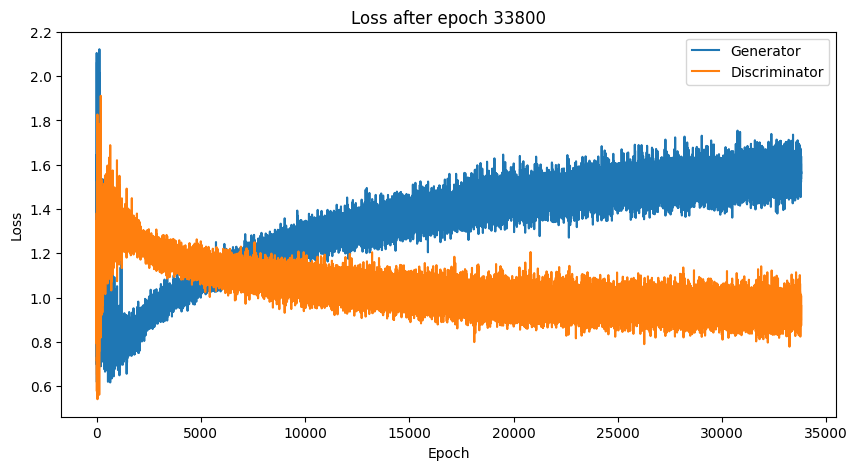

Time for epoch 33800 is 4.222931385040283 sec
Time for epoch 33801 is 0.8613812923431396 sec
Time for epoch 33802 is 0.858102560043335 sec
Time for epoch 33803 is 0.865074634552002 sec
Time for epoch 33804 is 0.8691389560699463 sec
Time for epoch 33805 is 0.8663997650146484 sec
Time for epoch 33806 is 0.8705034255981445 sec
Time for epoch 33807 is 0.8762791156768799 sec
Time for epoch 33808 is 0.8721513748168945 sec
Time for epoch 33809 is 0.8806860446929932 sec
Time for epoch 33810 is 0.8762862682342529 sec
Time for epoch 33811 is 0.8777539730072021 sec
Time for epoch 33812 is 0.8774969577789307 sec
Time for epoch 33813 is 0.8778300285339355 sec
Time for epoch 33814 is 0.8800451755523682 sec
Time for epoch 33815 is 0.882922887802124 sec
Time for epoch 33816 is 0.876168966293335 sec
Time for epoch 33817 is 0.8798296451568604 sec
Time for epoch 33818 is 0.879091739654541 sec
Time for epoch 33819 is 0.8804247379302979 sec
Time for epoch 33820 is 0.8822858333587646 sec
Time for epoch 3382

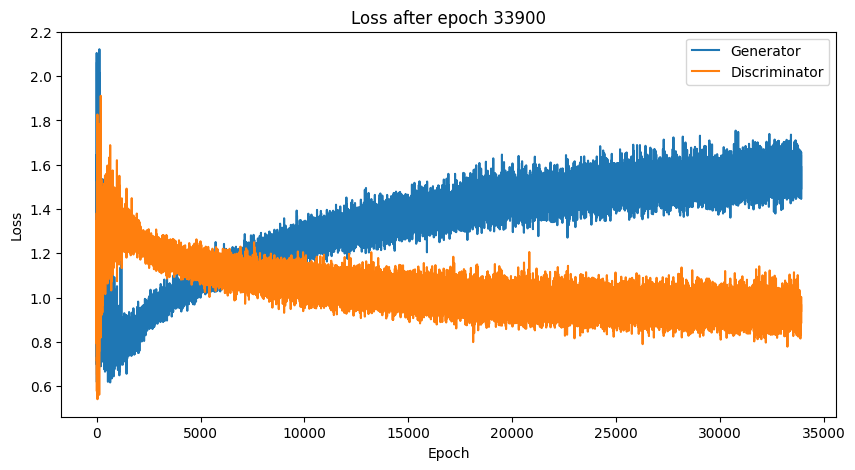

Time for epoch 33900 is 4.223036766052246 sec
Time for epoch 33901 is 0.8523886203765869 sec
Time for epoch 33902 is 0.8616206645965576 sec
Time for epoch 33903 is 0.8669676780700684 sec
Time for epoch 33904 is 0.8653559684753418 sec
Time for epoch 33905 is 0.8712880611419678 sec
Time for epoch 33906 is 0.8726198673248291 sec
Time for epoch 33907 is 0.8723561763763428 sec
Time for epoch 33908 is 0.8729214668273926 sec
Time for epoch 33909 is 0.8754971027374268 sec
Time for epoch 33910 is 0.8795289993286133 sec
Time for epoch 33911 is 0.8734397888183594 sec
Time for epoch 33912 is 0.877082109451294 sec
Time for epoch 33913 is 0.8732492923736572 sec
Time for epoch 33914 is 0.8826673030853271 sec
Time for epoch 33915 is 0.8774149417877197 sec
Time for epoch 33916 is 0.8816940784454346 sec
Time for epoch 33917 is 0.8823983669281006 sec
Time for epoch 33918 is 0.8807528018951416 sec
Time for epoch 33919 is 0.8804340362548828 sec
Time for epoch 33920 is 0.881354808807373 sec
Time for epoch 3

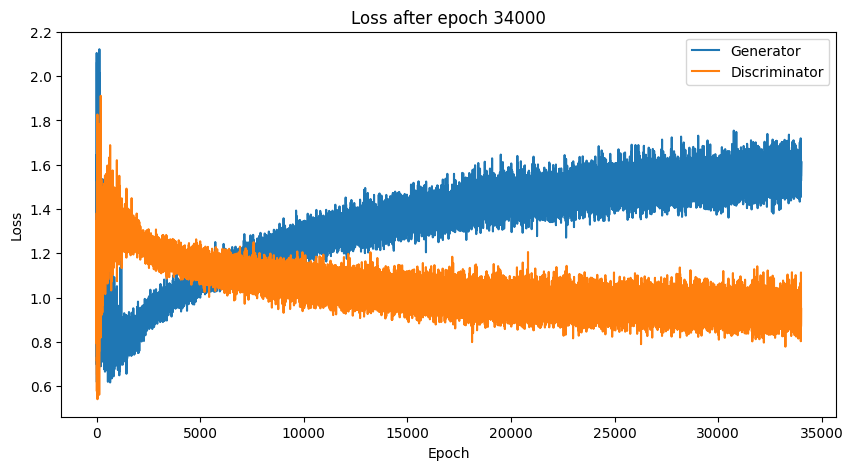

Time for epoch 34000 is 4.6886866092681885 sec
Time for epoch 34001 is 0.8606789112091064 sec
Time for epoch 34002 is 0.8584229946136475 sec
Time for epoch 34003 is 0.8691184520721436 sec
Time for epoch 34004 is 0.8657333850860596 sec
Time for epoch 34005 is 0.864710807800293 sec
Time for epoch 34006 is 0.8681137561798096 sec
Time for epoch 34007 is 0.8738946914672852 sec
Time for epoch 34008 is 0.8719677925109863 sec
Time for epoch 34009 is 0.868802547454834 sec
Time for epoch 34010 is 0.8730483055114746 sec
Time for epoch 34011 is 0.8747687339782715 sec
Time for epoch 34012 is 0.8738982677459717 sec
Time for epoch 34013 is 0.8758265972137451 sec
Time for epoch 34014 is 0.8760981559753418 sec
Time for epoch 34015 is 0.8779964447021484 sec
Time for epoch 34016 is 0.8752882480621338 sec
Time for epoch 34017 is 0.8822596073150635 sec
Time for epoch 34018 is 0.8779046535491943 sec
Time for epoch 34019 is 0.8843955993652344 sec
Time for epoch 34020 is 0.8732857704162598 sec
Time for epoch 

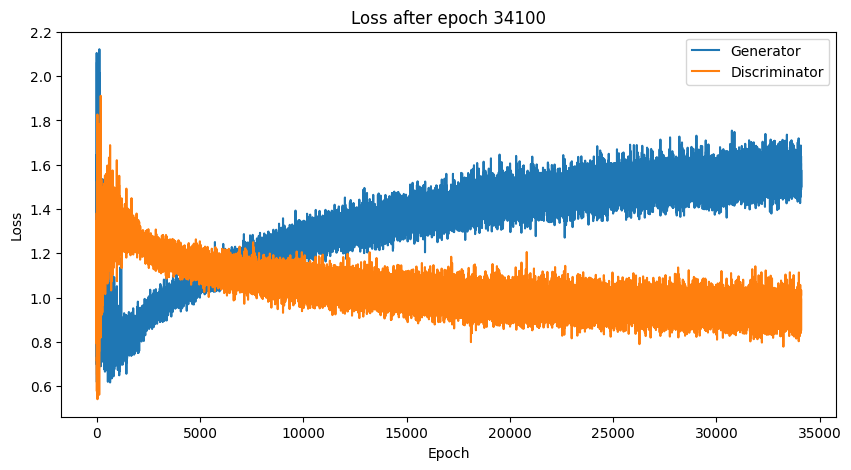

Time for epoch 34100 is 4.3981239795684814 sec
Time for epoch 34101 is 0.8517773151397705 sec
Time for epoch 34102 is 0.863224983215332 sec
Time for epoch 34103 is 0.8651351928710938 sec
Time for epoch 34104 is 0.8625779151916504 sec
Time for epoch 34105 is 0.8678524494171143 sec
Time for epoch 34106 is 0.8702006340026855 sec
Time for epoch 34107 is 0.8748226165771484 sec
Time for epoch 34108 is 0.8757555484771729 sec
Time for epoch 34109 is 0.873516321182251 sec
Time for epoch 34110 is 0.8814449310302734 sec
Time for epoch 34111 is 0.8749024868011475 sec
Time for epoch 34112 is 0.8784024715423584 sec
Time for epoch 34113 is 0.8825206756591797 sec
Time for epoch 34114 is 0.8765897750854492 sec
Time for epoch 34115 is 0.8787369728088379 sec
Time for epoch 34116 is 0.879906415939331 sec
Time for epoch 34117 is 0.8792335987091064 sec
Time for epoch 34118 is 0.8787949085235596 sec
Time for epoch 34119 is 0.8823509216308594 sec
Time for epoch 34120 is 0.8783338069915771 sec
Time for epoch 3

KeyboardInterrupt: 

In [20]:
train(train_ds, 50000)

Restore the latest checkpoint.

checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

### Creating a GIF

noise = tf.random.normal([1, NOISE_DIM])
generated_image = generator(noise, training=False)
decision = discriminator(generated_image, training=False)

print(decision)
plt.imshow(generated_image[0, :, :, :])
plt.savefig('generated/image_test.png')


# Display a single image using the epoch number
def display_image(epoch_no):
  return PIL.Image.open('generated/image_at_epoch_{:04d}.png'.format(epoch_no))

display_image(4301)

Using imageio we create an animated gif using the images saved during training.

anim_file = 'generated/cats_gan.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
  filenames = glob.glob('generated/image_at*.png')
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)

import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)

### EVALUTATION (FID)

In [21]:
import tensorflow as tf
import tensorflow_hub as hub
import numpy as np
from scipy import linalg

# Load pre-trained Inception V3 model
inception_model = hub.load('https://tfhub.dev/google/tf2-preview/inception_v3/feature_vector/4')

# Function to calculate FID
def calculate_fid(real_images, generated_images):
    # Calculate activation
    act1 = inception_model(real_images).numpy()
    act2 = inception_model(generated_images).numpy()
    
    # Calculate mean and covariance statistics
    mu1, sigma1 = act1.mean(axis=0), np.cov(act1, rowvar=False)
    mu2, sigma2 = act2.mean(axis=0), np.cov(act2, rowvar=False)
    
    # Calculate FID using the statistics
    ssdiff = np.sum((mu1 - mu2) ** 2.0)
    covmean = linalg.sqrtm(sigma1.dot(sigma2))
    
    # Check and correct imaginary numbers from sqrt
    if np.iscomplexobj(covmean):
        covmean = covmean.real
    
    fid = ssdiff + np.trace(sigma1 + sigma2 - 2.0 * covmean)
    return fid

# 실제 이미지 준비
real_images = next(iter(train_ds.take(1)))[0].numpy()  # 실제 이미지 데이터셋에서 배치 하나를 추출

# 생성된 이미지 준비
noise = tf.random.normal([num_examples_to_generate, NOISE_DIM])
generated_images = generator(noise, training=False).numpy()

# 이미지가 이미 4차원 형태인지 확인하고, 아니라면 4차원으로 확장
if real_images.ndim != 4:
    real_images = tf.expand_dims(real_images, axis=0)
if generated_images.ndim != 4:
    generated_images = tf.expand_dims(generated_images, axis=0)

# 이미지 크기 조정
real_images_resized = tf.image.resize(real_images, (299, 299))
generated_images_resized = tf.image.resize(generated_images, (299, 299))

# FID 계산
fid_value = calculate_fid(real_images_resized, generated_images_resized)
print(f'FID: {fid_value}')

FID: 391.41783330409146
